## Fig 2

### reletive yield

In [90]:
import os
import xarray as xr
import pandas as pd
import numpy as np
from os.path import join
# 场景列表
crops = ['maiz', 'soyb', 'rice', 'wheat']
whea=['swh','wwh']
ss = ['SSP585']
fp = r'F:\CWatM\cwatm_output\global_future'

# 初始化结果字典
data_dict = {}

# 遍历每个作物
for crop in crops:
    if crop != 'wheat':
        ori_rf = xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{crop}_nor.nc'), decode_times=False).Yield_nonIrr_annualtot[-31:-1,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{crop}_sou_1.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{crop}_sou_2.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')
        
        ori_irr = xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{crop}_nor.nc'), decode_times=False).Yield_Irr_annualtot[-31:-1,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{crop}_sou_1.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{crop}_sou_2.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')
        # ori = (ori_irr + ori_rf).values
    else:
        ori_rf = xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[0]}_nor.nc'), decode_times=False).Yield_nonIrr_annualtot[-31:-1,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[0]}_sou_1.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[0]}_sou_2.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[1]}_nor_1.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[1]}_nor_2.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[1]}_sou.nc'), decode_times=False).Yield_nonIrr_annualtot[-31:-1,:,:].mean(dim='time')
        
        ori_irr = xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[0]}_nor.nc'), decode_times=False).Yield_Irr_annualtot[-31:-1,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[0]}_sou_1.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[0]}_sou_2.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[1]}_nor_1.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[1]}_nor_2.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[1]}_sou.nc'), decode_times=False).Yield_Irr_annualtot[-31:-1,:,:].mean(dim='time')
    ori = (ori_irr + ori_rf)
    # 初始化用于存储结果的字典
    results = {}

    # 遍历每个情景
    for ssp in ss:
        institution_means_list = []

        for inst in os.listdir(fp):
            if inst == 'GWSP3_W5E5' or inst == 'MRI-ESM2-0':
                continue

            filepath = join(fp, inst, ssp)
            if crop != 'wheat':
                single_rf=xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{crop}_sou_2.nc'), decode_times=False).Yield_nonIrr_annualtot
                time = single_rf.coords['time'].values
                new_time = time - 1
                single_rf.loc[{'time': 119}] = 0  
                yield_rf = single_rf.assign_coords(time=new_time)
                csr_rf =  yield_rf+xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{crop}_sou_1.nc'), decode_times=False).Yield_nonIrr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{crop}_nor.nc'), decode_times=False).Yield_nonIrr_annualtot

                single_irr=xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{crop}_sou_2.nc'), decode_times=False).Yield_Irr_annualtot
                single_irr.loc[{'time': 119}] = 0  
                yield_irr = single_irr.assign_coords(time=new_time)
                csr_irr = yield_irr +\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{crop}_sou_1.nc'), decode_times=False).Yield_Irr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{crop}_nor.nc'), decode_times=False).Yield_Irr_annualtot
                # csr=csr_rf+csr_irr
            else:
                single_rf=xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[0]}_sou_2.nc'), decode_times=False).Yield_nonIrr_annualtot+\
                xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[1]}_nor_2.nc'), decode_times=False).Yield_nonIrr_annualtot
                single_rf.loc[{'time': 119}] = 0  
                yield_rf = single_rf.assign_coords(time=new_time)
                csr_rf = xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[0]}_nor.nc'), decode_times=False).Yield_nonIrr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[0]}_sou_1.nc'), decode_times=False).Yield_nonIrr_annualtot +\
                yield_rf+\
                xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[1]}_nor_1.nc'), decode_times=False).Yield_nonIrr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[1]}_sou.nc'), decode_times=False).Yield_nonIrr_annualtot

                
                single_irr=xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[0]}_sou_2.nc'), decode_times=False).Yield_Irr_annualtot+\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[1]}_nor_2.nc'), decode_times=False).Yield_Irr_annualtot
                single_irr.loc[{'time': 119}] = 0  
                yield_irr = single_irr.assign_coords(time=new_time)
                csr_irr = xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[0]}_nor.nc'), decode_times=False).Yield_Irr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[0]}_sou_1.nc'), decode_times=False).Yield_Irr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[1]}_nor_1.nc'), decode_times=False).Yield_Irr_annualtot +\
                 yield_irr+\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[1]}_sou.nc'), decode_times=False).Yield_Irr_annualtot
            csr=csr_rf+csr_irr
            # 计算年平均值
            start_year = 1901
            years = [start_year + int(offset) for offset in csr.time.values]
            dates = pd.to_datetime(years, format='%Y')
            csr = csr.assign_coords(time=("time", dates))
            # csr = csr.where(csr != 0, np.nan)

            institution_means_list.append(csr[-30:, :, :].mean(dim='time'))

        combined_means = xr.concat(institution_means_list, dim='institution')
        overall_mean = combined_means.median(dim='institution', skipna=True)

        results[ssp] = overall_mean

    # 计算差异并存储到字典
    data_dict[crop] = {}
    for ssp, mean_data in results.items():
        difference = (mean_data - ori) / ori * 100
        data_dict[crop][ssp] = difference


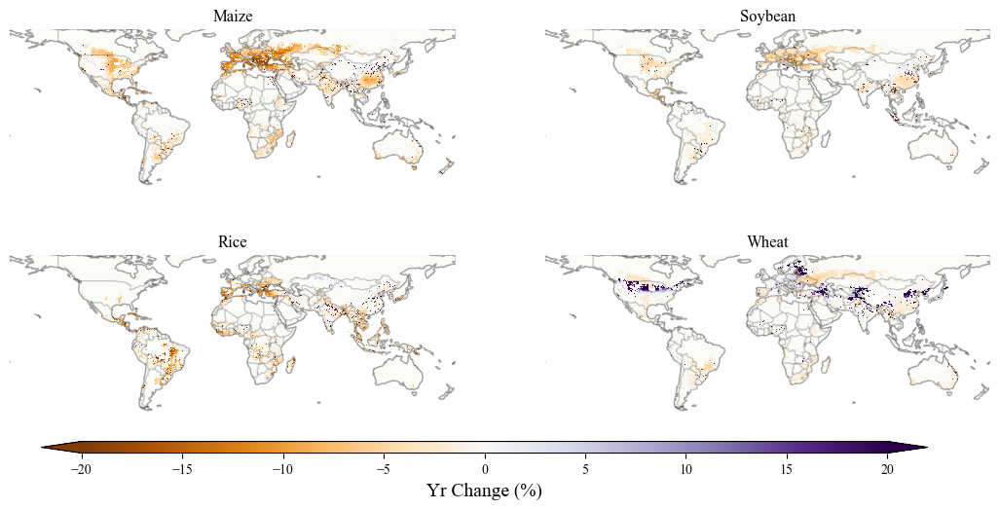

In [112]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.gridspec import GridSpec
import matplotlib as mpl

mpl.rcParams['font.family'] = 'Times New Roman'

# 场景列表
ss = ['SSP585']
crop_name = ['Maize', 'Soybean', 'Rice', 'Wheat']
# 创建一个图形和网格规格
fig = plt.figure(figsize=(13, 6))
gs = GridSpec(2, 2, figure=fig,hspace=0.01)  # 4行1列布局

# 遍历每个作物
for idx, crop in enumerate(crops):
    for ssp in ss:
        # 获取当前作物和情景的差异数据
        difference = data_dict[crop][ssp]

        # 在4行1列的第 idx 个位置创建子图
        ax = fig.add_subplot(gs[idx], projection=ccrs.PlateCarree())
        
        # 设置显示范围为南纬60°到北纬60°
        ax.set_extent([-180, 180, -60, 70], crs=ccrs.PlateCarree())
        
        # 添加地图特征
        ax.add_feature(cfeature.COASTLINE, alpha=0.2)
        ax.add_feature(cfeature.LAND, edgecolor='black', alpha=0.2)
        ax.add_feature(cfeature.BORDERS,  alpha=0.2)
        # 绘制数据并设置颜色带
        im = difference.plot(ax=ax, transform=ccrs.PlateCarree(), cmap='PuOr', 
                             vmin=-20, vmax=20, add_colorbar=False)
        
        # 移除网格线
        gl = ax.gridlines(draw_labels=False)
        gl.xlines = False
        gl.ylines = False
        ax.set_title(crop_name[idx])
        # 去除四周边框
        ax.spines['geo'].set_visible(False)
        # ax.text(-0.05, 0.5, crop, transform=ax.transAxes, fontsize=14, 
        #         verticalalignment='center', horizontalalignment='center', rotation=90)

# 添加一个全局的颜色带
cbar_ax = fig.add_axes([0.15, 0.1, 0.7, 0.02])  # 颜色带的位置: [左, 下, 宽, 高]
cbar = fig.colorbar(im, cax=cbar_ax, orientation='horizontal', pad=0.03, shrink=1, aspect=10, extend='both')
cbar.set_label('Yr Change (%)', fontsize=14)
fig.subplots_adjust(hspace=0.05)
# 保存图像
plt.savefig(r'F:\paper3_fig_v2\yield\yield_ssp585_change.png', dpi=300)
plt.show()


In [72]:
import os
import xarray as xr
import pandas as pd
import numpy as np
from os.path import join
# 场景列表
crops = ['maiz', 'soyb', 'rice', 'wheat']
whea=['swh','wwh']
ss =['SSP126','SSP370','SSP585']
fp = r'F:\CWatM\cwatm_output\global_future'

# 初始化结果字典
data_dict = {}
yield_name=['maiz','soyb','ricw','whea']
rcp=[26,60,85]
# 遍历每个作物
for i,crop in enumerate(crops):
    data_dict[crop]={}
    if crop != 'wheat':
        ori_rf = xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{crop}_nor.nc'), decode_times=False).Yield_nonIrr_annualtot[-31:-1,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{crop}_sou_1.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{crop}_sou_2.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')
        
        ori_irr = xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{crop}_nor.nc'), decode_times=False).Yield_Irr_annualtot[-31:-1,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{crop}_sou_1.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{crop}_sou_2.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')
        # ori = (ori_irr + ori_rf).values
    else:
        ori_rf = xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[0]}_nor.nc'), decode_times=False).Yield_nonIrr_annualtot[-31:-1,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[0]}_sou_1.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[0]}_sou_2.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[1]}_nor_1.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[1]}_nor_2.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[1]}_sou.nc'), decode_times=False).Yield_nonIrr_annualtot[-31:-1,:,:].mean(dim='time')
        
        ori_irr = xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[0]}_nor.nc'), decode_times=False).Yield_Irr_annualtot[-31:-1,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[0]}_sou_1.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[0]}_sou_2.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[1]}_nor_1.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[1]}_nor_2.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[1]}_sou.nc'), decode_times=False).Yield_Irr_annualtot[-31:-1,:,:].mean(dim='time')
        
    ori = (ori_irr*xr.open_dataset(join(rf'F:\global_cropmap\potential_yield\nc\{yield_name[i]}_30min',f'CRUTS32_his_8110_{yield_name[i]}200a_yld.nc')).data).fillna(0) + \
    ori_rf*xr.open_dataset(join(rf'F:\global_cropmap\potential_yield\nc\{yield_name[i]}_30min',f'CRUTS32_his_8110_{yield_name[i]}200b_yld.nc')).data.fillna(0)
    ori=ori.where(ori>0)
    ori=ori.mean(dim=['lat','lon'])
    # 初始化用于存储结果的字典
    results = {}

    # 遍历每个情景
    for j,ssp in enumerate(ss):
        data_dict[crop][ssp]={}
        pp_1140_irr=xr.open_dataset(join(rf'F:\global_cropmap\potential_yield\nc\{yield_name[i]}_30min', f'GFDL-ESM2M_rcp{rcp[j]}_1140_{yield_name[i]}200a_yld.nc')).data
        pp_1140_nonirr=xr.open_dataset(join(rf'F:\global_cropmap\potential_yield\nc\{yield_name[i]}_30min', f'GFDL-ESM2M_rcp{rcp[j]}_1140_{yield_name[i]}200b_yld.nc')).data
        pp_4170_irr=xr.open_dataset(join(rf'F:\global_cropmap\potential_yield\nc\{yield_name[i]}_30min', f'GFDL-ESM2M_rcp{rcp[j]}_4170_{yield_name[i]}200a_yld.nc')).data
        pp_4170_nonirr=xr.open_dataset(join(rf'F:\global_cropmap\potential_yield\nc\{yield_name[i]}_30min', f'GFDL-ESM2M_rcp{rcp[j]}_4170_{yield_name[i]}200b_yld.nc')).data
        pp_71100_irr=xr.open_dataset(join(rf'F:\global_cropmap\potential_yield\nc\{yield_name[i]}_30min',f'GFDL-ESM2M_rcp{rcp[j]}_71100_{yield_name[i]}200a_yld.nc')).data
        pp_71100_nonirr=xr.open_dataset(join(rf'F:\global_cropmap\potential_yield\nc\{yield_name[i]}_30min', f'GFDL-ESM2M_rcp{rcp[j]}_71100_{yield_name[i]}200b_yld.nc')).data
        institution_means_list = []

        for inst in os.listdir(fp):
            if inst == 'GWSP3_W5E5' or inst == 'MRI-ESM2-0':
                continue

            filepath = join(fp, inst, ssp)
            if crop != 'wheat':
                single_rf=xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{crop}_sou_2.nc'), decode_times=False).Yield_nonIrr_annualtot
                time = single_rf.coords['time'].values
                new_time = time - 1
                single_rf.loc[{'time': 119}] = 0  
                yield_rf = single_rf.assign_coords(time=new_time)
                csr_rf =  yield_rf+xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{crop}_sou_1.nc'), decode_times=False).Yield_nonIrr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{crop}_nor.nc'), decode_times=False).Yield_nonIrr_annualtot

                single_irr=xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{crop}_sou_2.nc'), decode_times=False).Yield_Irr_annualtot
                single_irr.loc[{'time': 119}] = 0  
                yield_irr = single_irr.assign_coords(time=new_time)
                csr_irr = yield_irr +\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{crop}_sou_1.nc'), decode_times=False).Yield_Irr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{crop}_nor.nc'), decode_times=False).Yield_Irr_annualtot
                # csr=csr_rf+csr_irr
            else:
                single_rf=xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[0]}_sou_2.nc'), decode_times=False).Yield_nonIrr_annualtot+\
                xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[1]}_nor_2.nc'), decode_times=False).Yield_nonIrr_annualtot
                single_rf.loc[{'time': 119}] = 0  
                yield_rf = single_rf.assign_coords(time=new_time)
                csr_rf = xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[0]}_nor.nc'), decode_times=False).Yield_nonIrr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[0]}_sou_1.nc'), decode_times=False).Yield_nonIrr_annualtot +\
                single_rf+\
                xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[1]}_nor_1.nc'), decode_times=False).Yield_nonIrr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[1]}_sou.nc'), decode_times=False).Yield_nonIrr_annualtot

                
                single_irr=xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[0]}_sou_2.nc'), decode_times=False).Yield_Irr_annualtot+\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[1]}_nor_2.nc'), decode_times=False).Yield_Irr_annualtot
                single_irr.loc[{'time': 119}] = 0  
                yield_irr = single_irr.assign_coords(time=new_time)
                csr_irr = xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[0]}_nor.nc'), decode_times=False).Yield_Irr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[0]}_sou_1.nc'), decode_times=False).Yield_Irr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[1]}_nor_1.nc'), decode_times=False).Yield_Irr_annualtot +\
                 yield_irr+\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[1]}_sou.nc'), decode_times=False).Yield_Irr_annualtot
            
            csr_rf[:20]=csr_rf[:20].where(pp_1140_nonirr>0)*pp_1140_nonirr
            csr_irr[:20]=csr_irr[:20].where(pp_1140_irr>0)*pp_1140_irr
            csr_rf[20:50]=csr_rf[20:50].where(pp_4170_nonirr>0)*pp_4170_nonirr
            csr_irr[20:50]=csr_irr[20:50].where(pp_4170_irr>0)*pp_4170_irr
            csr_rf[50:80]=csr_rf[50:80].where(pp_71100_nonirr>0)*pp_71100_nonirr
            csr_irr[50:80]=csr_irr[50:80].where(pp_71100_irr>0)*pp_71100_irr
            csr=csr_rf.fillna(0)+csr_irr.fillna(0)
            csr=csr.where(csr>0)
            # 计算年平均值
            start_year = 1901
            years = [start_year + int(offset) for offset in csr.time.values]
            dates = pd.to_datetime(years, format='%Y')
            csr = csr.assign_coords(time=("time", dates))
            # csr = csr.where(csr != 0, np.nan)
            institution_means_list.append(((csr.mean(dim=['lat','lon']).values-ori.values)/(ori.values)*100))
        results[ssp] = np.array(institution_means_list)
        data_dict[crop][ssp]= results[ssp]

    #     results[ssp] = overall_mean

    # # 计算差异并存储到字典
    # data_dict[crop] = {}
    # for ssp, mean_data in results.items():
    #     difference = (mean_data - ori) / ori * 100
    #     data_dict[crop][ssp] = difference


In [86]:
import os
import xarray as xr
import pandas as pd
import numpy as np
from os.path import join
# 场景列表
crops = ['maiz', 'soyb', 'rice', 'wheat']
whea=['swh','wwh']
ss =['SSP126','SSP370','SSP585']
fp = r'F:\CWatM\cwatm_output\global_future'

# 初始化结果字典
data_dict = {}
yield_name=['maiz','soyb','ricw','whea']
rcp=[26,60,85]
# 遍历每个作物
for i,crop in enumerate(crops):
    data_dict[crop]={}
    if crop != 'wheat':
        ori_rf = xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{crop}_nor.nc'), decode_times=False).Yield_nonIrr_annualtot[-31:-1,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{crop}_sou_1.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{crop}_sou_2.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')
        
        ori_irr = xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{crop}_nor.nc'), decode_times=False).Yield_Irr_annualtot[-31:-1,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{crop}_sou_1.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{crop}_sou_2.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')
        # ori = (ori_irr + ori_rf).values
    else:
        ori_rf = xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[0]}_nor.nc'), decode_times=False).Yield_nonIrr_annualtot[-31:-1,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[0]}_sou_1.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[0]}_sou_2.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[1]}_nor_1.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[1]}_nor_2.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[1]}_sou.nc'), decode_times=False).Yield_nonIrr_annualtot[-31:-1,:,:].mean(dim='time')
        
        ori_irr = xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[0]}_nor.nc'), decode_times=False).Yield_Irr_annualtot[-31:-1,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[0]}_sou_1.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[0]}_sou_2.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[1]}_nor_1.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[1]}_nor_2.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[1]}_sou.nc'), decode_times=False).Yield_Irr_annualtot[-31:-1,:,:].mean(dim='time')
        
    ori = ori_irr + ori_rf
    ori=ori.where(ori>0)
    ori=ori.mean(dim=['lat','lon'])
    # 初始化用于存储结果的字典
    results = {}

    # 遍历每个情景
    for j,ssp in enumerate(ss):
        data_dict[crop][ssp]={}
        institution_means_list = []

        for inst in os.listdir(fp):
            if inst == 'GWSP3_W5E5' or inst == 'MRI-ESM2-0':
                continue

            filepath = join(fp, inst, ssp)
            if crop != 'wheat':
                single_rf=xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{crop}_sou_2.nc'), decode_times=False).Yield_nonIrr_annualtot
                time = single_rf.coords['time'].values
                new_time = time - 1
                single_rf.loc[{'time': 119}] = 0  
                yield_rf = single_rf.assign_coords(time=new_time)
                csr_rf =  yield_rf+xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{crop}_sou_1.nc'), decode_times=False).Yield_nonIrr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{crop}_nor.nc'), decode_times=False).Yield_nonIrr_annualtot

                single_irr=xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{crop}_sou_2.nc'), decode_times=False).Yield_Irr_annualtot
                single_irr.loc[{'time': 119}] = 0  
                yield_irr = single_irr.assign_coords(time=new_time)
                csr_irr = yield_irr +\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{crop}_sou_1.nc'), decode_times=False).Yield_Irr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{crop}_nor.nc'), decode_times=False).Yield_Irr_annualtot
                # csr=csr_rf+csr_irr
            else:
                single_rf=xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[0]}_sou_2.nc'), decode_times=False).Yield_nonIrr_annualtot+\
                xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[1]}_nor_2.nc'), decode_times=False).Yield_nonIrr_annualtot
                single_rf.loc[{'time': 119}] = 0  
                yield_rf = single_rf.assign_coords(time=new_time)
                csr_rf = xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[0]}_nor.nc'), decode_times=False).Yield_nonIrr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[0]}_sou_1.nc'), decode_times=False).Yield_nonIrr_annualtot +\
                yield_rf+\
                xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[1]}_nor_1.nc'), decode_times=False).Yield_nonIrr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[1]}_sou.nc'), decode_times=False).Yield_nonIrr_annualtot

                
                single_irr=xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[0]}_sou_2.nc'), decode_times=False).Yield_Irr_annualtot+\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[1]}_nor_2.nc'), decode_times=False).Yield_Irr_annualtot
                single_irr.loc[{'time': 119}] = 0  
                yield_irr = single_irr.assign_coords(time=new_time)
                csr_irr = xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[0]}_nor.nc'), decode_times=False).Yield_Irr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[0]}_sou_1.nc'), decode_times=False).Yield_Irr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[1]}_nor_1.nc'), decode_times=False).Yield_Irr_annualtot +\
                 yield_irr+\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[1]}_sou.nc'), decode_times=False).Yield_Irr_annualtot
            
            csr=csr_rf.fillna(0)+csr_irr.fillna(0)
            csr=csr.where(csr>0)
            # 计算年平均值
            start_year = 1901
            years = [start_year + int(offset) for offset in csr.time.values]
            dates = pd.to_datetime(years, format='%Y')
            csr = csr.assign_coords(time=("time", dates))
            # csr = csr.where(csr != 0, np.nan)
            institution_means_list.append(((csr.mean(dim=['lat','lon']).values-ori.values)/(ori.values)*100))
        results[ssp] = np.array(institution_means_list)
        data_dict[crop][ssp]= results[ssp]

    #     results[ssp] = overall_mean

    # # 计算差异并存储到字典
    # data_dict[crop] = {}
    # for ssp, mean_data in results.items():
    #     difference = (mean_data - ori) / ori * 100
    #     data_dict[crop][ssp] = difference


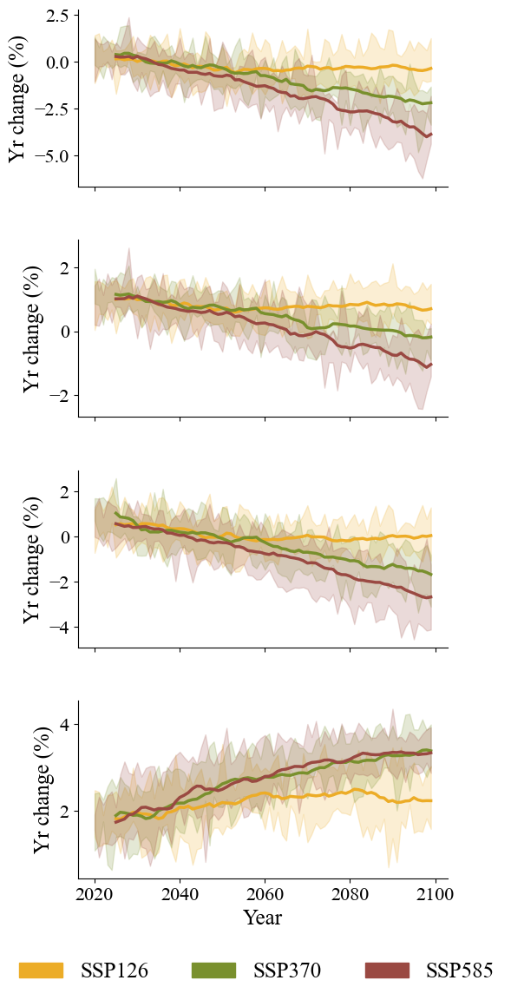

In [89]:
import matplotlib.patches as mpatches  # 导入用于创建色块的模块
ss =['SSP126','SSP370','SSP585']
# 定义每个情景的颜色
ssp_colors = {
    'SSP126': '#ECAC27',
    'SSP370': '#79902D',
    'SSP585': '#9A4942'
}

# 用于存储图例色块
legend_patches = [mpatches.Patch(color=ssp_colors[ssp], label=ssp) for ssp in ss]

# 开始绘制图形
fig, axs = plt.subplots(4, 1, figsize=(5.5, 13))  # 4行1列布局
axs = axs.flatten()  # 将子图轴展平成1D数组，方便遍历

# 遍历字典进行绘图
for idx, (crop, results) in enumerate(data_dict.items()):
    ax = axs[idx]  # 获取当前子图轴
    for ssp in ss:
        yr_transposed =results[ssp].T
        
        # 去除每个年份的最小值和最大值
        yr_filtered = []
        for yr in yr_transposed:
            yr_sorted = np.sort(yr)
            yr_filtered.append(yr_sorted[1:-1])  # 去除最小值和最大值
        
        # 转回原来的形状
        yr_filtered = np.array(yr_filtered).T
        
        # 计算去除极值后的均值和范围
        mean_yr = yr_filtered.mean(axis=0)
        min_yr = yr_filtered.min(axis=0)
        max_yr = yr_filtered.max(axis=0)
        window_size = 6  # 可以调整窗口大小以控制平滑度
        bb_smooth = pd.Series(mean_yr).rolling(window=window_size).mean()

        # 绘制曲线，设置对应的颜色
        ax.plot(years, bb_smooth, linewidth=2.5, color=ssp_colors[ssp])

        # 绘制均值和范围
        ax.fill_between(years, min_yr, max_yr, color=ssp_colors[ssp], alpha=0.2)

    # 隐藏右侧和顶部的轴
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.tick_params(axis='both', labelsize=16)
    # 隐藏网格线
    ax.grid(False)

    # 除了最后一张子图，隐藏X轴
    if idx < len(crops) - 1:
        ax.set_xticklabels([])
    else:
        ax.set_xlabel('Year', fontsize=18)
        
    # Y轴标签
    ax.set_ylabel('Yr change (%)', fontsize=18)

# 调整子图之间的间距
plt.subplots_adjust(hspace=0.3)

# 添加全局图例在最下方，将线条换为色块
fig.legend(handles=legend_patches, loc='lower center', bbox_to_anchor=(0.5, 0.00), ncol=len(ss), fontsize=18, frameon=False)


# 保存图像
plt.savefig(r'F:\paper3_fig_v2\yield\yr_time.png', dpi=300)

# 显示图像
plt.show()


In [120]:
import os
import xarray as xr
import pandas as pd
import numpy as np
from os.path import join
# 场景列表
crops = ['maiz', 'soyb', 'rice', 'wheat']
whea=['swh','wwh']
ss =['SSP126','SSP370','SSP585']
fp = r'F:\CWatM\cwatm_output\global_future'

# 初始化结果字典
data_dict = {}
yield_name=['maiz','soyb','ricw','whea']
rcp=[26,60,85]
# 遍历每个作物
for i,crop in enumerate(crops):
    # data_dict[crop]={}
    if crop != 'wheat':
        ori_rf = xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{crop}_nor.nc'), decode_times=False).Yield_nonIrr_annualtot[-31:-1,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{crop}_sou_1.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{crop}_sou_2.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')
        
        ori_irr = xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{crop}_nor.nc'), decode_times=False).Yield_Irr_annualtot[-31:-1,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{crop}_sou_1.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{crop}_sou_2.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')
        # ori = (ori_irr + ori_rf).values
    else:
        ori_rf = xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[0]}_nor.nc'), decode_times=False).Yield_nonIrr_annualtot[-31:-1,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[0]}_sou_1.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[0]}_sou_2.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[1]}_nor_1.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[1]}_nor_2.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[1]}_sou.nc'), decode_times=False).Yield_nonIrr_annualtot[-31:-1,:,:].mean(dim='time')
        
        ori_irr = xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[0]}_nor.nc'), decode_times=False).Yield_Irr_annualtot[-31:-1,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[0]}_sou_1.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[0]}_sou_2.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[1]}_nor_1.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[1]}_nor_2.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[1]}_sou.nc'), decode_times=False).Yield_Irr_annualtot[-31:-1,:,:].mean(dim='time')
        
    ori = (ori_irr*xr.open_dataset(join(rf'F:\global_cropmap\potential_yield\nc\{yield_name[i]}_30min',f'CRUTS32_his_8110_{yield_name[i]}200a_yld.nc')).data).fillna(0) + \
    ori_rf*xr.open_dataset(join(rf'F:\global_cropmap\potential_yield\nc\{yield_name[i]}_30min',f'CRUTS32_his_8110_{yield_name[i]}200b_yld.nc')).data.fillna(0)
    # ori=ori.where(ori>0)
    # ori=ori.mean(dim=['lat','lon'])
    # 初始化用于存储结果的字典
    results = {}

    # 遍历每个情景
    for j,ssp in enumerate(ss):
        # data_dict[crop][ssp]={}
        pp_1140_irr=xr.open_dataset(join(rf'F:\global_cropmap\potential_yield\nc\{yield_name[i]}_30min', f'GFDL-ESM2M_rcp{rcp[j]}_1140_{yield_name[i]}200a_yld.nc')).data
        pp_1140_nonirr=xr.open_dataset(join(rf'F:\global_cropmap\potential_yield\nc\{yield_name[i]}_30min', f'GFDL-ESM2M_rcp{rcp[j]}_1140_{yield_name[i]}200b_yld.nc')).data
        pp_4170_irr=xr.open_dataset(join(rf'F:\global_cropmap\potential_yield\nc\{yield_name[i]}_30min', f'GFDL-ESM2M_rcp{rcp[j]}_4170_{yield_name[i]}200a_yld.nc')).data
        pp_4170_nonirr=xr.open_dataset(join(rf'F:\global_cropmap\potential_yield\nc\{yield_name[i]}_30min', f'GFDL-ESM2M_rcp{rcp[j]}_4170_{yield_name[i]}200b_yld.nc')).data
        pp_71100_irr=xr.open_dataset(join(rf'F:\global_cropmap\potential_yield\nc\{yield_name[i]}_30min',f'GFDL-ESM2M_rcp{rcp[j]}_71100_{yield_name[i]}200a_yld.nc')).data
        pp_71100_nonirr=xr.open_dataset(join(rf'F:\global_cropmap\potential_yield\nc\{yield_name[i]}_30min', f'GFDL-ESM2M_rcp{rcp[j]}_71100_{yield_name[i]}200b_yld.nc')).data
        institution_means_list = []

        for inst in os.listdir(fp):
            if inst == 'GWSP3_W5E5' or inst == 'MRI-ESM2-0':
                continue

            filepath = join(fp, inst, ssp)
            if crop != 'wheat':
                single_rf=xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{crop}_sou_2.nc'), decode_times=False).Yield_nonIrr_annualtot
                time = single_rf.coords['time'].values
                new_time = time - 1
                single_rf.loc[{'time': 119}] = 0  
                yield_rf = single_rf.assign_coords(time=new_time)
                csr_rf =  yield_rf+xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{crop}_sou_1.nc'), decode_times=False).Yield_nonIrr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{crop}_nor.nc'), decode_times=False).Yield_nonIrr_annualtot

                single_irr=xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{crop}_sou_2.nc'), decode_times=False).Yield_Irr_annualtot
                single_irr.loc[{'time': 119}] = 0  
                yield_irr = single_irr.assign_coords(time=new_time)
                csr_irr = yield_irr +\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{crop}_sou_1.nc'), decode_times=False).Yield_Irr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{crop}_nor.nc'), decode_times=False).Yield_Irr_annualtot
                # csr=csr_rf+csr_irr
            else:
                single_rf=xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[0]}_sou_2.nc'), decode_times=False).Yield_nonIrr_annualtot+\
                xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[1]}_nor_2.nc'), decode_times=False).Yield_nonIrr_annualtot
                single_rf.loc[{'time': 119}] = 0  
                yield_rf = single_rf.assign_coords(time=new_time)
                csr_rf = xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[0]}_nor.nc'), decode_times=False).Yield_nonIrr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[0]}_sou_1.nc'), decode_times=False).Yield_nonIrr_annualtot +\
                single_rf+\
                xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[1]}_nor_1.nc'), decode_times=False).Yield_nonIrr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[1]}_sou.nc'), decode_times=False).Yield_nonIrr_annualtot

                
                single_irr=xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[0]}_sou_2.nc'), decode_times=False).Yield_Irr_annualtot+\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[1]}_nor_2.nc'), decode_times=False).Yield_Irr_annualtot
                single_irr.loc[{'time': 119}] = 0  
                yield_irr = single_irr.assign_coords(time=new_time)
                csr_irr = xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[0]}_nor.nc'), decode_times=False).Yield_Irr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[0]}_sou_1.nc'), decode_times=False).Yield_Irr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[1]}_nor_1.nc'), decode_times=False).Yield_Irr_annualtot +\
                 yield_irr+\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[1]}_sou.nc'), decode_times=False).Yield_Irr_annualtot
            
            csr_rf[:20]=csr_rf[:20].where(pp_1140_nonirr>0)*pp_1140_nonirr
            csr_irr[:20]=csr_irr[:20].where(pp_1140_irr>0)*pp_1140_irr
            csr_rf[20:50]=csr_rf[20:50].where(pp_4170_nonirr>0)*pp_4170_nonirr
            csr_irr[20:50]=csr_irr[20:50].where(pp_4170_irr>0)*pp_4170_irr
            csr_rf[50:80]=csr_rf[50:80].where(pp_71100_nonirr>0)*pp_71100_nonirr
            csr_irr[50:80]=csr_irr[50:80].where(pp_71100_irr>0)*pp_71100_irr
            csr=csr_rf.fillna(0)+csr_irr.fillna(0)
            csr=csr.where(csr>0)
            # 计算年平均值
            start_year = 1901
            years = [start_year + int(offset) for offset in csr.time.values]
            dates = pd.to_datetime(years, format='%Y')
            csr = csr.assign_coords(time=("time", dates))
            # csr = csr.where(csr != 0, np.nan)
            institution_means_list.append(csr[50:80].mean(dim='time'))
        
        combined_means = xr.concat(institution_means_list, dim='institution')
        overall_mean = combined_means.median(dim='institution', skipna=True)

        results[ssp] = overall_mean

    # 计算差异并存储到字典
    data_dict[crop] = {}
    for ssp, mean_data in results.items():
        difference = (mean_data - ori) / ori * 100
        data_dict[crop][ssp] = difference


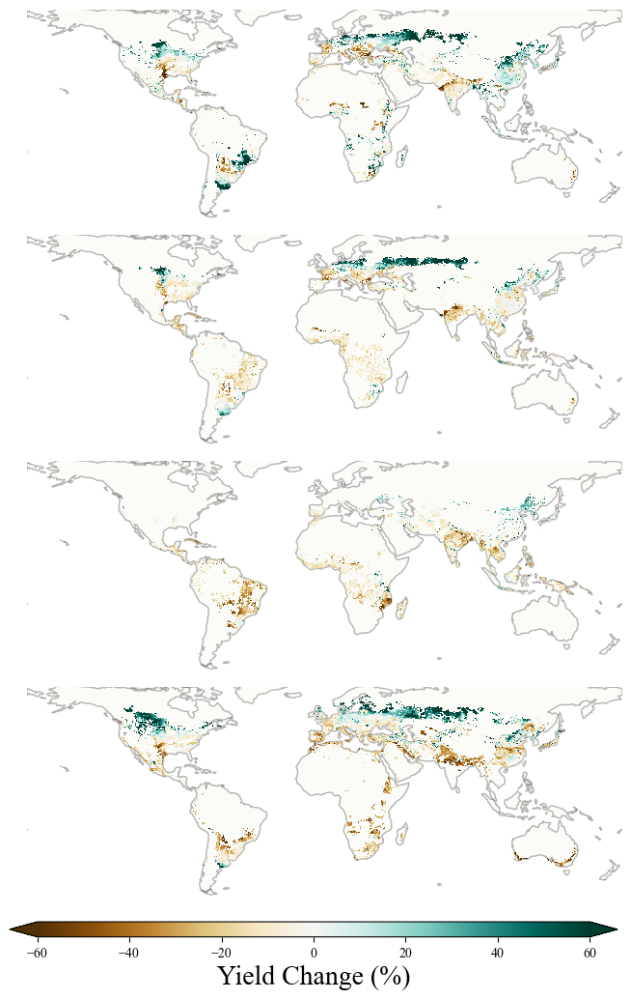

In [121]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.gridspec import GridSpec
import matplotlib as mpl

mpl.rcParams['font.family'] = 'Times New Roman'

# 场景列表
ss = ['SSP585']

# 创建一个图形和网格规格
fig = plt.figure(figsize=(9, 12))
gs = GridSpec(4, 1, figure=fig)  # 4行1列布局
# 遍历每个作物
for idx, crop in enumerate(crops):
    for ssp in ss:
        # 获取当前作物和情景的差异数据
        difference = data_dict[crop][ssp]

        # 在4行1列的第 idx 个位置创建子图
        ax = fig.add_subplot(gs[idx], projection=ccrs.PlateCarree())
        
        # 设置显示范围为南纬60°到北纬60°
        ax.set_extent([-180, 180, -60, 70], crs=ccrs.PlateCarree())
        
        # 添加地图特征
        ax.add_feature(cfeature.COASTLINE, alpha=0.1)
        ax.add_feature(cfeature.LAND, edgecolor='black', alpha=0.2)
        
        # 绘制数据并设置颜色带
        im = difference.plot(ax=ax, transform=ccrs.PlateCarree(), cmap='BrBG', 
                             vmin=-60, vmax=60, add_colorbar=False)
        
        # 移除网格线
        gl = ax.gridlines(draw_labels=False)
        gl.xlines = False
        gl.ylines = False
        # ax.set_title(crop)
        # 去除四周边框
        ax.spines['geo'].set_visible(False)
        # ax.text(-0.05, 0.5, crop, transform=ax.transAxes, fontsize=14, 
        #         verticalalignment='center', horizontalalignment='center', rotation=90)

# 添加一个全局的颜色带
cbar_ax = fig.add_axes([0.15, 0.08, 0.7, 0.013])  # 颜色带的位置: [左, 下, 宽, 高]
cbar = fig.colorbar(im, cax=cbar_ax, orientation='horizontal', pad=0.03, shrink=1, aspect=10, extend='both')
cbar.set_label('Yield Change (%)', fontsize=20)
fig.subplots_adjust(hspace=0.05)
# 保存图像
# plt.savefig(r'F:\paper3_fig\combined\fig2\mean_instu_ssp585_change_combined.png', dpi=300)
plt.show()


In [130]:
import os
import xarray as xr
import pandas as pd
import numpy as np
from os.path import join
# 场景列表
crops = ['maiz', 'soyb', 'rice', 'wheat']
whea=['swh','wwh']
ss =['SSP126','SSP370','SSP585']
fp = r'F:\CWatM\cwatm_output\global_future'
periods_indices = {
            'Near-term': (0, 20),   # 前20年
            'Mid-term': (20, 50),   # 中间30年
            'Long-term': (50, 80)   # 最后30年
        }
        
# 初始化结果字典
data_dict = {}
yield_name=['maiz','soyb','ricw','whea']
rcp=[26,60,85]
# 遍历每个作物
for i,crop in enumerate(crops):
    # data_dict[crop]={}
    if crop != 'wheat':
        ori_rf = xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{crop}_nor.nc'), decode_times=False).Yield_nonIrr_annualtot[-31:-1,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{crop}_sou_1.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{crop}_sou_2.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')
        
        ori_irr = xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{crop}_nor.nc'), decode_times=False).Yield_Irr_annualtot[-31:-1,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{crop}_sou_1.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{crop}_sou_2.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')
        # ori = (ori_irr + ori_rf).values
    else:
        ori_rf = xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[0]}_nor.nc'), decode_times=False).Yield_nonIrr_annualtot[-31:-1,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[0]}_sou_1.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[0]}_sou_2.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[1]}_nor_1.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[1]}_nor_2.nc'), decode_times=False).Yield_nonIrr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_nonIrr_annualtot_{whea[1]}_sou.nc'), decode_times=False).Yield_nonIrr_annualtot[-31:-1,:,:].mean(dim='time')
        
        ori_irr = xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[0]}_nor.nc'), decode_times=False).Yield_Irr_annualtot[-31:-1,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[0]}_sou_1.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[0]}_sou_2.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[1]}_nor_1.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[1]}_nor_2.nc'), decode_times=False).Yield_Irr_annualtot[-30:,:,:].mean(dim='time')+\
        xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'Yield_Irr_annualtot_{whea[1]}_sou.nc'), decode_times=False).Yield_Irr_annualtot[-31:-1,:,:].mean(dim='time')
        
    ori = (ori_irr*xr.open_dataset(join(rf'F:\global_cropmap\potential_yield\nc\{yield_name[i]}_30min',f'CRUTS32_his_8110_{yield_name[i]}200a_yld.nc')).data).fillna(0) + \
    ori_rf*xr.open_dataset(join(rf'F:\global_cropmap\potential_yield\nc\{yield_name[i]}_30min',f'CRUTS32_his_8110_{yield_name[i]}200b_yld.nc')).data.fillna(0)
    # ori=ori.where(ori>0)
    # ori=ori.mean(dim=['lat','lon'])
    # 初始化用于存储结果的字典
    results = {}

    # 遍历每个情景
    for j,ssp in enumerate(ss):
        # data_dict[crop][ssp]={}
        pp_1140_irr=xr.open_dataset(join(rf'F:\global_cropmap\potential_yield\nc\{yield_name[i]}_30min', f'GFDL-ESM2M_rcp{rcp[j]}_1140_{yield_name[i]}200a_yld.nc')).data
        pp_1140_nonirr=xr.open_dataset(join(rf'F:\global_cropmap\potential_yield\nc\{yield_name[i]}_30min', f'GFDL-ESM2M_rcp{rcp[j]}_1140_{yield_name[i]}200b_yld.nc')).data
        pp_4170_irr=xr.open_dataset(join(rf'F:\global_cropmap\potential_yield\nc\{yield_name[i]}_30min', f'GFDL-ESM2M_rcp{rcp[j]}_4170_{yield_name[i]}200a_yld.nc')).data
        pp_4170_nonirr=xr.open_dataset(join(rf'F:\global_cropmap\potential_yield\nc\{yield_name[i]}_30min', f'GFDL-ESM2M_rcp{rcp[j]}_4170_{yield_name[i]}200b_yld.nc')).data
        pp_71100_irr=xr.open_dataset(join(rf'F:\global_cropmap\potential_yield\nc\{yield_name[i]}_30min',f'GFDL-ESM2M_rcp{rcp[j]}_71100_{yield_name[i]}200a_yld.nc')).data
        pp_71100_nonirr=xr.open_dataset(join(rf'F:\global_cropmap\potential_yield\nc\{yield_name[i]}_30min', f'GFDL-ESM2M_rcp{rcp[j]}_71100_{yield_name[i]}200b_yld.nc')).data
        institution_means_list = []

        for inst in os.listdir(fp):
            if inst == 'GWSP3_W5E5' or inst == 'MRI-ESM2-0':
                continue

            filepath = join(fp, inst, ssp)
            if crop != 'wheat':
                single_rf=xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{crop}_sou_2.nc'), decode_times=False).Yield_nonIrr_annualtot
                time = single_rf.coords['time'].values
                new_time = time - 1
                single_rf.loc[{'time': 119}] = 0  
                yield_rf = single_rf.assign_coords(time=new_time)
                csr_rf =  yield_rf+xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{crop}_sou_1.nc'), decode_times=False).Yield_nonIrr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{crop}_nor.nc'), decode_times=False).Yield_nonIrr_annualtot

                single_irr=xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{crop}_sou_2.nc'), decode_times=False).Yield_Irr_annualtot
                single_irr.loc[{'time': 119}] = 0  
                yield_irr = single_irr.assign_coords(time=new_time)
                csr_irr = yield_irr +\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{crop}_sou_1.nc'), decode_times=False).Yield_Irr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{crop}_nor.nc'), decode_times=False).Yield_Irr_annualtot
                # csr=csr_rf+csr_irr
            else:
                single_rf=xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[0]}_sou_2.nc'), decode_times=False).Yield_nonIrr_annualtot+\
                xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[1]}_nor_2.nc'), decode_times=False).Yield_nonIrr_annualtot
                single_rf.loc[{'time': 119}] = 0  
                yield_rf = single_rf.assign_coords(time=new_time)
                csr_rf = xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[0]}_nor.nc'), decode_times=False).Yield_nonIrr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[0]}_sou_1.nc'), decode_times=False).Yield_nonIrr_annualtot +\
                single_rf+\
                xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[1]}_nor_1.nc'), decode_times=False).Yield_nonIrr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_nonIrr_annualtot_{whea[1]}_sou.nc'), decode_times=False).Yield_nonIrr_annualtot

                
                single_irr=xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[0]}_sou_2.nc'), decode_times=False).Yield_Irr_annualtot+\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[1]}_nor_2.nc'), decode_times=False).Yield_Irr_annualtot
                single_irr.loc[{'time': 119}] = 0  
                yield_irr = single_irr.assign_coords(time=new_time)
                csr_irr = xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[0]}_nor.nc'), decode_times=False).Yield_Irr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[0]}_sou_1.nc'), decode_times=False).Yield_Irr_annualtot +\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[1]}_nor_1.nc'), decode_times=False).Yield_Irr_annualtot +\
                 yield_irr+\
                xr.open_dataset(join(filepath, f'Yield_Irr_annualtot_{whea[1]}_sou.nc'), decode_times=False).Yield_Irr_annualtot
            
            csr_rf[:20]=csr_rf[:20].where(pp_1140_nonirr>0)*pp_1140_nonirr
            csr_irr[:20]=csr_irr[:20].where(pp_1140_irr>0)*pp_1140_irr
            csr_rf[20:50]=csr_rf[20:50].where(pp_4170_nonirr>0)*pp_4170_nonirr
            csr_irr[20:50]=csr_irr[20:50].where(pp_4170_irr>0)*pp_4170_irr
            csr_rf[50:80]=csr_rf[50:80].where(pp_71100_nonirr>0)*pp_71100_nonirr
            csr_irr[50:80]=csr_irr[50:80].where(pp_71100_irr>0)*pp_71100_irr
            csr=csr_rf.fillna(0)+csr_irr.fillna(0)
            csr=csr.where(csr>0)
            # 计算年平均值
            start_year = 1901
            years = [start_year + int(offset) for offset in csr.time.values]
            dates = pd.to_datetime(years, format='%Y')
            csr = csr.assign_coords(time=("time", dates))
            # csr = csr.where(csr != 0, np.nan)
            institution_means_list.append(csr)
        
        combined_means = xr.concat(institution_means_list, dim='institution')
        overall_mean = combined_means.median(dim='institution', skipna=True)

        results[ssp] = overall_mean

    # 计算差异并存储到字典
    data_dict[crop] = {}
    for ssp, mean_data in results.items():
        data_dict[crop][ssp]={}
        for period, (start, end) in periods_indices.items():
            # 计算每个时期的平均值与基准期的差值
            period_mean = results[ssp][start:end,:,:].mean(dim='time')
            difference = (period_mean- ori)/ ori * 100
            data_dict[crop][ssp][period] = difference


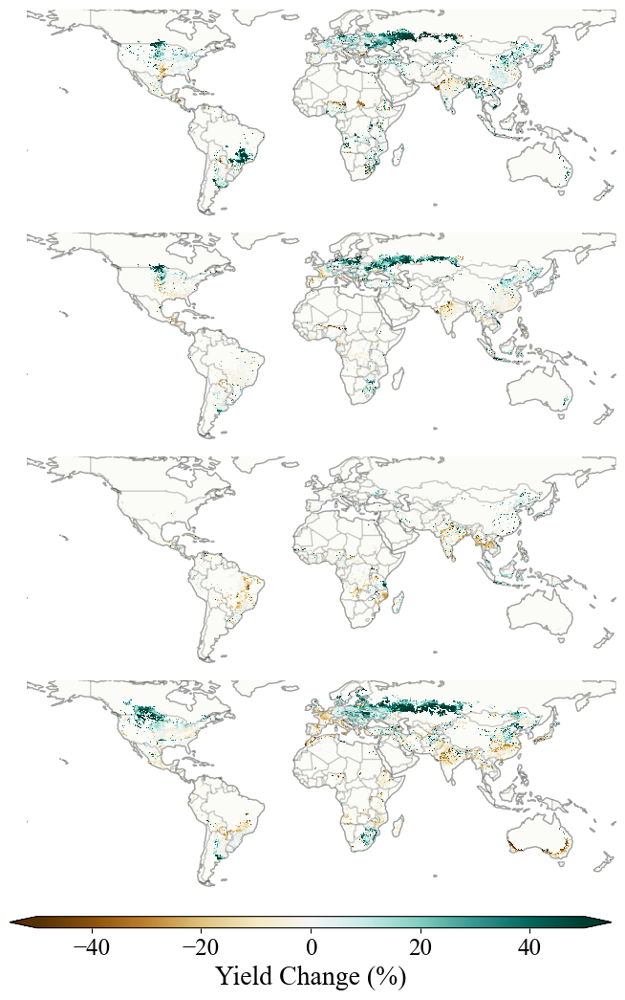

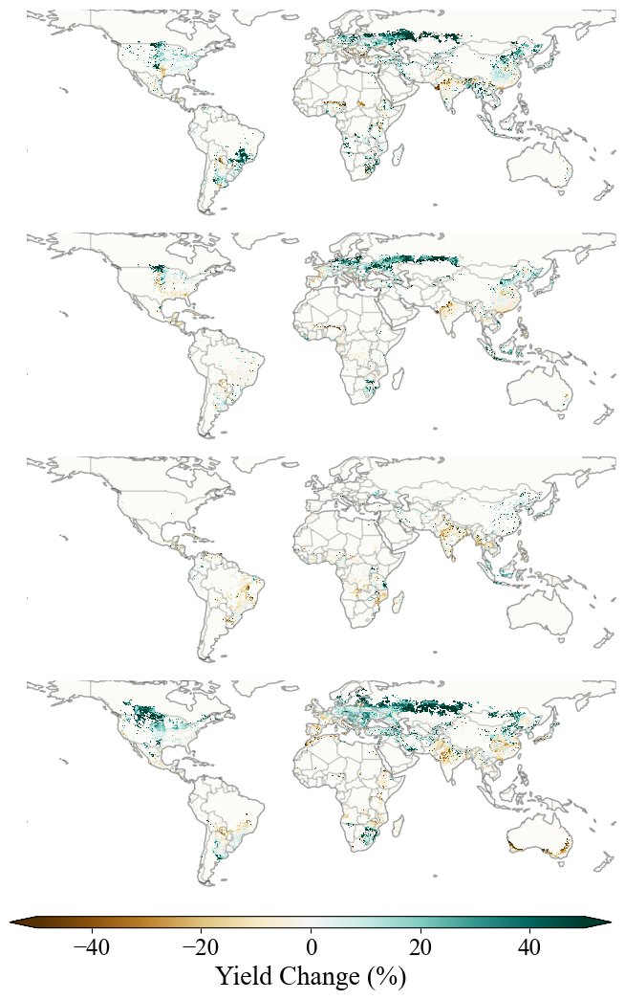

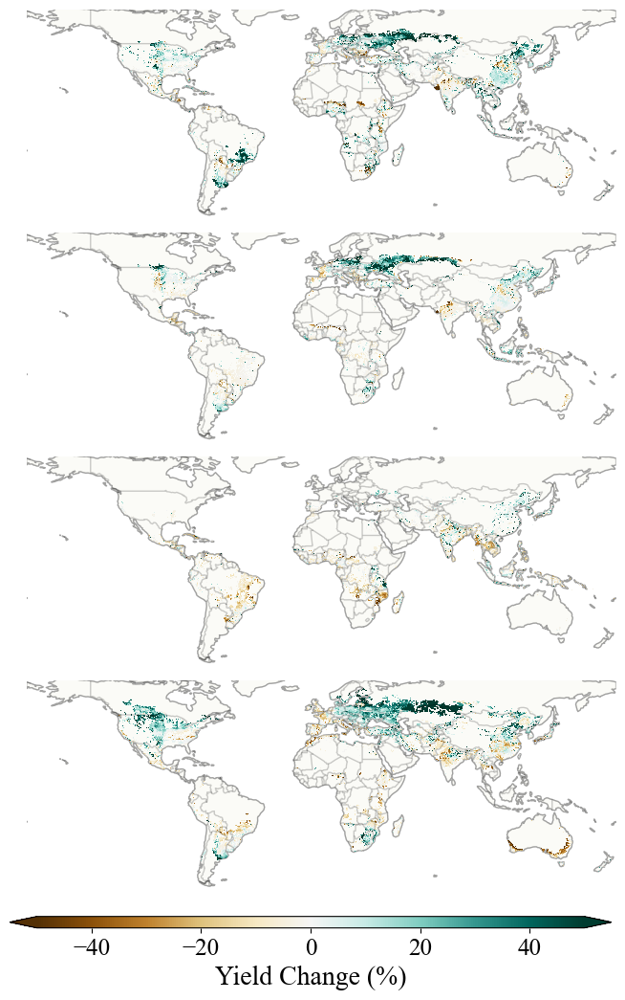

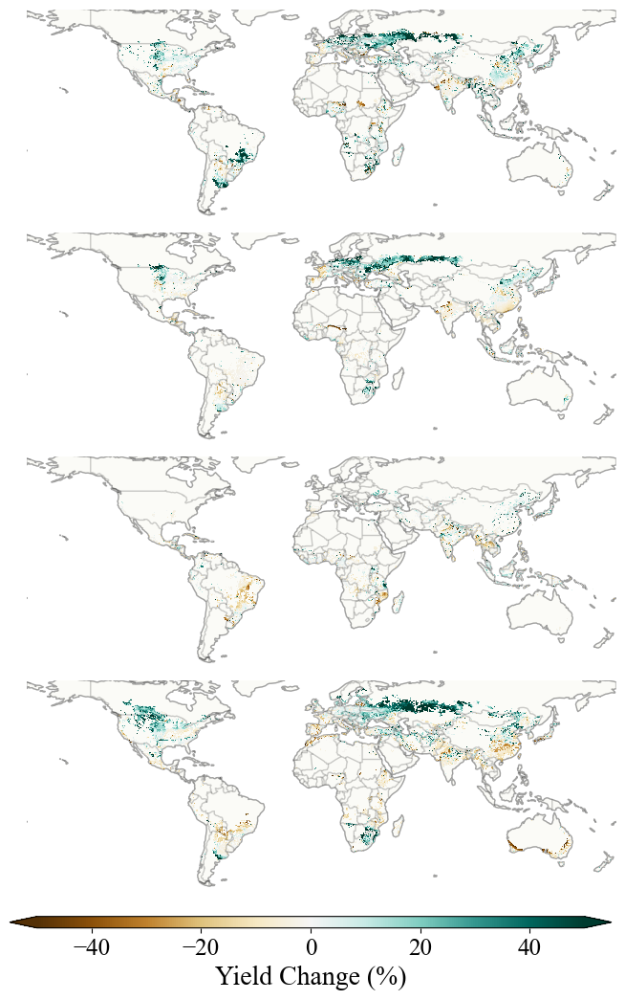

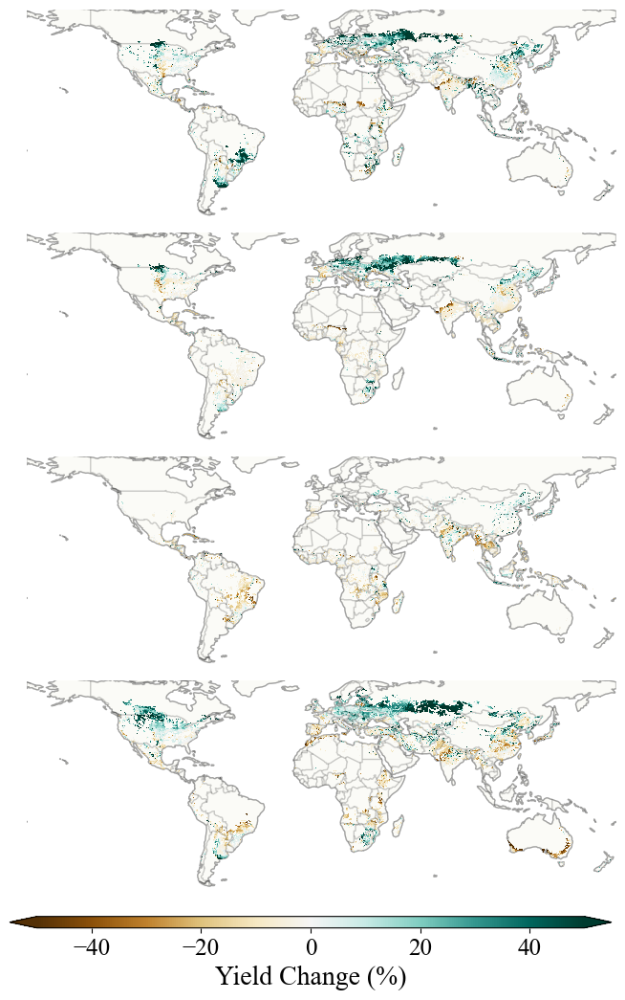

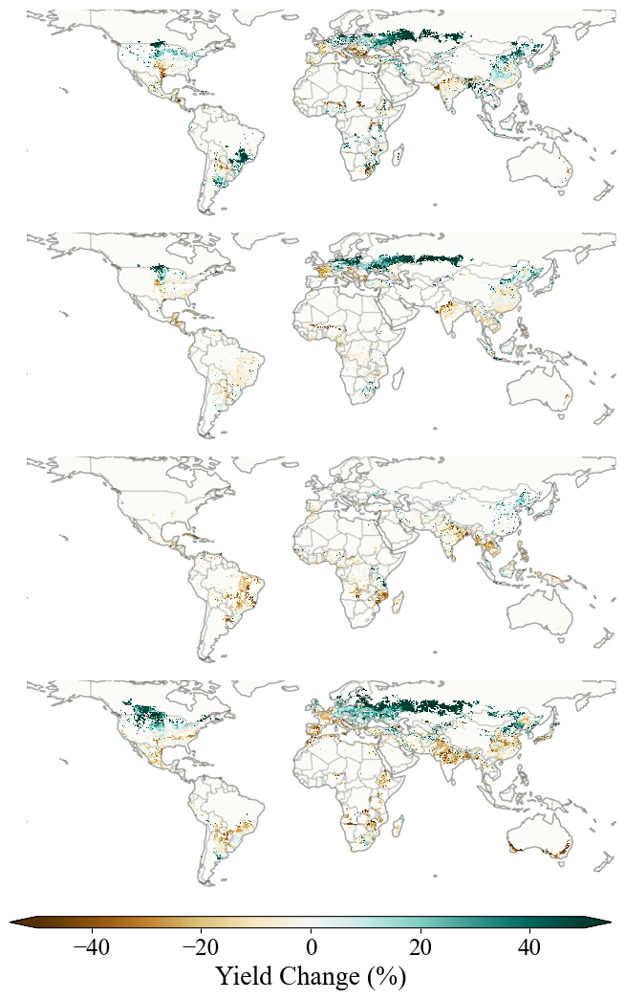

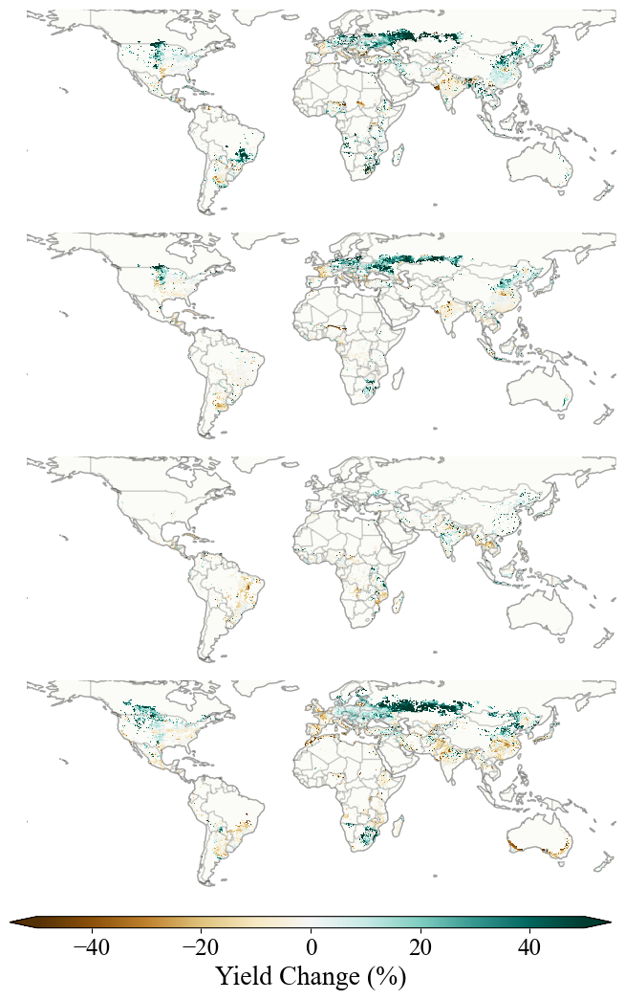

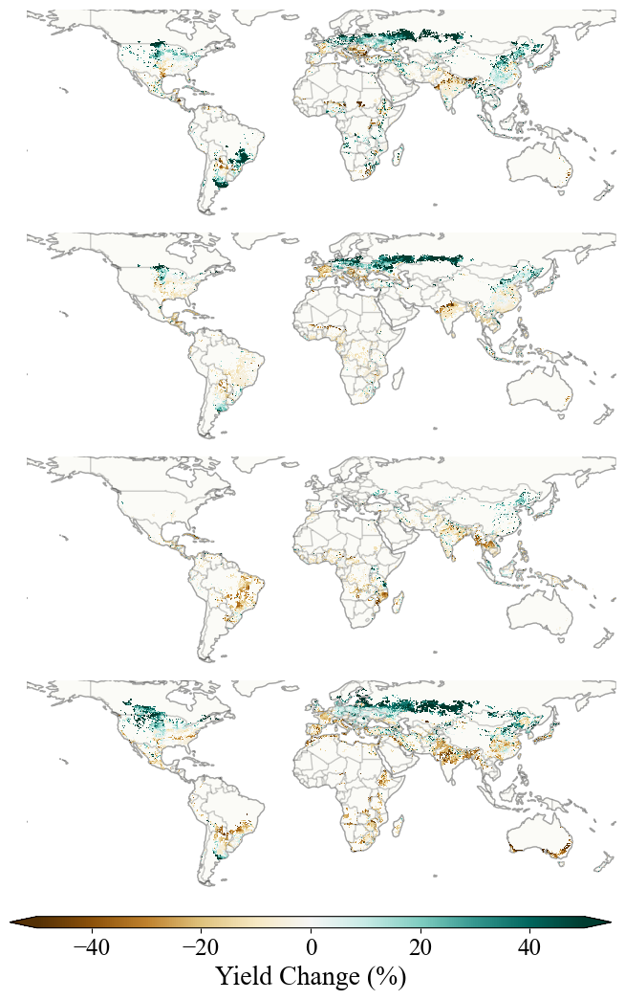

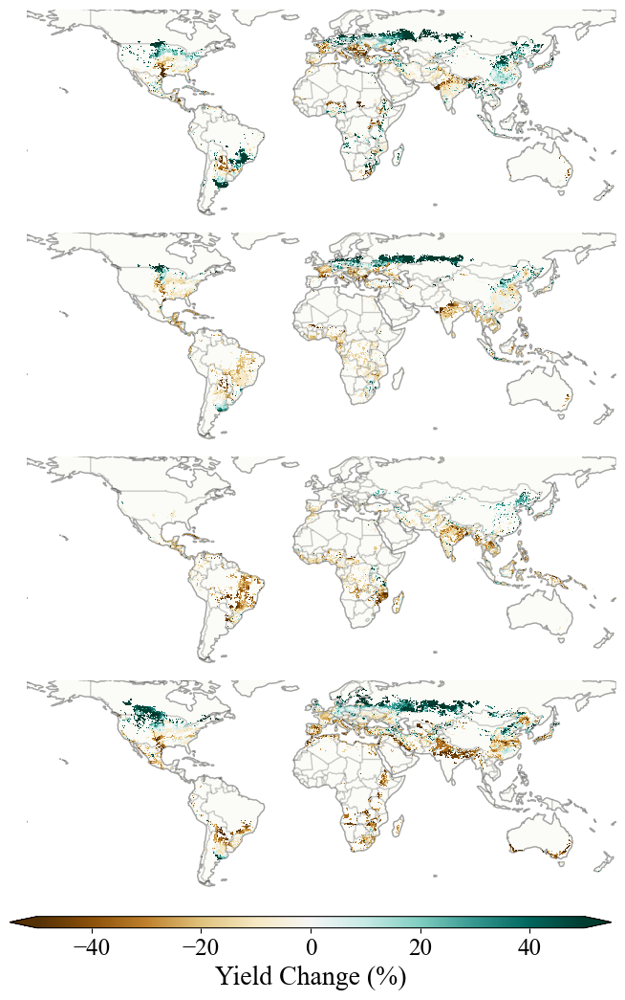

In [131]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.gridspec import GridSpec
import matplotlib as mpl

mpl.rcParams['font.family'] = 'Times New Roman'

# 场景列表
ss =['SSP126','SSP370','SSP585']
for ssp in ss:
    for period, (start, end) in periods_indices.items():
        # 创建一个图形和网格规格
        fig = plt.figure(figsize=(9, 12))
        gs = GridSpec(4, 1, figure=fig)  # 4行1列布局
        
        # 遍历每个作物
        for idx, crop in enumerate(crops):
            
                # 获取当前作物和情景的差异数据
                difference = data_dict[crop][ssp][f'{period}']
        
                # 在4行1列的第 idx 个位置创建子图
                ax = fig.add_subplot(gs[idx], projection=ccrs.PlateCarree())
                
                # 设置显示范围为南纬60°到北纬60°
                ax.set_extent([-180, 180, -60, 70], crs=ccrs.PlateCarree())
                
                # 添加地图特征
                ax.add_feature(cfeature.COASTLINE, alpha=0.2)
                ax.add_feature(cfeature.LAND, edgecolor='black', alpha=0.2)
                
                # 绘制数据并设置颜色带
                im = difference.plot(ax=ax, transform=ccrs.PlateCarree(), cmap='BrBG', 
                                     vmin=-50, vmax=50, add_colorbar=False)
                
                # 移除网格线
                gl = ax.gridlines(draw_labels=False)
                gl.xlines = False
                gl.ylines = False
        
                # 去除四周边框
                ax.spines['geo'].set_visible(False)
                # ax.text(-0.05, 0.5, crop, transform=ax.transAxes, fontsize=14, 
                #         verticalalignment='center', horizontalalignment='center', rotation=90)
                ax.add_feature(cfeature.BORDERS, edgecolor='black', alpha=0.2)
        # 添加一个全局的颜色带
        cbar_ax = fig.add_axes([0.15, 0.08, 0.7, 0.01])  # 颜色带的位置: [左, 下, 宽, 高]
        cbar = fig.colorbar(im, cax=cbar_ax, orientation='horizontal', pad=0.03, shrink=1, aspect=50, extend='both')
        cbar.set_label('Yield Change (%)', fontsize=20)
        cbar.ax.tick_params(labelsize=18)
        # 调整子图间距
        fig.subplots_adjust(hspace=0.05)  # 这里的 hspace 控制垂直间距，可以根据需要调整
        
        # 保存图像
        plt.savefig(rf'F:\paper3_fig_v2\yield\yield_{ssp}_{period}.png', dpi=300)
        plt.show()


## Fig 1

### precipitation

In [358]:
import os
import xarray as xr
import numpy as np
from os.path import join
import pandas as pd

# 设置默认字体为 Times New Roman
import matplotlib as mpl
mpl.rcParams['font.family'] = 'Times New Roman'

# 场景列表
crops = ['maiz', 'soyb', 'rice', 'wheat']
ss = ['SSP126', 'SSP370', 'SSP585']
fp = r'F:\paper3_fig_v2\climate\pr'

# 初始化一个字典来存储所有作物和情景的数据
crop_data = {}

# 遍历每个作物
for crop in crops:
    # 初始化用于存储结果的字典
    results = {}

    # 遍历每个情景
    for ssp in ss:
        yr_values = []
        for inst in os.listdir(fp):
            if inst == 'gswp3_w5e5' or inst == 'a_fig' or inst == 'a_median':
                continue
            filepath = join(fp, inst)

            csr = xr.open_dataset(join(filepath, F'{crop}_{ssp}_pr.nc'), decode_times=False).crop_Precipitation_nonIrr_annualtot
            units = csr.time.attrs['units']
            calendar = csr.time.attrs.get('calendar', 'standard')
            dates = decode_cf_datetime(csr.time.values, units, calendar)
            csr = csr.assign_coords(time=("time", dates))
            csr = csr.where(csr != 0, np.nan)
            yr = csr.mean(dim=['lat', 'lon'])
            yr_values.append(yr)

        # 存储每个情景的结果
        results[ssp] = np.array(yr_values)
    
    # 存储每个作物的所有情景结果
    crop_data[crop] = results


In [ ]:
years=np.array(range(2020,2100))

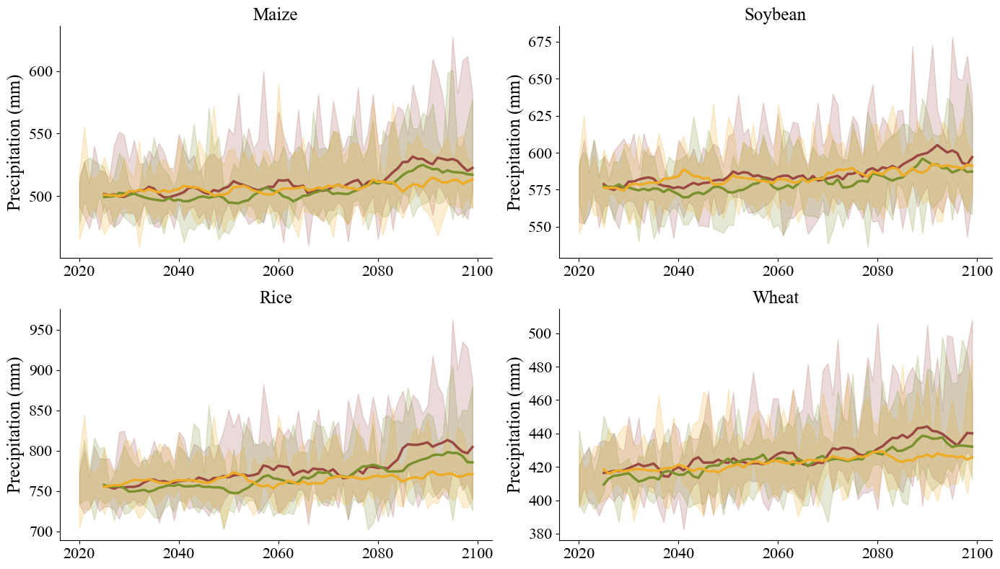

In [361]:
import matplotlib.patches as mpatches  # 导入用于创建色块的模块

# 定义每个情景的颜色
ssp_colors = {
    'SSP126': '#ECAC27',
    'SSP370': '#79902D',
    'SSP585': '#9A4942'
}

# 用于存储图例色块
legend_patches = [mpatches.Patch(color=ssp_colors[ssp], label=ssp) for ssp in ss]

# 开始绘制图形
fig, axs = plt.subplots(2, 2, figsize=(14, 8))  # 4行1列布局
axs = axs.flatten()  # 将子图轴展平成1D数组，方便遍历

# 遍历字典进行绘图
for idx, (crop, results) in enumerate(crop_data.items()):
    ax = axs[idx]  # 获取当前子图轴
    for ssp in ss:
        yr_transposed = results[ssp].T
        
        # 去除每个年份的最小值和最大值
        yr_filtered = []
        for yr in yr_transposed:
            yr_sorted = np.sort(yr)
            yr_filtered.append(yr_sorted[1:-1])  # 去除最小值和最大值
        
        # 转回原来的形状
        yr_filtered = np.array(yr_filtered).T
        
        # 计算去除极值后的均值和范围
        mean_yr = np.median(yr_filtered, axis=0) 
        min_yr = yr_filtered.min(axis=0)
        max_yr = yr_filtered.max(axis=0)
        window_size = 6  # 可以调整窗口大小以控制平滑度
        bb_smooth = pd.Series(mean_yr).rolling(window=window_size).mean()

        # 绘制曲线，设置对应的颜色
        ax.plot(years, bb_smooth, linewidth=2.5, color=ssp_colors[ssp])
        
        # 绘制均值和范围
        ax.fill_between(years, min_yr, max_yr, color=ssp_colors[ssp], alpha=0.2)
    # ax.axvspan(2035, 2045, color='gray', alpha=0.3)
    # 隐藏右侧和顶部的轴
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.tick_params(axis='both', labelsize=16)
    # 隐藏网格线
    ax.grid(False)
    ax.set_title(crop_name[idx], fontsize=18)
    # 除了最后一张子图，隐藏X轴
    # if idx < len(crops) - 1:
    #     ax.set_xticklabels([])
    # else:
    # ax.set_xlabel('Year', fontsize=18)
        
    # Y轴标签
    ax.set_ylabel('Precipitation (mm)', fontsize=18)

# 调整子图之间的间距
plt.subplots_adjust(hspace=0.3)

# 添加全局图例在最下方，将线条换为色块
# fig.legend(handles=legend_patches, loc='lower center', bbox_to_anchor=(0.5, -0.0), ncol=len(ss), fontsize=18, frameon=False)

plt.tight_layout()
# 保存图像
plt.savefig(r'F:\paper3_fig_v2\climate\pr\a_fig\pr_timeseries.png', dpi=300)

# 显示图像
plt.show()


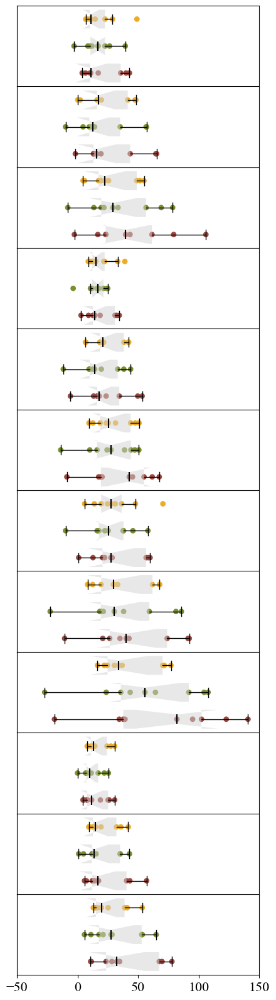

In [360]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.patches as mpatches
import matplotlib.gridspec as gridspec
import xarray as xr
from os.path import join

# 定义每个情景的颜色
ssp_colors = {
    'SSP126': '#ECAC27',
    'SSP370': '#79902D',
    'SSP585': '#9A4942'
}

# 作物名称列表
crop_name = ['Maize', 'Soybean', 'Rice', 'Wheat']
periods = ['Near-term', 'Mid-term', 'Long-term']  # 三个时期
ss = ['SSP126', 'SSP370', 'SSP585']  # 你需要定义的情景列表

# 用于存储图例色块
legend_patches = [mpatches.Patch(color=ssp_colors[ssp], label=ssp) for ssp in ss]

# 作物与情景数据
crops = list(crop_data.keys())

# 存储差值数据用于绘制箱型图
diff_data = {crop: {period: [] for period in periods} for crop in crops}

# 遍历字典进行计算每个作物在三个时期的差值
for i, (crop, results) in enumerate(crop_data.items()):

    # 计算每个位置的最大值
    fpy = xr.open_dataset(join(r'F:\paper3_fig_v2\climate\pr\gswp3_w5e5', F'{crop}_pr.nc'), decode_times=False).crop_Precipitation_nonIrr_annualtot
    fpy=fpy.where(fpy>0)
    for ssp in ss:
        # 三个时间段划分：近、中、远期
        periods_indices = {
            'Near-term': (0, 20),   # 前20年
            'Mid-term': (20, 50),   # 中间30年
            'Long-term': (50, 80)   # 最后30年
        }
        
        for period, (start, end) in periods_indices.items():
            # 计算每个时期的平均值与基准期的差值
            period_mean = results[ssp][:, start:end].mean(axis=1)
            diff = period_mean - fpy.mean().values
            diff_data[crop][period].append(diff)

# 创建紧凑排列的子图
fig = plt.figure(figsize=(4.5, 16))
gs = gridspec.GridSpec(12, 1, hspace=0)  # hspace=0 表示没有行间距

# 将每个作物-时期组合绘制为一个子图
axes = []
for i, crop in enumerate(crops):
    for j, period in enumerate(periods):
        ax = plt.subplot(gs[i * len(periods) + j])
        axes.append(ax)
        ss = ['SSP126', 'SSP370', 'SSP585']  # 你需要定义的情景列表
        data_to_plot = [diff_data[crop][period][k] for k, ssp in enumerate(ss)]
        data_to_plot=data_to_plot[::-1]
        ss=ss[::-1]
        # 绘制横向箱型图
        box = ax.boxplot(data_to_plot, patch_artist=True, vert=False, widths=0.7, notch=True, showfliers=False,
                         boxprops=dict(facecolor='lightgrey', edgecolor='none', linewidth=1),
                         whiskerprops=dict(linewidth=1),
                         capprops=dict(linewidth=1),
                         medianprops=dict(color='black', linewidth=1.5))

        # 设置箱体的透明度
        for patch in box['boxes']:
            patch.set_facecolor('lightgrey')
            patch.set_alpha(0.5)  # 设置透明度
            patch.set_edgecolor('none')  # 去掉边缘
        
        # 为每种情景绘制散点图
        for k, (data, ssp) in enumerate(zip(data_to_plot, ss)):
            ax.scatter(data, [k + 1] * len(data), color=ssp_colors[ssp], alpha=1, s=40, edgecolor='none')
        
        # 显示分位数和均值
        # for median in box['medians']:
        #     ax.plot([median.get_xdata()[1]] * 2, [0, len(data_to_plot) + 1], color='red', linestyle='--')
        # for mean in box['means']:
        #     ax.plot([mean.get_xdata()[1]] * 2, [0, len(data_to_plot) + 1], color='blue', linestyle='--')
        for median, mean in zip(box['medians'], box['means']):
            ax.plot([median.get_xdata()[1]] * 2, [0, len(data_to_plot) + 1], color='red', linestyle='--')
            ax.plot([mean.get_xdata()[1]] * 2, [0, len(data_to_plot) + 1], color='blue', linestyle='--')

        # 隐藏 y 轴的刻度和标签
        ax.tick_params(axis='y', which='both', left=False, labelleft=False)
        # 设置 x 轴范围
        ax.set_xlim([-50, 150])
        # ax.set_xticks(np.arange(-2, 8.1, 2))
        ax.tick_params(axis='both', labelsize=16)
        
        # 隐藏 x 轴刻度和标签，除非是最后一个子图
        if i * len(periods) + j != 11:
            ax.tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
            ax.set_xticks([])
            ax.spines['bottom'].set_visible(False)

# 在最底部的子图显示 x 轴的标签
# axes[-1].set_xlabel('Precipitation Change (mm)', fontsize=16)

# 添加图例到右侧（如果需要）
# fig.legend(handles=legend_patches, loc='upper right', fontsize=12, frameon=False)

# 调整子图边距以防止标签被切掉
plt.tight_layout()

# 保存图像
plt.savefig(r'F:\paper3_fig_v2\climate\pr\a_fig\fig1_pr_change_periods_subplot_v2.png', dpi=300)

# 显示图像
plt.show()


In [312]:
import os
import xarray as xr
import pandas as pd
import numpy as np

# 场景列表
crops = ['maiz', 'soyb', 'rice', 'wheat']
ss = ['SSP585']
fp = r'F:\CWatM\cwatm_output\global_future'
day=[153,153,122,122]
# 初始化结果字典
data_dict = {}

# 遍历每个作物
for i,crop in enumerate(crops):
    # ori_rf = xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'crop_Tavg_nonIrr_annualtot_{crop}.nc'), decode_times=False).crop_Tavg_nonIrr_annualtot.mean(dim='time')
    # ori_irr = xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'crop_Tavg_Irr_annualtot_{crop}.nc'), decode_times=False).crop_Tavg_Irr_annualtot.mean(dim='time')
    # ori = ori_rf.fillna(0) + ori_irr.fillna(0)
    # ori=ori.where(ori>0).values

    # 初始化用于存储结果的字典
    # results = {}
    data_dict[crop] = {}
    # 遍历每个情景
    for ssp in ss:
        institution_means_list = []

        for inst in os.listdir(fp):
            if inst == 'GWSP3_W5E5' or inst == 'MRI-ESM2-0':
                continue


        csr = xr.open_dataset(join(r'F:\paper3_fig_v2\climate\pr\a_median', F'median_{crop}_{ssp}_pr.nc'), decode_times=False).crop_Precipitation_nonIrr_annualtot
        units = csr.time.attrs['units']
        calendar = csr.time.attrs.get('calendar', 'standard')
        dates = decode_cf_datetime(csr.time.values, units, calendar)
        csr = csr.assign_coords(time=("time", dates))
        csr = csr.where(csr != 0, np.nan)

        data_dict[crop][ssp] = csr


In [313]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.patches as mpatches
import matplotlib.gridspec as gridspec
import xarray as xr
from os.path import join
day=[153,153,122,122]
# 定义每个情景的颜色
ssp_colors = {
    'SSP126': '#ECAC27',
    'SSP370': '#79902D',
    'SSP585': '#9A4942'
}

# 作物名称列表
crop_name = ['Maize', 'Soybean', 'Rice', 'Wheat']
periods = ['Near-term', 'Mid-term', 'Long-term']  # 三个时期
ss = ['SSP585']
# ss = ['SSP126', 'SSP370', 'SSP585']  # 你需要定义的情景列表

# 用于存储图例色块
legend_patches = [mpatches.Patch(color=ssp_colors[ssp], label=ssp) for ssp in ss]

# 作物与情景数据
crops = list(data_dict.keys())

# 存储差值数据用于绘制箱型图
diff_data = {crop: {period: [] for period in periods} for crop in crops}

# 遍历字典进行计算每个作物在三个时期的差值
for i, (crop, results) in enumerate(data_dict.items()):
    fpy = xr.open_dataset(join(r'F:\paper3_fig_v2\climate\pr\gswp3_w5e5', F'{crop}_pr.nc'), decode_times=False).crop_Precipitation_nonIrr_annualtot
    fpy=fpy.where(fpy>0)
    for ssp in ss:
        # 三个时间段划分：近、中、远期
        periods_indices = {
            'Near-term': (0, 20),   # 前20年
            'Mid-term': (20, 50),   # 中间30年
            'Long-term': (50, 80)   # 最后30年
        }
        
        for period, (start, end) in periods_indices.items():
            # (mean_data[-10:, :, :].mean(dim='time') - ori) / ori * 100
            # 计算每个时期的平均值与基准期的差值) / fpy * 100
            diff = (results[ssp][ start:end,:,:].mean(dim='time') - fpy)
            # diff = period_mean - fpy.mean().values/day[i]
            diff_data[crop][period]=diff

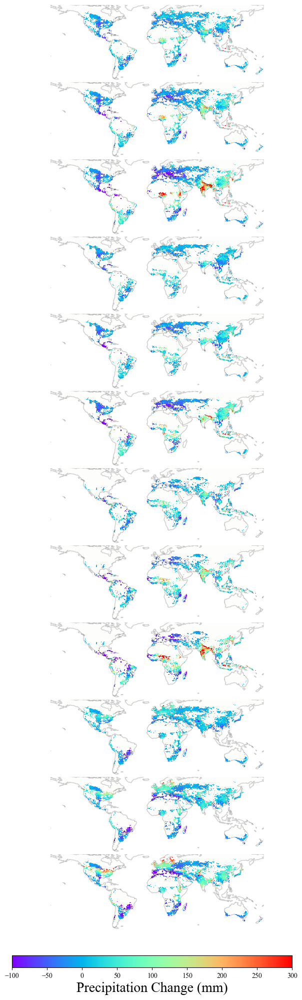

In [314]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.gridspec import GridSpec
import matplotlib as mpl
# 创建紧凑排列的子图
fig = plt.figure(figsize=(8, 24))
gs = gridspec.GridSpec(12, 1, hspace=0)  # hspace=0 表示没有行间距

# 将每个作物-时期组合绘制为一个子图
axes = []
for i, crop in enumerate(crops):
    for j, period in enumerate(periods):
        # ax = plt.subplot(gs[i * len(periods) + j])
        # axes.append(ax)
        # data_to_plot = [diff_data[crop][period][k] for k, ssp in enumerate(ss)]

        difference = diff_data[crop][period]

        # 在4行1列的第 idx 个位置创建子图
        ax = fig.add_subplot(gs[i * len(periods) + j], projection=ccrs.PlateCarree())
        
        # 设置显示范围为南纬60°到北纬60°
        ax.set_extent([-180, 180, -60, 70], crs=ccrs.PlateCarree())
        
        # 添加地图特征
        ax.add_feature(cfeature.COASTLINE, alpha=0.1)
        ax.add_feature(cfeature.LAND, edgecolor='black', alpha=0.1)
        
        # 绘制数据并设置颜色带
        im = difference.plot(ax=ax, transform=ccrs.PlateCarree(), cmap='rainbow', 
                            vmin=-100, vmax=300,  add_colorbar=False)
        
        # 移除网格线
        gl = ax.gridlines(draw_labels=False)
        gl.xlines = False
        gl.ylines = False

        # 去除四周边框
        ax.spines['geo'].set_visible(False)
        # ax.text(-0.05, 0.5, crop, transform=ax.transAxes, fontsize=14, 
        #         verticalalignment='center', horizontalalignment='center', rotation=90)

# 添加一个全局的颜色带
cbar_ax = fig.add_axes([0.15, 0.08, 0.7, 0.01])  # 颜色带的位置: [左, 下, 宽, 高], extend='both'
cbar = fig.colorbar(im, cax=cbar_ax, orientation='horizontal', pad=0.03, shrink=1, aspect=50)
cbar.set_label('Precipitation Change (mm)', fontsize=20)

# 保存图像
plt.savefig(r'F:\paper3_fig_v2\climate\pr\mean_instu_pr_ssp585_change_combined.png', dpi=300)
plt.show()



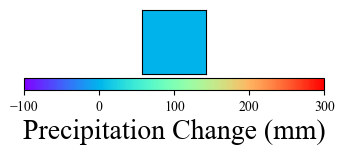

In [63]:
import matplotlib.pyplot as plt
import numpy as np

# 创建一个图形用于颜色带
fig_colorbar = plt.figure(figsize=(6, 2))  # 设定颜色带图像的尺寸
ax_colorbar = fig_colorbar.add_axes([0.1, 0.3, 0.8, 0.4])  # [left, bottom, width, height]

# 创建一个伪数据集以绘制颜色带
data = np.random.rand(10, 10)  # 可以使用任意数据，只是为了展示颜色带
im = ax_colorbar.imshow(data, cmap='rainbow', vmin=-100, vmax=300)

# 添加颜色带
cbar = fig_colorbar.colorbar(im, ax=ax_colorbar, orientation='horizontal', pad=0.05, shrink=0.8, aspect=25)
cbar.set_label('Precipitation Change (mm)', fontsize=20)

# 隐藏坐标轴
ax_colorbar.set_xticks([])
ax_colorbar.set_yticks([])

# 保存颜色带图像
plt.savefig(r'F:\paper3_fig_v2\climate\pr\a_fig\pr_colorbar_only.png', dpi=300, bbox_inches='tight')
plt.show()


### temperature

In [65]:
import os
import xarray as xr
import pandas as pd
import numpy as np
from os.path import join
# 场景列表
crops = ['maiz', 'soyb', 'rice', 'wheat']
ss = ['ssp126', 'ssp370', 'ssp585']
fp = r'F:\CWatM\cwatm_output\global_future'

# 初始化结果字典
data_dict = {}

# 遍历每个作物
for crop in crops:
    if crop=='wheat':
        fpy = xr.open_dataset(join(r'F:\paper3_fig_v2\climate\tasmax', F'gswp3_w5e5_swh_tas.nc'), decode_times=False).tasmax.fillna(0)+ xr.open_dataset(join(r'F:\paper3_fig_v2\climate\tasmax', F'gswp3_w5e5_wwh_tas.nc'), decode_times=False).tasmax.fillna(0)
    else:
        fpy = xr.open_dataset(join(r'F:\paper3_fig_v2\climate\tasmax', F'gswp3_w5e5_{crop}_tas.nc'), decode_times=False).tasmax
    # fpy = xr.open_dataset(join(r'F:\paper3_fig_v2\climate\tas', F'gswp3_w5e5_{crop}_tas.nc'), decode_times=False).tas
    fpy=fpy[:].where(fpy>0)
    fpy=fpy[-30:]
    fpy.to_netcdf(join(r'F:\paper3_fig_v2\climate\tasmax\a_median',F'median_{crop}_his_tasmax.nc'))
    # 初始化用于存储结果的字典
    results = {}

    # 遍历每个情景
    for ssp in ss:
        institution_means_list = []

        for inst in os.listdir(fp):
            if inst == 'GWSP3_W5E5' or inst == 'MRI-ESM2-0':
                continue
            filepath = join(r'F:\paper3_fig_v2\climate\tasmax')
            if crop=='wheat':
                csr = xr.open_dataset(join(filepath, F'{inst}_{ssp}_swh_tas.nc'), decode_times=False).tasmax.fillna(0)+ xr.open_dataset(join(filepath, F'{inst}_{ssp}_wwh_tas.nc'), decode_times=False).tasmax.fillna(0)
            else:
                csr = xr.open_dataset(join(filepath, F'{inst}_{ssp}_{crop}_tas.nc'), decode_times=False).tasmax
            csr = csr.where(csr != 0, np.nan)

            institution_means_list.append(csr)

        combined_means = xr.concat(institution_means_list, dim='institution')
        overall_mean = combined_means.median(dim='institution', skipna=True)
        overall_mean.to_netcdf(join(r'F:\paper3_fig_v2\climate\tasmax\a_median',F'median_{crop}_{ssp}_tasmax.nc'))

In [17]:
import os
import xarray as xr
import numpy as np
from os.path import join
import pandas as pd

# 设置默认字体为 Times New Roman
import matplotlib as mpl
mpl.rcParams['font.family'] = 'Times New Roman'

# 场景列表
crops = ['maiz', 'soyb', 'rice', 'wheat']
ss = ['ssp126', 'ssp370', 'ssp585']
fp =  r'F:\CWatM\cwatm_output\global_future'

# 初始化一个字典来存储所有作物和情景的数据
crop_data = {}

# 遍历每个作物
for crop in crops:
    # 初始化用于存储结果的字典
    results = {}

    # 遍历每个情景
    for ssp in ss:
        yr_values = []
        for inst in os.listdir(fp):
            if inst == 'GWSP3_W5E5' or inst == 'MRI-ESM2-0':
                continue
            filepath = join(r'F:\paper3_fig_v2\climate\tas')
            if crop=='wheat':
                csr = xr.open_dataset(join(filepath, F'{inst}_{ssp}_swh_tas.nc'), decode_times=False).tas.fillna(0)+ xr.open_dataset(join(filepath, F'{inst}_{ssp}_wwh_tas.nc'), decode_times=False).tas.fillna(0)
            else:
                csr = xr.open_dataset(join(filepath, F'{inst}_{ssp}_{crop}_tas.nc'), decode_times=False).tas
            csr=csr.where(csr>0)
            yr = csr.mean(dim=['lat', 'lon'])
            yr_values.append(yr)

        # 存储每个情景的结果
        results[ssp] = np.array(yr_values)
    
    # 存储每个作物的所有情景结果
    crop_data[crop] = results


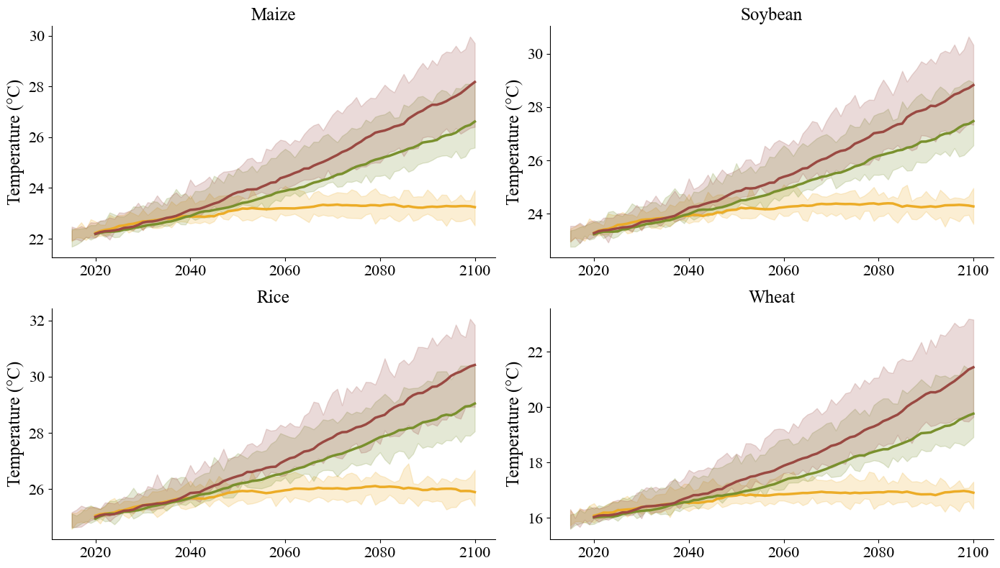

In [40]:
import matplotlib.patches as mpatches  # 导入用于创建色块的模块
import matplotlib.pyplot as plt
# 定义每个情景的颜色
ssp_colors = {
    'ssp126': '#ECAC27',
    'ssp370': '#79902D',
    'ssp585': '#9A4942'
}
years=np.arange(2015,2101)
crop_name = ['Maize', 'Soybean', 'Rice', 'Wheat']
# 用于存储图例色块
legend_patches = [mpatches.Patch(color=ssp_colors[ssp], label=ssp) for ssp in ss]

# 开始绘制图形
fig, axs = plt.subplots(2, 2, figsize=(14, 8))  # 4行1列布局
axs = axs.flatten()  # 将子图轴展平成1D数组，方便遍历

# 遍历字典进行绘图
for idx, (crop, results) in enumerate(crop_data.items()):
    ax = axs[idx]  # 获取当前子图轴
    for ssp in ss:
        yr_transposed = results[ssp].T
        
        # 去除每个年份的最小值和最大值
        yr_filtered = []
        for yr in yr_transposed:
            yr_sorted = np.sort(yr)
            yr_filtered.append(yr_sorted[1:-1])  # 去除最小值和最大值
        
        # 转回原来的形状
        yr_filtered = np.array(yr_filtered).T
        
        # 计算去除极值后的均值和范围
        mean_yr = np.median(yr_filtered, axis=0) 
        min_yr = yr_filtered.min(axis=0)
        max_yr = yr_filtered.max(axis=0)
        window_size = 6  # 可以调整窗口大小以控制平滑度
        bb_smooth = pd.Series(mean_yr).rolling(window=window_size).mean()

        # 绘制曲线，设置对应的颜色
        ax.plot(years, bb_smooth, linewidth=2.5, color=ssp_colors[ssp])
        
        # 绘制均值和范围
        ax.fill_between(years, min_yr, max_yr, color=ssp_colors[ssp], alpha=0.2)
    # ax.axvspan(2035, 2045, color='gray', alpha=0.3)
    # 隐藏右侧和顶部的轴
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.tick_params(axis='both', labelsize=16)
    # 隐藏网格线
    ax.grid(False)
    ax.set_title(crop_name[idx], fontsize=18)
    # 除了最后一张子图，隐藏X轴
    # if idx < len(crops) - 1:
    #     ax.set_xticklabels([])
    # else:
    # ax.set_xlabel('Year', fontsize=18)
        
    # Y轴标签
    ax.set_ylabel('Temperature (°C)', fontsize=18)

# 调整子图之间的间距
plt.subplots_adjust(hspace=0.3)

# 添加全局图例在最下方，将线条换为色块
# fig.legend(handles=legend_patches, loc='lower center', bbox_to_anchor=(0.5, -0.0), ncol=len(ss), fontsize=18, frameon=False)

plt.tight_layout()
# 保存图像
plt.savefig(r'F:\paper3_fig_v2\climate\tas\a_fig\tas_timeseries.png', dpi=300)

# 显示图像
plt.show()


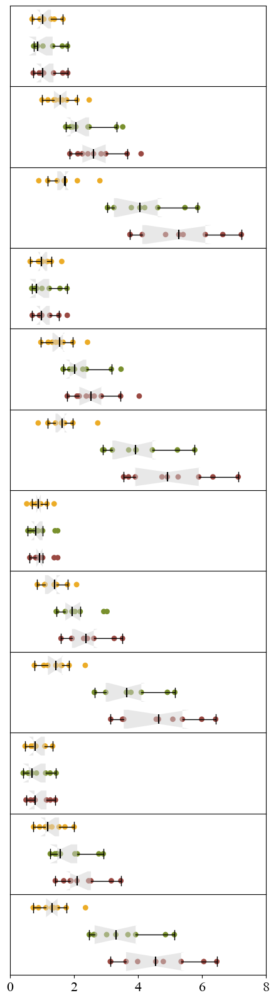

In [36]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.patches as mpatches
import matplotlib.gridspec as gridspec
import xarray as xr
from os.path import join

# 定义每个情景的颜色
ssp_colors = {
    'ssp126': '#ECAC27',
    'ssp370': '#79902D',
    'ssp585': '#9A4942'
}

# 作物名称列表
crop_name = ['Maize', 'Soybean', 'Rice', 'Wheat']
periods = ['Near-term', 'Mid-term', 'Long-term']  # 三个时期
ss = ['ssp126', 'ssp370', 'ssp585']  # 你需要定义的情景列表

# 用于存储图例色块
legend_patches = [mpatches.Patch(color=ssp_colors[ssp], label=ssp) for ssp in ss]

# 作物与情景数据
crops = list(crop_data.keys())

# 存储差值数据用于绘制箱型图
diff_data = {crop: {period: [] for period in periods} for crop in crops}

# 遍历字典进行计算每个作物在三个时期的差值
for i, (crop, results) in enumerate(crop_data.items()):

    # 计算每个位置的最大值
    if crop=='wheat':
        fpy = xr.open_dataset(join(r'F:\paper3_fig_v2\climate\tas', F'gswp3_w5e5_swh_tas.nc'), decode_times=False).tas.fillna(0)+ xr.open_dataset(join(r'F:\paper3_fig_v2\climate\tas', F'gswp3_w5e5_wwh_tas.nc'), decode_times=False).tas.fillna(0)
    else:
        fpy = xr.open_dataset(join(r'F:\paper3_fig_v2\climate\tas', F'gswp3_w5e5_{crop}_tas.nc'), decode_times=False).tas
    # fpy = xr.open_dataset(join(r'F:\paper3_fig_v2\climate\tas', F'gswp3_w5e5_{crop}_tas.nc'), decode_times=False).tas
    fpy=fpy[:].where(fpy>0)
    fpy=fpy[-30:]
    for ssp in ss:
        # 三个时间段划分：近、中、远期
        periods_indices = {
            'Near-term': (0, 20),   # 前20年
            'Mid-term': (20, 50),   # 中间30年
            'Long-term': (50, 80)   # 最后30年
        }
        
        for period, (start, end) in periods_indices.items():
            # 计算每个时期的平均值与基准期的差值
            period_mean = results[ssp][:,5:][:, start:end].mean(axis=1)
            diff = period_mean - fpy.mean().values
            diff_data[crop][period].append(diff)

# 创建紧凑排列的子图
fig = plt.figure(figsize=(4.5, 16))
gs = gridspec.GridSpec(12, 1, hspace=0)  # hspace=0 表示没有行间距

# 将每个作物-时期组合绘制为一个子图
axes = []
for i, crop in enumerate(crops):
    for j, period in enumerate(periods):
        ax = plt.subplot(gs[i * len(periods) + j])
        axes.append(ax)
        ss = ['ssp126', 'ssp370', 'ssp585'] # 你需要定义的情景列表
        data_to_plot = [diff_data[crop][period][k] for k, ssp in enumerate(ss)]
        data_to_plot=data_to_plot[::-1]
        ss=ss[::-1]
        # 绘制横向箱型图
        box = ax.boxplot(data_to_plot, patch_artist=True, vert=False, widths=0.7, notch=True, showfliers=False,
                         boxprops=dict(facecolor='lightgrey', edgecolor='none', linewidth=1),
                         whiskerprops=dict(linewidth=1),
                         capprops=dict(linewidth=1),
                         medianprops=dict(color='black', linewidth=1.5))

        # 设置箱体的透明度
        for patch in box['boxes']:
            patch.set_facecolor('lightgrey')
            patch.set_alpha(0.5)  # 设置透明度
            patch.set_edgecolor('none')  # 去掉边缘
        
        # 为每种情景绘制散点图
        for k, (data, ssp) in enumerate(zip(data_to_plot, ss)):
            ax.scatter(data, [k + 1] * len(data), color=ssp_colors[ssp], alpha=1, s=40, edgecolor='none')
        
        # 显示分位数和均值
        # for median in box['medians']:
        #     ax.plot([median.get_xdata()[1]] * 2, [0, len(data_to_plot) + 1], color='red', linestyle='--')
        # for mean in box['means']:
        #     ax.plot([mean.get_xdata()[1]] * 2, [0, len(data_to_plot) + 1], color='blue', linestyle='--')
        for median, mean in zip(box['medians'], box['means']):
            ax.plot([median.get_xdata()[1]] * 2, [0, len(data_to_plot) + 1], color='red', linestyle='--')
            ax.plot([mean.get_xdata()[1]] * 2, [0, len(data_to_plot) + 1], color='blue', linestyle='--')

        # 隐藏 y 轴的刻度和标签
        ax.tick_params(axis='y', which='both', left=False, labelleft=False)
        # 设置 x 轴范围
        ax.set_xlim([-0, 8])
        # ax.set_xticks(np.arange(-2, 8.1, 2))
        ax.tick_params(axis='both', labelsize=16)
        
        # 隐藏 x 轴刻度和标签，除非是最后一个子图
        if i * len(periods) + j != 11:
            ax.tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
            ax.set_xticks([])
            ax.spines['bottom'].set_visible(False)

# 在最底部的子图显示 x 轴的标签
# axes[-1].set_xlabel('Precipitation Change (mm)', fontsize=16)

# 添加图例到右侧（如果需要）
# fig.legend(handles=legend_patches, loc='upper right', fontsize=12, frameon=False)

# 调整子图边距以防止标签被切掉
plt.tight_layout()

# 保存图像
plt.savefig(r'F:\paper3_fig_v2\climate\tas\a_fig\fig1_tas_change_periods_subplot_v2.png', dpi=300)

# 显示图像
plt.show()


In [47]:
import os
import xarray as xr
import pandas as pd
import numpy as np

# 场景列表
crops = ['maiz', 'soyb', 'rice', 'wheat']
ss = ['ssp585']
fp = r'F:\CWatM\cwatm_output\global_future'
day=[153,153,122,122]
# 初始化结果字典
data_dict = {}

# 遍历每个作物
for i,crop in enumerate(crops):
    # ori_rf = xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'crop_Tavg_nonIrr_annualtot_{crop}.nc'), decode_times=False).crop_Tavg_nonIrr_annualtot.mean(dim='time')
    # ori_irr = xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'crop_Tavg_Irr_annualtot_{crop}.nc'), decode_times=False).crop_Tavg_Irr_annualtot.mean(dim='time')
    # ori = ori_rf.fillna(0) + ori_irr.fillna(0)
    # ori=ori.where(ori>0).values

    # 初始化用于存储结果的字典
    # results = {}
    data_dict[crop] = {}
    # 遍历每个情景
    for ssp in ss:
        csr = xr.open_dataset(join(r'F:\paper3_fig_v2\climate\tas\a_median', F'median_{crop}_{ssp}_tas.nc'), decode_times=False).tas
 
        csr = csr.where(csr != 0, np.nan)

        data_dict[crop][ssp] = csr[5:]


In [54]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.patches as mpatches
import matplotlib.gridspec as gridspec
import xarray as xr
from os.path import join
ssp_colors = {
    'ssp126': '#ECAC27',
    'ssp370': '#79902D',
    'ssp585': '#9A4942'
}

# 作物名称列表
crop_name = ['Maize', 'Soybean', 'Rice', 'Wheat']
periods = ['Near-term', 'Mid-term', 'Long-term']  # 三个时期
ss = ['ssp585']  # 你需要定义的情景列表
# ss = ['SSP585']
# ss = ['SSP126', 'SSP370', 'SSP585']  # 你需要定义的情景列表

# 用于存储图例色块
legend_patches = [mpatches.Patch(color=ssp_colors[ssp], label=ssp) for ssp in ss]

# 作物与情景数据
crops = list(data_dict.keys())

# 存储差值数据用于绘制箱型图
diff_data = {crop: {period: [] for period in periods} for crop in crops}

# 遍历字典进行计算每个作物在三个时期的差值
for i, (crop, results) in enumerate(data_dict.items()):
    fpy = xr.open_dataset(join(r'F:\paper3_fig_v2\climate\tas\a_median', F'median_{crop}_his_tas.nc'), decode_times=False).tas.mean(dim='year')
    fpy=fpy.where(fpy>0)
    for ssp in ss:
        # 三个时间段划分：近、中、远期
        periods_indices = {
            'Near-term': (0, 20),   # 前20年
            'Mid-term': (20, 50),   # 中间30年
            'Long-term': (50, 80)   # 最后30年
        }
        
        for period, (start, end) in periods_indices.items():
            # (mean_data[-10:, :, :].mean(dim='time') - ori) / ori * 100
            # 计算每个时期的平均值与基准期的差值) / fpy * 100
            diff = (results[ssp][ start:end,:,:].mean(dim='year') - fpy)
            # diff = period_mean - fpy.mean().values/day[i]
            diff_data[crop][period]=diff

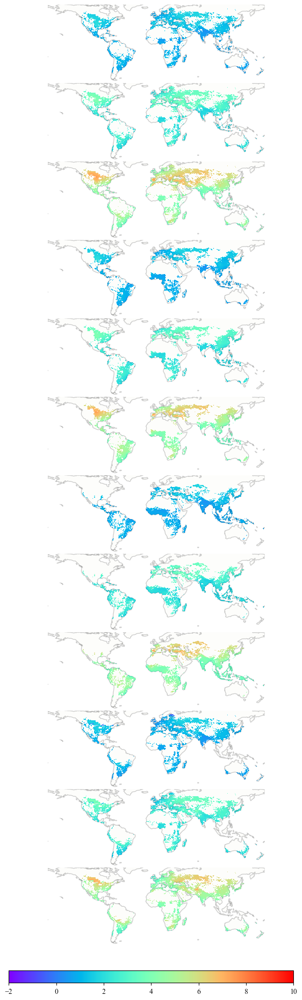

In [61]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.gridspec import GridSpec
import matplotlib as mpl
# 创建紧凑排列的子图
fig = plt.figure(figsize=(8, 24))
gs = gridspec.GridSpec(12, 1, hspace=0)  # hspace=0 表示没有行间距

# 将每个作物-时期组合绘制为一个子图
axes = []
for i, crop in enumerate(crops):
    for j, period in enumerate(periods):
        # ax = plt.subplot(gs[i * len(periods) + j])
        # axes.append(ax)
        # data_to_plot = [diff_data[crop][period][k] for k, ssp in enumerate(ss)]

        difference = diff_data[crop][period]

        # 在4行1列的第 idx 个位置创建子图
        ax = fig.add_subplot(gs[i * len(periods) + j], projection=ccrs.PlateCarree())
        
        # 设置显示范围为南纬60°到北纬60°
        ax.set_extent([-180, 180, -60, 70], crs=ccrs.PlateCarree())
        
        # 添加地图特征
        ax.add_feature(cfeature.COASTLINE, alpha=0.1)
        ax.add_feature(cfeature.LAND, edgecolor='black', alpha=0.1)
        
        # 绘制数据并设置颜色带
        im = difference.plot(ax=ax, transform=ccrs.PlateCarree(), cmap='rainbow', 
                            vmin=-2, vmax=10,  add_colorbar=False)
        
        # 移除网格线
        gl = ax.gridlines(draw_labels=False)
        gl.xlines = False
        gl.ylines = False

        # 去除四周边框
        ax.spines['geo'].set_visible(False)
        # ax.text(-0.05, 0.5, crop, transform=ax.transAxes, fontsize=14, 
        #         verticalalignment='center', horizontalalignment='center', rotation=90)

# 添加一个全局的颜色带
cbar_ax = fig.add_axes([0.15, 0.08, 0.7, 0.01])  # 颜色带的位置: [左, 下, 宽, 高], extend='both'
cbar = fig.colorbar(im, cax=cbar_ax, orientation='horizontal', pad=0.03, shrink=1, aspect=50)
# cbar.set_label('Precipitation Change (mm)', fontsize=20)

# 保存图像
plt.savefig(r'F:\paper3_fig_v2\climate\tas\a_fig\mean_instu_tas_ssp585_change_combined.png', dpi=300)
plt.show()



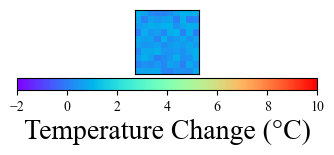

In [62]:
import matplotlib.pyplot as plt
import numpy as np

# 创建一个图形用于颜色带
fig_colorbar = plt.figure(figsize=(6, 2))  # 设定颜色带图像的尺寸
ax_colorbar = fig_colorbar.add_axes([0.1, 0.3, 0.8, 0.4])  # [left, bottom, width, height]

# 创建一个伪数据集以绘制颜色带
data = np.random.rand(10, 10)  # 可以使用任意数据，只是为了展示颜色带
im = ax_colorbar.imshow(data, cmap='rainbow', vmin=-2, vmax=10)

# 添加颜色带
cbar = fig_colorbar.colorbar(im, ax=ax_colorbar, orientation='horizontal', pad=0.05, shrink=0.8, aspect=25)
cbar.set_label('Temperature Change (°C)', fontsize=20)

# 隐藏坐标轴
ax_colorbar.set_xticks([])
ax_colorbar.set_yticks([])

# 保存颜色带图像
plt.savefig(r'F:\paper3_fig_v2\climate\tas\a_fig\tas_colorbar_only.png', dpi=300, bbox_inches='tight')
plt.show()


### ETa

In [341]:
import os
import xarray as xr
import numpy as np
from os.path import join
import pandas as pd

# 设置默认字体为 Times New Roman
import matplotlib as mpl
mpl.rcParams['font.family'] = 'Times New Roman'

# 场景列表
crops = ['maiz', 'soyb', 'rice', 'wheat']
ss = ['SSP126', 'SSP370', 'SSP585']
fp = r'F:\paper3_fig_v2\climate\eta'

# 初始化一个字典来存储所有作物和情景的数据
crop_data = {}

# 遍历每个作物
for crop in crops:
    # 初始化用于存储结果的字典
    results = {}

    # 遍历每个情景
    for ssp in ss:
        yr_values = []
        for inst in os.listdir(fp):
            if inst == 'gswp3_w5e5' or inst == 'a_fig' or inst == 'a_median':
                continue
            filepath = join(fp, inst)

            csr = xr.open_dataset(join(filepath, F'{crop}_{ssp}_pr.nc'), decode_times=False).crop_eta_nonirr_annualtot
            units = csr.time.attrs['units']
            calendar = csr.time.attrs.get('calendar', 'standard')
            dates = decode_cf_datetime(csr.time.values, units, calendar)
            csr = csr.assign_coords(time=("time", dates))
            csr = csr.where(csr != 0, np.nan)
            yr = csr.mean(dim=['lat', 'lon'])
            yr_values.append(yr)

        # 存储每个情景的结果
        results[ssp] = np.array(yr_values)
    
    # 存储每个作物的所有情景结果
    crop_data[crop] = results


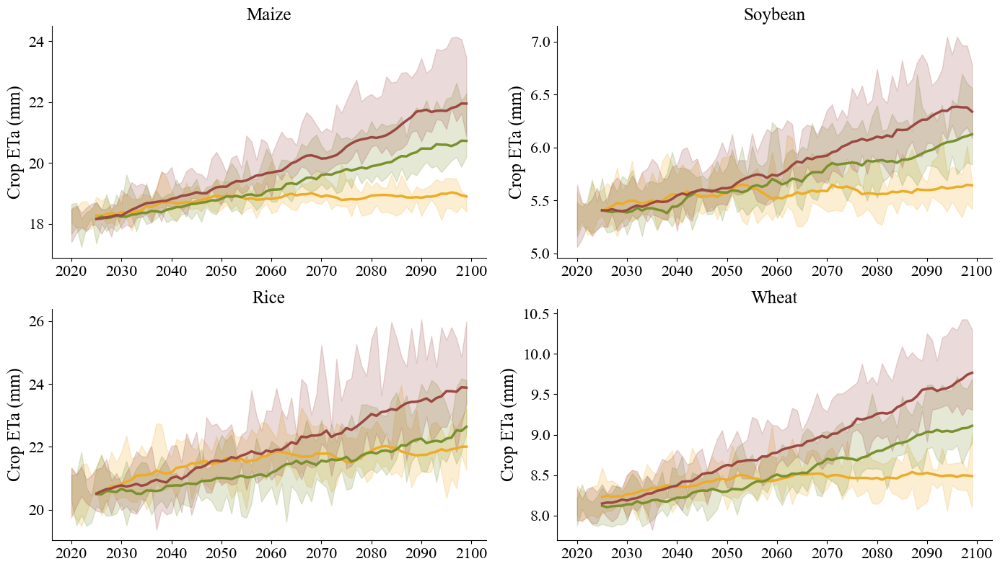

In [322]:
import matplotlib.patches as mpatches  # 导入用于创建色块的模块

# 定义每个情景的颜色
ssp_colors = {
    'SSP126': '#ECAC27',
    'SSP370': '#79902D',
    'SSP585': '#9A4942'
}

# 用于存储图例色块
legend_patches = [mpatches.Patch(color=ssp_colors[ssp], label=ssp) for ssp in ss]

# 开始绘制图形
fig, axs = plt.subplots(2, 2, figsize=(14, 8))  # 4行1列布局
axs = axs.flatten()  # 将子图轴展平成1D数组，方便遍历

# 遍历字典进行绘图
for idx, (crop, results) in enumerate(crop_data.items()):
    ax = axs[idx]  # 获取当前子图轴
    for ssp in ss:
        yr_transposed = results[ssp].T
        
        # 去除每个年份的最小值和最大值
        yr_filtered = []
        for yr in yr_transposed:
            yr_sorted = np.sort(yr)
            yr_filtered.append(yr_sorted[1:-1])  # 去除最小值和最大值
        
        # 转回原来的形状
        yr_filtered = np.array(yr_filtered).T
        
        # 计算去除极值后的均值和范围
        mean_yr = np.median(yr_filtered, axis=0) 
        min_yr = yr_filtered.min(axis=0)
        max_yr = yr_filtered.max(axis=0)
        window_size = 6  # 可以调整窗口大小以控制平滑度
        bb_smooth = pd.Series(mean_yr).rolling(window=window_size).mean()

        # 绘制曲线，设置对应的颜色
        ax.plot(years, bb_smooth, linewidth=2.5, color=ssp_colors[ssp])
        
        # 绘制均值和范围
        ax.fill_between(years, min_yr, max_yr, color=ssp_colors[ssp], alpha=0.2)
    # ax.axvspan(2035, 2045, color='gray', alpha=0.3)
    # 隐藏右侧和顶部的轴
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.tick_params(axis='both', labelsize=16)
    # 隐藏网格线
    ax.grid(False)
    ax.set_title(crop_name[idx], fontsize=18)
    # 除了最后一张子图，隐藏X轴
    # if idx < len(crops) - 1:
    #     ax.set_xticklabels([])
    # else:
    # ax.set_xlabel('Year', fontsize=18)
        
    # Y轴标签
    ax.set_ylabel('Crop ETa (mm)', fontsize=18)

# 调整子图之间的间距
plt.subplots_adjust(hspace=0.3)

# 添加全局图例在最下方，将线条换为色块
# fig.legend(handles=legend_patches, loc='lower center', bbox_to_anchor=(0.5, -0.0), ncol=len(ss), fontsize=18, frameon=False)

plt.tight_layout()
# 保存图像
plt.savefig(r'F:\paper3_fig_v2\climate\eta\a_fig\eta_timeseries.png', dpi=300)

# 显示图像
plt.show()


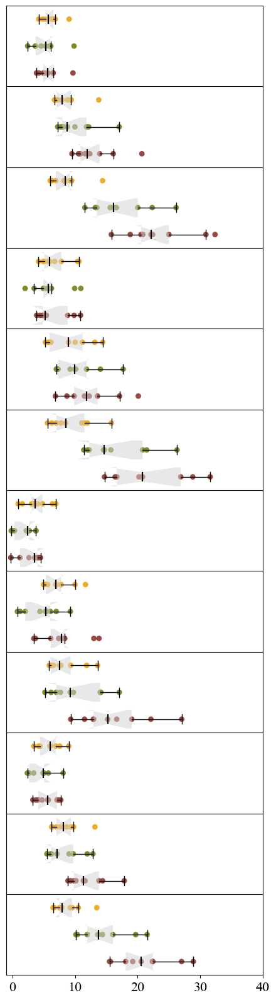

In [346]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.patches as mpatches
import matplotlib.gridspec as gridspec
import xarray as xr
from os.path import join

# 定义每个情景的颜色
ssp_colors = {
    'SSP126': '#ECAC27',
    'SSP370': '#79902D',
    'SSP585': '#9A4942'
}

# 作物名称列表
crop_name = ['Maize', 'Soybean', 'Rice', 'Wheat']
periods = ['Near-term', 'Mid-term', 'Long-term']  # 三个时期
ss = ['SSP126', 'SSP370', 'SSP585']  # 你需要定义的情景列表

# 用于存储图例色块
legend_patches = [mpatches.Patch(color=ssp_colors[ssp], label=ssp) for ssp in ss]

# 作物与情景数据
crops = list(crop_data.keys())

# 存储差值数据用于绘制箱型图
diff_data = {crop: {period: [] for period in periods} for crop in crops}

# 遍历字典进行计算每个作物在三个时期的差值
for i, (crop, results) in enumerate(crop_data.items()):

    # 计算每个位置的最大值
    fpy = xr.open_dataset(join(r'F:\paper3_fig_v2\climate\eta\gswp3_w5e5', F'{crop}_pr.nc'), decode_times=False).crop_eta_nonirr_annualtot
    fpy=fpy.where(fpy>0)
    for ssp in ss:
        # 三个时间段划分：近、中、远期
        periods_indices = {
            'Near-term': (0, 20),   # 前20年
            'Mid-term': (20, 50),   # 中间30年
            'Long-term': (50, 80)   # 最后30年
        }
        
        for period, (start, end) in periods_indices.items():
            # 计算每个时期的平均值与基准期的差值
            period_mean = results[ssp][:, start:end].mean(axis=1)
            diff = (period_mean - fpy.mean().values)/fpy.mean().values*100
            diff_data[crop][period].append(diff)

# 创建紧凑排列的子图
fig = plt.figure(figsize=(4.5, 16))
gs = gridspec.GridSpec(12, 1, hspace=0)  # hspace=0 表示没有行间距

# 将每个作物-时期组合绘制为一个子图
axes = []
for i, crop in enumerate(crops):
    for j, period in enumerate(periods):
        ax = plt.subplot(gs[i * len(periods) + j])
        axes.append(ax)
        ss = ['SSP126', 'SSP370', 'SSP585']  # 你需要定义的情景列表
        data_to_plot = [diff_data[crop][period][k] for k, ssp in enumerate(ss)]
        data_to_plot=data_to_plot[::-1]
        ss=ss[::-1]
        # 绘制横向箱型图
        box = ax.boxplot(data_to_plot, patch_artist=True, vert=False, widths=0.7, notch=True, showfliers=False,
                         boxprops=dict(facecolor='lightgrey', edgecolor='none', linewidth=1),
                         whiskerprops=dict(linewidth=1),
                         capprops=dict(linewidth=1),
                         medianprops=dict(color='black', linewidth=1.5))

        # 设置箱体的透明度
        for patch in box['boxes']:
            patch.set_facecolor('lightgrey')
            patch.set_alpha(0.5)  # 设置透明度
            patch.set_edgecolor('none')  # 去掉边缘
        
        # 为每种情景绘制散点图
        for k, (data, ssp) in enumerate(zip(data_to_plot, ss)):
            ax.scatter(data, [k + 1] * len(data), color=ssp_colors[ssp], alpha=1, s=40, edgecolor='none')
        
        # 显示分位数和均值
        # for median in box['medians']:
        #     ax.plot([median.get_xdata()[1]] * 2, [0, len(data_to_plot) + 1], color='red', linestyle='--')
        # for mean in box['means']:
        #     ax.plot([mean.get_xdata()[1]] * 2, [0, len(data_to_plot) + 1], color='blue', linestyle='--')
        for median, mean in zip(box['medians'], box['means']):
            ax.plot([median.get_xdata()[1]] * 2, [0, len(data_to_plot) + 1], color='red', linestyle='--')
            ax.plot([mean.get_xdata()[1]] * 2, [0, len(data_to_plot) + 1], color='blue', linestyle='--')

        # 隐藏 y 轴的刻度和标签
        ax.tick_params(axis='y', which='both', left=False, labelleft=False)
        # 设置 x 轴范围
        ax.set_xlim([-1, 40])
        # ax.set_xticks(np.arange(-2, 8.1, 2))
        ax.tick_params(axis='both', labelsize=16)
        
        # 隐藏 x 轴刻度和标签，除非是最后一个子图
        if i * len(periods) + j != 11:
            ax.tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
            ax.set_xticks([])
            ax.spines['bottom'].set_visible(False)

# 在最底部的子图显示 x 轴的标签
# axes[-1].set_xlabel('Precipitation Change (mm)', fontsize=16)

# 添加图例到右侧（如果需要）
# fig.legend(handles=legend_patches, loc='upper right', fontsize=12, frameon=False)

# 调整子图边距以防止标签被切掉
plt.tight_layout()

# 保存图像
plt.savefig(r'F:\paper3_fig_v2\climate\eta\a_fig\fig1_eta_change_periods_subplot_v2.png', dpi=300)

# 显示图像
plt.show()


In [348]:
import os
import xarray as xr
import pandas as pd
import numpy as np

# 场景列表
crops = ['maiz', 'soyb', 'rice', 'wheat']
ss = ['SSP585']
fp = r'F:\CWatM\cwatm_output\global_future'
day=[153,153,122,122]
# 初始化结果字典
data_dict = {}

# 遍历每个作物
for i,crop in enumerate(crops):
    # ori_rf = xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'crop_Tavg_nonIrr_annualtot_{crop}.nc'), decode_times=False).crop_Tavg_nonIrr_annualtot.mean(dim='time')
    # ori_irr = xr.open_dataset(join(r'F:\CWatM\cwatm_output\global_future\GWSP3_W5E5', f'crop_Tavg_Irr_annualtot_{crop}.nc'), decode_times=False).crop_Tavg_Irr_annualtot.mean(dim='time')
    # ori = ori_rf.fillna(0) + ori_irr.fillna(0)
    # ori=ori.where(ori>0).values

    # 初始化用于存储结果的字典
    # results = {}
    data_dict[crop] = {}
    # 遍历每个情景
    for ssp in ss:
        institution_means_list = []

        for inst in os.listdir(fp):
            if inst == 'GWSP3_W5E5' or inst == 'MRI-ESM2-0':
                continue


        csr = xr.open_dataset(join(r'F:\paper3_fig_v2\climate\eta\a_median', F'median_{crop}_{ssp}_eta.nc'), decode_times=False).crop_eta_nonirr_annualtot
        units = csr.time.attrs['units']
        calendar = csr.time.attrs.get('calendar', 'standard')
        dates = decode_cf_datetime(csr.time.values, units, calendar)
        csr = csr.assign_coords(time=("time", dates))
        csr = csr.where(csr != 0, np.nan)

        data_dict[crop][ssp] = csr


In [349]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.patches as mpatches
import matplotlib.gridspec as gridspec
import xarray as xr
from os.path import join
day=[153,153,122,122]
# 定义每个情景的颜色
ssp_colors = {
    'SSP126': '#ECAC27',
    'SSP370': '#79902D',
    'SSP585': '#9A4942'
}

# 作物名称列表
crop_name = ['Maize', 'Soybean', 'Rice', 'Wheat']
periods = ['Near-term', 'Mid-term', 'Long-term']  # 三个时期
ss = ['SSP585']
# ss = ['SSP126', 'SSP370', 'SSP585']  # 你需要定义的情景列表

# 用于存储图例色块
legend_patches = [mpatches.Patch(color=ssp_colors[ssp], label=ssp) for ssp in ss]

# 作物与情景数据
crops = list(data_dict.keys())

# 存储差值数据用于绘制箱型图
diff_data = {crop: {period: [] for period in periods} for crop in crops}

# 遍历字典进行计算每个作物在三个时期的差值
for i, (crop, results) in enumerate(data_dict.items()):
    fpy = xr.open_dataset(join(r'F:\paper3_fig_v2\climate\eta\gswp3_w5e5', F'{crop}_pr.nc'), decode_times=False).crop_eta_nonirr_annualtot
    fpy=fpy.where(fpy>0)
    for ssp in ss:
        # 三个时间段划分：近、中、远期
        periods_indices = {
            'Near-term': (0, 20),   # 前20年
            'Mid-term': (20, 50),   # 中间30年
            'Long-term': (50, 80)   # 最后30年
        }
        
        for period, (start, end) in periods_indices.items():
            # (mean_data[-10:, :, :].mean(dim='time') - ori) / ori * 100
            # 计算每个时期的平均值与基准期的差值) / fpy * 100
            diff = (results[ssp][ start:end,:,:].mean(dim='time') - fpy)/fpy*100
            # diff = period_mean - fpy.mean().values/day[i]
            diff_data[crop][period]=diff

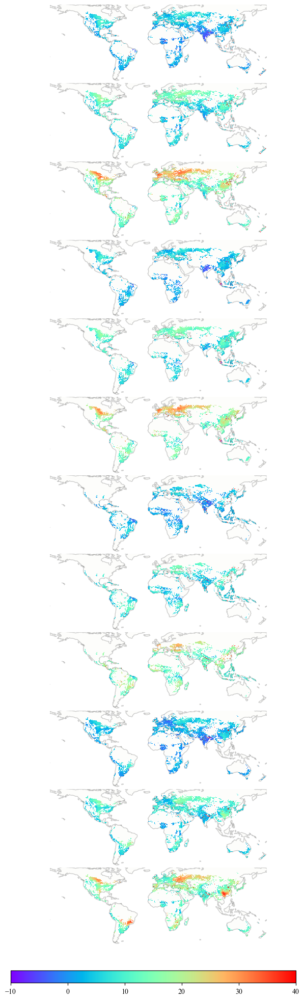

In [353]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.gridspec import GridSpec
import matplotlib as mpl
# 创建紧凑排列的子图
fig = plt.figure(figsize=(8, 24))
gs = gridspec.GridSpec(12, 1, hspace=0)  # hspace=0 表示没有行间距

# 将每个作物-时期组合绘制为一个子图
axes = []
for i, crop in enumerate(crops):
    for j, period in enumerate(periods):
        # ax = plt.subplot(gs[i * len(periods) + j])
        # axes.append(ax)
        # data_to_plot = [diff_data[crop][period][k] for k, ssp in enumerate(ss)]

        difference = diff_data[crop][period]

        # 在4行1列的第 idx 个位置创建子图
        ax = fig.add_subplot(gs[i * len(periods) + j], projection=ccrs.PlateCarree())
        
        # 设置显示范围为南纬60°到北纬60°
        ax.set_extent([-180, 180, -60, 70], crs=ccrs.PlateCarree())
        
        # 添加地图特征
        ax.add_feature(cfeature.COASTLINE, alpha=0.1)
        ax.add_feature(cfeature.LAND, edgecolor='black', alpha=0.1)
        
        # 绘制数据并设置颜色带
        im = difference.plot(ax=ax, transform=ccrs.PlateCarree(), cmap='rainbow', 
                            vmin=-10, vmax=40,  add_colorbar=False)
        
        # 移除网格线
        gl = ax.gridlines(draw_labels=False)
        gl.xlines = False
        gl.ylines = False

        # 去除四周边框
        ax.spines['geo'].set_visible(False)
        # ax.text(-0.05, 0.5, crop, transform=ax.transAxes, fontsize=14, 
        #         verticalalignment='center', horizontalalignment='center', rotation=90)

# 添加一个全局的颜色带
cbar_ax = fig.add_axes([0.15, 0.08, 0.7, 0.01])  # 颜色带的位置: [左, 下, 宽, 高], extend='both'
cbar = fig.colorbar(im, cax=cbar_ax, orientation='horizontal', pad=0.03, shrink=1, aspect=50)
# cbar.set_label('Precipitation Change (mm)', fontsize=20)

# 保存图像
plt.savefig(r'F:\paper3_fig_v2\climate\eta\a_fig\mean_instu_eta_ssp585_change_combined.png', dpi=300)
plt.show()



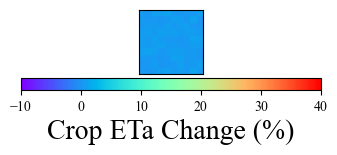

In [355]:
import matplotlib.pyplot as plt
import numpy as np

# 创建一个图形用于颜色带
fig_colorbar = plt.figure(figsize=(6, 2))  # 设定颜色带图像的尺寸
ax_colorbar = fig_colorbar.add_axes([0.1, 0.3, 0.8, 0.4])  # [left, bottom, width, height]

# 创建一个伪数据集以绘制颜色带
data = np.random.rand(10, 10)  # 可以使用任意数据，只是为了展示颜色带
im = ax_colorbar.imshow(data, cmap='rainbow', vmin=-10, vmax=40)

# 添加颜色带
cbar = fig_colorbar.colorbar(im, ax=ax_colorbar, orientation='horizontal', pad=0.05, shrink=0.8, aspect=25)
cbar.set_label('Crop ETa Change (%)', fontsize=20)

# 隐藏坐标轴
ax_colorbar.set_xticks([])
ax_colorbar.set_yticks([])

# 保存颜色带图像
plt.savefig(r'F:\paper3_fig_v2\climate\eta\a_fig\eta_colorbar_only.png', dpi=300, bbox_inches='tight')
plt.show()


### yield

In [379]:
import os
import xarray as xr
import pandas as pd
import numpy as np
from xarray.coding.times import decode_cf_datetime
# 场景列表
crops = ['maiz', 'soyb', 'rice', 'wheat']
ss = ['SSP585']
fp = r'F:\CWatM\cwatm_output\global_future'
day=[153,153,122,122]
# 初始化结果字典
data_dict = {}
ooo={}
# 遍历每个作物
for i,crop in enumerate(crops):
    fpy = xr.open_dataset(join(r'F:\paper3_fig_v2\yield\yield\gswp3_w5e5', F'{crop}_yield.nc'), decode_times=False).__xarray_dataarray_variable__
    fpy=fpy.where(fpy>0)
    ooo[crop]=fpy
    # 初始化用于存储结果的字典
    # results = {}
    data_dict[crop] = {}
    # 遍历每个情景
    for ssp in ss:
        institution_means_list = []

        for inst in os.listdir(fp):
            if inst == 'GWSP3_W5E5' or inst == 'MRI-ESM2-0':
                continue


        csr = xr.open_dataset(join(r'F:\paper3_fig_v2\yield\yield\a_median', F'median_{crop}_{ssp}_yield.nc'), decode_times=False).__xarray_dataarray_variable__
        units = csr.time.attrs['units']
        calendar = csr.time.attrs.get('calendar', 'standard')
        dates = decode_cf_datetime(csr.time.values, units, calendar)
        csr = csr.assign_coords(time=("time", dates))
        csr = csr.where(csr != 0, np.nan)
        
        data_dict[crop][ssp] = csr


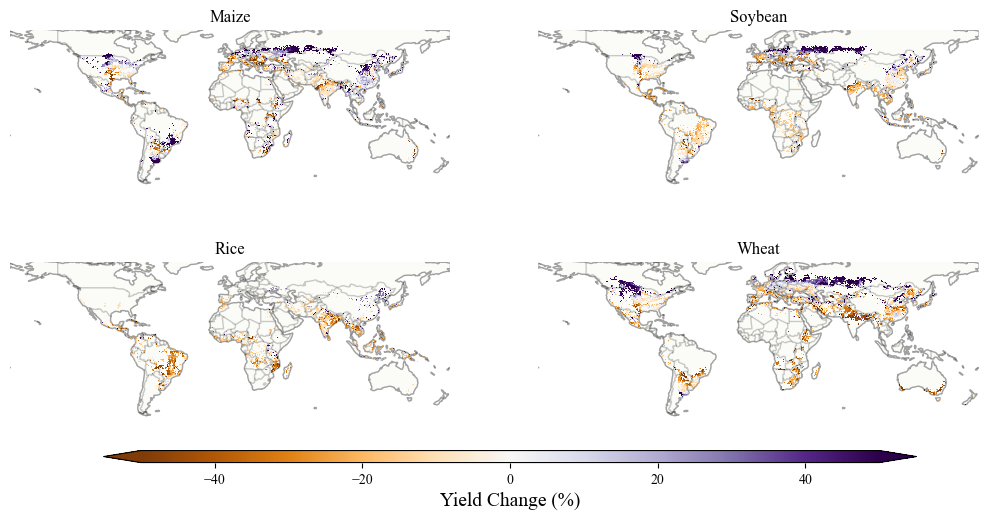

In [376]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.gridspec import GridSpec
import matplotlib as mpl

mpl.rcParams['font.family'] = 'Times New Roman'

# 场景列表
ss = ['SSP585']
crop_name = ['Maize', 'Soybean', 'Rice', 'Wheat']
# 创建一个图形和网格规格
fig = plt.figure(figsize=(12.5, 6))
gs = GridSpec(2, 2, figure=fig,hspace=0.01)  # 4行1列布局

# 遍历每个作物
for idx, crop in enumerate(crops):
    for ssp in ss:
        # 获取当前作物和情景的差异数据
        difference = (data_dict[crop][ssp][-30:].mean(dim='time')-ooo[crop])/ooo[crop]*100
        
        # 在4行1列的第 idx 个位置创建子图
        ax = fig.add_subplot(gs[idx], projection=ccrs.PlateCarree())
        
        # 设置显示范围为南纬60°到北纬60°
        ax.set_extent([-180, 180, -60, 70], crs=ccrs.PlateCarree())
        
        # 添加地图特征
        ax.add_feature(cfeature.COASTLINE, alpha=0.2)
        ax.add_feature(cfeature.LAND, edgecolor='black', alpha=0.2)
        ax.add_feature(cfeature.BORDERS,  alpha=0.2)
        # 绘制数据并设置颜色带
        im = difference.plot(ax=ax, transform=ccrs.PlateCarree(), cmap='PuOr', 
                             vmin=-50, vmax=50, add_colorbar=False)
        
        # 移除网格线
        gl = ax.gridlines(draw_labels=False)
        gl.xlines = False
        gl.ylines = False
        ax.set_title(crop_name[idx])
        # 去除四周边框
        ax.spines['geo'].set_visible(False)
        # ax.text(-0.05, 0.5, crop, transform=ax.transAxes, fontsize=14, 
        #         verticalalignment='center', horizontalalignment='center', rotation=90)

# 添加一个全局的颜色带
cbar_ax = fig.add_axes([0.2, 0.1, 0.65, 0.02])  # 颜色带的位置: [左, 下, 宽, 高]
cbar = fig.colorbar(im, cax=cbar_ax, orientation='horizontal', pad=0.03, shrink=1, aspect=10, extend='both')
cbar.set_label('Yield Change (%)', fontsize=14)
fig.subplots_adjust(hspace=0.05)
# 保存图像
plt.savefig(r'F:\paper3_fig_v2\yield\yield\a_fig\yield_ssp585_change.png', dpi=300)
plt.show()


In [2]:
import os
import xarray as xr
import numpy as np
from os.path import join
import pandas as pd
from xarray.coding.times import decode_cf_datetime
# 设置默认字体为 Times New Roman
import matplotlib as mpl
mpl.rcParams['font.family'] = 'Times New Roman'

# 场景列表
crops = ['maiz', 'soyb', 'rice', 'wheat']
ss = ['SSP126', 'SSP370', 'SSP585']
fp = r'F:\paper3_fig_v2\yield\yield'

# 初始化一个字典来存储所有作物和情景的数据
crop_data = {}

# 遍历每个作物
for crop in crops:
    # 初始化用于存储结果的字典
    results = {}

    # 遍历每个情景
    for ssp in ss:
        yr_values = []
        for inst in os.listdir(fp):
            if inst == 'gswp3_w5e5' or inst == 'a_fig' or inst == 'a_median':
                continue
            filepath = join(fp, inst)

            csr = xr.open_dataset(join(filepath, F'{crop}_{ssp}_yield.nc'), decode_times=False).__xarray_dataarray_variable__
            units = csr.time.attrs['units']
            calendar = csr.time.attrs.get('calendar', 'standard')
            dates = decode_cf_datetime(csr.time.values, units, calendar)
            csr = csr.assign_coords(time=("time", dates))
            csr = csr.where(csr != 0, np.nan)
            yr = csr.mean(dim=['lat', 'lon'])
            yr_values.append(yr)

        # 存储每个情景的结果
        results[ssp] = np.array(yr_values)
    
    # 存储每个作物的所有情景结果
    crop_data[crop] = results


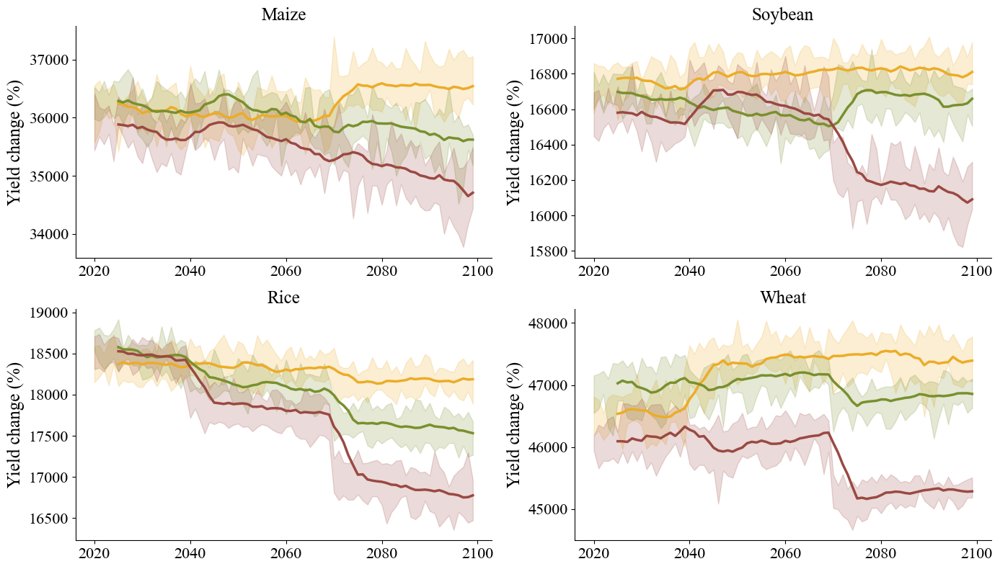

In [288]:
import matplotlib.patches as mpatches  # 导入用于创建色块的模块

# 定义每个情景的颜色
ssp_colors = {
    'SSP126': '#ECAC27',
    'SSP370': '#79902D',
    'SSP585': '#9A4942'
}

# 用于存储图例色块
legend_patches = [mpatches.Patch(color=ssp_colors[ssp], label=ssp) for ssp in ss]

# 开始绘制图形
fig, axs = plt.subplots(2, 2, figsize=(14, 8))  # 4行1列布局
axs = axs.flatten()  # 将子图轴展平成1D数组，方便遍历

# 遍历字典进行绘图
for idx, (crop, results) in enumerate(crop_data.items()):
    ax = axs[idx]  # 获取当前子图轴
    for ssp in ss:
        yr_transposed = results[ssp].T
        
        # 去除每个年份的最小值和最大值
        yr_filtered = []
        for yr in yr_transposed:
            yr_sorted = np.sort(yr)
            yr_filtered.append(yr_sorted[1:-1])  # 去除最小值和最大值
        
        # 转回原来的形状
        yr_filtered = np.array(yr_filtered).T
        
        # 计算去除极值后的均值和范围
        mean_yr = np.median(yr_filtered, axis=0) 
        min_yr = yr_filtered.min(axis=0)
        max_yr = yr_filtered.max(axis=0)
        window_size = 6  # 可以调整窗口大小以控制平滑度
        bb_smooth = pd.Series(mean_yr).rolling(window=window_size).mean()

        # 绘制曲线，设置对应的颜色
        ax.plot(years, bb_smooth, linewidth=2.5, color=ssp_colors[ssp])
        
        # 绘制均值和范围
        ax.fill_between(years, min_yr, max_yr, color=ssp_colors[ssp], alpha=0.2)
    # ax.axvspan(2035, 2045, color='gray', alpha=0.3)
    # 隐藏右侧和顶部的轴
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.tick_params(axis='both', labelsize=16)
    # 隐藏网格线
    ax.grid(False)
    ax.set_title(crop_name[idx], fontsize=18)
    # 除了最后一张子图，隐藏X轴
    # if idx < len(crops) - 1:
    #     ax.set_xticklabels([])
    # else:
    # ax.set_xlabel('Year', fontsize=18)
        
    # Y轴标签
    ax.set_ylabel('Yield change (%)', fontsize=18)

# 调整子图之间的间距
plt.subplots_adjust(hspace=0.3)

# 添加全局图例在最下方，将线条换为色块
# fig.legend(handles=legend_patches, loc='lower center', bbox_to_anchor=(0.5, -0.0), ncol=len(ss), fontsize=18, frameon=False)

plt.tight_layout()
# 保存图像
# plt.savefig(r'F:\paper3_fig_v2\climate\eta\a_fig\eta_timeseries.png', dpi=300)

# 显示图像
plt.show()


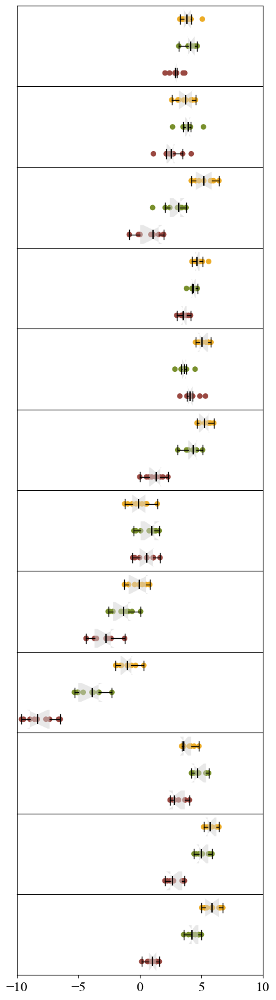

In [275]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.patches as mpatches
import matplotlib.gridspec as gridspec
import xarray as xr
from os.path import join

# 定义每个情景的颜色
ssp_colors = {
    'SSP126': '#ECAC27',
    'SSP370': '#79902D',
    'SSP585': '#9A4942'
}

# 作物名称列表
crop_name = ['Maize', 'Soybean', 'Rice', 'Wheat']
periods = ['Near-term', 'Mid-term', 'Long-term']  # 三个时期
ss = ['SSP126', 'SSP370', 'SSP585']  # 你需要定义的情景列表

# 用于存储图例色块
legend_patches = [mpatches.Patch(color=ssp_colors[ssp], label=ssp) for ssp in ss]

# 作物与情景数据
crops = list(crop_data.keys())

# 存储差值数据用于绘制箱型图
diff_data = {crop: {period: [] for period in periods} for crop in crops}

# 遍历字典进行计算每个作物在三个时期的差值
for i, (crop, results) in enumerate(crop_data.items()):

    # 计算每个位置的最大值
    fpy = xr.open_dataset(join(r'F:\paper3_fig_v2\yield\yield\gswp3_w5e5', F'{crop}_yield.nc'), decode_times=False).__xarray_dataarray_variable__
    fpy=fpy.where(fpy>0)
    for ssp in ss:
        # 三个时间段划分：近、中、远期
        periods_indices = {
            'Near-term': (0, 20),   # 前20年
            'Mid-term': (20, 50),   # 中间30年
            'Long-term': (50, 80)   # 最后30年
        }
        
        for period, (start, end) in periods_indices.items():
            # 计算每个时期的平均值与基准期的差值
            period_mean = results[ssp][:, start:end].mean(axis=1)
            diff = (period_mean - fpy.mean().values)/fpy.mean().values*100
            diff_data[crop][period].append(diff)

# 创建紧凑排列的子图
fig = plt.figure(figsize=(4.5, 16))
gs = gridspec.GridSpec(12, 1, hspace=0)  # hspace=0 表示没有行间距

# 将每个作物-时期组合绘制为一个子图
axes = []
for i, crop in enumerate(crops):
    for j, period in enumerate(periods):
        ax = plt.subplot(gs[i * len(periods) + j])
        axes.append(ax)
        ss = ['SSP126', 'SSP370', 'SSP585']  # 你需要定义的情景列表
        data_to_plot = [diff_data[crop][period][k] for k, ssp in enumerate(ss)]
        data_to_plot=data_to_plot[::-1]
        ss=ss[::-1]
        # 绘制横向箱型图
        box = ax.boxplot(data_to_plot, patch_artist=True, vert=False, widths=0.7, notch=True, showfliers=False,
                         boxprops=dict(facecolor='lightgrey', edgecolor='none', linewidth=1),
                         whiskerprops=dict(linewidth=1),
                         capprops=dict(linewidth=1),
                         medianprops=dict(color='black', linewidth=1.5))

        # 设置箱体的透明度
        for patch in box['boxes']:
            patch.set_facecolor('lightgrey')
            patch.set_alpha(0.5)  # 设置透明度
            patch.set_edgecolor('none')  # 去掉边缘
        
        # 为每种情景绘制散点图
        for k, (data, ssp) in enumerate(zip(data_to_plot, ss)):
            ax.scatter(data, [k + 1] * len(data), color=ssp_colors[ssp], alpha=1, s=40, edgecolor='none')
        
        # 显示分位数和均值
        # for median in box['medians']:
        #     ax.plot([median.get_xdata()[1]] * 2, [0, len(data_to_plot) + 1], color='red', linestyle='--')
        # for mean in box['means']:
        #     ax.plot([mean.get_xdata()[1]] * 2, [0, len(data_to_plot) + 1], color='blue', linestyle='--')
        for median, mean in zip(box['medians'], box['means']):
            ax.plot([median.get_xdata()[1]] * 2, [0, len(data_to_plot) + 1], color='red', linestyle='--')
            ax.plot([mean.get_xdata()[1]] * 2, [0, len(data_to_plot) + 1], color='blue', linestyle='--')

        # 隐藏 y 轴的刻度和标签
        ax.tick_params(axis='y', which='both', left=False, labelleft=False)
        # 设置 x 轴范围
        ax.set_xlim([-10, 10])
        # ax.set_xticks(np.arange(-2, 8.1, 2))
        ax.tick_params(axis='both', labelsize=16)
        
        # 隐藏 x 轴刻度和标签，除非是最后一个子图
        if i * len(periods) + j != 11:
            ax.tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
            ax.set_xticks([])
            ax.spines['bottom'].set_visible(False)

# 在最底部的子图显示 x 轴的标签
# axes[-1].set_xlabel('Precipitation Change (mm)', fontsize=16)

# 添加图例到右侧（如果需要）
# fig.legend(handles=legend_patches, loc='upper right', fontsize=12, frameon=False)

# 调整子图边距以防止标签被切掉
plt.tight_layout()

# 保存图像
# plt.savefig(r'F:\paper3_fig_v2\climate\pr\a_fig\fig1_pr_change_periods_subplot_v2.png', dpi=300)

# 显示图像
plt.show()


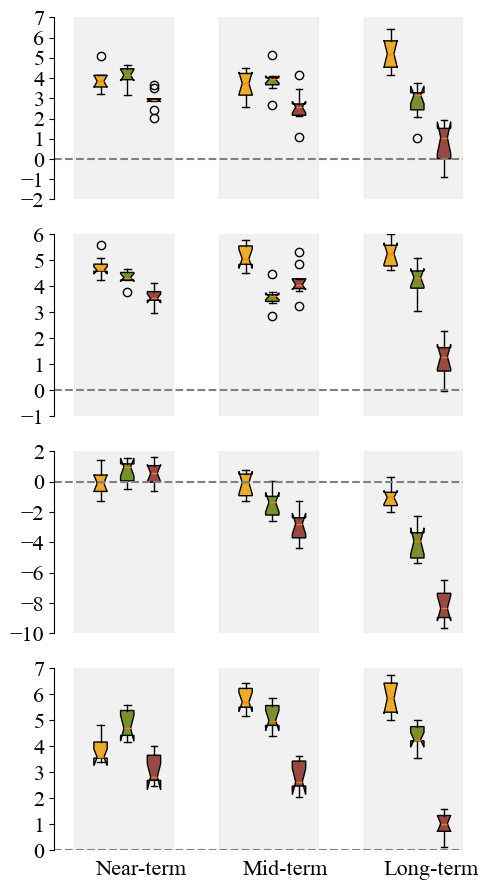

In [16]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.patches as mpatches  # 导入用于创建色块的模块
import matplotlib.ticker as ticker
# 定义每个情景的颜色
ssp_colors = {
    'SSP126': '#ECAC27',
    'SSP370': '#79902D',
    'SSP585': '#9A4942'
}
ss = ['SSP126', 'SSP370', 'SSP585']  # 情景列表
periods = ['Near-term', 'Mid-term', 'Long-term']  # 三个时期
crop_name = ['Maize', 'Soybean', 'Rice', 'Wheat']

# 用于存储图例色块
legend_patches = [mpatches.Patch(color=ssp_colors[ssp], label=ssp) for ssp in ss]

# 作物名称列表
crops = list(crop_data.keys())

# 存储差值数据用于绘制箱型图
diff_data = {crop: {period: [] for period in periods} for crop in crops}

# 遍历字典进行计算每个作物的差值
for i, (crop, results) in enumerate(crop_data.items()):
    fpy = xr.open_dataset(join(r'F:\paper3_fig_v2\yield\yield\gswp3_w5e5', F'{crop}_yield.nc'), decode_times=False).__xarray_dataarray_variable__
    fpy = fpy.where(fpy > 0)
    
    for ssp in ss:
        # 假设 results 是年份 x 数据 的二维数组
        period_indices = {
            'Near-term': (0, 20),   # 前20年
            'Mid-term': (20, 50),   # 中间30年
            'Long-term': (50, 80)   # 最后30年
        }
        
        for period, (start, end) in period_indices.items():
            period_mean = results[ssp][:, start:end].mean(axis=1)  # 计算每个时期的均值
            diff = (period_mean - fpy.mean().values) / fpy.mean().values * 100  # 计算差值
            diff_data[crop][period].append(diff)

# 创建4个子图，每个作物一个图
fig, axes = plt.subplots(4, 1, figsize=(5, 9))  # 2行2列的子图布局
axes = axes.flatten()  # 将axes扁平化，便于迭代

# 设置间隔和宽度
width = 0.7
gap = 0.8  # 每组之间的间隔

# 遍历作物进行绘图
for i, (ax, crop) in enumerate(zip(axes, crops)):
    positions = []  # 存储每个时期箱型图的x轴位置
    data_to_plot = []  # 用于存储该作物的箱型图数据
    
    # 设置每个时期的位置和数据
    for j, period in enumerate(periods):
        start = j * (len(ss) + gap)  # 定位x轴起始点
        positions.extend([start + k * width for k in range(len(ss))])  # 定位每个情景的x轴位置
        for k, ssp in enumerate(ss):
            data_to_plot.append(diff_data[crop][period][k])
    
    # 绘制每个时期的背景阴影
    for j, period in enumerate(periods):
        rect_start = j * (len(ss) + gap) - width
        rect_width = len(ss) * width+0.5
        ax.add_patch(plt.Rectangle((rect_start, -10), rect_width, 20, color='lightgrey', alpha=0.3, zorder=0))  # 阴影背景
    
    # 绘制箱型图
    box = ax.boxplot(data_to_plot, positions=positions, patch_artist=True, widths=width/2, notch=True, zorder=1)
    
    # 为每个箱型图上色
    for patch, (k, ssp) in zip(box['boxes'], enumerate(ss * len(periods))):
        patch.set_facecolor(ssp_colors[ssp])
    
    # 设置每个作物的x轴标签为三个时期
    ax.set_xticks([j * (len(ss) + gap) + (len(ss) * width) / 2 for j in range(len(periods))])
    ax.set_xticklabels('')
    if i ==3:
        
        ax.set_xticklabels(periods, fontsize=12)
    ax.spines['bottom'].set_visible(False)  # 隐藏底部边框
    ax.tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=True)  # 隐藏 x 轴的刻度线和主刻度线
    ax.set_xlabel('') 
    
    # 设置子图的作物名称
    # ax.set_title(crop_name[i], fontsize=18)
    ax.tick_params(axis='both', labelsize=16)
    # 设置y轴标签
    # ax.set_ylabel('Yield Change (%)', fontsize=16)
    
    # 隐藏网格线和多余的边框
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.spines['left'].set_visible(True)
    

    ax.grid(False)
    if i == 0:
        ax.set_ylim([-2, 7])
    elif i == 1:
        ax.set_ylim([-1, 6])
    elif i == 2:
        ax.set_ylim([-10, 2])
    elif i == 3:
        ax.set_ylim([0, 7])
    # 绘制基准线
    ax.axhline(y=0, color='gray', linestyle='--')
    ax.yaxis.set_major_locator(ticker.MaxNLocator(integer=True))
# 添加图例
# fig.legend(handles=legend_patches, loc='upper right', fontsize=12, frameon=False)

# 调整布局
plt.tight_layout()
plt.savefig(r'F:\paper3_fig_v2\yield\yield\a_fig\scenerio_yield_change_v2.png', dpi=300)

# 显示图像
plt.show()


In [313]:
positions

[0.5, 1.2, 1.9, 4.7, 5.4, 6.1, 8.9, 9.6, 10.3]

In [314]:
start

8.4

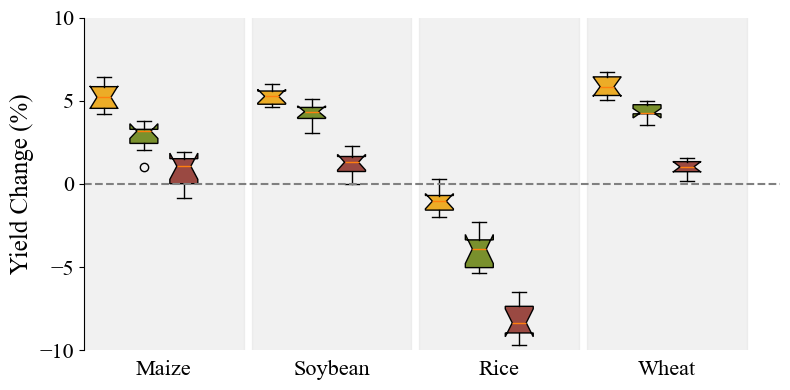

In [287]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.patches as mpatches  # 导入用于创建色块的模块

# 定义每个情景的颜色
ssp_colors = {
    'SSP126': '#ECAC27',
    'SSP370': '#79902D',
    'SSP585': '#9A4942'
}
ss = ['SSP126', 'SSP370', 'SSP585'] 
crop_name=['Maize', 'Soybean', 'Rice', 'Wheat']
# 用于存储图例色块
legend_patches = [mpatches.Patch(color=ssp_colors[ssp], label=ssp) for ssp in ss]

# 作物名称列表
crops = list(crop_data.keys())

# 存储差值数据用于绘制箱型图
diff_data = {crop: [] for crop in crops}

# 遍历字典进行计算每个作物的差值
for i,(crop, results) in enumerate(crop_data.items()):
    fpy = xr.open_dataset(join(r'F:\paper3_fig_v2\yield\yield\gswp3_w5e5', F'{crop}_yield.nc'), decode_times=False).__xarray_dataarray_variable__
    fpy=fpy.where(fpy>0)
    for ssp in ss:
        # 假设 results 是年份 x 数据 的二维数组
        last_30_years = results[ssp][:, -30:].mean(axis=1)  # 最后30年的均值
        first_20_years = results[ssp][:, :20].mean(axis=1)  # 前20年的均值
        diff = (last_30_years - fpy.mean().values)/fpy.mean().values*100  # 差值
        
        # 将差值数据添加到对应作物的列表中
        diff_data[crop].append(diff)

# 开始绘制箱型图
fig, ax = plt.subplots(figsize=(8, 4))

# 设置间隔和宽度
width = 0.7
gap = 1.2  # 每组之间的间隔
positions = []

for i, crop in enumerate(crops):
    start = i * (len(ss) + gap)
    positions.extend([start + j for j in range(len(ss))])

# 绘制每个作物的背景阴影
for i, crop in enumerate(crops):
    start = i * (len(ss) + gap)
    ax.add_patch(plt.Rectangle((start - 0.5, -25), len(ss) + 1,150, color='lightgrey', alpha=0.3, zorder=0))

# 将作物的数据分组展示
data_to_plot = []
for crop in crops:
    for i, ssp in enumerate(ss):
        data_to_plot.append(diff_data[crop][i])

# 绘制箱型图
box = ax.boxplot(data_to_plot, positions=positions, patch_artist=True, widths=width, notch=True, zorder=1)

# 为每个箱型图上色
for patch, (i, ssp) in zip(box['boxes'], enumerate(ss * len(crops))):
    patch.set_facecolor(ssp_colors[ssp])

# 添加作物的组标签
ax.set_xticks([(i * (len(ss) + gap) + (len(ss) / 2)) for i in range(len(crops))])
ax.set_xticklabels(crop_name, fontsize=18)

# 隐藏 x 轴的刻度线、主刻度线和 x 轴名称
ax.spines['bottom'].set_visible(False)  # 隐藏底部边框
ax.tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=True)  # 隐藏 x 轴的刻度线和主刻度线
ax.set_xlabel('')  # 隐藏 x 轴标签

# 设置坐标轴标签
ax.set_ylabel('Yield Change (%)', fontsize=18)

# 隐藏多余的边框和线条
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(True)     # 显示左边框线条
ax.tick_params(axis='both', labelsize=16)
ax.axhline(y=0, color='gray', linestyle='--')
# 设置 y 轴范围和刻度
ax.set_ylim([-10, 10])
# ax.set_yticks(np.arange(-25, 1.1, 25))

# 隐藏网格线
ax.grid(False)

# 调整子图边距以防止标签被切掉
plt.subplots_adjust(bottom=0.15)

# 添加图例
# fig.legend(handles=legend_patches, loc='lower center', bbox_to_anchor=(0.5, -0.05), ncol=len(ss), fontsize=18, frameon=False)
plt.tight_layout()
# 保存图像
# plt.savefig(r'F:\paper3_fig\combined\fig1_pr_change.png', dpi=300)

# 显示图像
plt.show()


### relevate yield

In [33]:
import os
import xarray as xr
import pandas as pd
import numpy as np

# 场景列表
crops = ['maiz', 'soyb', 'rice', 'wheat']
ss = ['SSP585']
fp = r'F:\CWatM\cwatm_output\global_future'
day=[153,153,122,122]
# 初始化结果字典
data_dict = {}
ooo={}
# 遍历每个作物
for i,crop in enumerate(crops):
    fpy = xr.open_dataset(join(r'F:\paper3_fig_v2\yield\yield\gswp3_w5e5', F'{crop}_relitive_yield.nc'), decode_times=False).__xarray_dataarray_variable__
    fpy=fpy.where(fpy>0)
    ooo[crop]=fpy
    # 初始化用于存储结果的字典
    # results = {}
    data_dict[crop] = {}
    # 遍历每个情景
    for ssp in ss:
        institution_means_list = []

        for inst in os.listdir(fp):
            if inst == 'GWSP3_W5E5' or inst == 'MRI-ESM2-0':
                continue


        csr = xr.open_dataset(join(r'F:\paper3_fig_v2\yield\yield\a_median', F'median_{crop}_{ssp}_relitive_yield.nc'), decode_times=False).__xarray_dataarray_variable__
        # units = csr.time.attrs['units']
        start_year = 1901
        years = [start_year + int(offset) for offset in csr.time.values]
        dates = pd.to_datetime(years, format='%Y')
        csr = csr.assign_coords(time=("time", dates))
        csr = csr.where(csr != 0, np.nan)
        
        data_dict[crop][ssp] = csr


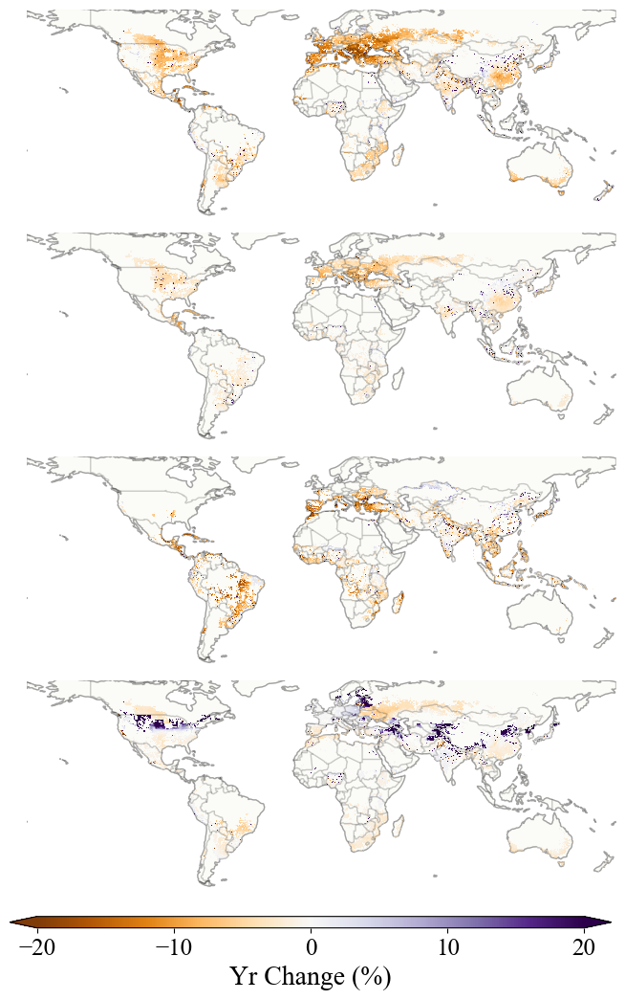

In [35]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.gridspec import GridSpec
import matplotlib as mpl

mpl.rcParams['font.family'] = 'Times New Roman'

# 场景列表
ss = ['SSP585']
crop_name = ['Maize', 'Soybean', 'Rice', 'Wheat']
# 创建一个图形和网格规格
fig = plt.figure(figsize=(9, 12))
gs = GridSpec(4, 1, figure=fig)  # 4行1列布局

# 遍历每个作物
for idx, crop in enumerate(crops):
    for ssp in ss:
        # 获取当前作物和情景的差异数据
        difference = (data_dict[crop][ssp][-30:].mean(dim='time')-ooo[crop])/ooo[crop]*100
        
        # 在4行1列的第 idx 个位置创建子图
        ax = fig.add_subplot(gs[idx], projection=ccrs.PlateCarree())
        
        # 设置显示范围为南纬60°到北纬60°
        ax.set_extent([-180, 180, -60, 70], crs=ccrs.PlateCarree())
        
        # 添加地图特征
        ax.add_feature(cfeature.COASTLINE, alpha=0.2)
        ax.add_feature(cfeature.LAND, edgecolor='black', alpha=0.2)
        ax.add_feature(cfeature.BORDERS,  alpha=0.2)
        # 绘制数据并设置颜色带
        im = difference.plot(ax=ax, transform=ccrs.PlateCarree(), cmap='PuOr', 
                             vmin=-20, vmax=20, add_colorbar=False)
        
        # 移除网格线
        gl = ax.gridlines(draw_labels=False)
        gl.xlines = False
        gl.ylines = False
        # ax.set_title(crop_name[idx])
        # 去除四周边框
        ax.spines['geo'].set_visible(False)
        # ax.text(-0.05, 0.5, crop, transform=ax.transAxes, fontsize=14, 
        #         verticalalignment='center', horizontalalignment='center', rotation=90)

# 添加一个全局的颜色带
cbar_ax = fig.add_axes(([0.15, 0.08, 0.7, 0.01]))  # 颜色带的位置: [左, 下, 宽, 高]
cbar = fig.colorbar(im, cax=cbar_ax, orientation='horizontal', pad=0.03, shrink=1, aspect=10, extend='both')
cbar.set_label('Yr Change (%)',  fontsize=20)
cbar.ax.tick_params(labelsize=18)

fig.subplots_adjust(hspace=0.05)
# 保存图像
plt.savefig(r'F:\paper3_fig_v2\yield\yield\a_fig\yr_ssp585_change.png', dpi=300)
plt.show()


## SHAP

In [84]:
import xarray as xr
import pandas as pd
import numpy as np
from tqdm.notebook import tqdm
crops = ['maiz', 'soyb', 'rice', 'wheat']
ss = ['SSP126', 'SSP370', 'SSP585']
s=['ssp126', 'ssp370', 'ssp585']
fp = r'F:\CWatM\cwatm_output\global_future'
for crop in tqdm(crops, desc="Processing Crop"):
    for nn,ssp in tqdm(enumerate(ss), desc="Processing scenerio", leave=False):
        yr_values = [];pr_values=[];tas_values=[]

        # 1. 数据读取
        yr = xr.open_dataset(rf'F:\paper3_fig_v2\yield\yield\a_median\median_{crop}_{ssp}_relitive_yield.nc', decode_times=False).__xarray_dataarray_variable__
        pr = xr.open_dataset(rf'F:\paper3_fig_v2\climate\pr\a_median\median_{crop}_{ssp}_pr.nc', decode_times=False).crop_Precipitation_nonIrr_annualtot
        tas = xr.open_dataset(rf'F:\paper3_fig_v2\climate\tas\a_median\median_{crop}_{s[nn]}_tas.nc', decode_times=False).tas[5:-1]
        tasmax = xr.open_dataset(rf'F:\paper3_fig_v2\climate\tasmax\a_median\median_{crop}_{s[nn]}_tasmax.nc', decode_times=False).tasmax[5:-1]
        # tasmin = xr.open_dataset(rf'F:\CWatM\cwatm_output\global_future\{inst}\{ssp}\crop_Tmin_nonIrr_annualtot_{crop}.nc', decode_times=False).crop_Tmin_nonIrr_annualtot
        yr=yr.where(yr!=0,np.nan)
        start_year = 1901
        
        # 计算年份
        years = [start_year + int(offset) for offset in yr.time.values]
        
        # 创建新的时间坐标
        dates = pd.to_datetime(years, format='%Y')
        
        # 分配新的时间坐标
        pr = pr.assign_coords(time=("time", dates))
        yr = yr.assign_coords(time=("time", dates))
        # tas = tas.assign_coords(time=("year", dates))
        # tasmax = tasmax.assign_coords(time=("year", dates))
        # tasmin = tasmin.assign_coords(time=("time", dates))
        
        # 2. 筛选大于0的点
        pr_mask = pr.where(pr > 0)
        tas_mask = tas .where(tas > 0)
        yr_mask = yr .where(yr > 0)
        
        # 获取经纬度坐标
        lon = pr.lon.values
        lat = pr.lat.values
        
        # 初始化列表以存储结果
        results = []
        
        # 遍历时间
        for time in pr.time:
            # 筛选当前时间的数据
            time_str = str(time.values)  # 获取时间的字符串形式
            year = pd.to_datetime(time_str).year
            
            # 筛选出当前时间的数据
            pr_year = pr.sel(time=time).values
            tas_year = tas.sel(year=time.dt.year).values
            tasmax_year = tasmax.sel(year=time.dt.year).values
            # tasmin_year = tasmin.sel(time=time).values
            yr_year = yr.sel(time=time).values
            
            # 应用有效掩码
            valid_mask = (pr_year > 0) & (tas_year > 0) & (yr_year > 0)
            
            # 将布尔掩码转换为二维
            valid_mask_2d = valid_mask.reshape(len(lat), len(lon))
            
            # 将当前时间的数据添加到结果列表
            for i in range(len(lat)):
                for j in range(len(lon)):
                    if valid_mask_2d[i, j]:
                        results.append(pd.DataFrame({
                            'Year': year,
                            'Longitude': lon[j],
                            'Latitude': lat[i],
                            'Precipitation': pr_year[i, j],
                            'Temperature': tas_year[i, j],
                            'Temperature_max': tasmax_year[i, j],
                            # 'Temperature_min': tasmin_year[i, j],
                            'Yield': yr_year[i, j]
                        }, index=[0]))
            
            # 将所有结果合并为一个 DataFrame
        combined_df = pd.concat(results, ignore_index=True)
        
        # 显示 DataFrame 的前几行
        print(combined_df.head())
        
        # 将 DataFrame 保存到 CSV 文件（如果需要）
        combined_df.to_csv(rf'F:\paper3_fig_v2\shap\data\{crop}_{ssp}.csv', index=False)


Processing Crop:   0%|          | 0/4 [00:00<?, ?it/s]

Processing scenerio: 0it [00:00, ?it/s]

   Year  Longitude  Latitude  Precipitation  Temperature  Temperature_max  \
0  2020      25.75     65.25     289.396179    13.326996        17.455414   
1  2020      24.25     64.75     261.544495    13.370605        17.639954   
2  2020      24.75     64.75     275.114838    13.195729        17.349335   
3  2020      25.25     64.75     300.002594    13.358907        17.466309   
4  2020      25.75     64.75     306.071960    13.345021        17.678528   

      Yield  
0  3.864126  
1  3.481864  
2  3.723654  
3  3.800219  
4  3.813401  
   Year  Longitude  Latitude  Precipitation  Temperature  Temperature_max  \
0  2020      25.75     65.25     274.825470    12.988807        17.477417   
1  2020      24.25     64.75     274.874603    13.057526        17.706665   
2  2020      24.75     64.75     290.905701    12.845594        17.318756   
3  2020      25.25     64.75     310.799286    13.012218        17.344940   
4  2020      25.75     64.75     323.439636    12.971900        17.5

Processing scenerio: 0it [00:00, ?it/s]

   Year  Longitude  Latitude  Precipitation  Temperature  Temperature_max  \
0  2020    -116.75     58.75     217.500763    14.859233        21.860596   
1  2020    -116.25     58.75     211.171478    14.453271        21.123199   
2  2020    -116.75     58.25     234.824295    15.715020        22.704559   
3  2020    -116.25     58.25     241.684097    16.135475        22.791534   
4  2020    -115.75     58.25     259.293365    16.115793        22.688019   

      Yield  
0  3.069364  
1  3.016182  
2  3.057667  
3  3.088352  
4  3.091448  
   Year  Longitude  Latitude  Precipitation  Temperature  Temperature_max  \
0  2020    -116.75     58.75     224.717621    14.415348        22.014709   
1  2020    -116.25     58.75     211.336670    14.055294        21.160461   
2  2020    -116.75     58.25     196.438385    15.283336        23.115936   
3  2020    -116.25     58.25     192.664581    15.746443        23.073212   
4  2020    -115.75     58.25     210.965454    15.753089        22.8

Processing scenerio: 0it [00:00, ?it/s]

   Year  Longitude  Latitude  Precipitation  Temperature  Temperature_max  \
0  2020      67.75     55.25     235.106598    17.078756        22.546539   
1  2020      68.25     55.25     244.335373    16.965410        22.204803   
2  2020      68.75     55.25     245.634964    16.880541        22.053223   
3  2020      69.25     55.25     256.022858    16.792318        22.010712   
4  2020      69.75     55.25     263.326965    16.743034        21.970856   

      Yield  
0  1.921287  
1  1.913265  
2  1.880896  
3  1.925092  
4  2.010154  
   Year  Longitude  Latitude  Precipitation  Temperature  Temperature_max  \
0  2020      67.75     55.25     205.491333    16.690012        22.192383   
1  2020      68.25     55.25     224.614609    16.657906        22.171173   
2  2020      68.75     55.25     254.488464    16.615370        22.080780   
3  2020      69.25     55.25     264.978546    16.539999        21.973877   
4  2020      69.75     55.25     277.240723    16.505672        21.8

Processing scenerio: 0it [00:00, ?it/s]

   Year  Longitude  Latitude  Precipitation  Temperature  Temperature_max  \
0  2020      11.75     64.25    1134.899780     2.207933         4.532898   
1  2020      22.75     63.75     411.822266     0.857249         3.681671   
2  2020      27.25     63.75     444.887482     0.082567         3.192535   
3  2020       9.75     63.25     984.080627     3.244497         5.479736   
4  2020      10.25     63.25     671.764526     2.293725         4.664459   

      Yield  
0  7.444434  
1  6.117139  
2  5.187110  
3  7.554262  
4  7.425995  
   Year  Longitude  Latitude  Precipitation  Temperature  Temperature_max  \
0  2020      11.75     64.25    1199.463623     1.640825         3.815918   
1  2020      22.75     63.75     362.075439     0.354726         2.677765   
2  2020       9.75     63.25    1113.122803     2.766666         4.778839   
3  2020      10.25     63.25     804.860596     1.868774         3.915649   
4  2020      22.75     63.25     342.681335     0.141452         2.8

### Maize

In [133]:
import lightgbm as lgb
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 

# 读取数据（假设数据已经在 combined_df 中）
combined_df = pd.read_csv('F:\paper3_fig_v2\shap\data\maiz_SSP585.csv') # 如果需要从文件读取数据

# 特征和目标变量
features = ['Longitude', 'Latitude', 'Precipitation', 'Temperature']
target = 'Yield'

# 创建特征矩阵 X 和目标变量 y
X = combined_df[features]
y = combined_df[target]

X_temp, X_test, y_temp, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# 然后将训练集进一步划分为训练集和验证集
X_train, X_val, y_train, y_val = train_test_split(X_temp, y_temp, test_size=0.125, random_state=42)  # 0.125 x 0.8 = 0.1
X_tmp=X_train
# 数据集标准化
x_mean = X_train.mean()
x_std =  X_train.std()
y_mean = y.mean()
y_std = y.std()
X_train = (X_train - x_mean)/x_std
y_train = (y_train-y_mean)/y_std
X_val = (X_val - x_mean)/x_std
y_val = (y_val - y_mean)/y_std
X_test = (X_test - x_mean)/x_std
y_test = (y_test - y_mean)/y_std

import lightgbm as lgb

# LightGBM模型参数
params_lgb = {
    'learning_rate': 0.1,          # 学习率，控制每一步的步长，用于防止过拟合。典型值范围：0.01 - 0.1
    'boosting_type': 'gbdt',        # 提升方法，这里使用梯度提升树（Gradient Boosting Decision Tree，简称GBDT）
    'objective': 'mse',             # 损失函数
    'metric': 'rmse',               # 评估指标
    'num_leaves': 255,              # 每棵树的叶子节点数量，控制模型复杂度。较大值可以提高模型复杂度但可能导致过拟合
    'verbose': -1,                  # 控制 LightGBM 输出信息的详细程度，-1表示无输出，0表示最少输出，正数表示输出更多信息
    'seed': 42,                     # 随机种子，用于重现模型的结果
    'n_jobs': -1,                   # 并行运算的线程数量，-1表示使用所有可用的CPU核心
    'feature_fraction': 0.8,        # 每棵树随机选择的特征比例，用于增加模型的泛化能力
    'bagging_fraction': 0.95,        # 每次迭代时随机选择的样本比例，用于增加模型的泛化能力
    'bagging_freq': 6               # 每隔多少次迭代进行一次bagging操作，用于增加模型的泛化能力
}

model_lgb = lgb.LGBMRegressor(**params_lgb)
model_lgb.fit(X_train, y_train, eval_set=[(X_val, y_val)], 
              eval_metric='rmse')  

LGBMRegressor(bagging_fraction=0.95, bagging_freq=6, feature_fraction=0.8,
              metric='rmse', n_jobs=-1, num_leaves=255, objective='mse',
              seed=42, verbose=-1)

NSE for train set: 0.6581
NSE for validation set: 0.6522
NSE for test set: 0.6472


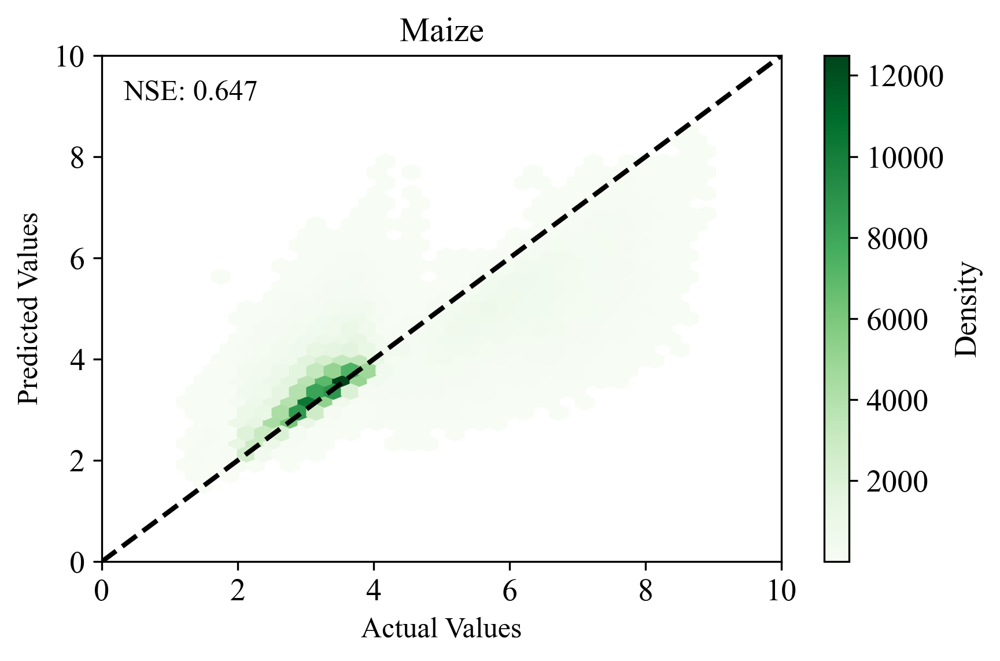

In [134]:

plt.rcParams['axes.unicode_minus'] = False
pred_train = model_lgb.predict(X_train)
pred_val = model_lgb.predict(X_val)
pred_test = model_lgb.predict(X_test)

y_train_h = y_train*y_std+y_mean
pred_train_h = pred_train*y_std+y_mean

y_val_h = y_val*y_std+y_mean
pred_val_h = pred_val*y_std+y_mean

y_test_h = y_test*y_std+y_mean
pred_test_h = pred_test*y_std+y_mean
from sklearn.metrics import mean_squared_error

# 计算NSE
def calculate_nse(y_true, y_pred):
    mse = mean_squared_error(y_true, y_pred)
    return 1 - mse / np.var(y_true)

# 计算每个数据集的NSE
nse_train = calculate_nse(y_train_h, pred_train_h)
nse_val = calculate_nse(y_val_h, pred_val_h)
nse_test = calculate_nse(y_test_h, pred_test_h)

# 输出结果
print(f'NSE for train set: {nse_train:.4f}')
print(f'NSE for validation set: {nse_val:.4f}')
print(f'NSE for test set: {nse_test:.4f}')

import seaborn as sns
colors = sns.color_palette("husl", 3)

plt.figure(figsize=(6,4),dpi=300)

plt.hexbin(y_test_h, pred_test_h, gridsize=30, cmap='Greens', mincnt=1)
plt.plot([0, 10], [0, 10], 'k--', lw=2)
plt.xlabel('Actual Values', fontsize=12)
plt.ylabel('Predicted Values', fontsize=12)
plt.title('Maize', fontsize=14)
plt.xlim([0, 10])
plt.ylim([0, 10])
plt.colorbar(label='Density')
# 替换 plt.add_text 为 plt.text
plt.text(0.23, 0.9, f'NSE: {nse_test:.3f}', transform=plt.gca().transAxes, fontsize=12, verticalalignment='bottom', horizontalalignment='right')

# 调整布局
plt.tight_layout()
plt.savefig(r'F:\paper3_fig_v2\shap\fig\maize_calibration.png',dpi=300)
plt.show()

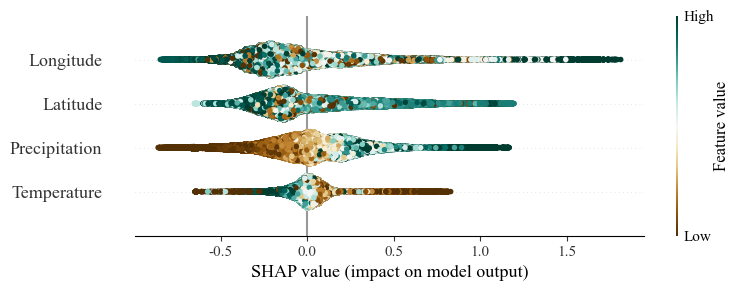

<Figure size 640x480 with 0 Axes>

In [135]:
import shap
# 构建 shap解释器
explainer = shap.TreeExplainer(model_lgb)
# 计算测试集的shap值
shap_values = explainer.shap_values(X_train)
# 特征标签
labels = X_train.columns
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = 'Times new Roman'
plt.rcParams['font.size'] = 13
#cmap="?"配色viridis Spectral coolwar mRdYlGn RdYlBu RdBu RdGy PuOr BrBG PRGn PiYG
plt.figure()
shap.summary_plot(shap_values, X_train, feature_names=labels, plot_type="dot",cmap='BrBG')
plt.savefig(r'F:\paper3_fig_v2\shap\fig\maize_features.png',dpi=300)
plt.show()

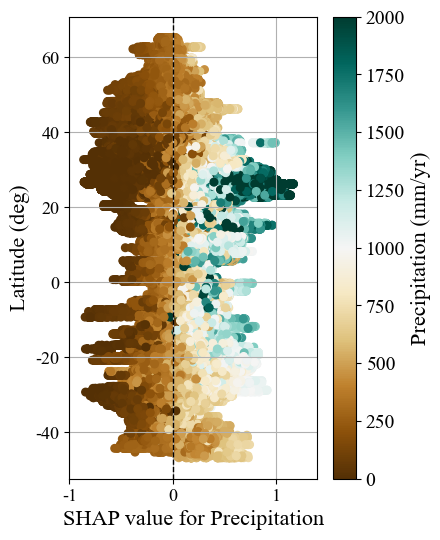

In [113]:
import shap
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors

# 假设 "Precipitation" 是降水特征的名称
precipitation_feature = "Precipitation"
latitude_feature = "Latitude"  # 假设纬度列名为 "Latitude"

# 提取降水特征的 SHAP 值和原始值
shap_values_precipitation = shap_values[:, labels == precipitation_feature].flatten()
precipitation_values = X_tmp[precipitation_feature].values  
latitude_values = X_tmp[latitude_feature].values

# 创建图形
plt.figure(figsize=(4, 6))
norm = mcolors.Normalize(vmin=0, vmax=2000)
sc = plt.scatter(shap_values_precipitation, latitude_values, c=precipitation_values, cmap='BrBG', s=30, norm=norm)

# 添加颜色条
cbar = plt.colorbar(sc, label=f'{precipitation_feature} (mm/yr)')  # 添加颜色条

# 设置颜色条的字体大小
cbar.ax.tick_params(labelsize=14)  # 设置刻度标签字体大小
cbar.ax.set_ylabel(f'{precipitation_feature} (mm/yr)', fontsize=16)  # 设置颜色条标签字体大小

# 设置图形的标签和标题
plt.xlabel("SHAP value for Precipitation", fontsize=16)
plt.ylabel("Latitude (deg)", fontsize=16)

# 添加垂直线
plt.axvline(x=0, color='black', linestyle='--', linewidth=1)

# 设置网格线
plt.grid(True)
plt.xlim(-1,1.4)
# 保存图形
plt.savefig(r'F:\paper3_fig_v2\shap\fig\maize_ssp585_precipitation_shap.png', dpi=300)

# 显示图形
plt.show()


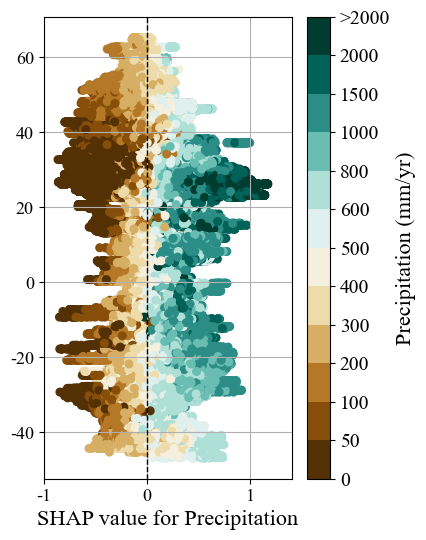

In [129]:
import shap
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# 假设 "Precipitation" 是降水特征的名称
precipitation_feature = "Precipitation"
latitude_feature = "Latitude"  # 假设纬度列名为 "Latitude"

# 提取降水特征的 SHAP 值和原始值
shap_values_precipitation = shap_values[:, labels == precipitation_feature].flatten()
precipitation_values = X_tmp[precipitation_feature].values  
latitude_values = X_tmp[latitude_feature].values

# 定义分类边界
bounds = [0, 50, 100, 200,300, 400,500,600, 800,1000,1500, 2000, np.max(precipitation_values)]

# 使用 BrBG 色带并均匀采样 8 种颜色
brbg_cmap = plt.colormaps['BrBG']  # 使用 colormaps 直接获取色带
colors = brbg_cmap(np.linspace(0, 1, 12))  # 均匀采样8种颜色
cmap = mcolors.ListedColormap(colors)  # 创建自定义颜色映射

# 使用 BoundaryNorm 对色带进行分类
norm = mcolors.BoundaryNorm(boundaries=bounds, ncolors=len(bounds)-1)

# 创建图形
plt.figure(figsize=(4, 6))
sc = plt.scatter(shap_values_precipitation, latitude_values, c=precipitation_values, cmap=cmap, s=30, norm=norm)

# 添加颜色条
cbar = plt.colorbar(sc, label=f'{precipitation_feature} (mm/yr)')

# 设置颜色条的刻度和自定义标签
cbar.set_ticks(bounds)  # 设置刻度位置
cbar.set_ticklabels(['0', '50', '100', '200','300', '400','500', '600','800','1000','1500', '2000', '>2000'])  # 自定义标签
cbar.ax.tick_params(labelsize=14)  # 设置刻度标签字体大小
cbar.ax.set_ylabel(f'{precipitation_feature} (mm/yr)', fontsize=16)  # 设置颜色条标签

# 设置图形的标签和标题
plt.xlabel("SHAP value for Precipitation", fontsize=16)
# plt.ylabel("Latitude (deg)", fontsize=16)

# 添加垂直线
plt.axvline(x=0, color='black', linestyle='--', linewidth=1)

# 设置网格线
plt.grid(True)
plt.xlim(-1,1.4)

# 保存图形
plt.savefig(r'F:\paper3_fig_v2\shap\fig\maize_ssp585_precipitation_shap.png', dpi=300)

# 显示图形
plt.show()


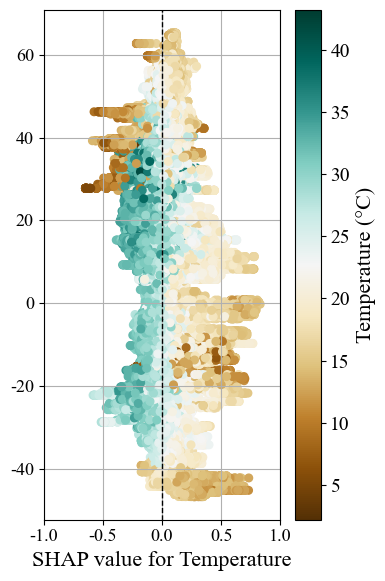

In [118]:
import shap
import matplotlib.pyplot as plt
import numpy as np

# 计算 SHAP 值
# shap_values = explainer.shap_values(X_train)

# 假设 "Precipitation" 是降水特征的名称
temperature_feature = "Temperature"
latitude_feature = "Latitude"  # 假设纬度列名为 "Latitude"

# 提取降水特征的 SHAP 值和原始值
shap_values_temperature = shap_values[:, labels == temperature_feature].flatten()
temperature_values = (X_tmp[temperature_feature].values)
# latitude_values = X_train[latitude_feature].values
latitude_values = X_tmp[latitude_feature].values

# 创建图形
plt.figure(figsize=(4, 6))
sc = plt.scatter(shap_values_temperature, latitude_values, c=temperature_values, cmap='BrBG', s=30)

# 添加颜色条
cbar = plt.colorbar(sc)  # 添加颜色条

# 设置颜色条的字体大小
cbar.ax.tick_params(labelsize=14)  # 设置刻度标签字体大小
cbar.ax.set_ylabel(f'{temperature_feature} (°C)', fontsize=16)  # 设置颜色条标签字体大小
plt.xlabel("SHAP value for Temperature", fontsize=16)
# plt.ylabel("Latitude (deg)", fontsize=16)
plt.axvline(x=0, color='black', linestyle='--', linewidth=1)
# plt.title("SHAP Values for Temperature by Latitude")
plt.grid(True)
plt.xlim(-1,1)
plt.savefig(r'F:\paper3_fig_v2\shap\fig\maize_ssp585_Temperature_shap.png',dpi=300)
plt.tight_layout()
plt.show()


### Wheat

In [159]:
import lightgbm as lgb
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 

# 读取数据（假设数据已经在 combined_df 中）
combined_df = pd.read_csv('F:\paper3_fig_v2\shap\data\wheat_SSP585.csv') # 如果需要从文件读取数据

# 特征和目标变量
features = ['Longitude', 'Latitude', 'Precipitation', 'Temperature']
target = 'Yield'

# 创建特征矩阵 X 和目标变量 y
X = combined_df[features]
y = combined_df[target]

X_temp, X_test, y_temp, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# 然后将训练集进一步划分为训练集和验证集
X_train, X_val, y_train, y_val = train_test_split(X_temp, y_temp, test_size=0.125, random_state=42)  # 0.125 x 0.8 = 0.1
X_tmp=X_train
# 数据集标准化
x_mean = X_train.mean()
x_std =  X_train.std()
y_mean = y.mean()
y_std = y.std()
X_train = (X_train - x_mean)/x_std
y_train = (y_train-y_mean)/y_std
X_val = (X_val - x_mean)/x_std
y_val = (y_val - y_mean)/y_std
X_test = (X_test - x_mean)/x_std
y_test = (y_test - y_mean)/y_std

import lightgbm as lgb

# LightGBM模型参数
params_lgb = {
    'learning_rate': 0.1,          # 学习率，控制每一步的步长，用于防止过拟合。典型值范围：0.01 - 0.1
    'boosting_type': 'gbdt',        # 提升方法，这里使用梯度提升树（Gradient Boosting Decision Tree，简称GBDT）
    'objective': 'mse',             # 损失函数
    'metric': 'rmse',               # 评估指标
    'num_leaves': 255,              # 每棵树的叶子节点数量，控制模型复杂度。较大值可以提高模型复杂度但可能导致过拟合
    'verbose': -1,                  # 控制 LightGBM 输出信息的详细程度，-1表示无输出，0表示最少输出，正数表示输出更多信息
    'seed': 42,                     # 随机种子，用于重现模型的结果
    'n_jobs': -1,                   # 并行运算的线程数量，-1表示使用所有可用的CPU核心
    'feature_fraction': 0.8,        # 每棵树随机选择的特征比例，用于增加模型的泛化能力
    'bagging_fraction': 0.95,        # 每次迭代时随机选择的样本比例，用于增加模型的泛化能力
    'bagging_freq': 6               # 每隔多少次迭代进行一次bagging操作，用于增加模型的泛化能力
}

model_lgb = lgb.LGBMRegressor(**params_lgb)
model_lgb.fit(X_train, y_train, eval_set=[(X_val, y_val)], 
              eval_metric='rmse')  

LGBMRegressor(bagging_fraction=0.95, bagging_freq=6, feature_fraction=0.8,
              metric='rmse', n_jobs=-1, num_leaves=255, objective='mse',
              seed=42, verbose=-1)

NSE for train set: 0.8452
NSE for validation set: 0.8392
NSE for test set: 0.8402


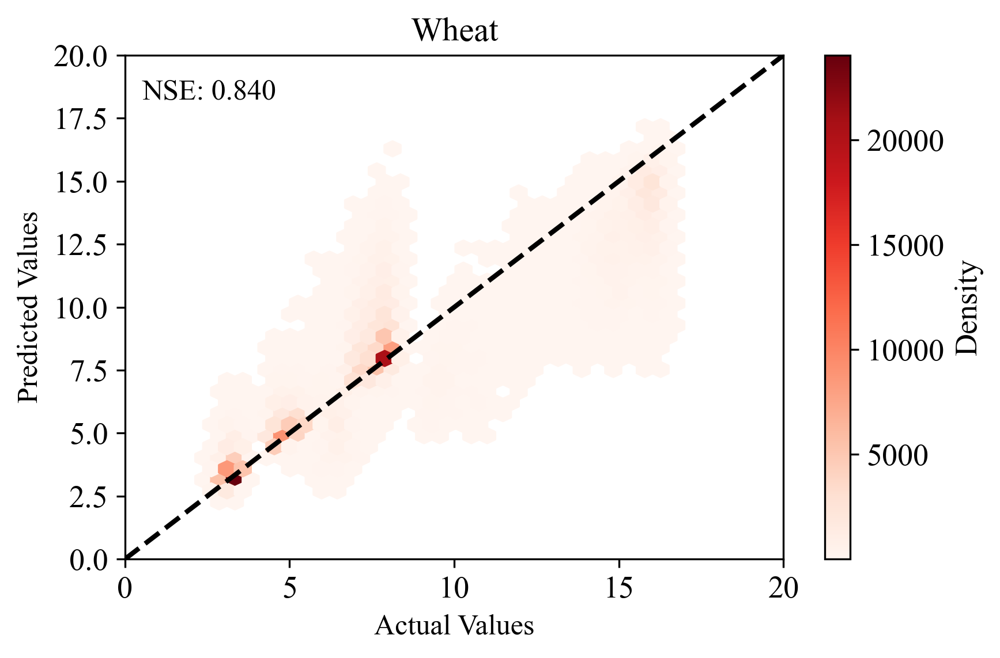

In [160]:

plt.rcParams['axes.unicode_minus'] = False
pred_train = model_lgb.predict(X_train)
pred_val = model_lgb.predict(X_val)
pred_test = model_lgb.predict(X_test)

y_train_h = y_train*y_std+y_mean
pred_train_h = pred_train*y_std+y_mean

y_val_h = y_val*y_std+y_mean
pred_val_h = pred_val*y_std+y_mean

y_test_h = y_test*y_std+y_mean
pred_test_h = pred_test*y_std+y_mean
from sklearn.metrics import mean_squared_error

# 计算NSE
def calculate_nse(y_true, y_pred):
    mse = mean_squared_error(y_true, y_pred)
    return 1 - mse / np.var(y_true)

# 计算每个数据集的NSE
nse_train = calculate_nse(y_train_h, pred_train_h)
nse_val = calculate_nse(y_val_h, pred_val_h)
nse_test = calculate_nse(y_test_h, pred_test_h)

# 输出结果
print(f'NSE for train set: {nse_train:.4f}')
print(f'NSE for validation set: {nse_val:.4f}')
print(f'NSE for test set: {nse_test:.4f}')

import seaborn as sns
colors = sns.color_palette("husl", 3)

plt.figure(figsize=(6,4),dpi=300)

plt.hexbin(y_test_h, pred_test_h, gridsize=30, cmap='Reds', mincnt=1)
plt.plot([0, 20], [0, 20], 'k--', lw=2)
plt.xlabel('Actual Values', fontsize=12)
plt.ylabel('Predicted Values', fontsize=12)
plt.title('Wheat', fontsize=14)
plt.xlim([0, 20])
plt.ylim([0, 20])
plt.colorbar(label='Density')
# 替换 plt.add_text 为 plt.text
plt.text(0.23, 0.9, f'NSE: {nse_test:.3f}', transform=plt.gca().transAxes, fontsize=12, verticalalignment='bottom', horizontalalignment='right')

# 调整布局
plt.tight_layout()
plt.savefig(r'F:\paper3_fig_v2\shap\fig\wheat_calibration.png',dpi=300)
plt.show()

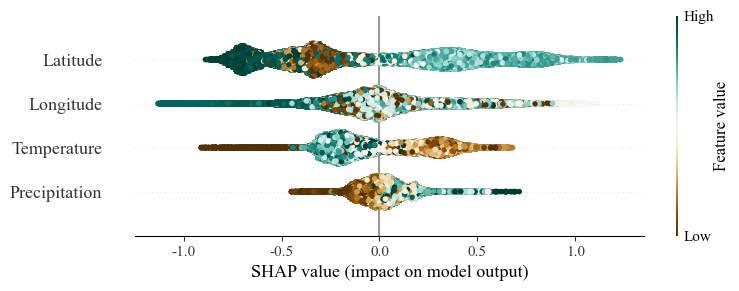

<Figure size 640x480 with 0 Axes>

In [138]:
import shap
# 构建 shap解释器
explainer = shap.TreeExplainer(model_lgb)
# 计算测试集的shap值
shap_values = explainer.shap_values(X_train)
# 特征标签
labels = X_train.columns
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = 'Times new Roman'
plt.rcParams['font.size'] = 13
#cmap="?"配色viridis Spectral coolwar mRdYlGn RdYlBu RdBu RdGy PuOr BrBG PRGn PiYG
plt.figure()
shap.summary_plot(shap_values, X_train, feature_names=labels, plot_type="dot",cmap='BrBG')

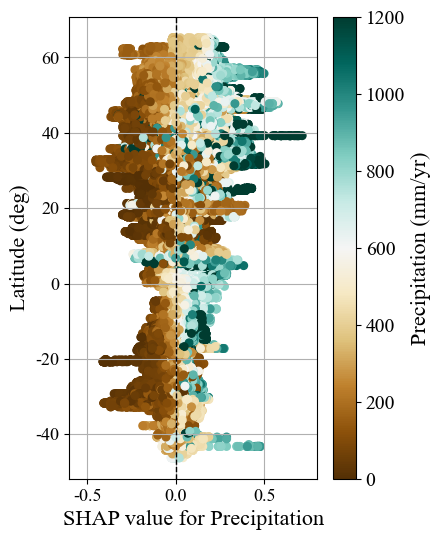

In [145]:
import shap
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors

# 假设 "Precipitation" 是降水特征的名称
precipitation_feature = "Precipitation"
latitude_feature = "Latitude"  # 假设纬度列名为 "Latitude"

# 提取降水特征的 SHAP 值和原始值
shap_values_precipitation = shap_values[:, labels == precipitation_feature].flatten()
precipitation_values = X_tmp[precipitation_feature].values  
latitude_values = X_tmp[latitude_feature].values

# 创建图形
plt.figure(figsize=(4, 6))
norm = mcolors.Normalize(vmin=0, vmax=1200)
sc = plt.scatter(shap_values_precipitation, latitude_values, c=precipitation_values, cmap='BrBG', s=30, norm=norm)

# 添加颜色条
cbar = plt.colorbar(sc, label=f'{precipitation_feature} (mm/yr)')  # 添加颜色条

# 设置颜色条的字体大小
cbar.ax.tick_params(labelsize=14)  # 设置刻度标签字体大小
cbar.ax.set_ylabel(f'{precipitation_feature} (mm/yr)', fontsize=16)  # 设置颜色条标签字体大小

# 设置图形的标签和标题
plt.xlabel("SHAP value for Precipitation", fontsize=16)
plt.ylabel("Latitude (deg)", fontsize=16)

# 添加垂直线
plt.axvline(x=0, color='black', linestyle='--', linewidth=1)

# 设置网格线
plt.grid(True)
plt.xlim(-.6,0.8)
# 保存图形
plt.savefig(r'F:\paper3_fig_v2\shap\fig\wheat_ssp585_precipitation_shap.png', dpi=300)

# 显示图形
plt.show()


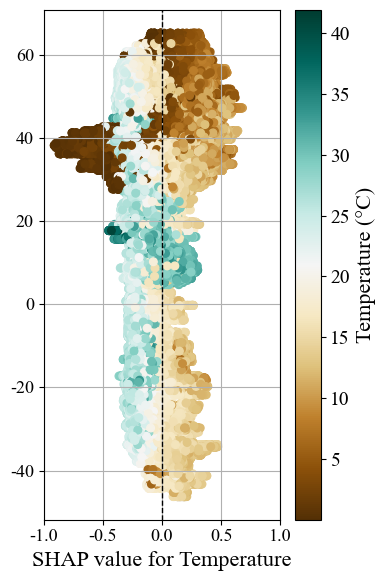

In [142]:
import shap
import matplotlib.pyplot as plt
import numpy as np

# 计算 SHAP 值
# shap_values = explainer.shap_values(X_train)

# 假设 "Precipitation" 是降水特征的名称
temperature_feature = "Temperature"
latitude_feature = "Latitude"  # 假设纬度列名为 "Latitude"

# 提取降水特征的 SHAP 值和原始值
shap_values_temperature = shap_values[:, labels == temperature_feature].flatten()
temperature_values = (X_tmp[temperature_feature].values)
# latitude_values = X_train[latitude_feature].values
latitude_values = X_tmp[latitude_feature].values

# 创建图形
plt.figure(figsize=(4, 6))
sc = plt.scatter(shap_values_temperature, latitude_values, c=temperature_values, cmap='BrBG', s=30)

# 添加颜色条
cbar = plt.colorbar(sc)  # 添加颜色条

# 设置颜色条的字体大小
cbar.ax.tick_params(labelsize=14)  # 设置刻度标签字体大小
cbar.ax.set_ylabel(f'{temperature_feature} (°C)', fontsize=16)  # 设置颜色条标签字体大小
plt.xlabel("SHAP value for Temperature", fontsize=16)
# plt.ylabel("Latitude (deg)", fontsize=16)
plt.axvline(x=0, color='black', linestyle='--', linewidth=1)
# plt.title("SHAP Values for Temperature by Latitude")
plt.grid(True)
plt.xlim(-1,1)
plt.savefig(r'F:\paper3_fig_v2\shap\fig\wheat_ssp585_Temperature_shap.png',dpi=300)
plt.tight_layout()
plt.show()


### Rice

In [24]:
import lightgbm as lgb
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 

# 读取数据（假设数据已经在 combined_df 中）
combined_df = pd.read_csv(r'F:\paper3_fig_v2\shap\data\rice_SSP585.csv') # 如果需要从文件读取数据

# 特征和目标变量
features = ['Longitude', 'Latitude', 'Precipitation', 'Temperature']
target = 'Yield'

# 创建特征矩阵 X 和目标变量 y
X = combined_df[features]
y = combined_df[target]

X_temp, X_test, y_temp, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# 然后将训练集进一步划分为训练集和验证集
X_train, X_val, y_train, y_val = train_test_split(X_temp, y_temp, test_size=0.125, random_state=42)  # 0.125 x 0.8 = 0.1
X_tmp=X_train
# 数据集标准化
x_mean = X_train.mean()
x_std =  X_train.std()
y_mean = y.mean()
y_std = y.std()
X_train = (X_train - x_mean)/x_std
y_train = (y_train-y_mean)/y_std
X_val = (X_val - x_mean)/x_std
y_val = (y_val - y_mean)/y_std
X_test = (X_test - x_mean)/x_std
y_test = (y_test - y_mean)/y_std

import lightgbm as lgb

# LightGBM模型参数
params_lgb = {
    'learning_rate': 0.1,          # 学习率，控制每一步的步长，用于防止过拟合。典型值范围：0.01 - 0.1
    'boosting_type': 'gbdt',        # 提升方法，这里使用梯度提升树（Gradient Boosting Decision Tree，简称GBDT）
    'objective': 'mse',             # 损失函数
    'metric': 'rmse',               # 评估指标
    'num_leaves': 255,              # 每棵树的叶子节点数量，控制模型复杂度。较大值可以提高模型复杂度但可能导致过拟合
    'verbose': -1,                  # 控制 LightGBM 输出信息的详细程度，-1表示无输出，0表示最少输出，正数表示输出更多信息
    'seed': 42,                     # 随机种子，用于重现模型的结果
    'n_jobs': -1,                   # 并行运算的线程数量，-1表示使用所有可用的CPU核心
    'feature_fraction': 0.8,        # 每棵树随机选择的特征比例，用于增加模型的泛化能力
    'bagging_fraction': 0.95,        # 每次迭代时随机选择的样本比例，用于增加模型的泛化能力
    'bagging_freq': 6               # 每隔多少次迭代进行一次bagging操作，用于增加模型的泛化能力
}

model_lgb = lgb.LGBMRegressor(**params_lgb)
model_lgb.fit(X_train, y_train, eval_set=[(X_val, y_val)], 
              eval_metric='rmse')  

LGBMRegressor(bagging_fraction=0.95, bagging_freq=6, feature_fraction=0.8,
              metric='rmse', n_jobs=-1, num_leaves=255, objective='mse',
              seed=42, verbose=-1)

NSE for train set: 0.7646
NSE for validation set: 0.7514
NSE for test set: 0.7515


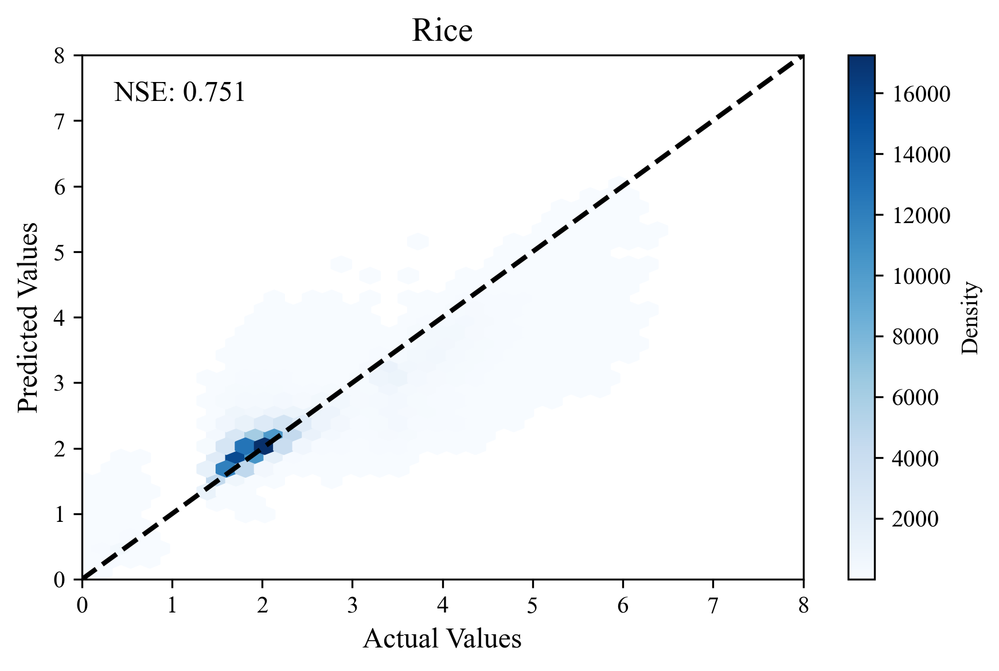

In [25]:

plt.rcParams['axes.unicode_minus'] = False
pred_train = model_lgb.predict(X_train)
pred_val = model_lgb.predict(X_val)
pred_test = model_lgb.predict(X_test)

y_train_h = y_train*y_std+y_mean
pred_train_h = pred_train*y_std+y_mean

y_val_h = y_val*y_std+y_mean
pred_val_h = pred_val*y_std+y_mean

y_test_h = y_test*y_std+y_mean
pred_test_h = pred_test*y_std+y_mean
from sklearn.metrics import mean_squared_error

# 计算NSE
def calculate_nse(y_true, y_pred):
    mse = mean_squared_error(y_true, y_pred)
    return 1 - mse / np.var(y_true)

# 计算每个数据集的NSE
nse_train = calculate_nse(y_train_h, pred_train_h)
nse_val = calculate_nse(y_val_h, pred_val_h)
nse_test = calculate_nse(y_test_h, pred_test_h)

# 输出结果
print(f'NSE for train set: {nse_train:.4f}')
print(f'NSE for validation set: {nse_val:.4f}')
print(f'NSE for test set: {nse_test:.4f}')

import seaborn as sns
colors = sns.color_palette("husl", 3)

plt.figure(figsize=(6,4),dpi=300)

plt.hexbin(y_test_h, pred_test_h, gridsize=30, cmap='Blues', mincnt=1)
plt.plot([0, 10], [0, 10], 'k--', lw=2)
plt.xlabel('Actual Values', fontsize=12)
plt.ylabel('Predicted Values', fontsize=12)
plt.title('Rice', fontsize=14)
plt.xlim([0, 8])
plt.ylim([0, 8])
plt.colorbar(label='Density')
# 替换 plt.add_text 为 plt.text
plt.text(0.23, 0.9, f'NSE: {nse_test:.3f}', transform=plt.gca().transAxes, fontsize=12, verticalalignment='bottom', horizontalalignment='right')

# 调整布局
plt.tight_layout()
plt.savefig(r'F:\paper3_fig_v2\shap\fig\rice_calibration.png',dpi=300)
plt.show()

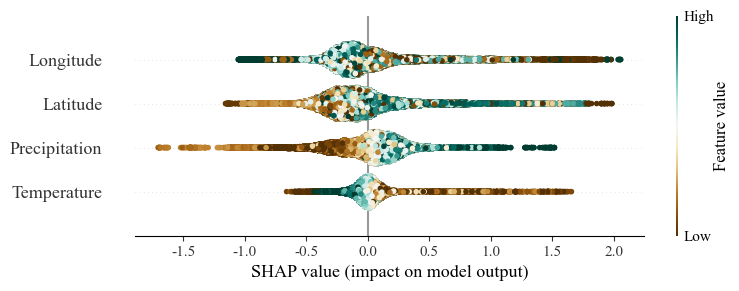

In [150]:
import shap
# 构建 shap解释器
explainer = shap.TreeExplainer(model_lgb)
# 计算测试集的shap值
shap_values = explainer.shap_values(X_train)
# 特征标签
labels = X_train.columns
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = 'Times new Roman'
plt.rcParams['font.size'] = 13
#cmap="?"配色viridis Spectral coolwar mRdYlGn RdYlBu RdBu RdGy PuOr BrBG PRGn PiYG
plt.figure()
shap.summary_plot(shap_values, X_train, feature_names=labels, plot_type="dot",cmap='BrBG')

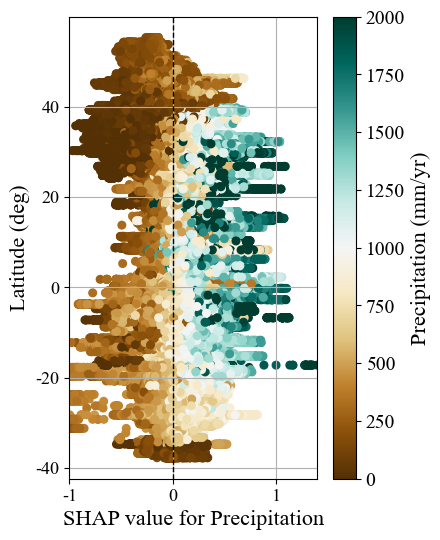

In [151]:
import shap
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors

# 假设 "Precipitation" 是降水特征的名称
precipitation_feature = "Precipitation"
latitude_feature = "Latitude"  # 假设纬度列名为 "Latitude"

# 提取降水特征的 SHAP 值和原始值
shap_values_precipitation = shap_values[:, labels == precipitation_feature].flatten()
precipitation_values = X_tmp[precipitation_feature].values  
latitude_values = X_tmp[latitude_feature].values

# 创建图形
plt.figure(figsize=(4, 6))
norm = mcolors.Normalize(vmin=0, vmax=2000)
sc = plt.scatter(shap_values_precipitation, latitude_values, c=precipitation_values, cmap='BrBG', s=30, norm=norm)

# 添加颜色条
cbar = plt.colorbar(sc, label=f'{precipitation_feature} (mm/yr)')  # 添加颜色条

# 设置颜色条的字体大小
cbar.ax.tick_params(labelsize=14)  # 设置刻度标签字体大小
cbar.ax.set_ylabel(f'{precipitation_feature} (mm/yr)', fontsize=16)  # 设置颜色条标签字体大小

# 设置图形的标签和标题
plt.xlabel("SHAP value for Precipitation", fontsize=16)
plt.ylabel("Latitude (deg)", fontsize=16)

# 添加垂直线
plt.axvline(x=0, color='black', linestyle='--', linewidth=1)

# 设置网格线
plt.grid(True)
plt.xlim(-1,1.4)
# 保存图形
plt.savefig(r'F:\paper3_fig_v2\shap\fig\rice_ssp585_precipitation_shap.png', dpi=300)

# 显示图形
plt.show()


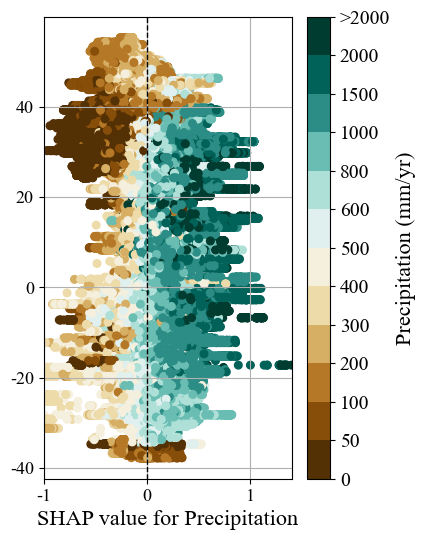

In [155]:
import shap
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# 假设 "Precipitation" 是降水特征的名称
precipitation_feature = "Precipitation"
latitude_feature = "Latitude"  # 假设纬度列名为 "Latitude"

# 提取降水特征的 SHAP 值和原始值
shap_values_precipitation = shap_values[:, labels == precipitation_feature].flatten()
precipitation_values = X_tmp[precipitation_feature].values  
latitude_values = X_tmp[latitude_feature].values

# 定义分类边界
bounds = [0, 50, 100, 200,300, 400,500,600, 800,1000,1500, 2000, np.max(precipitation_values)]

# 使用 BrBG 色带并均匀采样 8 种颜色
brbg_cmap = plt.colormaps['BrBG']  # 使用 colormaps 直接获取色带
colors = brbg_cmap(np.linspace(0, 1, 12))  # 均匀采样8种颜色
cmap = mcolors.ListedColormap(colors)  # 创建自定义颜色映射

# 使用 BoundaryNorm 对色带进行分类
norm = mcolors.BoundaryNorm(boundaries=bounds, ncolors=len(bounds)-1)

# 创建图形
plt.figure(figsize=(4, 6))
sc = plt.scatter(shap_values_precipitation, latitude_values, c=precipitation_values, cmap=cmap, s=30, norm=norm)

# 添加颜色条
cbar = plt.colorbar(sc, label=f'{precipitation_feature} (mm/yr)')

# 设置颜色条的刻度和自定义标签
cbar.set_ticks(bounds)  # 设置刻度位置
cbar.set_ticklabels(['0', '50', '100', '200','300', '400','500', '600','800','1000','1500', '2000', '>2000'])  # 自定义标签
cbar.ax.tick_params(labelsize=14)  # 设置刻度标签字体大小
cbar.ax.set_ylabel(f'{precipitation_feature} (mm/yr)', fontsize=16)  # 设置颜色条标签

# 设置图形的标签和标题
plt.xlabel("SHAP value for Precipitation", fontsize=16)
# plt.ylabel("Latitude (deg)", fontsize=16)

# 添加垂直线
plt.axvline(x=0, color='black', linestyle='--', linewidth=1)

# 设置网格线
plt.grid(True)
plt.xlim(-1,1.4)

# 保存图形
plt.savefig(r'F:\paper3_fig_v2\shap\fig\rice_ssp585_precipitation_shap.png', dpi=300)

# 显示图形
plt.show()


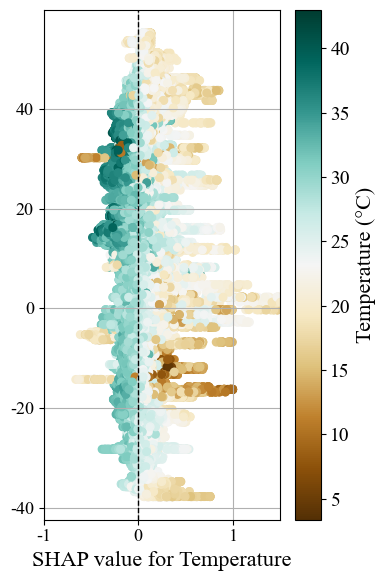

In [154]:
import shap
import matplotlib.pyplot as plt
import numpy as np

# 计算 SHAP 值
# shap_values = explainer.shap_values(X_train)

# 假设 "Precipitation" 是降水特征的名称
temperature_feature = "Temperature"
latitude_feature = "Latitude"  # 假设纬度列名为 "Latitude"

# 提取降水特征的 SHAP 值和原始值
shap_values_temperature = shap_values[:, labels == temperature_feature].flatten()
temperature_values = (X_tmp[temperature_feature].values)
# latitude_values = X_train[latitude_feature].values
latitude_values = X_tmp[latitude_feature].values

# 创建图形
plt.figure(figsize=(4, 6))
sc = plt.scatter(shap_values_temperature, latitude_values, c=temperature_values, cmap='BrBG', s=30)

# 添加颜色条
cbar = plt.colorbar(sc)  # 添加颜色条

# 设置颜色条的字体大小
cbar.ax.tick_params(labelsize=14)  # 设置刻度标签字体大小
cbar.ax.set_ylabel(f'{temperature_feature} (°C)', fontsize=16)  # 设置颜色条标签字体大小
plt.xlabel("SHAP value for Temperature", fontsize=16)
# plt.ylabel("Latitude (deg)", fontsize=16)
plt.axvline(x=0, color='black', linestyle='--', linewidth=1)
# plt.title("SHAP Values for Temperature by Latitude")
plt.grid(True)
plt.xlim(-1,1.5)
plt.savefig(r'F:\paper3_fig_v2\shap\fig\rice_ssp585_Temperature_shap.png',dpi=300)
plt.tight_layout()
plt.show()


### Soybean

In [20]:
import lightgbm as lgb
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 

# 读取数据（假设数据已经在 combined_df 中）
combined_df = pd.read_csv(r'F:\paper3_fig_v2\shap\data\soyb_SSP585.csv') # 如果需要从文件读取数据

# 特征和目标变量
features = ['Longitude', 'Latitude', 'Precipitation', 'Temperature']
target = 'Yield'

# 创建特征矩阵 X 和目标变量 y
X = combined_df[features]
y = combined_df[target]

X_temp, X_test, y_temp, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# 然后将训练集进一步划分为训练集和验证集
X_train, X_val, y_train, y_val = train_test_split(X_temp, y_temp, test_size=0.125, random_state=42)  # 0.125 x 0.8 = 0.1
X_tmp=X_train
# 数据集标准化
x_mean = X_train.mean()
x_std =  X_train.std()
y_mean = y.mean()
y_std = y.std()
X_train = (X_train - x_mean)/x_std
y_train = (y_train-y_mean)/y_std
X_val = (X_val - x_mean)/x_std
y_val = (y_val - y_mean)/y_std
X_test = (X_test - x_mean)/x_std
y_test = (y_test - y_mean)/y_std

import lightgbm as lgb

# LightGBM模型参数
params_lgb = {
    'learning_rate': 0.1,          # 学习率，控制每一步的步长，用于防止过拟合。典型值范围：0.01 - 0.1
    'boosting_type': 'gbdt',        # 提升方法，这里使用梯度提升树（Gradient Boosting Decision Tree，简称GBDT）
    'objective': 'mse',             # 损失函数
    'metric': 'rmse',               # 评估指标
    'num_leaves': 255,              # 每棵树的叶子节点数量，控制模型复杂度。较大值可以提高模型复杂度但可能导致过拟合
    'verbose': -1,                  # 控制 LightGBM 输出信息的详细程度，-1表示无输出，0表示最少输出，正数表示输出更多信息
    'seed': 42,                     # 随机种子，用于重现模型的结果
    'n_jobs': -1,                   # 并行运算的线程数量，-1表示使用所有可用的CPU核心
    'feature_fraction': 0.8,        # 每棵树随机选择的特征比例，用于增加模型的泛化能力
    'bagging_fraction': 0.95,        # 每次迭代时随机选择的样本比例，用于增加模型的泛化能力
    'bagging_freq': 6               # 每隔多少次迭代进行一次bagging操作，用于增加模型的泛化能力
}

model_lgb = lgb.LGBMRegressor(**params_lgb)
model_lgb.fit(X_train, y_train, eval_set=[(X_val, y_val)], 
              eval_metric='rmse')  

LGBMRegressor(bagging_fraction=0.95, bagging_freq=6, feature_fraction=0.8,
              metric='rmse', n_jobs=-1, num_leaves=255, objective='mse',
              seed=42, verbose=-1)

NSE for train set: 0.7524
NSE for validation set: 0.7387
NSE for test set: 0.7394


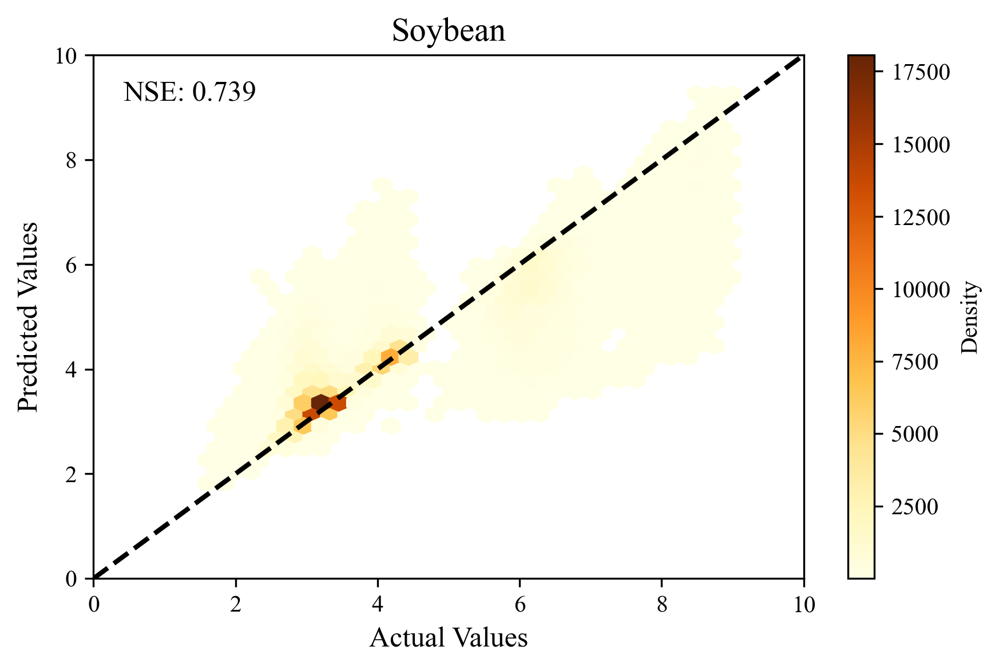

In [23]:
import matplotlib as mpl

mpl.rcParams['font.family'] = 'Times New Roman'
plt.rcParams['axes.unicode_minus'] = False
pred_train = model_lgb.predict(X_train)
pred_val = model_lgb.predict(X_val)
pred_test = model_lgb.predict(X_test)

y_train_h = y_train*y_std+y_mean
pred_train_h = pred_train*y_std+y_mean

y_val_h = y_val*y_std+y_mean
pred_val_h = pred_val*y_std+y_mean

y_test_h = y_test*y_std+y_mean
pred_test_h = pred_test*y_std+y_mean
from sklearn.metrics import mean_squared_error

# 计算NSE
def calculate_nse(y_true, y_pred):
    mse = mean_squared_error(y_true, y_pred)
    return 1 - mse / np.var(y_true)

# 计算每个数据集的NSE
nse_train = calculate_nse(y_train_h, pred_train_h)
nse_val = calculate_nse(y_val_h, pred_val_h)
nse_test = calculate_nse(y_test_h, pred_test_h)

# 输出结果
print(f'NSE for train set: {nse_train:.4f}')
print(f'NSE for validation set: {nse_val:.4f}')
print(f'NSE for test set: {nse_test:.4f}')

import seaborn as sns
colors = sns.color_palette("husl", 3)

plt.figure(figsize=(6,4),dpi=300)

plt.hexbin(y_test_h, pred_test_h, gridsize=30, cmap='YlOrBr', mincnt=1)
plt.plot([0, 10], [0, 10], 'k--', lw=2)
plt.xlabel('Actual Values', fontsize=12)
plt.ylabel('Predicted Values', fontsize=12)
plt.title('Soybean', fontsize=14)
plt.xlim([0, 10])
plt.ylim([0, 10])
plt.colorbar(label='Density')
# 替换 plt.add_text 为 plt.text
plt.text(0.23, 0.9, f'NSE: {nse_test:.3f}', transform=plt.gca().transAxes, fontsize=12, verticalalignment='bottom', horizontalalignment='right')

# 调整布局
plt.tight_layout()
plt.savefig(r'F:\paper3_fig_v2\shap\fig\soyb_calibration.png',dpi=300)
plt.show()

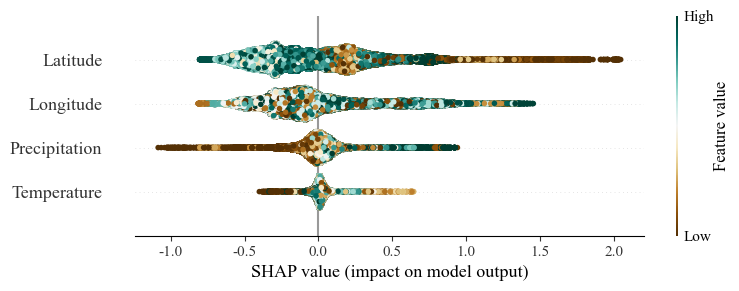

In [165]:
import shap
# 构建 shap解释器
explainer = shap.TreeExplainer(model_lgb)
# 计算测试集的shap值
shap_values = explainer.shap_values(X_train)
# 特征标签
labels = X_train.columns
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = 'Times new Roman'
plt.rcParams['font.size'] = 13
#cmap="?"配色viridis Spectral coolwar mRdYlGn RdYlBu RdBu RdGy PuOr BrBG PRGn PiYG
plt.figure()
shap.summary_plot(shap_values, X_train, feature_names=labels, plot_type="dot",cmap='BrBG')

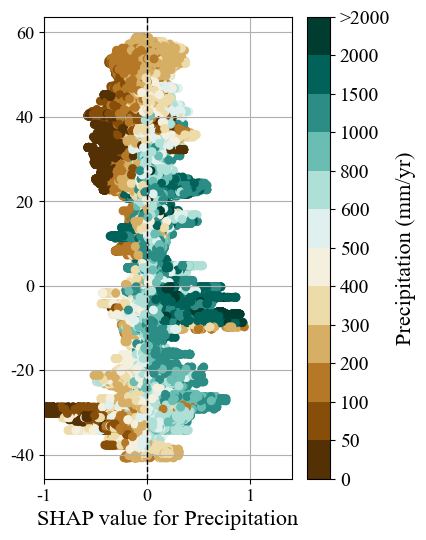

In [173]:
import shap
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# 假设 "Precipitation" 是降水特征的名称
precipitation_feature = "Precipitation"
latitude_feature = "Latitude"  # 假设纬度列名为 "Latitude"

# 提取降水特征的 SHAP 值和原始值
shap_values_precipitation = shap_values[:, labels == precipitation_feature].flatten()
precipitation_values = X_tmp[precipitation_feature].values  
latitude_values = X_tmp[latitude_feature].values

# 定义分类边界
bounds = [0, 50, 100, 200,300, 400,500,600, 800,1000,1500, 2000, np.max(precipitation_values)]

# 使用 BrBG 色带并均匀采样 8 种颜色
brbg_cmap = plt.colormaps['BrBG']  # 使用 colormaps 直接获取色带
colors = brbg_cmap(np.linspace(0, 1, 12))  # 均匀采样8种颜色
cmap = mcolors.ListedColormap(colors)  # 创建自定义颜色映射

# 使用 BoundaryNorm 对色带进行分类
norm = mcolors.BoundaryNorm(boundaries=bounds, ncolors=len(bounds)-1)

# 创建图形
plt.figure(figsize=(4, 6))
sc = plt.scatter(shap_values_precipitation, latitude_values, c=precipitation_values, cmap=cmap, s=30, norm=norm)

# 添加颜色条
cbar = plt.colorbar(sc, label=f'{precipitation_feature} (mm/yr)')

# 设置颜色条的刻度和自定义标签
cbar.set_ticks(bounds)  # 设置刻度位置
cbar.set_ticklabels(['0', '50', '100', '200','300', '400','500', '600','800','1000','1500', '2000', '>2000'])  # 自定义标签
cbar.ax.tick_params(labelsize=14)  # 设置刻度标签字体大小
cbar.ax.set_ylabel(f'{precipitation_feature} (mm/yr)', fontsize=16)  # 设置颜色条标签

# 设置图形的标签和标题
plt.xlabel("SHAP value for Precipitation", fontsize=16)
# plt.ylabel("Latitude (deg)", fontsize=16)

# 添加垂直线
plt.axvline(x=0, color='black', linestyle='--', linewidth=1)

# 设置网格线
plt.grid(True)
plt.xlim(-1,1.4)

# 保存图形
plt.savefig(r'F:\paper3_fig_v2\shap\fig\soyb_ssp585_precipitation_shap.png', dpi=300)

# 显示图形
plt.show()


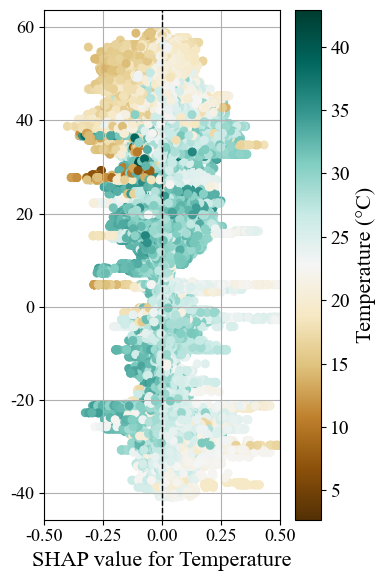

In [176]:
import shap
import matplotlib.pyplot as plt
import numpy as np

# 计算 SHAP 值
# shap_values = explainer.shap_values(X_train)

# 假设 "Precipitation" 是降水特征的名称
temperature_feature = "Temperature"
latitude_feature = "Latitude"  # 假设纬度列名为 "Latitude"

# 提取降水特征的 SHAP 值和原始值
shap_values_temperature = shap_values[:, labels == temperature_feature].flatten()
temperature_values = (X_tmp[temperature_feature].values)
# latitude_values = X_train[latitude_feature].values
latitude_values = X_tmp[latitude_feature].values

# 创建图形
plt.figure(figsize=(4, 6))
sc = plt.scatter(shap_values_temperature, latitude_values, c=temperature_values, cmap='BrBG', s=30)

# 添加颜色条
cbar = plt.colorbar(sc)  # 添加颜色条

# 设置颜色条的字体大小
cbar.ax.tick_params(labelsize=14)  # 设置刻度标签字体大小
cbar.ax.set_ylabel(f'{temperature_feature} (°C)', fontsize=16)  # 设置颜色条标签字体大小
plt.xlabel("SHAP value for Temperature", fontsize=16)
# plt.ylabel("Latitude (deg)", fontsize=16)
plt.axvline(x=0, color='black', linestyle='--', linewidth=1)
# plt.title("SHAP Values for Temperature by Latitude")
plt.grid(True)
plt.xlim(-.5,.5)
plt.savefig(r'F:\paper3_fig_v2\shap\fig\soyb_ssp585_Temperature_shap.png',dpi=300)
plt.tight_layout()
plt.show()


## extreme weathers

### data analysis

In [14]:
import xarray as xr
import pandas as pd
import numpy as np
from tqdm.notebook import tqdm
import os
from os.path import join
from xarray.coding.times import decode_cf_datetime

# 加载原始数据和初始化变量

ss = ['ssp126', 'ssp370', 'ssp585']
fp = r'D:\isimip_cmip6_time_bias'

# 创建新NC文件的模板，时间范围从2015年到2100年
years = np.arange(2015, 2101)
crops=['maiz','rice','soyb','swh','wwh']
var=['txx','prx']
vn=['tasmax','pr']
for asw,extr in tqdm(enumerate(var), desc="Processing climate"):
    for crop in tqdm(crops, desc="Processing crop", leave=False):
        ori = xr.open_dataset(rf'F:\paper3_fig_v2\extreme\hist\extreme_95\{crop}_{extr}.nc').data[::-1]
        for ssp in tqdm(ss, desc="Processing scenario", leave=False):
            for inst in tqdm(os.listdir(fp), desc="Processing institution", leave=False):
                new_data = xr.DataArray(
                    np.zeros((len(years), len(ori.lat), len(ori.lon))),  # 空数组
                    coords={"time": years, "lat": ori.lat, "lon": ori.lon},  # 保持与 ori 一致的空间坐标
                    dims=("time", "lat", "lon"),
                    name='data'
                )
                
                for file in os.listdir(join(fp, inst)):
                    if file.split('_')[3] == ssp and file.split('_')[4] == vn[asw]:
                        tas_max = xr.open_dataset(join(fp, inst, file), decode_times=False)[vn[asw]]
                        
                        # 获取时间单位和日历信息
                        units = tas_max.time.attrs['units']  # 获取时间单位
                        calendar = tas_max.time.attrs.get('calendar', 'standard')  # 获取日历类型，默认'标准'
                        
                        # 使用 decode_cf_datetime 来解码时间轴
                        dates = decode_cf_datetime(tas_max.time.values, units, calendar)
                        tas_max = tas_max.assign_coords(time=("time", dates))
                        
                        tas_max=tas_max.where(ori>0)
                        if crop=='maiz':
                            nh = tas_max.sel(time=tas_max['time.month'].isin([5, 6, 7, 8, 9]))[:,:180,:]
                            sh = tas_max.sel(time=tas_max['time.month'].isin([1, 2, 3, 11, 12]))[:,180:,:]
                        elif crop=='rice':
                            nh = tas_max.sel(time=tas_max['time.month'].isin([5, 6, 7, 8, 9]))[:,:180,:]
                            sh = tas_max.sel(time=tas_max['time.month'].isin([1, 2, 3, 11, 12]))[:,180:,:]
                        elif crop=='soyb':
                            nh = tas_max.sel(time=tas_max['time.month'].isin([5, 6, 7, 8]))[:,:180,:]
                            sh = tas_max.sel(time=tas_max['time.month'].isin([1, 2,3, 11, 12]))[:,180:,:]
                        elif crop=='swh':
                            nh = tas_max.sel(time=tas_max['time.month'].isin([5, 6, 7, 8]))[:,:180,:]
                            sh = tas_max.sel(time=tas_max['time.month'].isin([1, 2,10, 11, 12]))[:,180:,:]
                        elif crop=='wwh':
                            nh = tas_max.sel(time=tas_max['time.month'].isin([1,2,3,4,5,10,11,12]))[:,:180,:]
                            sh = tas_max.sel(time=tas_max['time.month'].isin([6,7,8,9,10,11]))[:,180:,:]
                        
                        # 遍历每一年
                        for year in range(int(file.split('_')[-2]), int(file.split('_')[-1][:-3]) + 1):
        
                            # 存入新数据集中对应年份的位置
                            new_data.loc[dict(time=year)][:180,:] += (((nh.sel(time=str(year)) > ori[:180,:]).sum(dim="time")).values/len(nh.sel(time=str(year)).time)*100)
                            new_data.loc[dict(time=year)][180:,:] += (((sh.sel(time=str(year)) > ori[180:,:]).sum(dim="time")).values/len(nh.sel(time=str(year)).time)*100)
        
                # 将结果保存为新的NetCDF文件
                new_data.to_netcdf(rf'F:\paper3_fig_v2\extreme\future_freq\95\single\{extr}_{crop}_{ssp}_{inst}.nc')


Processing climate: 0it [00:00, ?it/s]

Processing crop:   0%|          | 0/5 [00:00<?, ?it/s]

Processing scenario:   0%|          | 0/3 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing scenario:   0%|          | 0/3 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing scenario:   0%|          | 0/3 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing scenario:   0%|          | 0/3 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing scenario:   0%|          | 0/3 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing crop:   0%|          | 0/5 [00:00<?, ?it/s]

Processing scenario:   0%|          | 0/3 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing scenario:   0%|          | 0/3 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing scenario:   0%|          | 0/3 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing scenario:   0%|          | 0/3 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing scenario:   0%|          | 0/3 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

Processing institution:   0%|          | 0/10 [00:00<?, ?it/s]

In [19]:
import os
import xarray as xr
import pandas as pd
import numpy as np
from os.path import join
# 场景列表
crops = ['maiz', 'soyb', 'rice', 'wheat']
ss = ['ssp126', 'ssp370', 'ssp585']
fp = r'F:\CWatM\cwatm_output\global_future'

# 初始化结果字典
data_dict = {}
for extr in var:
    # 遍历每个作物
    for crop in crops:
        results = {}
    
        # 遍历每个情景
        for ssp in ss:
            institution_means_list = []
    
            for inst in os.listdir(fp):
                if inst == 'GWSP3_W5E5' or inst == 'MRI-ESM2-0':
                    continue
                filepath = join(r'F:\paper3_fig_v2\extreme\future_freq\95\single')
                if crop=='wheat':
                    csr = xr.open_dataset(join(filepath, F'{extr}_swh_{ssp}_{inst}.nc'), decode_times=False).data.fillna(0)+ xr.open_dataset(join(filepath, F'{extr}_wwh_{ssp}_{inst}.nc'), decode_times=False).data.fillna(0)
                else:
                    csr = xr.open_dataset(join(filepath, F'{extr}_{crop}_{ssp}_{inst}.nc'), decode_times=False).data
                csr = csr.where(csr != 0, np.nan)
    
                institution_means_list.append(csr)
    
            combined_means = xr.concat(institution_means_list, dim='institution')
            overall_mean = combined_means.median(dim='institution', skipna=True)
            overall_mean.to_netcdf(join(r'F:\paper3_fig_v2\extreme\future_freq\95\median',F'{extr}_{crop}_{ssp}_median.nc'))

In [53]:
import xarray as xr
import numpy as np
import scipy.stats as stats
from tqdm.notebook import tqdm

# 读取极端气温天数数据
# extreme_tasmax = xr.open_dataset(r'F:\paper3_fig\exterme_tasmax_ssp126_CNRM-CM6-1.nc').__xarray_dataarray_variable__[5:,:,:]


# 读取产量数据
# yield_data = xr.open_dataset(r'F:\CWatM\cwatm_output\global_future\CNRM-CM6-1\SSP126\Yield_nonIrr_annualtot_MAIZ.nc', decode_times=False).Yield_nonIrr_annualtot

for extr in tqdm(var, desc="Processing climate"):
    
    for crop in tqdm(crops, desc="Processing crop", leave=False):
    
        # 遍历每个情景
        for ssp in tqdm(ss, desc="Processing ssp", leave=False):
            extreme_tasmax = xr.open_dataset(join(r'F:\paper3_fig_v2\extreme\future_freq\95\median',F'{extr}_{crop}_{ssp}_median.nc')).data[5:-1,:,:]
            yield_data = xr.open_dataset(join(r'F:\paper3_fig_v2\yield\yield\a_median',F'median_{crop}_{ssp}_relitive_yield.nc'), decode_times=False).__xarray_dataarray_variable__
            # 确保两个数据集的空间坐标一致
            lat = extreme_tasmax.lat
            lon = extreme_tasmax.lon
            
            # 创建空的 DataArray 来存储相关性结果和 p 值
            correlation_data = xr.DataArray(
                data=np.full((len(lat), len(lon)), np.nan),  # 初始化为 NaN
                coords={"lat": lat, "lon": lon},
                dims=("lat", "lon"),
                name='data'
            )
            
            p_value_data = xr.DataArray(
                data=np.full((len(lat), len(lon)), np.nan),  # 初始化为 NaN
                coords={"lat": lat, "lon": lon},
                dims=("lat", "lon"),
                name='data'
            )
            
            # 遍历每个空间点并计算相关性和 p 值
            for la in tqdm(lat[60:-90], desc="Processing lat", leave=False):
                for lo in tqdm(lon[100:700], desc="Processing lon", leave=False):
                    # 提取该点的极端气温天数和产量时间序列
                    extreme_series = extreme_tasmax.sel(lat=la, lon=lo).values
                    yield_series = yield_data.sel(lat=la, lon=lo).values
                    
                    # 检查两者是否有有效数据
                    if np.all(yield_series > 0) and np.all(extreme_series > 0):
                        # 计算相关性和 p 值
                        correlation, p_value = stats.pearsonr(extreme_series, yield_series)
                        
                        # 存储相关性结果和 p 值
                        correlation_data.loc[dict(lat=la, lon=lo)] = correlation
                        p_value_data.loc[dict(lat=la, lon=lo)] = p_value
            
            # 保存相关性结果和 p 值为新的 NetCDF 文件
            correlation_data.to_netcdf(join(r'F:\paper3_fig_v2\extreme\future_freq\95\correlation',f'{extr}_{crop}_{ssp}_correlation.nc'))
            p_value_data.to_netcdf(join(r'F:\paper3_fig_v2\extreme\future_freq\95\correlation',f'{extr}_{crop}_{ssp}_p_value.nc'))


Processing climate:   0%|          | 0/2 [00:00<?, ?it/s]

Processing crop:   0%|          | 0/4 [00:00<?, ?it/s]

Processing ssp:   0%|          | 0/3 [00:00<?, ?it/s]

Processing lat:   0%|          | 0/210 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lat:   0%|          | 0/210 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lat:   0%|          | 0/210 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing ssp:   0%|          | 0/3 [00:00<?, ?it/s]

Processing lat:   0%|          | 0/210 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lat:   0%|          | 0/210 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lat:   0%|          | 0/210 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing ssp:   0%|          | 0/3 [00:00<?, ?it/s]

Processing lat:   0%|          | 0/210 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lat:   0%|          | 0/210 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lat:   0%|          | 0/210 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing ssp:   0%|          | 0/3 [00:00<?, ?it/s]

Processing lat:   0%|          | 0/210 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lat:   0%|          | 0/210 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lat:   0%|          | 0/210 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing crop:   0%|          | 0/4 [00:00<?, ?it/s]

Processing ssp:   0%|          | 0/3 [00:00<?, ?it/s]

Processing lat:   0%|          | 0/210 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lat:   0%|          | 0/210 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lat:   0%|          | 0/210 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing ssp:   0%|          | 0/3 [00:00<?, ?it/s]

Processing lat:   0%|          | 0/210 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lat:   0%|          | 0/210 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lat:   0%|          | 0/210 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing ssp:   0%|          | 0/3 [00:00<?, ?it/s]

Processing lat:   0%|          | 0/210 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lat:   0%|          | 0/210 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lat:   0%|          | 0/210 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing ssp:   0%|          | 0/3 [00:00<?, ?it/s]

Processing lat:   0%|          | 0/210 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lat:   0%|          | 0/210 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lat:   0%|          | 0/210 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

Processing lon:   0%|          | 0/600 [00:00<?, ?it/s]

### Txx

In [29]:
import os
import xarray as xr
import numpy as np
from os.path import join
import pandas as pd

# 设置默认字体为 Times New Roman
import matplotlib as mpl
mpl.rcParams['font.family'] = 'Times New Roman'

# 场景列表
crops = ['maiz', 'soyb', 'rice', 'wheat']
ss = ['ssp126', 'ssp370', 'ssp585']
fp =  r'F:\CWatM\cwatm_output\global_future'

# 初始化一个字典来存储所有作物和情景的数据
crop_data = {}
extr='txx'
# 遍历每个作物
for crop in crops:
    # 初始化用于存储结果的字典
    results = {}

    # 遍历每个情景
    for ssp in ss:
        yr_values = []
        for inst in os.listdir(fp):
            if inst == 'GWSP3_W5E5' or inst == 'MRI-ESM2-0':
                continue
            filepath = join(r'F:\paper3_fig_v2\extreme\future_freq\95\single')
            if crop=='wheat':
                csr = xr.open_dataset(join(filepath, F'{extr}_swh_{ssp}_{inst}.nc'), decode_times=False).data.fillna(0)+ xr.open_dataset(join(filepath, F'{extr}_wwh_{ssp}_{inst}.nc'), decode_times=False).data.fillna(0)
            else:
                csr = xr.open_dataset(join(filepath, F'{extr}_{crop}_{ssp}_{inst}.nc'), decode_times=False).data
            csr=csr.where(csr>0)
            yr = csr.mean(dim=['lat', 'lon'])
            yr_values.append(yr)

        # 存储每个情景的结果
        results[ssp] = np.array(yr_values)
    
    # 存储每个作物的所有情景结果
    crop_data[crop] = results


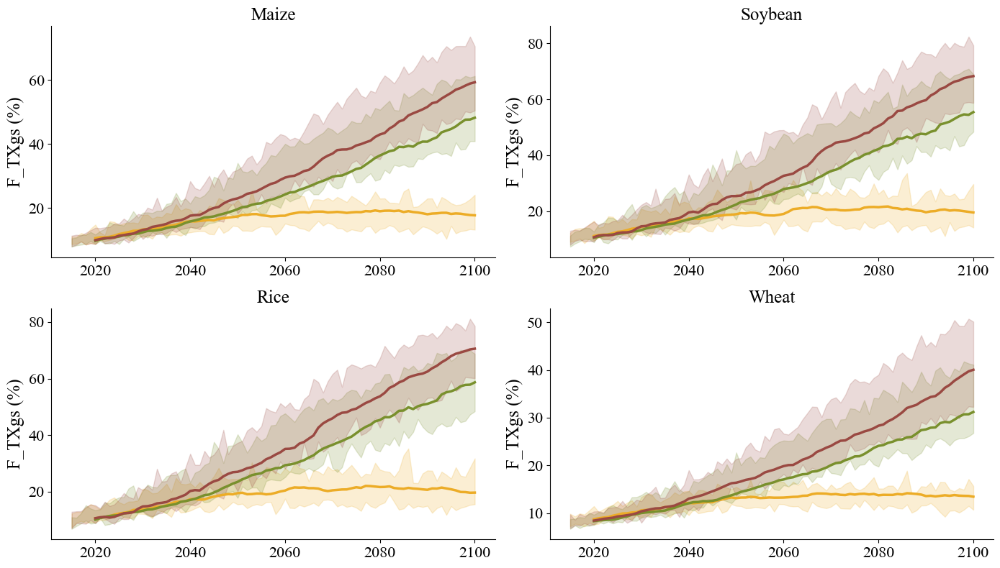

In [31]:
import matplotlib.patches as mpatches  # 导入用于创建色块的模块
import matplotlib.pyplot as plt
# 定义每个情景的颜色
ssp_colors = {
    'ssp126': '#ECAC27',
    'ssp370': '#79902D',
    'ssp585': '#9A4942'
}
years=np.arange(2015,2101)
crop_name = ['Maize', 'Soybean', 'Rice', 'Wheat']
# 用于存储图例色块
legend_patches = [mpatches.Patch(color=ssp_colors[ssp], label=ssp) for ssp in ss]

# 开始绘制图形
fig, axs = plt.subplots(2, 2, figsize=(14, 8))  # 4行1列布局
axs = axs.flatten()  # 将子图轴展平成1D数组，方便遍历

# 遍历字典进行绘图
for idx, (crop, results) in enumerate(crop_data.items()):
    ax = axs[idx]  # 获取当前子图轴
    for ssp in ss:
        yr_transposed = results[ssp].T
        
        # 去除每个年份的最小值和最大值
        yr_filtered = []
        for yr in yr_transposed:
            yr_sorted = np.sort(yr)
            yr_filtered.append(yr_sorted[1:-1])  # 去除最小值和最大值
        
        # 转回原来的形状
        yr_filtered = np.array(yr_filtered).T
        
        # 计算去除极值后的均值和范围
        mean_yr = np.median(yr_filtered, axis=0) 
        min_yr = yr_filtered.min(axis=0)
        max_yr = yr_filtered.max(axis=0)
        window_size = 6  # 可以调整窗口大小以控制平滑度
        bb_smooth = pd.Series(mean_yr).rolling(window=window_size).mean()

        # 绘制曲线，设置对应的颜色
        ax.plot(years, bb_smooth, linewidth=2.5, color=ssp_colors[ssp])
        
        # 绘制均值和范围
        ax.fill_between(years, min_yr, max_yr, color=ssp_colors[ssp], alpha=0.2)
    # ax.axvspan(2035, 2045, color='gray', alpha=0.3)
    # 隐藏右侧和顶部的轴
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.tick_params(axis='both', labelsize=16)
    # 隐藏网格线
    ax.grid(False)
    ax.set_title(crop_name[idx], fontsize=18)
    # 除了最后一张子图，隐藏X轴
    # if idx < len(crops) - 1:
    #     ax.set_xticklabels([])
    # else:
    # ax.set_xlabel('Year', fontsize=18)
        
    # Y轴标签
    ax.set_ylabel('F_TXgs (%)', fontsize=18)

# 调整子图之间的间距
plt.subplots_adjust(hspace=0.3)

# 添加全局图例在最下方，将线条换为色块
# fig.legend(handles=legend_patches, loc='lower center', bbox_to_anchor=(0.5, -0.0), ncol=len(ss), fontsize=18, frameon=False)

plt.tight_layout()
# 保存图像
plt.savefig(r'F:\paper3_fig_v2\extreme\future_freq\95\fig\F_TXgs.png', dpi=300)

# 显示图像
plt.show()


txx_maiz_ssp126 <xarray.DataArray 'data' ()> Size: 8B
array(-0.37680052)


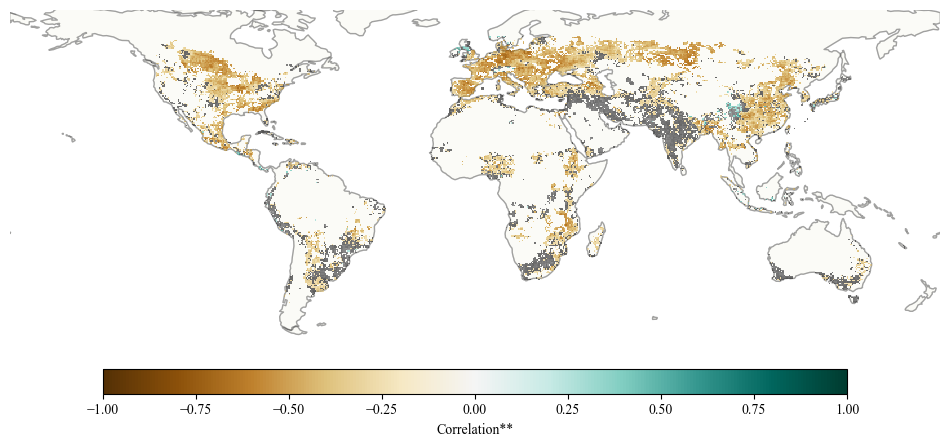

txx_maiz_ssp370 <xarray.DataArray 'data' ()> Size: 8B
array(-0.45613486)


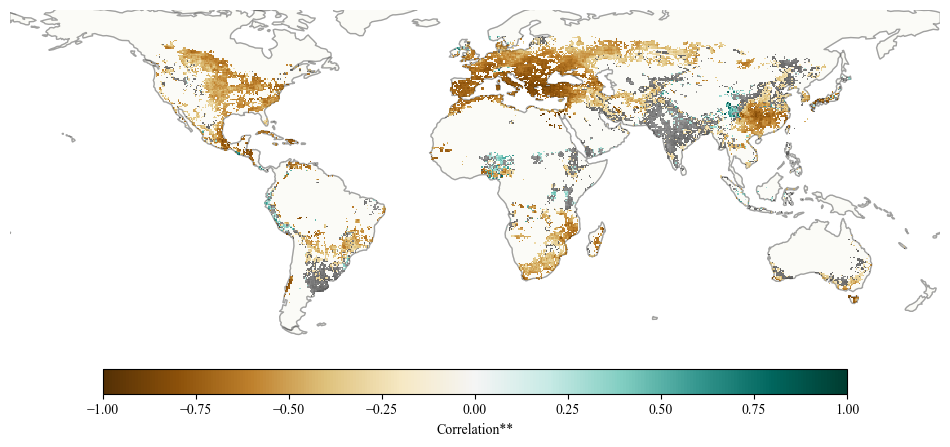

txx_maiz_ssp585 <xarray.DataArray 'data' ()> Size: 8B
array(-0.51239966)


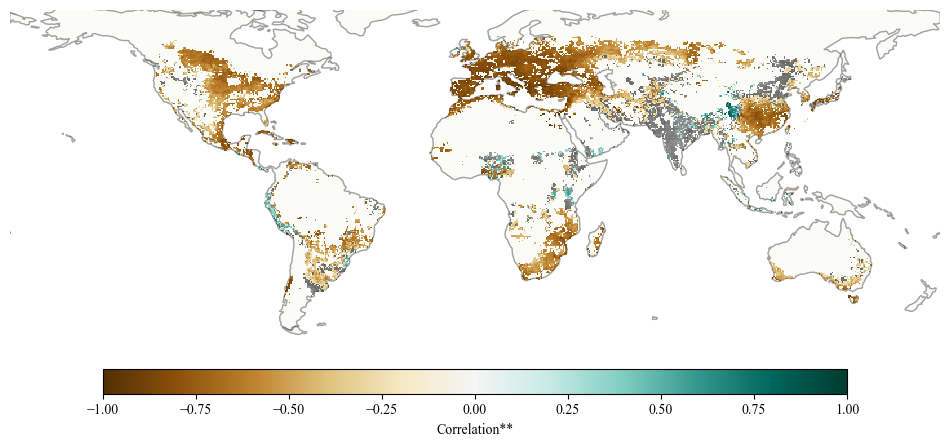

txx_soyb_ssp126 <xarray.DataArray 'data' ()> Size: 8B
array(-0.3674961)


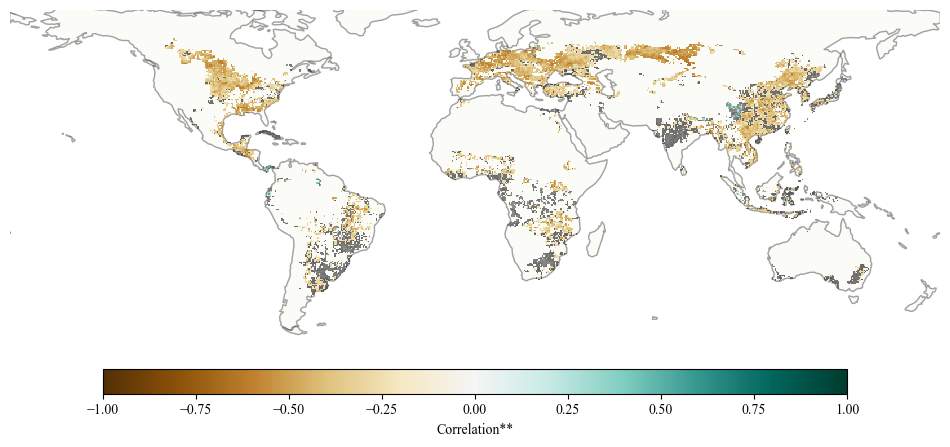

txx_soyb_ssp370 <xarray.DataArray 'data' ()> Size: 8B
array(-0.45465081)


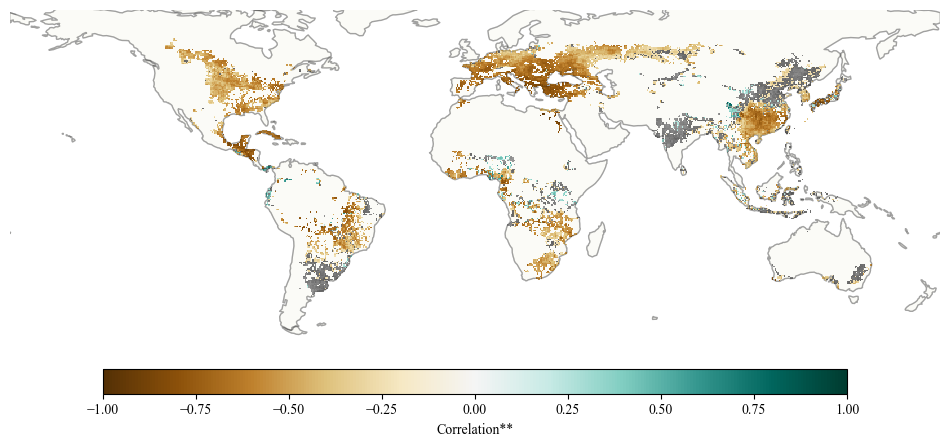

txx_soyb_ssp585 <xarray.DataArray 'data' ()> Size: 8B
array(-0.50818783)


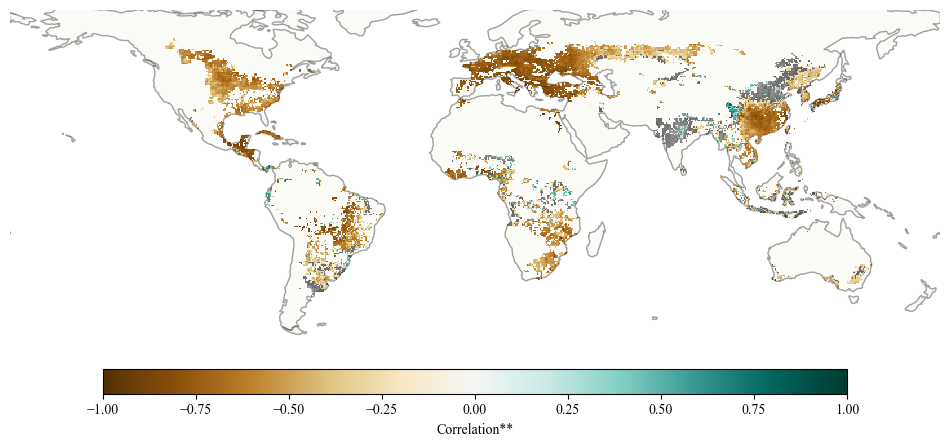

txx_rice_ssp126 <xarray.DataArray 'data' ()> Size: 8B
array(-0.30930213)


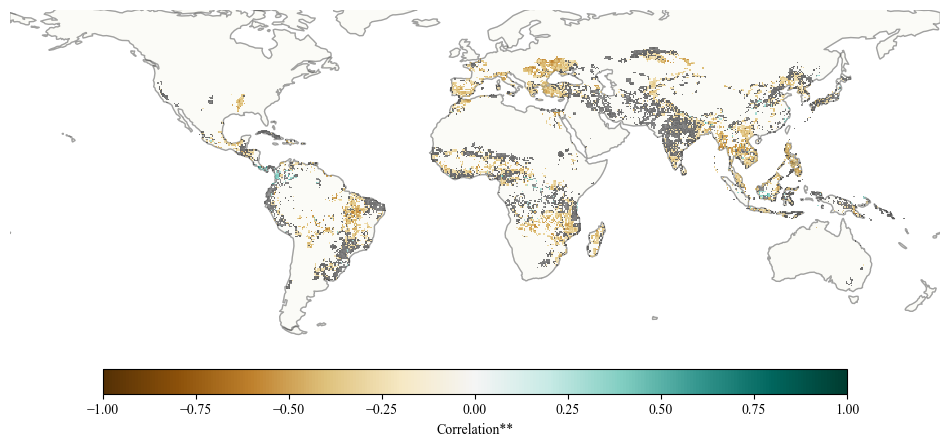

txx_rice_ssp370 <xarray.DataArray 'data' ()> Size: 8B
array(-0.38329322)


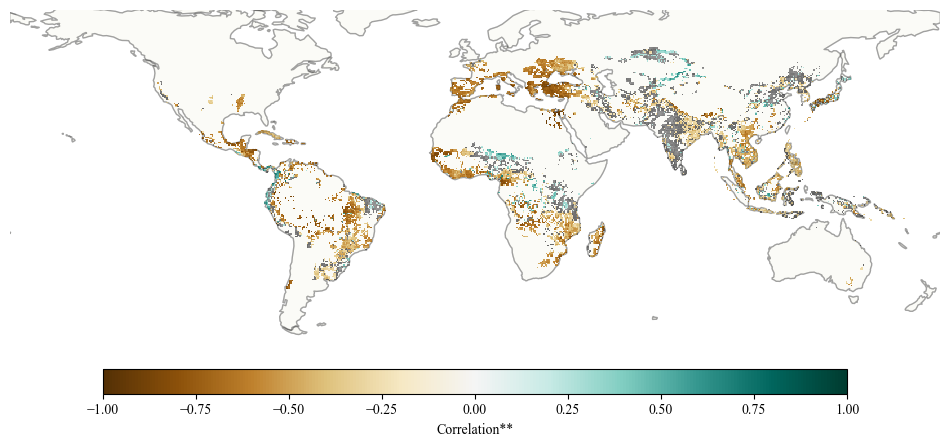

txx_rice_ssp585 <xarray.DataArray 'data' ()> Size: 8B
array(-0.41413767)


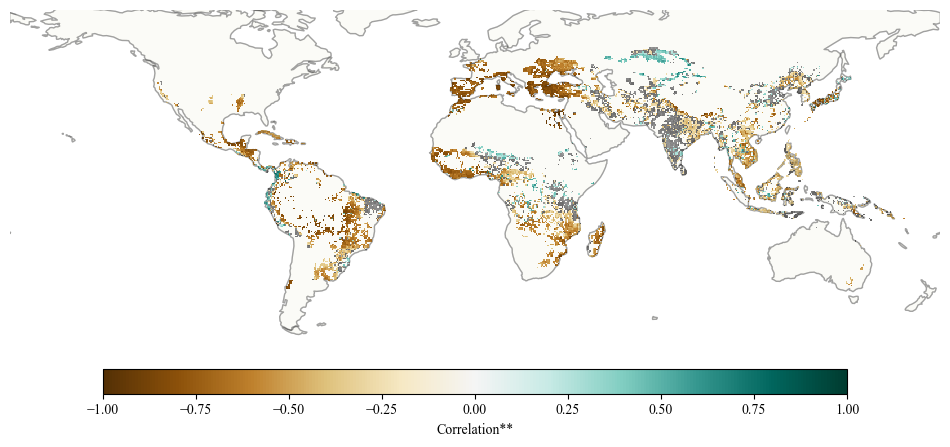

txx_wheat_ssp126 <xarray.DataArray 'data' ()> Size: 8B
array(-0.32803824)


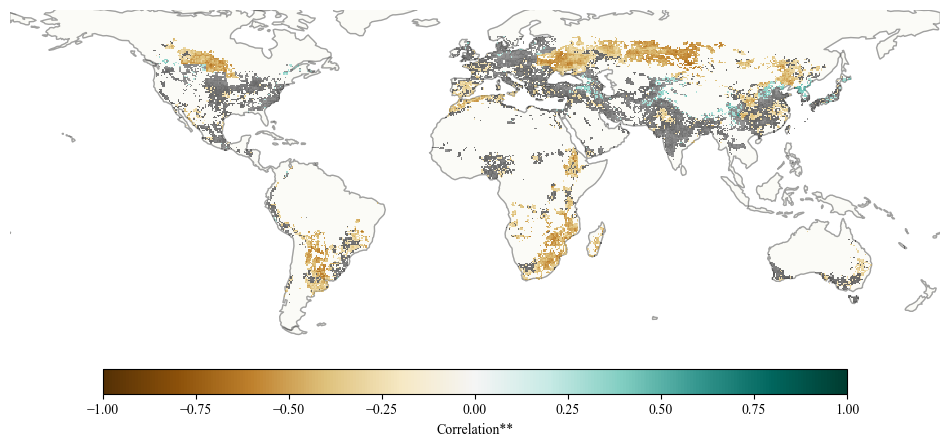

txx_wheat_ssp370 <xarray.DataArray 'data' ()> Size: 8B
array(-0.23393037)


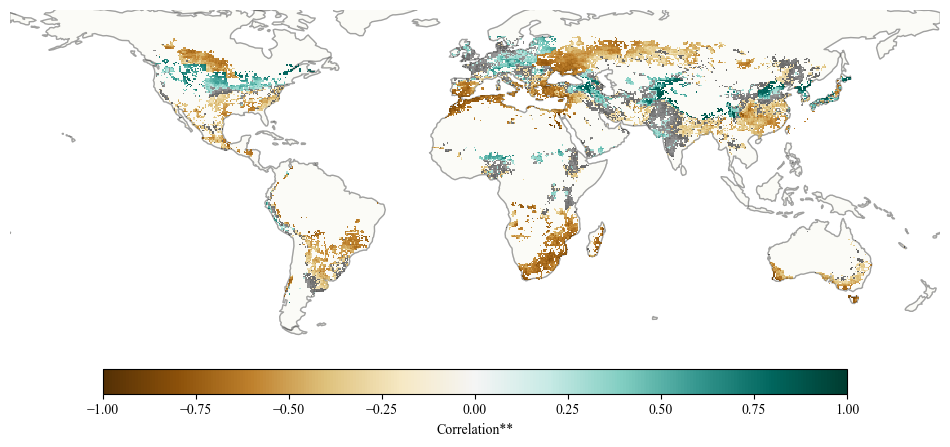

txx_wheat_ssp585 <xarray.DataArray 'data' ()> Size: 8B
array(-0.29315762)


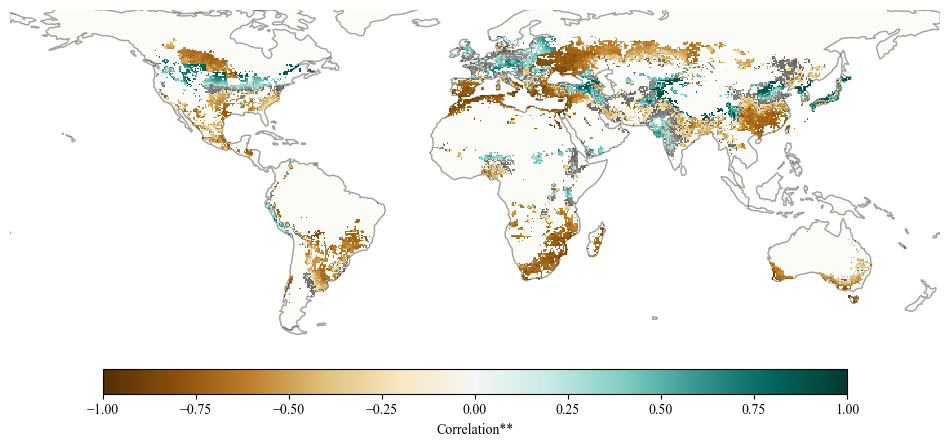

prx_maiz_ssp126 <xarray.DataArray 'data' ()> Size: 8B
array(0.44008541)


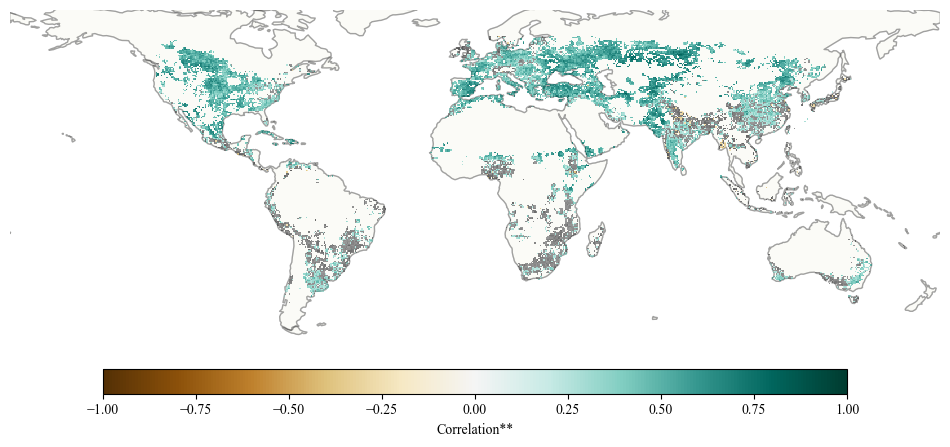

prx_maiz_ssp370 <xarray.DataArray 'data' ()> Size: 8B
array(0.46364973)


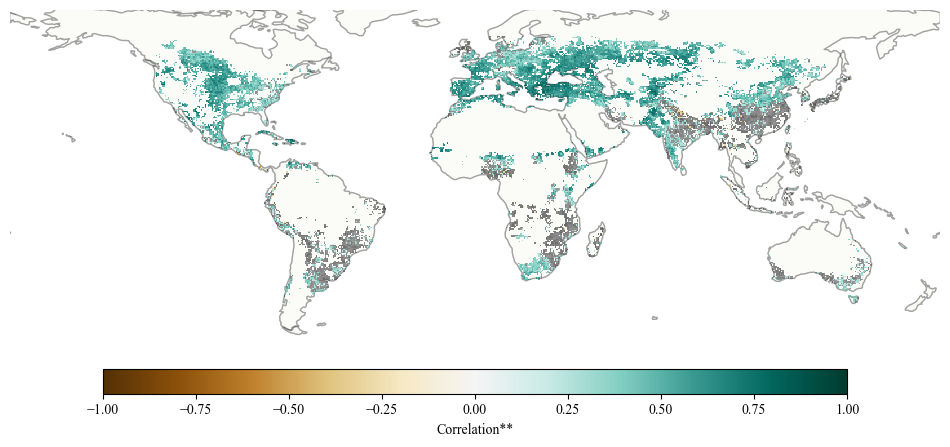

prx_maiz_ssp585 <xarray.DataArray 'data' ()> Size: 8B
array(0.46316675)


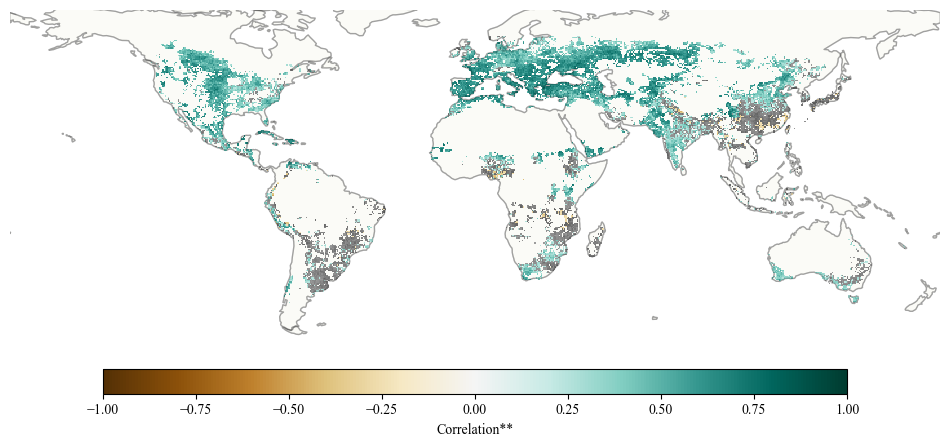

prx_soyb_ssp126 <xarray.DataArray 'data' ()> Size: 8B
array(0.42089649)


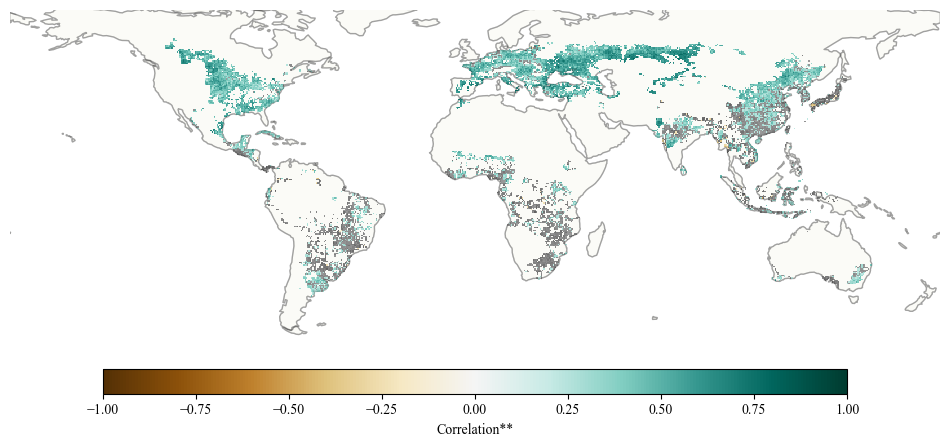

prx_soyb_ssp370 <xarray.DataArray 'data' ()> Size: 8B
array(0.44512509)


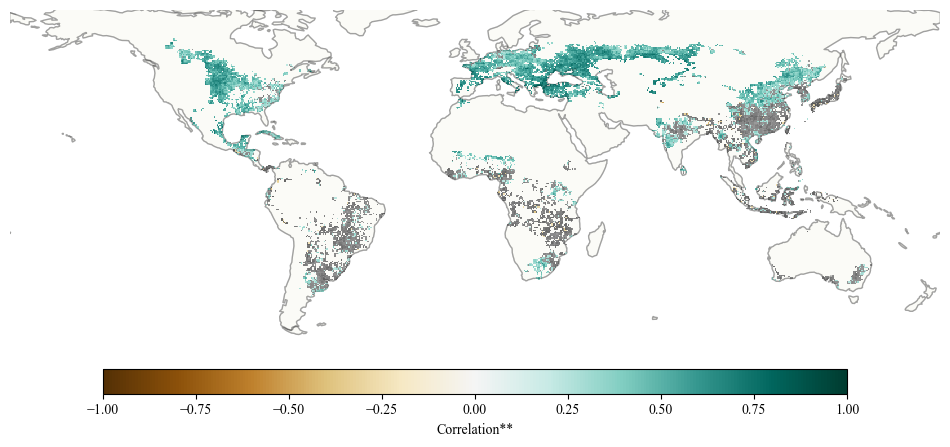

prx_soyb_ssp585 <xarray.DataArray 'data' ()> Size: 8B
array(0.44207347)


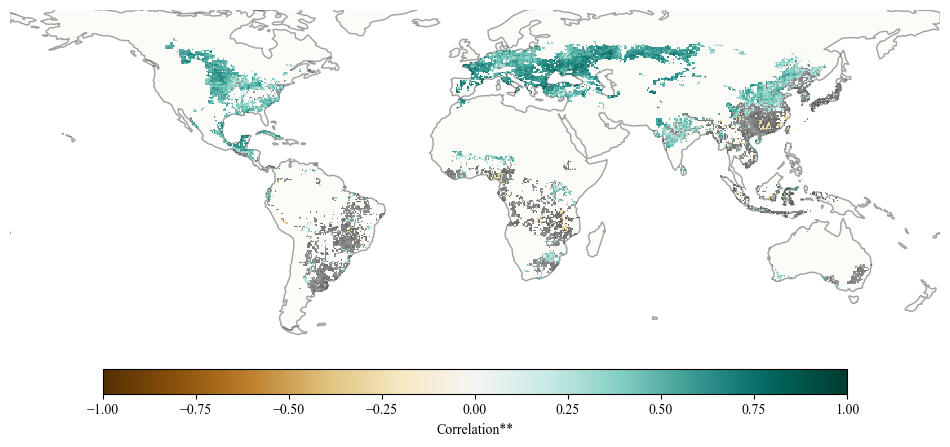

prx_rice_ssp126 <xarray.DataArray 'data' ()> Size: 8B
array(0.3336072)


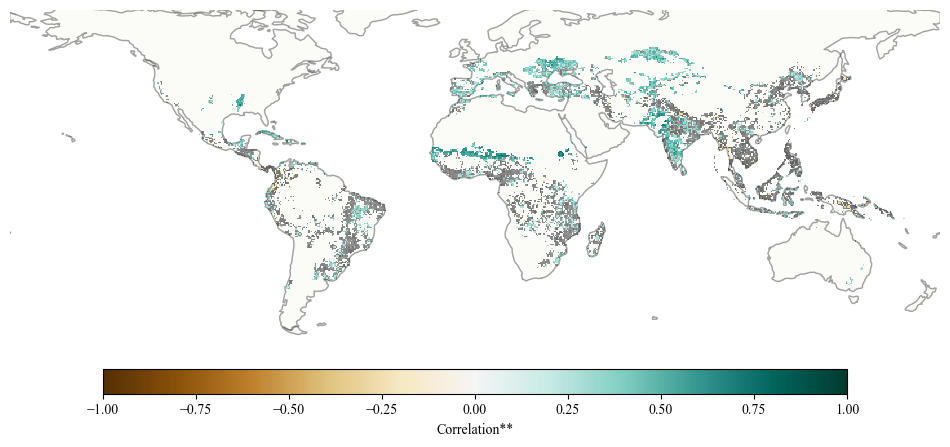

prx_rice_ssp370 <xarray.DataArray 'data' ()> Size: 8B
array(0.33151995)


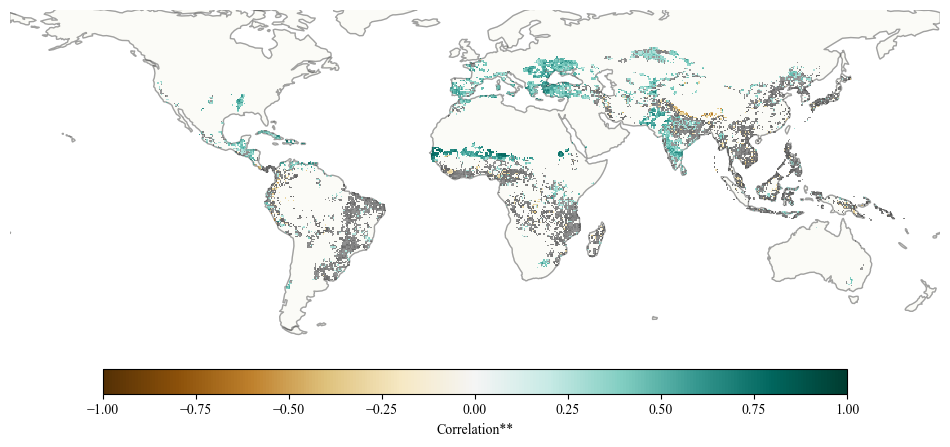

prx_rice_ssp585 <xarray.DataArray 'data' ()> Size: 8B
array(0.29441036)


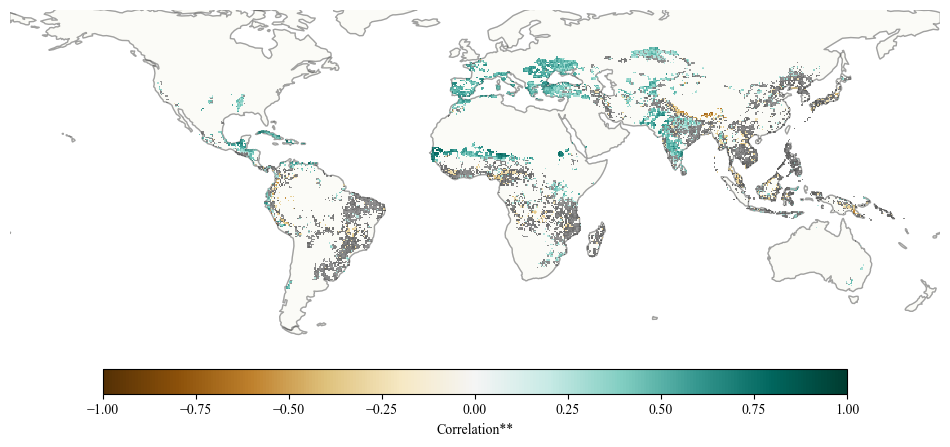

prx_wheat_ssp126 <xarray.DataArray 'data' ()> Size: 8B
array(0.41265713)


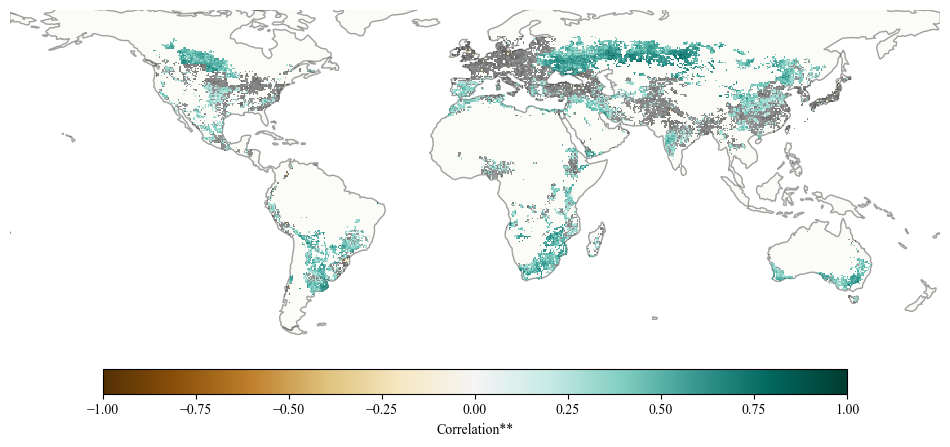

prx_wheat_ssp370 <xarray.DataArray 'data' ()> Size: 8B
array(0.41921348)


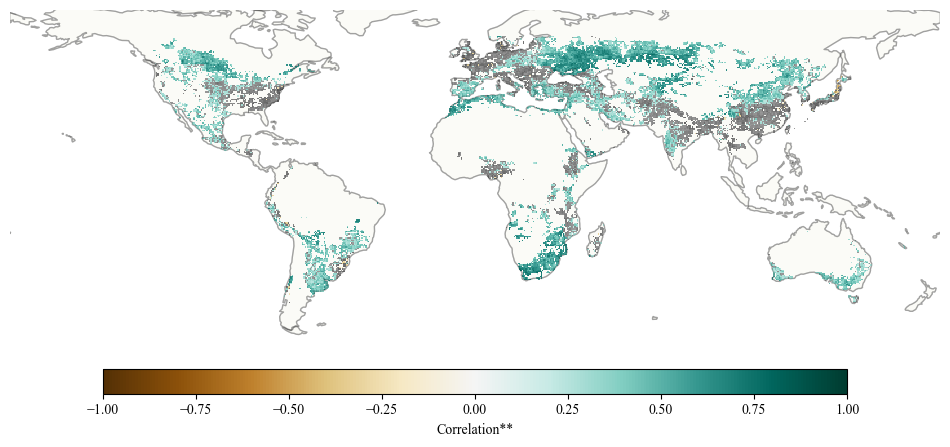

prx_wheat_ssp585 <xarray.DataArray 'data' ()> Size: 8B
array(0.42956142)


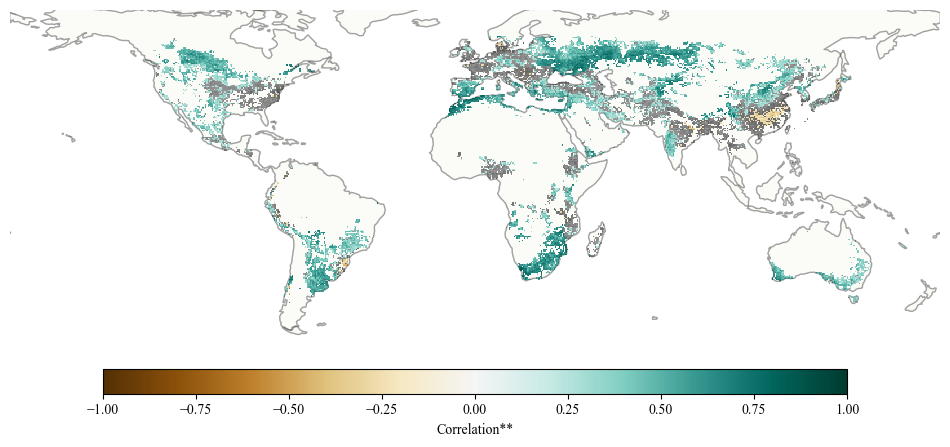

In [255]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
var=['txx','prx']
for extr in var:
    
    for crop in crops:
    
        # 遍历每个情景
        for ssp in ss:
            difference = xr.open_dataset(rf'F:\paper3_fig_v2\extreme\future_freq\95\correlation\{extr}_{crop}_{ssp}_correlation.nc').data
            p_value = xr.open_dataset(rf'F:\paper3_fig_v2\extreme\future_freq\95\correlation\{extr}_{crop}_{ssp}_p_value.nc').data
            
            # 创建图形
            fig = plt.figure(figsize=(12, 6))
            ax = plt.axes(projection=ccrs.PlateCarree())  # 使用 PlateCarree 投影
            ax.set_extent([-180, 180, -60, 70], crs=ccrs.PlateCarree())
            
            # 添加底图
            ax.add_feature(cfeature.COASTLINE, alpha=0.2)
            ax.add_feature(cfeature.LAND, edgecolor='black', alpha=0.2)
            
            # 绘制非显著区域
            non_significant_plot = difference.where(p_value >= 0.05).plot(
                ax=ax, 
                transform=ccrs.PlateCarree(), 
                cmap='grey', 
                vmin=-1, 
                vmax=1, 
                add_colorbar=False,  # 不为非显著区域添加色带
                alpha=1
            )
            aa=difference.where(p_value < 0.05)
            print(f'{extr}_{crop}_{ssp}', aa.mean())
            # 绘制显著区域
            significant_plot = aa.plot(
                ax=ax, 
                transform=ccrs.PlateCarree(), 
                cmap='BrBG', 
                vmin=-1, 
                vmax=1, 
                cbar_kwargs={'orientation': 'horizontal', 'pad': 0.05, 'shrink': 0.8, 'aspect': 30, 'label': 'Correlation**'},
                alpha=1
            )
            
            # 去除网格线和边框
            gl = ax.gridlines(draw_labels=False)
            gl.xlines = False
            gl.ylines = False
            ax.spines['geo'].set_visible(False)
            
            # 保存图像
            plt.savefig(rf'F:\paper3_fig_v2\extreme\future_freq\95\fig\{extr}_{crop}_{ssp}.png', dpi=300)
            
            # 显示图像
            plt.show()


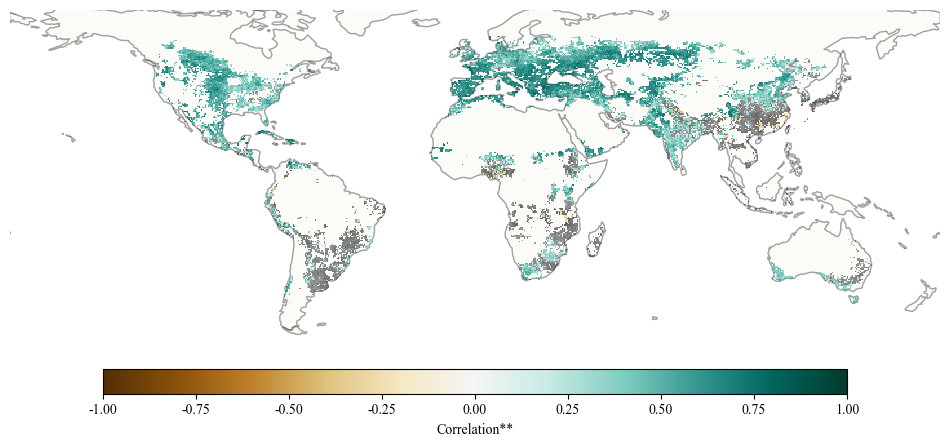

In [63]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# 读取数据
difference = xr.open_dataset(r'F:\paper3_fig_v2\extreme\future_freq\95\correlation\prx_maiz_ssp585_correlation.nc').data
p_value = xr.open_dataset(r'F:\paper3_fig_v2\extreme\future_freq\95\correlation\prx_maiz_ssp585_p_value.nc').data

# 创建图形
fig = plt.figure(figsize=(12, 6))
ax = plt.axes(projection=ccrs.PlateCarree())  # 使用 PlateCarree 投影
ax.set_extent([-180, 180, -60, 70], crs=ccrs.PlateCarree())

# 添加底图
ax.add_feature(cfeature.COASTLINE, alpha=0.2)
ax.add_feature(cfeature.LAND, edgecolor='black', alpha=0.2)

# 绘制非显著区域
non_significant_plot = difference.where(p_value >= 0.05).plot(
    ax=ax, 
    transform=ccrs.PlateCarree(), 
    cmap='grey', 
    vmin=-1, 
    vmax=1, 
    add_colorbar=False,  # 不为非显著区域添加色带
    alpha=1
)
aa=difference.where(p_value < 0.05)
# 绘制显著区域
significant_plot = aa.plot(
    ax=ax, 
    transform=ccrs.PlateCarree(), 
    cmap='BrBG', 
    vmin=-1, 
    vmax=1, 
    cbar_kwargs={'orientation': 'horizontal', 'pad': 0.05, 'shrink': 0.8, 'aspect': 30, 'label': 'Correlation**'},
    alpha=1
)

# 去除网格线和边框
gl = ax.gridlines(draw_labels=False)
gl.xlines = False
gl.ylines = False
ax.spines['geo'].set_visible(False)

# 保存图像
plt.savefig(r'F:\paper3_fig_v2\extreme\future_freq\95\fig\correlation_px.png', dpi=300)

# 显示图像
plt.show()


In [ ]:
import numpy as np

# 假设 yr_time 和 tas_time 是你已经计算好的时间序列数据
# yr_time = ...  # 粮食产量时间序列均值
# tas_time = ...  # 温度时间序列均值

# 使用 np.polyfit 进行线性回归，计算斜率（温度变化 1°C 时产量的变化）
slope, intercept = np.polyfit(tas_time, yr_time, 1)
prec=slope/yr_time[0]*100
# 输出结果：温度上升 1°C 时粮食产量的变化
print(f"温度上升 1°C 时，粮食产量的变化为 {prec:.6f}%")


In [74]:
import xarray as xr
import numpy as np
import scipy.stats as stats
from tqdm.notebook import tqdm

for extr in var:
    
    for crop in crops:
    
        # 遍历每个情景
        for ssp in ss:
            extreme_tasmax = xr.open_dataset(join(r'F:\paper3_fig_v2\extreme\future_freq\95\median',F'{extr}_{crop}_{ssp}_median.nc')).data[5:-1,:,:]
            yield_data = xr.open_dataset(join(r'F:\paper3_fig_v2\yield\yield\a_median',F'median_{crop}_{ssp}_relitive_yield.nc'), decode_times=False).__xarray_dataarray_variable__
            # 确保两个数据集的空间坐标一致
            yield_data=yield_data.where(yield_data>0)
            yr_time=yield_data.mean(dim=['lat','lon'])
            slope, intercept = np.polyfit(extreme_tasmax.mean(dim=['lat','lon']), yr_time, 1)
            prec=slope/yr_time[0]*100
            # 输出结果：温度上升 1°C 时粮食产量的变化
            print(f"{extr}  {crop}  {ssp}  {prec:.6f}%")


txx  maiz  ssp126  -0.081872%
txx  maiz  ssp370  -0.070929%
txx  maiz  ssp585  -0.081990%
txx  soyb  ssp126  -0.031210%
txx  soyb  ssp370  -0.030722%
txx  soyb  ssp585  -0.036650%
txx  rice  ssp126  -0.075087%
txx  rice  ssp370  -0.051275%
txx  rice  ssp585  -0.055822%
txx  wheat  ssp126  0.114613%
txx  wheat  ssp370  0.058876%
txx  wheat  ssp585  0.040955%
prx  maiz  ssp126  1.031797%
prx  maiz  ssp370  -3.392298%
prx  maiz  ssp585  -5.611004%
prx  soyb  ssp126  0.455625%
prx  soyb  ssp370  -1.724005%
prx  soyb  ssp585  -2.579050%
prx  rice  ssp126  -0.478434%
prx  rice  ssp370  -2.802881%
prx  rice  ssp585  -3.102811%
prx  wheat  ssp126  1.251855%
prx  wheat  ssp370  2.409395%
prx  wheat  ssp585  1.862503%


In [81]:
import xarray as xr
import numpy as np
import scipy.stats as stats
from tqdm.notebook import tqdm
from os.path import join

for extr in var:
    
    for crop in crops:
    
        # 遍历每个情景
        for ssp in ss:
            # 加载数据
            extreme_tasmax = xr.open_dataset(join(r'F:\paper3_fig_v2\extreme\future_freq\95\median', F'{extr}_{crop}_{ssp}_median.nc')).data[5:-1,:,:]
            yield_data = xr.open_dataset(join(r'F:\paper3_fig_v2\yield\yield\a_median', F'median_{crop}_{ssp}_relitive_yield.nc'), decode_times=False).__xarray_dataarray_variable__
            
            # 确保两个数据集的空间坐标一致
            yield_data = yield_data.where(yield_data > 0)
            yr_time = yield_data.mean(dim=['lat', 'lon'])

            # 计算空间平均温度和产量数据
            extreme_tasmax_avg = extreme_tasmax.mean(dim=['lat', 'lon']).values
            yr_time_avg = yr_time.values
            
            # 使用 np.polyfit 进行线性拟合，并返回斜率和截距
            slope, intercept = np.polyfit(extreme_tasmax_avg, yr_time_avg, 1)
            
            # 计算预测值和残差
            predicted = slope * extreme_tasmax_avg + intercept
            residuals = yr_time_avg - predicted
            
            # 根据残差计算标准误差
            dof = len(extreme_tasmax_avg) - 2  # 自由度
            residual_std_error = np.sqrt(np.sum(residuals**2) / dof)
            
            # 斜率的标准误差
            x_mean = np.mean(extreme_tasmax_avg)
            slope_std_error = residual_std_error / np.sqrt(np.sum((extreme_tasmax_avg - x_mean)**2))
            
            # 计算产量变化百分比
            prec = slope / yr_time_avg[0] * 100
            prec_error = slope_std_error / yr_time_avg[0] * 100
            
            # 输出结果：温度上升 1°C 时粮食产量的变化及其误差
            print(f"{extr}  {crop}  {ssp}  {prec:.6f}±{prec_error:.6f} %")


txx  maiz  ssp126  -0.081872±0.014686 %
txx  maiz  ssp370  -0.070929±0.002895 %
txx  maiz  ssp585  -0.081990±0.002428 %
txx  soyb  ssp126  -0.031210±0.007361 %
txx  soyb  ssp370  -0.030722±0.001494 %
txx  soyb  ssp585  -0.036650±0.001292 %
txx  rice  ssp126  -0.075087±0.007157 %
txx  rice  ssp370  -0.051275±0.001725 %
txx  rice  ssp585  -0.055822±0.001116 %
txx  wheat  ssp126  0.114613±0.014632 %
txx  wheat  ssp370  0.058876±0.002765 %
txx  wheat  ssp585  0.040955±0.002489 %
prx  maiz  ssp126  1.031797±0.382928 %
prx  maiz  ssp370  -3.392298±0.641046 %
prx  maiz  ssp585  -5.611004±0.765095 %
prx  soyb  ssp126  0.455625±0.204047 %
prx  soyb  ssp370  -1.724005±0.249289 %
prx  soyb  ssp585  -2.579050±0.274608 %
prx  rice  ssp126  -0.478434±0.264991 %
prx  rice  ssp370  -2.802881±0.227990 %
prx  rice  ssp585  -3.102811±0.183966 %
prx  wheat  ssp126  1.251855±0.174973 %
prx  wheat  ssp370  2.409395±0.198441 %
prx  wheat  ssp585  1.862503±0.164319 %


In [89]:
import xarray as xr
import numpy as np
import scipy.stats as stats
from tqdm.notebook import tqdm
from os.path import join
var=['tas','pr']
ss=['ssp126', 'ssp370', 'ssp585']
vv=['tas','crop_Precipitation_nonIrr_annualtot']
for i,extr in enumerate(var):
    
    for crop in crops:
    
        # 遍历每个情景
        for ssp in ss:
            # 加载数据
            extreme_tasmax = xr.open_dataset(join(rf'F:\paper3_fig_v2\climate\{extr}\a_median', F'median_{crop}_{ssp}_{extr}.nc'))[vv[i]][-80:,:,:]
            yield_data = xr.open_dataset(join(r'F:\paper3_fig_v2\yield\yield\a_median', F'median_{crop}_{ssp}_yield.nc'), decode_times=False).__xarray_dataarray_variable__
            
            # 确保两个数据集的空间坐标一致
            yield_data = yield_data.where(yield_data > 0)
            yr_time = yield_data.mean(dim=['lat', 'lon'])

            # 计算空间平均温度和产量数据
            extreme_tasmax_avg = extreme_tasmax.mean(dim=['lat', 'lon']).values
            yr_time_avg = yr_time.values
            
            # 使用 np.polyfit 进行线性拟合，并返回斜率和截距
            slope, intercept = np.polyfit(extreme_tasmax_avg, yr_time_avg, 1)
            
            # 计算预测值和残差
            predicted = slope * extreme_tasmax_avg + intercept
            residuals = yr_time_avg - predicted
            
            # 根据残差计算标准误差
            dof = len(extreme_tasmax_avg) - 2  # 自由度
            residual_std_error = np.sqrt(np.sum(residuals**2) / dof)
            
            # 斜率的标准误差
            x_mean = np.mean(extreme_tasmax_avg)
            slope_std_error = residual_std_error / np.sqrt(np.sum((extreme_tasmax_avg - x_mean)**2))
            
            # 计算产量变化百分比
            prec = slope / yr_time_avg[0] * 100
            prec_error = slope_std_error / yr_time_avg[0] * 100
            
            # 输出结果：温度上升 1°C 时粮食产量的变化及其误差
            print(f"{extr}  {crop}  {ssp}  {prec:.6f}±{prec_error:.6f} %")


tas  maiz  ssp126  0.782148±0.312540 %
tas  maiz  ssp370  -0.474129±0.033397 %
tas  maiz  ssp585  -0.601040±0.030956 %
tas  soyb  ssp126  0.514747±0.101071 %
tas  soyb  ssp370  -0.032156±0.038402 %
tas  soyb  ssp585  -0.692209±0.051463 %
tas  rice  ssp126  -1.136407±0.205325 %
tas  rice  ssp370  -1.566428±0.046234 %
tas  rice  ssp585  -2.099509±0.066843 %
tas  wheat  ssp126  2.900981±0.138902 %
tas  wheat  ssp370  -0.160800±0.029625 %
tas  wheat  ssp585  -0.488338±0.037512 %
pr  maiz  ssp126  0.228925±0.046845 %
pr  maiz  ssp370  -0.136865±0.035931 %
pr  maiz  ssp585  -0.222754±0.045195 %
pr  soyb  ssp126  0.120829±0.025870 %
pr  soyb  ssp370  0.085869±0.035650 %
pr  soyb  ssp585  -0.321760±0.089536 %
pr  rice  ssp126  -0.108319±0.037763 %
pr  rice  ssp370  -0.700010±0.087769 %
pr  rice  ssp585  -0.910222±0.110973 %
pr  wheat  ssp126  0.295212±0.049748 %
pr  wheat  ssp370  -0.054002±0.020207 %
pr  wheat  ssp585  -0.272078±0.036461 %


In [93]:
ori=xr.open_dataset(r'F:\paper3_fig_v2\yield\yield\gswp3_w5e5\wheat_yield.nc').__xarray_dataarray_variable__
ori=ori.where(ori>0)
slope/ori.mean(dim=['lat', 'lon']).values*100

-0.28039004534417644

In [94]:
slope

-125.63361813610368

In [90]:
yr_time_avg[0]

46175.645

-2.6332635432481766


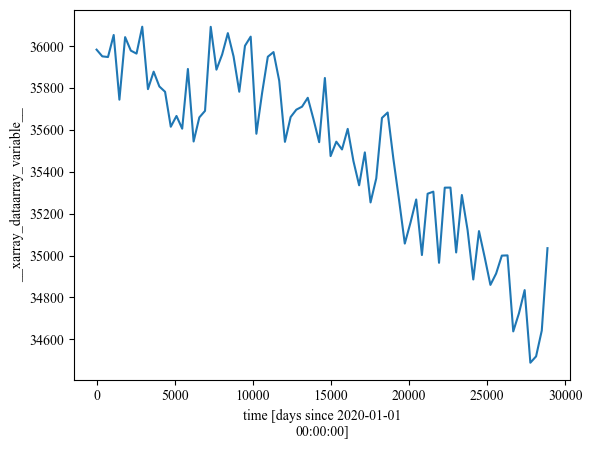

In [74]:
i=0;extr='tas';crop='maiz';ssp='ssp585'
extreme_tasmax = xr.open_dataset(join(rf'F:\paper3_fig_v2\climate\{extr}\a_median', F'median_{crop}_{ssp}_{extr}.nc'))[vv[i]][-80:,:,:]
yield_data = xr.open_dataset(join(r'F:\paper3_fig_v2\yield\yield\a_median', F'median_{crop}_{ssp}_yield.nc'), decode_times=False).__xarray_dataarray_variable__
aa=yield_data.mean(dim=['lat','lon'])
print(((aa[-1]-aa[0])/aa[0]*100).values)
aa.plot()

<xarray.DataArray 'tas' ()> Size: 4B
array(5.776861, dtype=float32)


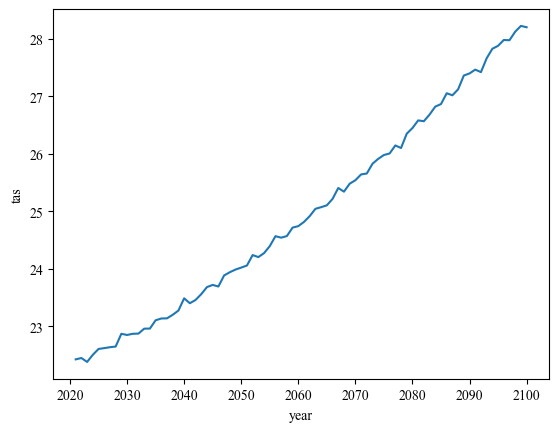

In [71]:
aa=extreme_tasmax.mean(dim=['lat','lon'])
print(aa[-1]-aa[0])
aa.plot()

In [136]:
import xarray as xr
import numpy as np
import scipy.stats as stats
from tqdm.notebook import tqdm
from os.path import join
var=['tas','pr']
ss=['ssp126', 'ssp370', 'ssp585']
vv=['tas','crop_Precipitation_nonIrr_annualtot']
for i,extr in enumerate(var):
    
    for crop in crops:
    
        # 遍历每个情景
        for ssp in ss:
            # 加载数据
            extreme_tasmax = xr.open_dataset(join(rf'F:\paper3_fig_v2\climate\{extr}\a_median', F'median_{crop}_{ssp}_{extr}.nc'))[vv[i]][-80:,120:240,:]
            yield_data = xr.open_dataset(join(r'F:\paper3_fig_v2\yield\yield\a_median', F'median_{crop}_{ssp}_yield.nc'), decode_times=False).__xarray_dataarray_variable__[:,120:240,:]
            
            # 确保两个数据集的空间坐标一致
            yield_data = yield_data.where(yield_data > 0)
            yr_time = yield_data.mean(dim=['lat', 'lon'])

            # 计算空间平均温度和产量数据
            extreme_tasmax=extreme_tasmax.where(extreme_tasmax>0)
            extreme_tasmax_avg = extreme_tasmax.mean(dim=['lat', 'lon']).values
            yr_time_avg = yr_time.values
            
            # 使用 np.polyfit 进行线性拟合，并返回斜率和截距
            slope, intercept = np.polyfit(extreme_tasmax_avg, yr_time_avg, 1)
            
            # 计算预测值和残差
            predicted = slope * extreme_tasmax_avg + intercept
            residuals = yr_time_avg - predicted
            
            # 根据残差计算标准误差
            dof = len(extreme_tasmax_avg) - 2  # 自由度
            residual_std_error = np.sqrt(np.sum(residuals**2) / dof)
            
            # 斜率的标准误差
            x_mean = np.mean(extreme_tasmax_avg)
            slope_std_error = residual_std_error / np.sqrt(np.sum((extreme_tasmax_avg - x_mean)**2))
            
            # 计算产量变化百分比
            prec = slope / yr_time_avg[0] * 100
            prec_error = slope_std_error / yr_time_avg[0] * 100
            
            # 输出结果：温度上升 1°C 时粮食产量的变化及其误差
            print(f"{extr}  {crop}  {ssp}  {prec:.6f}±{prec_error:.6f} %")


tas  maiz  ssp126  -0.751034±0.223575 %
tas  maiz  ssp370  -0.354332±0.038790 %
tas  maiz  ssp585  -0.614889±0.034479 %
tas  soyb  ssp126  0.586430±0.088377 %
tas  soyb  ssp370  -1.296192±0.058904 %
tas  soyb  ssp585  -2.273733±0.091925 %
tas  rice  ssp126  -1.576604±0.316395 %
tas  rice  ssp370  -2.384951±0.079662 %
tas  rice  ssp585  -3.241592±0.124733 %
tas  wheat  ssp126  2.845111±0.207336 %
tas  wheat  ssp370  -1.915579±0.109954 %
tas  wheat  ssp585  -2.348252±0.100798 %
pr  maiz  ssp126  0.005637±0.003671 %
pr  maiz  ssp370  -0.008811±0.002656 %
pr  maiz  ssp585  -0.020770±0.003142 %
pr  soyb  ssp126  0.008558±0.002087 %
pr  soyb  ssp370  -0.062206±0.010374 %
pr  soyb  ssp585  -0.104421±0.016095 %
pr  rice  ssp126  -0.012562±0.005732 %
pr  rice  ssp370  -0.101228±0.013508 %
pr  rice  ssp585  -0.131321±0.017567 %
pr  wheat  ssp126  0.047456±0.009436 %
pr  wheat  ssp370  -0.139814±0.026728 %
pr  wheat  ssp585  -0.211504±0.023084 %


In [33]:
import xarray as xr
import numpy as np
from scipy import stats
from tqdm.notebook import tqdm
from os.path import join

var=['tas','pr']
ss=['ssp126', 'ssp370', 'ssp585']
vv=['tas','crop_Precipitation_nonIrr_annualtot']

for crop in crops:
    # 准备保存所有情景的数据
    tas_all = []
    pr_all = []
    yield_all = []
    ori=xr.open_dataset(rf'F:\paper3_fig_v2\yield\yield\gswp3_w5e5\{crop}_relitive_yield.nc').__xarray_dataarray_variable__
    ori=ori.where(ori>0).mean(dim=['lat', 'lon']).values
    # 遍历每个情景
    for ssp in ss:
        # 加载数据
        extreme_tasmax = xr.open_dataset(join(r'F:\paper3_fig_v2\extreme\future_freq\95\median',F'txx_{crop}_{ssp}_median.nc')).data[5:-1,:,:]
        extreme_tasmax = extreme_tasmax.where(extreme_tasmax > 0)
        
        extreme_pr = xr.open_dataset(join(r'F:\paper3_fig_v2\extreme\future_freq\95\median',F'prx_{crop}_{ssp}_median.nc')).data[5:-1,:,:]
        extreme_pr = extreme_pr.where(extreme_pr > 0)
        
        yield_data = xr.open_dataset(join(r'F:\paper3_fig_v2\yield\yield\a_median', F'median_{crop}_{ssp}_relitive_yield.nc'), decode_times=False).__xarray_dataarray_variable__[:,:,:]
        yield_data = yield_data.where(yield_data > 0)
        
        # 计算空间平均值
        extreme_tasmax_avg = extreme_tasmax.mean(dim=['lat', 'lon']).values
        extreme_pr_avg = extreme_pr.mean(dim=['lat', 'lon']).values
        yr_time_avg = yield_data.mean(dim=['lat', 'lon']).values
        yr_time_avg=((yr_time_avg-ori)/ori*100)
        # 保存每个情景的温度、降水和产量
        tas_all.append(extreme_tasmax_avg)
        pr_all.append(extreme_pr_avg)
        yield_all.append(yr_time_avg)

    # 将所有情景的数据合并
    tas_all = np.concatenate(tas_all)
    pr_all = np.concatenate(pr_all)
    yield_all = np.concatenate(yield_all)
    
    # 构建多元线性回归模型：Y = b0 + b1 * Temperature + b2 * Precipitation
    X = np.vstack([tas_all, pr_all]).T  # 自变量矩阵，包含温度和降水
    Y = yield_all  # 因变量为产量
    
    # 使用numpy进行多元线性回归
    X = np.column_stack((np.ones(X.shape[0]), X))  # 增加常数项 b0
    coeffs, residuals, rank, s = np.linalg.lstsq(X, Y, rcond=None)  # 求解回归系数
    
    # 提取回归系数
    b0, b1_tas, b2_pr = coeffs
    # print(f"{crop} 回归结果:")
    # print(f"  常数项 (b0): {b0}")
    # print(f"  温度影响 (b1): {b1_tas:.6f}")
    # print(f"  降水影响 (b2): {b2_pr:.6f}")
    
    # 计算每个回归系数的标准误差
    y_pred = X @ coeffs
    residual_std_error = np.sqrt(np.sum((Y - y_pred)**2) / (len(Y) - 2))
    x_tas_mean = np.mean(X[:, 1])
    x_pr_mean = np.mean(X[:, 2])
    
    # 温度斜率的标准误差
    slope_tas_std_error = residual_std_error / np.sqrt(np.sum((X[:, 1] - x_tas_mean)**2))
    
    # 降水斜率的标准误差
    slope_pr_std_error = residual_std_error / np.sqrt(np.sum((X[:, 2] - x_pr_mean)**2))
    
    print(f"  温度影响标准误差: {slope_tas_std_error:.6f}")
    print(f"  降水影响标准误差: {slope_pr_std_error:.6f}")
    
    # 输出结果：温度或降水上升 1 单位时粮食产量的变化及其误差
    print(f"  温度每升高1°C，粮食产量变化: {b1_tas:.6f} ± {slope_tas_std_error:.6f}")
    print(f"  降水每增加1单位，粮食产量变化: {b2_pr:.6f} ± {slope_pr_std_error:.6f}")


  温度影响标准误差: 0.001417
  降水影响标准误差: 0.138849
  温度每升高1°C，粮食产量变化: -0.035072 ± 0.001417
  降水每增加1单位，粮食产量变化: 0.412597 ± 0.138849
  温度影响标准误差: 0.000589
  降水影响标准误差: 0.053660
  温度每升高1°C，粮食产量变化: -0.020022 ± 0.000589
  降水每增加1单位，粮食产量变化: 0.004874 ± 0.053660
  温度影响标准误差: 0.001165
  降水影响标准误差: 0.073921
  温度每升高1°C，粮食产量变化: -0.045619 ± 0.001165
  降水每增加1单位，粮食产量变化: -0.219079 ± 0.073921
  温度影响标准误差: 0.000912
  降水影响标准误差: 0.045484
  温度每升高1°C，粮食产量变化: -0.012268 ± 0.000912
  降水每增加1单位，粮食产量变化: -0.025666 ± 0.045484


<xarray.DataArray '__xarray_dataarray_variable__' ()> Size: 4B
array(-4.874506, dtype=float32)


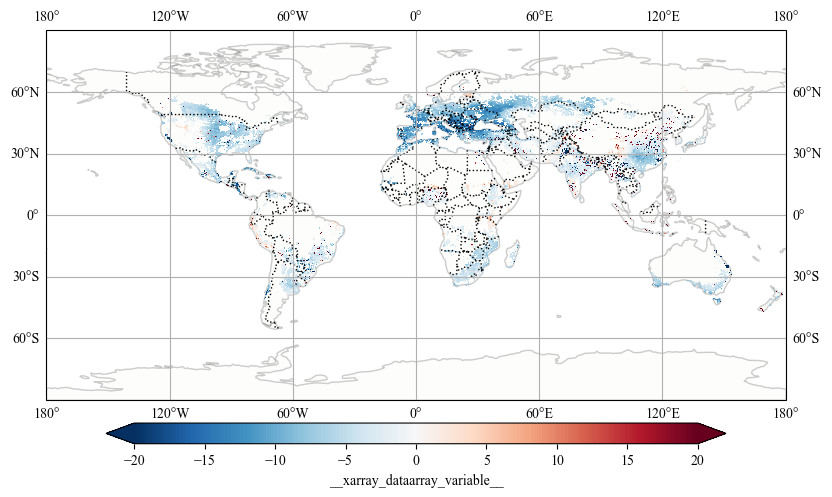

In [85]:
aa=yield_data
bb=((aa[-30:].mean(dim='time')-ori)/ori*100)
print(bb.mean())
fig = plt.figure(figsize=(10, 6))
ax = plt.axes(projection=ccrs.PlateCarree())  # 使用 PlateCarree 投影

# 添加底图
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.add_feature(cfeature.COASTLINE,alpha=0.1)
ax.add_feature(cfeature.LAND, edgecolor='black',alpha=0.1)

cbar_kwargs = {
    'orientation': 'horizontal',  # 水平放置色带
    'pad': 0.05,                  # 色带与图像之间的距离
    'shrink': 0.8,                # 色带的长度
    'aspect': 30,                 # 色带的宽度
    # 'label': f'{crop} SSP585 Yield Change (%)',        # 色带标签
}

bb.plot(ax=ax, transform=ccrs.PlateCarree(), cmap='RdBu_r',  vmin=-20, vmax=20,cbar_kwargs=cbar_kwargs)
# 添加网格线
ax.gridlines(draw_labels=True)
plt.show()

In [171]:
import xarray as xr
import numpy as np
from scipy import stats
from tqdm.notebook import tqdm
from os.path import join

var=['tas','pr']
ss=['ssp126', 'ssp370', 'ssp585']
vv=['tas','crop_Precipitation_nonIrr_annualtot']

for crop in crops:
    # 准备保存所有情景的数据
    tas_all = []
    pr_all = []
    yield_all = []
    ori=xr.open_dataset(rf'F:\paper3_fig_v2\yield\yield\gswp3_w5e5\{crop}_relitive_yield.nc').__xarray_dataarray_variable__
    ori=ori.where(ori>0).mean(dim=['lat', 'lon']).values
    # 遍历每个情景
    for ssp in ss:
        # 加载数据
        extreme_tasmax = xr.open_dataset(join(rf'F:\paper3_fig_v2\climate\tas\a_median', F'median_{crop}_{ssp}_tas.nc')).tas[-80:,:,:]
        extreme_tasmax = extreme_tasmax.where(extreme_tasmax > 0)
        
        extreme_pr = xr.open_dataset(join(rf'F:\paper3_fig_v2\climate\pr\a_median', F'median_{crop}_{ssp}_{extr}.nc')).crop_Precipitation_nonIrr_annualtot[-80:,:,:]
        extreme_pr = extreme_pr.where(extreme_pr > 0)
        
        yield_data = xr.open_dataset(join(r'F:\paper3_fig_v2\yield\yield\a_median', F'median_{crop}_{ssp}_relitive_yield.nc'), decode_times=False).__xarray_dataarray_variable__[:,120:240,:]
        yield_data = yield_data.where(yield_data > 0)
        
        # 计算空间平均值
        extreme_tasmax_avg = extreme_tasmax.mean(dim=['lat', 'lon']).values
        extreme_pr_avg = extreme_pr.mean(dim=['lat', 'lon']).values
        yr_time_avg = yield_data.mean(dim=['lat', 'lon']).values
        yr_time_avg=((yr_time_avg-ori)/ori*100)
        # 保存每个情景的温度、降水和产量
        tas_all.append(extreme_tasmax_avg)
        pr_all.append(extreme_pr_avg)
        yield_all.append(yr_time_avg)

    # 将所有情景的数据合并
    tas_all = np.concatenate(tas_all)
    pr_all = np.concatenate(pr_all)
    yield_all = np.concatenate(yield_all)
    
    # 构建多元线性回归模型：Y = b0 + b1 * Temperature + b2 * Precipitation
    X = np.vstack([tas_all, pr_all]).T  # 自变量矩阵，包含温度和降水
    Y = yield_all  # 因变量为产量
    
    # 使用numpy进行多元线性回归
    X = np.column_stack((np.ones(X.shape[0]), X))  # 增加常数项 b0
    coeffs, residuals, rank, s = np.linalg.lstsq(X, Y, rcond=None)  # 求解回归系数
    
    # 提取回归系数
    b0, b1_tas, b2_pr = coeffs
    print(f"{crop} 回归结果:")
    print(f"  常数项 (b0): {b0}")
    print(f"  温度影响 (b1): {b1_tas:.6f}")
    print(f"  降水影响 (b2): {b2_pr:.6f}")
    
    # 计算每个回归系数的标准误差
    y_pred = X @ coeffs
    residual_std_error = np.sqrt(np.sum((Y - y_pred)**2) / (len(Y) - 2))
    x_tas_mean = np.mean(X[:, 1])
    x_pr_mean = np.mean(X[:, 2])
    
    # 温度斜率的标准误差
    slope_tas_std_error = residual_std_error / np.sqrt(np.sum((X[:, 1] - x_tas_mean)**2))
    
    # 降水斜率的标准误差
    slope_pr_std_error = residual_std_error / np.sqrt(np.sum((X[:, 2] - x_pr_mean)**2))
    
    print(f"  温度影响标准误差: {slope_tas_std_error:.6f}")
    print(f"  降水影响标准误差: {slope_pr_std_error:.6f}")
    
    # 输出结果：温度或降水上升 1 单位时粮食产量的变化及其误差
    print(f"  温度每升高1°C，粮食产量变化: {b1_tas:.6f} ± {slope_tas_std_error:.6f}")
    print(f"  降水每增加1单位，粮食产量变化: {b2_pr:.6f} ± {slope_pr_std_error:.6f}")


maiz 回归结果:
  常数项 (b0): 2.65636130341508
  温度影响 (b1): -0.345226
  降水影响 (b2): 0.012960
  温度影响标准误差: 0.012461
  降水影响标准误差: 0.001942
  温度每升高1°C，粮食产量变化: -0.345226 ± 0.012461
  降水每增加1单位，粮食产量变化: 0.012960 ± 0.001942
soyb 回归结果:
  常数项 (b0): 4.772136101607739
  温度影响 (b1): -0.232612
  降水影响 (b2): 0.003836
  温度影响标准误差: 0.006524
  降水影响标准误差: 0.001147
  温度每升高1°C，粮食产量变化: -0.232612 ± 0.006524
  降水每增加1单位，粮食产量变化: 0.003836 ± 0.001147
rice 回归结果:
  常数项 (b0): 11.093793301746064
  温度影响 (b1): -0.639910
  降水影响 (b2): 0.006274
  温度影响标准误差: 0.014760
  降水影响标准误差: 0.001406
  温度每升高1°C，粮食产量变化: -0.639910 ± 0.014760
  降水每增加1单位，粮食产量变化: 0.006274 ± 0.001406
wheat 回归结果:
  常数项 (b0): 0.17189135372552125
  温度影响 (b1): -0.086000
  降水影响 (b2): 0.001449
  温度影响标准误差: 0.005817
  降水影响标准误差: 0.000853
  温度每升高1°C，粮食产量变化: -0.086000 ± 0.005817
  降水每增加1单位，粮食产量变化: 0.001449 ± 0.000853


In [19]:
import xarray as xr
import numpy as np
from os.path import join

# var = ['tas', 'pr']
# ss = ['ssp126', 'ssp370', 'ssp585']
# vv = ['tas', 'crop_Precipitation_nonIrr_annualtot']
# crops = ['crop1', 'crop2']  # 你需要根据实际作物名称修改
ssp='ssp585'
for crop in crops:
    # 准备保存所有情景的数据
    tas_all = []
    pr_all = []
    yield_all = []
    
    # 载入原始数据，计算基准期产量的平均值
    ori = xr.open_dataset(rf'F:\paper3_fig_v2\yield\yield\gswp3_w5e5\{crop}_relitive_yield.nc').__xarray_dataarray_variable__
    ori = ori.where(ori > 0).mean(dim=['lat', 'lon']).values
    
    # 遍历每个情景
    for ssp in ss:
        # 加载温度数据
        extreme_tasmax = xr.open_dataset(join(rf'F:\paper3_fig_v2\climate\tas\a_median', F'median_{crop}_{ssp}_tas.nc')).tas[-80:, :, :]
        extreme_tasmax = extreme_tasmax.where(extreme_tasmax > 0)
        
        # 加载降水数据
        extreme_pr = xr.open_dataset(join(rf'F:\paper3_fig_v2\climate\pr\a_median', F'median_{crop}_{ssp}_pr.nc')).crop_Precipitation_nonIrr_annualtot[-80:, :, :]
        extreme_pr = extreme_pr.where(extreme_pr > 0)
        
        # 加载产量数据
        yield_data = xr.open_dataset(join(r'F:\paper3_fig_v2\yield\yield\a_median', F'median_{crop}_{ssp}_relitive_yield.nc'), decode_times=False).__xarray_dataarray_variable__[:, :, :]
        yield_data = yield_data.where(yield_data > 0)
        
        # 计算空间平均值
        extreme_tasmax_avg = extreme_tasmax.mean(dim=['lat', 'lon']).values
        extreme_pr_avg = extreme_pr.mean(dim=['lat', 'lon']).values
        yr_time_avg = yield_data.mean(dim=['lat', 'lon']).values
        
        # 计算产量相对变化（百分比）
        yr_time_avg = ((yr_time_avg - ori) / ori * 100)
        
        # 保存每个情景的温度、降水和产量数据，分成三个时间段
        tas_all.append([extreme_tasmax_avg[-30:].mean(), extreme_tasmax_avg[-60:-30].mean(), extreme_tasmax_avg[:-60].mean()])
        pr_all.append([extreme_pr_avg[-30:].mean(), extreme_pr_avg[-60:-30].mean(), extreme_pr_avg[:-60].mean()])
        yield_all.append([yr_time_avg[-30:].mean(), yr_time_avg[-60:-30].mean(), yr_time_avg[:-60].mean()])
    
    # 将数据展平为一维数组
    tas_all = np.concatenate(tas_all)
    pr_all = np.concatenate(pr_all)
    yield_all = np.concatenate(yield_all)
    
    # 构建多元线性回归模型：Y = b0 + b1 * Temperature + b2 * Precipitation
    X = np.vstack([tas_all, pr_all]).T  # 自变量矩阵，包含温度和降水
    Y = yield_all  # 因变量为产量
    
    # 增加常数项 b0
    X = np.column_stack((np.ones(X.shape[0]), X))
    
    # 使用 numpy 进行多元线性回归
    coeffs, residuals, rank, s = np.linalg.lstsq(X, Y, rcond=None)
    
    # 提取回归系数
    b0, b1_tas, b2_pr = coeffs
    
    # 输出回归结果
    print(f"{crop} 回归结果:")
    # print(f"  常数项 (b0): {b0:.6f}")
    # print(f"  温度影响 (b1): {b1_tas:.6f}")
    # print(f"  降水影响 (b2): {b2_pr:.6f}")
    
    # 计算每个回归系数的标准误差
    y_pred = X @ coeffs
    residual_std_error = np.sqrt(np.sum((Y - y_pred)**2) / (len(Y) - 2))
    x_tas_mean = np.mean(X[:, 1])
    x_pr_mean = np.mean(X[:, 2])
    
    # 温度斜率的标准误差
    slope_tas_std_error = residual_std_error / np.sqrt(np.sum((X[:, 1] - x_tas_mean)**2))
    
    # 降水斜率的标准误差
    slope_pr_std_error = residual_std_error / np.sqrt(np.sum((X[:, 2] - x_pr_mean)**2))
    
    # 输出标准误差
    # print(f"  温度影响标准误差: {slope_tas_std_error:.6f}")
    # print(f"  降水影响标准误差: {slope_pr_std_error:.6f}")
    
    # 输出结果：温度或降水上升 1 单位时粮食产量的变化及其误差
    print(f"  温度每升高1°C，粮食产量变化: {b1_tas:.6f} ± {slope_tas_std_error:.6f}")
    print(f"  降水每增加1单位，粮食产量变化: {b2_pr:.6f} ± {slope_pr_std_error:.6f}")
    print()


maiz 回归结果:
  温度每升高1°C，粮食产量变化: -0.190400 ± 0.019959
  降水每增加1单位，粮食产量变化: -0.028856 ± 0.004554

soyb 回归结果:
  温度每升高1°C，粮食产量变化: -0.204236 ± 0.007022
  降水每增加1单位，粮食产量变化: -0.008943 ± 0.001945

rice 回归结果:
  温度每升高1°C，粮食产量变化: -0.494491 ± 0.008878
  降水每增加1单位，粮食产量变化: -0.015701 ± 0.001180

wheat 回归结果:
  温度每升高1°C，粮食产量变化: -0.002626 ± 0.010525
  降水每增加1单位，粮食产量变化: -0.016374 ± 0.001989



In [35]:
import xarray as xr
import numpy as np
from os.path import join

# var = ['tas', 'pr']
# ss = ['ssp126', 'ssp370', 'ssp585']
# vv = ['tas', 'crop_Precipitation_nonIrr_annualtot']
# crops = ['crop1', 'crop2']  # 你需要根据实际作物名称修改
ssp='ssp585'
for crop in crops:
    # 准备保存所有情景的数据
    
    
    # 载入原始数据，计算基准期产量的平均值
    ori = xr.open_dataset(rf'F:\paper3_fig_v2\yield\yield\gswp3_w5e5\{crop}_relitive_yield.nc').__xarray_dataarray_variable__
    ori = ori.where(ori > 0).mean(dim=['lat', 'lon']).values
    
    # 遍历每个情景
    for ssp in ss:
        tas_all = []
        pr_all = []
        yield_all = []
        # 加载温度数据
        extreme_tasmax = xr.open_dataset(join(rf'F:\paper3_fig_v2\climate\tas\a_median', F'median_{crop}_{ssp}_tas.nc')).tas[-80:, :, :]
        extreme_tasmax = extreme_tasmax.where(extreme_tasmax > 0)
        
        # 加载降水数据
        extreme_pr = xr.open_dataset(join(rf'F:\paper3_fig_v2\climate\pr\a_median', F'median_{crop}_{ssp}_pr.nc')).crop_Precipitation_nonIrr_annualtot[-80:, :, :]
        extreme_pr = extreme_pr.where(extreme_pr > 0)
        
        # 加载产量数据
        yield_data = xr.open_dataset(join(r'F:\paper3_fig_v2\yield\yield\a_median', F'median_{crop}_{ssp}_relitive_yield.nc'), decode_times=False).__xarray_dataarray_variable__[:, :, :]
        yield_data = yield_data.where(yield_data > 0)
        
        # 计算空间平均值
        extreme_tasmax_avg = extreme_tasmax.mean(dim=['lat', 'lon']).values
        extreme_pr_avg = extreme_pr.mean(dim=['lat', 'lon']).values
        yr_time_avg = yield_data.mean(dim=['lat', 'lon']).values
        
        # 计算产量相对变化（百分比）
        yr_time_avg = ((yr_time_avg - ori) / ori * 100)
        
        # 保存每个情景的温度、降水和产量数据，分成三个时间段
        tas_all.append([extreme_tasmax_avg[-30:].mean(), extreme_tasmax_avg[-60:-30].mean(), extreme_tasmax_avg[:-60].mean()])
        pr_all.append([extreme_pr_avg[-30:].mean(), extreme_pr_avg[-60:-30].mean(), extreme_pr_avg[:-60].mean()])
        yield_all.append([yr_time_avg[-30:].mean(), yr_time_avg[-60:-30].mean(), yr_time_avg[:-60].mean()])
    
        # 将数据展平为一维数组
        tas_all = np.concatenate(tas_all)
        pr_all = np.concatenate(pr_all)
        yield_all = np.concatenate(yield_all)
        
        # 构建多元线性回归模型：Y = b0 + b1 * Temperature + b2 * Precipitation
        X = np.vstack([tas_all, pr_all]).T  # 自变量矩阵，包含温度和降水
        Y = yield_all  # 因变量为产量
        
        # 增加常数项 b0
        X = np.column_stack((np.ones(X.shape[0]), X))
        
        # 使用 numpy 进行多元线性回归
        coeffs, residuals, rank, s = np.linalg.lstsq(X, Y, rcond=None)
        
        # 提取回归系数
        b0, b1_tas, b2_pr = coeffs
        
        # 输出回归结果
        print(f"{crop} {ssp}回归结果:")
        # print(f"  常数项 (b0): {b0:.6f}")
        # print(f"  温度影响 (b1): {b1_tas:.6f}")
        # print(f"  降水影响 (b2): {b2_pr:.6f}")
        
        # 计算每个回归系数的标准误差
        y_pred = X @ coeffs
        residual_std_error = np.sqrt(np.sum((Y - y_pred)**2) / (len(Y) - 2))
        x_tas_mean = np.mean(X[:, 1])
        x_pr_mean = np.mean(X[:, 2])
        
        # 温度斜率的标准误差
        slope_tas_std_error = residual_std_error / np.sqrt(np.sum((X[:, 1] - x_tas_mean)**2))
        
        # 降水斜率的标准误差
        slope_pr_std_error = residual_std_error / np.sqrt(np.sum((X[:, 2] - x_pr_mean)**2))
        
        # 输出标准误差
        # print(f"  温度影响标准误差: {slope_tas_std_error:.6f}")
        # print(f"  降水影响标准误差: {slope_pr_std_error:.6f}")
        
        # 输出结果：温度或降水上升 1 单位时粮食产量的变化及其误差
        print(f"  温度每升高1°C，粮食产量变化: {b1_tas:.6f} ± {slope_tas_std_error:.6f}")
        print(f"  降水每增加1单位，粮食产量变化: {b2_pr:.6f} ± {slope_pr_std_error:.6f}")
        print()


maiz ssp126回归结果:
  温度每升高1°C，粮食产量变化: -1.126176 ± 0.000000
  降水每增加1单位，粮食产量变化: 0.033579 ± 0.000000

maiz ssp370回归结果:
  温度每升高1°C，粮食产量变化: -0.742753 ± 0.000000
  降水每增加1单位，粮食产量变化: 0.015246 ± 0.000000

maiz ssp585回归结果:
  温度每升高1°C，粮食产量变化: -0.796930 ± 0.000000
  降水每增加1单位，粮食产量变化: 0.010941 ± 0.000000

soyb ssp126回归结果:
  温度每升高1°C，粮食产量变化: -0.613758 ± 0.000000
  降水每增加1单位，粮食产量变化: 0.024697 ± 0.000000

soyb ssp370回归结果:
  温度每升高1°C，粮食产量变化: -0.430369 ± 0.000000
  降水每增加1单位，粮食产量变化: 0.021668 ± 0.000000

soyb ssp585回归结果:
  温度每升高1°C，粮食产量变化: -0.256488 ± 0.000000
  降水每增加1单位，粮食产量变化: -0.052258 ± 0.000000

rice ssp126回归结果:
  温度每升高1°C，粮食产量变化: -1.073756 ± 0.000000
  降水每增加1单位，粮食产量变化: 0.004562 ± 0.000000

rice ssp370回归结果:
  温度每升高1°C，粮食产量变化: -0.616599 ± 0.000000
  降水每增加1单位，粮食产量变化: -0.004989 ± 0.000000

rice ssp585回归结果:
  温度每升高1°C，粮食产量变化: -0.997643 ± 0.000000
  降水每增加1单位，粮食产量变化: 0.040956 ± 0.000000

wheat ssp126回归结果:
  温度每升高1°C，粮食产量变化: 0.719448 ± 0.000000
  降水每增加1单位，粮食产量变化: 0.003875 ± 0.000000

wheat ssp370回归结果:
  温度每升高1°C

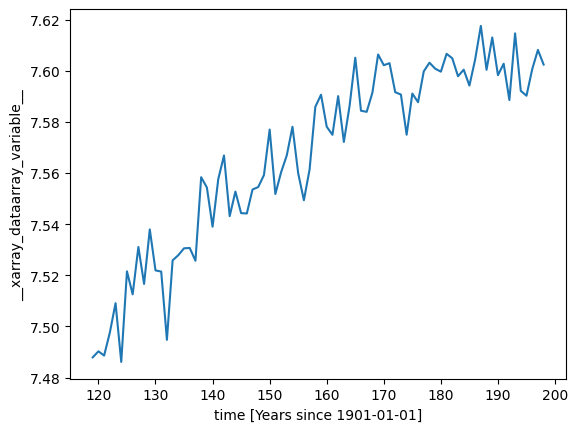

In [40]:
yield_data = xr.open_dataset(join(r'F:\paper3_fig_v2\yield\yield\a_median', F'median_wheat_ssp585_relitive_yield.nc'), decode_times=False).__xarray_dataarray_variable__[:, :, :]
yield_data = yield_data.where(yield_data > 0)
yield_data.mean(dim=['lat','lon']).plot()

In [24]:
import xarray as xr
import numpy as np
from os.path import join

# var = ['tas', 'pr']
# ss = ['ssp126', 'ssp370', 'ssp585']
# vv = ['tas', 'crop_Precipitation_nonIrr_annualtot']
# crops = ['crop1', 'crop2']  # 你需要根据实际作物名称修改
crops = ['maiz', 'soyb', 'rice', 'wheat']
ss = ['ssp126', 'ssp370', 'ssp585']
fp =  r'F:\CWatM\cwatm_output\global_future'
for crop in crops:
    # 准备保存所有情景的数据
    tas_all = []
    pr_all = []
    yield_all = []
    
    # 载入原始数据，计算基准期产量的平均值
    ori = xr.open_dataset(rf'F:\paper3_fig_v2\yield\yield\gswp3_w5e5\{crop}_yield.nc').__xarray_dataarray_variable__
    ori = ori.where(ori > 0).mean(dim=['lat', 'lon']).values
    
    # 遍历每个情景
    for ssp in ss:
        # 加载温度数据
        extreme_tasmax = xr.open_dataset(join(rf'F:\paper3_fig_v2\climate\tas\a_median', F'median_{crop}_{ssp}_tas.nc')).tas[-80:, 120:180, :]
        extreme_tasmax = extreme_tasmax.where(extreme_tasmax > 0)
        
        # 加载降水数据
        extreme_pr = xr.open_dataset(join(rf'F:\paper3_fig_v2\climate\pr\a_median', F'median_{crop}_{ssp}_pr.nc')).crop_Precipitation_nonIrr_annualtot[-80:, 120:180, :]
        extreme_pr = extreme_pr.where(extreme_pr > 0)
        
        # 加载产量数据
        yield_data = xr.open_dataset(join(r'F:\paper3_fig_v2\yield\yield\a_median', F'median_{crop}_{ssp}_yield.nc'), decode_times=False).__xarray_dataarray_variable__[:, 120:180, :]
        yield_data = yield_data.where(yield_data > 0)
        
        # 计算空间平均值
        extreme_tasmax_avg = extreme_tasmax.mean(dim=['lat', 'lon']).values
        extreme_pr_avg = extreme_pr.mean(dim=['lat', 'lon']).values
        yr_time_avg = yield_data.mean(dim=['lat', 'lon']).values
        
        # 计算产量相对变化（百分比）
        yr_time_avg = ((yr_time_avg - ori) / ori * 100)
        
        # 保存每个情景的温度、降水和产量数据，分成三个时间段
        tas_all.append([extreme_tasmax_avg[-30:].mean(), extreme_tasmax_avg[-60:-30].mean(), extreme_tasmax_avg[:-60].mean()])
        pr_all.append([extreme_pr_avg[-30:].mean(), extreme_pr_avg[-60:-30].mean(), extreme_pr_avg[:-60].mean()])
        yield_all.append([yr_time_avg[-30:].mean(), yr_time_avg[-60:-30].mean(), yr_time_avg[:-60].mean()])
    
    # 将数据展平为一维数组
    tas_all = np.concatenate(tas_all)
    pr_all = np.concatenate(pr_all)
    yield_all = np.concatenate(yield_all)
    
    # 构建多元线性回归模型：Y = b0 + b1 * Temperature + b2 * Precipitation
    X = np.vstack([tas_all, pr_all]).T  # 自变量矩阵，包含温度和降水
    Y = yield_all  # 因变量为产量
    
    # 增加常数项 b0
    X = np.column_stack((np.ones(X.shape[0]), X))
    
    # 使用 numpy 进行多元线性回归
    coeffs, residuals, rank, s = np.linalg.lstsq(X, Y, rcond=None)
    
    # 提取回归系数
    b0, b1_tas, b2_pr = coeffs
    
    # 输出回归结果
    print(f"{crop} 回归结果:")
    # print(f"  常数项 (b0): {b0:.6f}")
    # print(f"  温度影响 (b1): {b1_tas:.6f}")
    # print(f"  降水影响 (b2): {b2_pr:.6f}")
    
    # 计算每个回归系数的标准误差
    y_pred = X @ coeffs
    residual_std_error = np.sqrt(np.sum((Y - y_pred)**2) / (len(Y) - 2))
    x_tas_mean = np.mean(X[:, 1])
    x_pr_mean = np.mean(X[:, 2])
    
    # 温度斜率的标准误差
    slope_tas_std_error = residual_std_error / np.sqrt(np.sum((X[:, 1] - x_tas_mean)**2))
    
    # 降水斜率的标准误差
    slope_pr_std_error = residual_std_error / np.sqrt(np.sum((X[:, 2] - x_pr_mean)**2))
    
    # 输出标准误差
    # print(f"  温度影响标准误差: {slope_tas_std_error:.6f}")
    # print(f"  降水影响标准误差: {slope_pr_std_error:.6f}")
    
    # 输出结果：温度或降水上升 1 单位时粮食产量的变化及其误差
    print(f"  温度每升高1°C，粮食产量变化: {b1_tas:.6f} ± {slope_tas_std_error:.6f}")
    print(f"  降水每增加1单位，粮食产量变化: {b2_pr:.6f} ± {slope_pr_std_error:.6f}")
    print()


maiz 回归结果:
  温度每升高1°C，粮食产量变化: -0.694412 ± 0.311461
  降水每增加1单位，粮食产量变化: -0.017873 ± 0.015135

soyb 回归结果:
  温度每升高1°C，粮食产量变化: -2.172119 ± 0.327154
  降水每增加1单位，粮食产量变化: 0.016330 ± 0.027376

rice 回归结果:
  温度每升高1°C，粮食产量变化: -1.879439 ± 0.220201
  降水每增加1单位，粮食产量变化: -0.059847 ± 0.014336

wheat 回归结果:
  温度每升高1°C，粮食产量变化: -2.840939 ± 0.398910
  降水每增加1单位，粮食产量变化: 0.008565 ± 0.036291



-0.1725787646137178



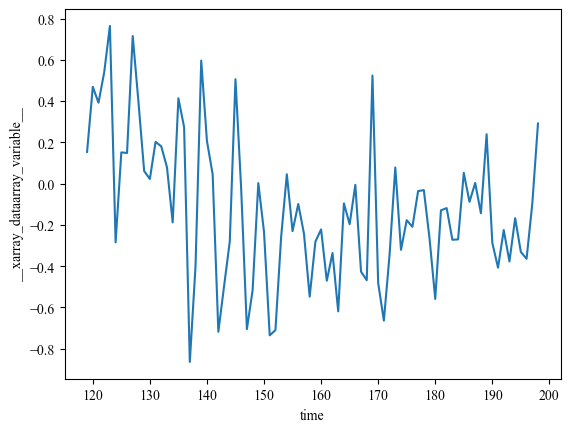

In [134]:
i=1;extr='pr';crop='maiz';ssp='ssp126'
ori=xr.open_dataset(rf'F:\paper3_fig_v2\yield\yield\gswp3_w5e5\{crop}_relitive_yield.nc').__xarray_dataarray_variable__
ori=ori.where(ori>0)
extreme_pr = xr.open_dataset(join(rf'F:\paper3_fig_v2\climate\pr\a_median', F'median_{crop}_{ssp}_pr.nc'))['crop_Precipitation_nonIrr_annualtot'][-80:,:,:]
extreme_tasmax = xr.open_dataset(join(rf'F:\paper3_fig_v2\climate\tas\a_median', F'median_{crop}_{ssp}_tas.nc'))['tas'][-80:,:,:]
yield_data = xr.open_dataset(join(r'F:\paper3_fig_v2\yield\yield\a_median', F'median_{crop}_{ssp}_relitive_yield.nc'), decode_times=False).__xarray_dataarray_variable__
yield_data=yield_data.where(yield_data>0)
aa=yield_data.mean(dim=['lat','lon'])
print(((aa[-30:].mean()-ori.mean())/ori.mean()*100).values)
print()
# aa.plot()
((aa-ori.mean())/ori.mean()*100).plot()

<xarray.DataArray 'crop_Precipitation_nonIrr_annualtot' ()> Size: 4B
array(2.022789, dtype=float32)


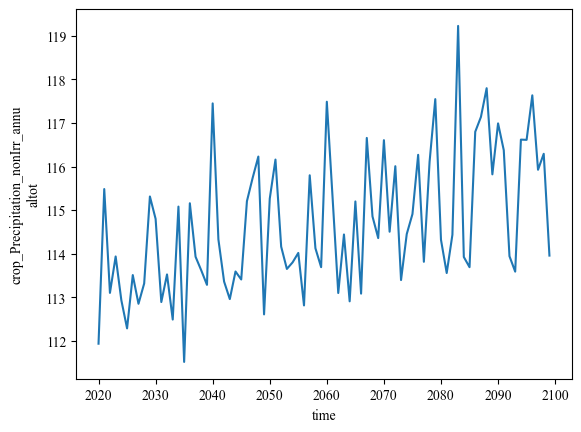

In [112]:
aa=extreme_tasmax.mean(dim=['lat','lon'])
print(aa[-1]-aa[0])
aa.plot()

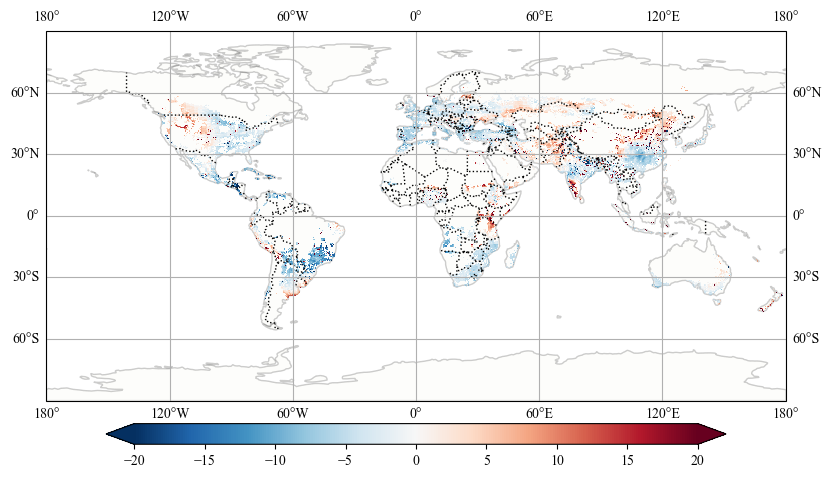

In [198]:
bb=((aa[-30:].mean(dim='time')-ori)/ori*100)
fig = plt.figure(figsize=(10, 6))
ax = plt.axes(projection=ccrs.PlateCarree())  # 使用 PlateCarree 投影

# 添加底图
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.add_feature(cfeature.COASTLINE,alpha=0.1)
ax.add_feature(cfeature.LAND, edgecolor='black',alpha=0.1)

cbar_kwargs = {
    'orientation': 'horizontal',  # 水平放置色带
    'pad': 0.05,                  # 色带与图像之间的距离
    'shrink': 0.8,                # 色带的长度
    'aspect': 30,                 # 色带的宽度
    # 'label': f'{crop} SSP585 Yield Change (%)',        # 色带标签
}

bb.plot(ax=ax, transform=ccrs.PlateCarree(), cmap='RdBu_r',  vmin=-20, vmax=20,cbar_kwargs=cbar_kwargs)
# 添加网格线
ax.gridlines(draw_labels=True)
plt.show()

In [200]:
bb.mean()

<xarray.DataArray ()> Size: 4B
array(-0.61938184, dtype=float32)

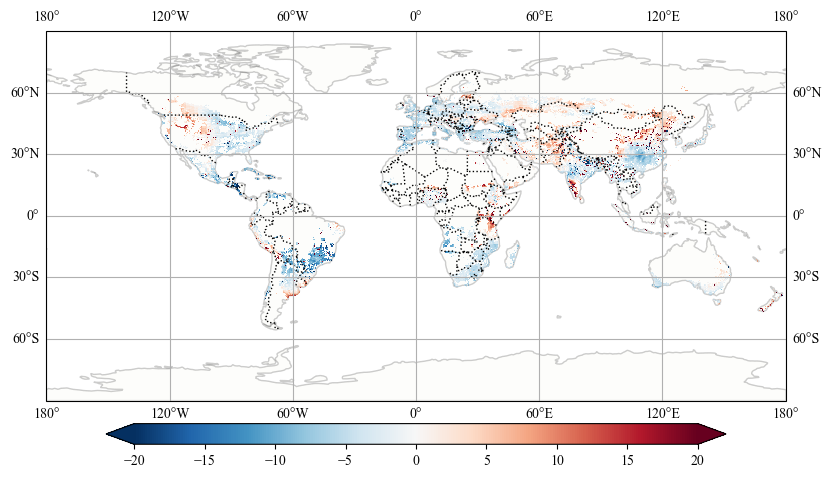

In [233]:
fp=r'F:\paper3_fig_v2\extreme\pr_change'
aa_irr=xr.open_dataset(join(fp,'Yield_Irr_annualtot_maiz_nor.nc'),decode_times=False).Yield_Irr_annualtot+xr.open_dataset(join(fp,'Yield_Irr_annualtot_maiz_sou_1.nc'),decode_times=False).Yield_Irr_annualtot+\
                                                                                                  xr.open_dataset(join(fp,'Yield_Irr_annualtot_maiz_sou_2.nc'),decode_times=False).Yield_Irr_annualtot
aa_rf=xr.open_dataset(join(fp,'Yield_nonIrr_annualtot_maiz_nor.nc'),decode_times=False).Yield_nonIrr_annualtot+xr.open_dataset(join(fp,'Yield_nonIrr_annualtot_maiz_sou_1.nc'),decode_times=False).Yield_nonIrr_annualtot+\
                                                                                                  xr.open_dataset(join(fp,'Yield_nonIrr_annualtot_maiz_sou_2.nc'),decode_times=False).Yield_nonIrr_annualtot 
aa=aa_irr+aa_rf
ori= xr.open_dataset(r'F:\paper3_fig_v2\yield\yield\gswp3_w5e5\maiz_relitive_yield.nc').__xarray_dataarray_variable__
aa=aa.where(aa>0)
ori=ori.where(ori>0)
bb=((aa[-30:].mean(dim='time')-ori)/ori*100)
fig = plt.figure(figsize=(10, 6))
ax = plt.axes(projection=ccrs.PlateCarree())  # 使用 PlateCarree 投影

# 添加底图
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.add_feature(cfeature.COASTLINE,alpha=0.1)
ax.add_feature(cfeature.LAND, edgecolor='black',alpha=0.1)

cbar_kwargs = {
    'orientation': 'horizontal',  # 水平放置色带
    'pad': 0.05,                  # 色带与图像之间的距离
    'shrink': 0.8,                # 色带的长度
    'aspect': 30,                 # 色带的宽度
    # 'label': f'{crop} SSP585 Yield Change (%)',        # 色带标签
}

bb.plot(ax=ax, transform=ccrs.PlateCarree(), cmap='RdBu_r',  vmin=-20, vmax=20,cbar_kwargs=cbar_kwargs)
# 添加网格线
ax.gridlines(draw_labels=True)
plt.show()

126 539.6363
585 590.7828
差值
126 32.126465
585 65.93268


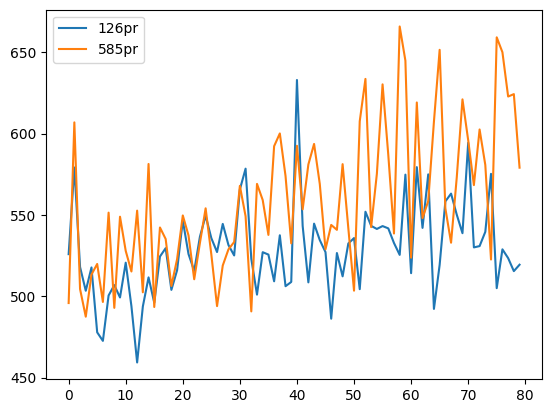

In [10]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.patches as mpatches
import matplotlib.gridspec as gridspec
import xarray as xr
from os.path import join
pr126=xr.open_dataset(r'F:\paper3_fig_v2\climate\pr\CanESM5\maiz_SSP126_pr.nc').crop_Precipitation_nonIrr_annualtot
pr585=xr.open_dataset(r'F:\paper3_fig_v2\climate\pr\CanESM5\maiz_SSP585_pr.nc').crop_Precipitation_nonIrr_annualtot
pr126=pr126.where(pr126>0)
pr585=pr585.where(pr585>0)
plt.plot(pr126.mean(dim=['lat','lon']),label='126pr')
plt.plot(pr585.mean(dim=['lat','lon']),label='585pr')

print('126',pr126[-30:].mean().values)
print('585',pr585[-30:].mean().values)
print('差值')
print('126',(pr126[-30:].mean()-pr126[:20].mean()).values)
print('585',(pr585[-30:].mean()-pr585[:20].mean()).values)
plt.legend()

126 23.728882
585 28.354214
差值
126 0.94766045
585 5.3758087


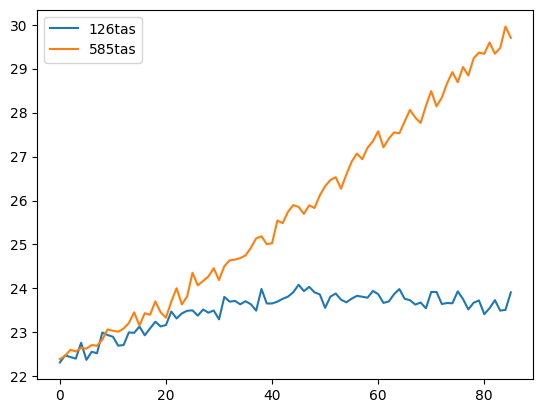

In [11]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.patches as mpatches
import matplotlib.gridspec as gridspec
import xarray as xr
from os.path import join
tas126=xr.open_dataset(r'F:\paper3_fig_v2\climate\tas\CanESM5_SSP126_maiz_tas.nc').tas
tas585=xr.open_dataset(r'F:\paper3_fig_v2\climate\tas\CanESM5_SSP585_maiz_tas.nc').tas
tas126=tas126.where(tas126>0)
tas585=tas585.where(tas585>0)
plt.plot(tas126.mean(dim=['lat','lon']),label='126tas')
plt.plot(tas585.mean(dim=['lat','lon']),label='585tas')

print('126',tas126[-30:].mean().values)
print('585',tas585[-30:].mean().values)
print('差值')
print('126',(tas126[-30:].mean()-tas126[:20].mean()).values)
print('585',(tas585[-30:].mean()-tas585[:20].mean()).values)
plt.legend()

In [31]:
fp=r'F:\paper3_fig_v2\extreme\pr_change'
aa_irr=xr.open_dataset(join(fp,'Yield_Irr_annualtot_maiz_nor.nc'),decode_times=False).Yield_Irr_annualtot+xr.open_dataset(join(fp,'Yield_Irr_annualtot_maiz_sou_1.nc'),decode_times=False).Yield_Irr_annualtot+\
                                                                                                  xr.open_dataset(join(fp,'Yield_Irr_annualtot_maiz_sou_2.nc'),decode_times=False).Yield_Irr_annualtot
aa_rf=xr.open_dataset(join(fp,'Yield_nonIrr_annualtot_maiz_nor.nc'),decode_times=False).Yield_nonIrr_annualtot+xr.open_dataset(join(fp,'Yield_nonIrr_annualtot_maiz_sou_1.nc'),decode_times=False).Yield_nonIrr_annualtot+\
                                                                                                  xr.open_dataset(join(fp,'Yield_nonIrr_annualtot_maiz_sou_2.nc'),decode_times=False).Yield_nonIrr_annualtot 
aa=aa_irr*xr.open_dataset(join(r'F:\global_cropmap\potential_yield\nc\maiz_30min','GFDL-ESM2M_rcp85_71100_maiz200a_yld.nc')).data+aa_rf*xr.open_dataset(join(r'F:\global_cropmap\potential_yield\nc\maiz_30min','GFDL-ESM2M_rcp85_71100_maiz200b_yld.nc')).data
ori= xr.open_dataset(r'F:\paper3_fig_v2\yield\yield\gswp3_w5e5\maiz_yield.nc').__xarray_dataarray_variable__
aa=aa.where(aa>0)
ori=ori.where(ori>0)
bb=((aa[-30:].mean(dim='time')-ori)/ori*100)
print(bb.mean().values)

19.461064556200576


In [32]:
fp=r'F:\CWatM\cwatm_output\global_future\CanESM5\SSP585'
cc_irr=xr.open_dataset(join(fp,'Yield_Irr_annualtot_maiz_nor.nc'),decode_times=False).Yield_Irr_annualtot+xr.open_dataset(join(fp,'Yield_Irr_annualtot_maiz_sou_1.nc'),decode_times=False).Yield_Irr_annualtot+\
                                                                                                  xr.open_dataset(join(fp,'Yield_Irr_annualtot_maiz_sou_2.nc'),decode_times=False).Yield_Irr_annualtot
cc_rf=xr.open_dataset(join(fp,'Yield_nonIrr_annualtot_maiz_nor.nc'),decode_times=False).Yield_nonIrr_annualtot+xr.open_dataset(join(fp,'Yield_nonIrr_annualtot_maiz_sou_1.nc'),decode_times=False).Yield_nonIrr_annualtot+\
                                                                                                  xr.open_dataset(join(fp,'Yield_nonIrr_annualtot_maiz_sou_2.nc'),decode_times=False).Yield_nonIrr_annualtot 
cc=cc_irr*xr.open_dataset(join(r'F:\global_cropmap\potential_yield\nc\maiz_30min','GFDL-ESM2M_rcp85_71100_maiz200a_yld.nc')).data+cc_rf*xr.open_dataset(join(r'F:\global_cropmap\potential_yield\nc\maiz_30min','GFDL-ESM2M_rcp85_71100_maiz200b_yld.nc')).data
ori= xr.open_dataset(r'F:\paper3_fig_v2\yield\yield\gswp3_w5e5\maiz_yield.nc').__xarray_dataarray_variable__
cc=cc.where(cc>0)
ori=ori.where(ori>0)
bb=((cc[-30:].mean(dim='time')-ori)/ori*100)
print(bb.mean().values)

17.387192938817766


-0.61938184


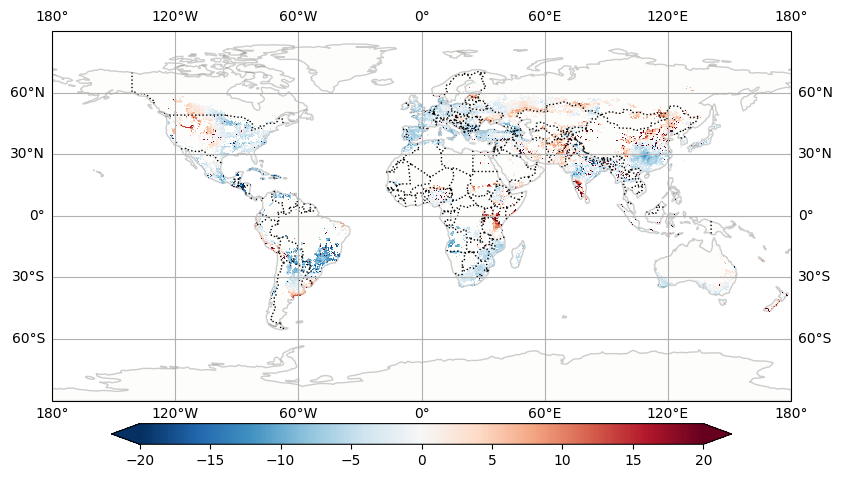

In [29]:
import os
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from os.path import join
import matplotlib as mpl
import cartopy.crs as ccrs
import cartopy.feature as cfeature
fp=r'F:\paper3_fig_v2\extreme\pr_change'
aa_irr=xr.open_dataset(join(fp,'Yield_Irr_annualtot_maiz_nor.nc'),decode_times=False).Yield_Irr_annualtot+xr.open_dataset(join(fp,'Yield_Irr_annualtot_maiz_sou_1.nc'),decode_times=False).Yield_Irr_annualtot+\
                                                                                                  xr.open_dataset(join(fp,'Yield_Irr_annualtot_maiz_sou_2.nc'),decode_times=False).Yield_Irr_annualtot
aa_rf=xr.open_dataset(join(fp,'Yield_nonIrr_annualtot_maiz_nor.nc'),decode_times=False).Yield_nonIrr_annualtot+xr.open_dataset(join(fp,'Yield_nonIrr_annualtot_maiz_sou_1.nc'),decode_times=False).Yield_nonIrr_annualtot+\
                                                                                                  xr.open_dataset(join(fp,'Yield_nonIrr_annualtot_maiz_sou_2.nc'),decode_times=False).Yield_nonIrr_annualtot 
aa=aa_irr+aa_rf
ori= xr.open_dataset(r'F:\paper3_fig_v2\yield\yield\gswp3_w5e5\maiz_relitive_yield.nc').__xarray_dataarray_variable__
aa=aa.where(aa>0)
ori=ori.where(ori>0)
bb=((aa[-30:].mean(dim='time')-ori)/ori*100)
print(bb.mean().values)
fig = plt.figure(figsize=(10, 6))
ax = plt.axes(projection=ccrs.PlateCarree())  # 使用 PlateCarree 投影

# 添加底图
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.add_feature(cfeature.COASTLINE,alpha=0.1)
ax.add_feature(cfeature.LAND, edgecolor='black',alpha=0.1)

cbar_kwargs = {
    'orientation': 'horizontal',  # 水平放置色带
    'pad': 0.05,                  # 色带与图像之间的距离
    'shrink': 0.8,                # 色带的长度
    'aspect': 30,                 # 色带的宽度
    # 'label': f'{crop} SSP585 Yield Change (%)',        # 色带标签
}

bb.plot(ax=ax, transform=ccrs.PlateCarree(), cmap='RdBu_r',  vmin=-20, vmax=20,cbar_kwargs=cbar_kwargs)
# 添加网格线
ax.gridlines(draw_labels=True)
plt.show()

-2.1593103


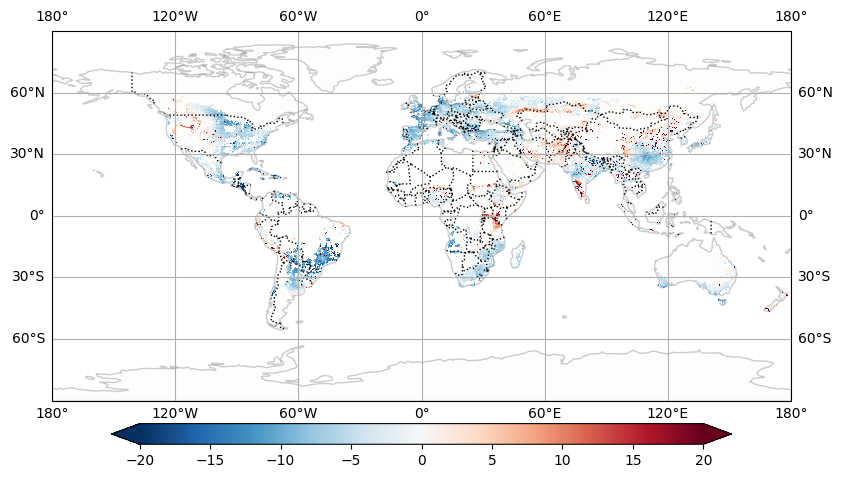

In [28]:
fp=r'F:\CWatM\cwatm_output\global_future\CanESM5\SSP585'
cc_irr=xr.open_dataset(join(fp,'Yield_Irr_annualtot_maiz_nor.nc'),decode_times=False).Yield_Irr_annualtot+xr.open_dataset(join(fp,'Yield_Irr_annualtot_maiz_sou_1.nc'),decode_times=False).Yield_Irr_annualtot+\
                                                                                                  xr.open_dataset(join(fp,'Yield_Irr_annualtot_maiz_sou_2.nc'),decode_times=False).Yield_Irr_annualtot
cc_rf=xr.open_dataset(join(fp,'Yield_nonIrr_annualtot_maiz_nor.nc'),decode_times=False).Yield_nonIrr_annualtot+xr.open_dataset(join(fp,'Yield_nonIrr_annualtot_maiz_sou_1.nc'),decode_times=False).Yield_nonIrr_annualtot+\
                                                                                                  xr.open_dataset(join(fp,'Yield_nonIrr_annualtot_maiz_sou_2.nc'),decode_times=False).Yield_nonIrr_annualtot 
cc=cc_irr+cc_rf
ori= xr.open_dataset(r'F:\paper3_fig_v2\yield\yield\gswp3_w5e5\maiz_relitive_yield.nc').__xarray_dataarray_variable__
cc=cc.where(cc>0)
ori=ori.where(ori>0)
bb=((cc[-30:].mean(dim='time')-ori)/ori*100)
print(bb.mean().values)
fig = plt.figure(figsize=(10, 6))
ax = plt.axes(projection=ccrs.PlateCarree())  # 使用 PlateCarree 投影

# 添加底图
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.add_feature(cfeature.COASTLINE,alpha=0.1)
ax.add_feature(cfeature.LAND, edgecolor='black',alpha=0.1)

cbar_kwargs = {
    'orientation': 'horizontal',  # 水平放置色带
    'pad': 0.05,                  # 色带与图像之间的距离
    'shrink': 0.8,                # 色带的长度
    'aspect': 30,                 # 色带的宽度
    # 'label': f'{crop} SSP585 Yield Change (%)',        # 色带标签
}

bb.plot(ax=ax, transform=ccrs.PlateCarree(), cmap='RdBu_r',  vmin=-20, vmax=20,cbar_kwargs=cbar_kwargs)
# 添加网格线
ax.gridlines(draw_labels=True)
plt.show()

### Prx

In [31]:
import os
import xarray as xr
import numpy as np
from os.path import join
import pandas as pd

# 设置默认字体为 Times New Roman
import matplotlib as mpl
mpl.rcParams['font.family'] = 'Times New Roman'

# 场景列表
crops = ['maiz', 'soyb', 'rice', 'wheat']
ss = ['ssp126', 'ssp370', 'ssp585']
fp =  r'F:\CWatM\cwatm_output\global_future'

# 初始化一个字典来存储所有作物和情景的数据
crop_data = {}
extr='prx'
# 遍历每个作物
for crop in crops:
    # 初始化用于存储结果的字典
    results = {}

    # 遍历每个情景
    for ssp in ss:
        yr_values = []
        for inst in os.listdir(fp):
            if inst == 'GWSP3_W5E5' or inst == 'MRI-ESM2-0':
                continue
            filepath = join(r'F:\paper3_fig_v2\extreme\future_freq\95\single')
            if crop=='wheat':
                csr = xr.open_dataset(join(filepath, F'{extr}_swh_{ssp}_{inst}.nc'), decode_times=False).data.fillna(0)+ xr.open_dataset(join(filepath, F'{extr}_wwh_{ssp}_{inst}.nc'), decode_times=False).data.fillna(0)
            else:
                csr = xr.open_dataset(join(filepath, F'{extr}_{crop}_{ssp}_{inst}.nc'), decode_times=False).data
            csr=csr.where(csr>0)
            yr = csr.mean(dim=['lat', 'lon'])
            yr_values.append(yr)

        # 存储每个情景的结果
        results[ssp] = np.array(yr_values)
    
    # 存储每个作物的所有情景结果
    crop_data[crop] = results


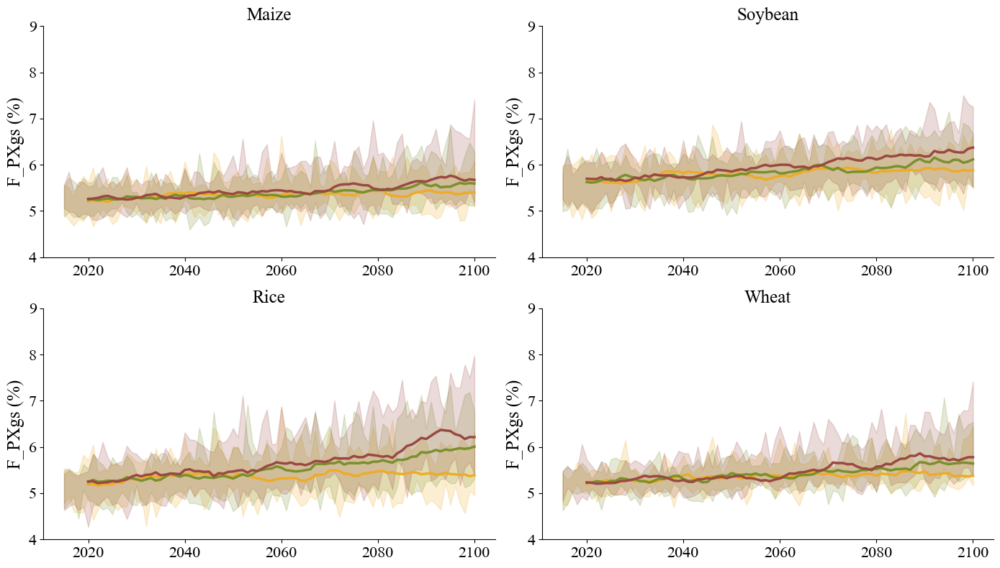

In [32]:
import matplotlib.patches as mpatches  # 导入用于创建色块的模块
import matplotlib.pyplot as plt
# 定义每个情景的颜色
ssp_colors = {
    'ssp126': '#ECAC27',
    'ssp370': '#79902D',
    'ssp585': '#9A4942'
}
years=np.arange(2015,2101)
crop_name = ['Maize', 'Soybean', 'Rice', 'Wheat']
# 用于存储图例色块
legend_patches = [mpatches.Patch(color=ssp_colors[ssp], label=ssp) for ssp in ss]

# 开始绘制图形
fig, axs = plt.subplots(2, 2, figsize=(14, 8))  # 4行1列布局
axs = axs.flatten()  # 将子图轴展平成1D数组，方便遍历

# 遍历字典进行绘图
for idx, (crop, results) in enumerate(crop_data.items()):
    ax = axs[idx]  # 获取当前子图轴
    for ssp in ss:
        yr_transposed = results[ssp].T
        
        # 去除每个年份的最小值和最大值
        yr_filtered = []
        for yr in yr_transposed:
            yr_sorted = np.sort(yr)
            yr_filtered.append(yr_sorted[1:-1])  # 去除最小值和最大值
        
        # 转回原来的形状
        yr_filtered = np.array(yr_filtered).T
        
        # 计算去除极值后的均值和范围
        mean_yr = np.median(yr_filtered, axis=0) 
        min_yr = yr_filtered.min(axis=0)
        max_yr = yr_filtered.max(axis=0)
        window_size = 6  # 可以调整窗口大小以控制平滑度
        bb_smooth = pd.Series(mean_yr).rolling(window=window_size).mean()

        # 绘制曲线，设置对应的颜色
        ax.plot(years, bb_smooth, linewidth=2.5, color=ssp_colors[ssp])
        
        # 绘制均值和范围
        ax.fill_between(years, min_yr, max_yr, color=ssp_colors[ssp], alpha=0.2)
    # ax.axvspan(2035, 2045, color='gray', alpha=0.3)
    # 隐藏右侧和顶部的轴
    ax.set_ylim([4,9])
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.tick_params(axis='both', labelsize=16)
    # 隐藏网格线
    ax.grid(False)
    ax.set_title(crop_name[idx], fontsize=18)
    # 除了最后一张子图，隐藏X轴
    # if idx < len(crops) - 1:
    #     ax.set_xticklabels([])
    # else:
    # ax.set_xlabel('Year', fontsize=18)
        
    # Y轴标签
    ax.set_ylabel('F_PXgs (%)', fontsize=18)

# 调整子图之间的间距
plt.subplots_adjust(hspace=0.3)

# 添加全局图例在最下方，将线条换为色块
# fig.legend(handles=legend_patches, loc='lower center', bbox_to_anchor=(0.5, -0.0), ncol=len(ss), fontsize=18, frameon=False)

plt.tight_layout()
# 保存图像
plt.savefig(r'F:\paper3_fig_v2\extreme\future_freq\95\fig\F_PXgs.png', dpi=300)

# 显示图像
plt.show()


## country scale

In [2]:
import os
import xarray as xr
import pandas as pd
import numpy as np
from os.path import join
from xarray.coding.times import decode_cf_datetime
periods_indices = {
            'Near-term': (0, 20),   # 前20年
            'Mid-term': (20, 50),   # 中间30年
            'Long-term': (50, 80)   # 最后30年
        }
        
# 场景列表
crops = ['maiz', 'soyb', 'rice', 'wheat']
ss = ['ssp126', 'ssp370', 'ssp585']
fp =  r'F:\CWatM\cwatm_output\global_future'
frac_name=['MAIZ','SOYB','RICE','WHEA']
# 初始化结果字典
data_dict = {}
yield_name=['maiz','soyb','ricw','whea']
rcp=[26,60,85]
for i,crop in enumerate(crops):
    ori = xr.open_dataset(join(r'F:\paper3_fig_v2\yield\yield\gswp3_w5e5', F'{crop}_yield.nc'), decode_times=False).__xarray_dataarray_variable__
    ori=ori.where(ori > 0, np.nan)
    # 初始化用于存储结果的字典
    results = {}
    institution_means_list = []
    for j,ssp in enumerate(ss):
        institution_means_list=[]
        for inst in os.listdir(fp):
            if inst == 'GWSP3_W5E5' or inst == 'MRI-ESM2-0':
                continue
        
            csr = xr.open_dataset(join(r'F:\paper3_fig_v2\yield\yield',f'{inst}', F'{crop}_{ssp}_yield.nc'), decode_times=False).__xarray_dataarray_variable__[-30:]
            units = csr.time.attrs['units']
            calendar = csr.time.attrs.get('calendar', 'standard')
            dates = decode_cf_datetime(csr.time.values, units, calendar)
            csr = csr.assign_coords(time=("time", dates))
            csr=csr.interp(lat=ori.lat,lon=ori.lon)
            csr=csr.where(ori>0,0)
            institution_means_list.append((csr.mean(dim='time')-ori)/ori*100)
        
        combined_means = xr.concat(institution_means_list, dim='institution')
        # overall_mean = combined_means.mean(dim='institution', skipna=True)
        
        results[ssp] = combined_means
        
        # 计算差异并存储到字典
    data_dict[crop] = results
    # for ss, mean_data in results.items():
    #     data_dict[crop][ss]={}
    #     for period, (start, end) in periods_indices.items():
    #         # 计算每个时期的平均值与基准期的差值
    #         period_mean = results[ss][start:end,:,:].mean(dim='time')
    #         difference = (period_mean- ori)/ ori * 100
    #         data_dict[crop][ss][period] = difference
# # 找到最大值对应的扁平化索引
# max_flat_index = difference.argmax()
# max_indices = np.unravel_index(max_flat_index, difference.shape)
# print(f"最大值在多维数组中的索引: {max_indices}")
# print(f'最大值：{difference[max_indices[0],max_indices[1]].values}')


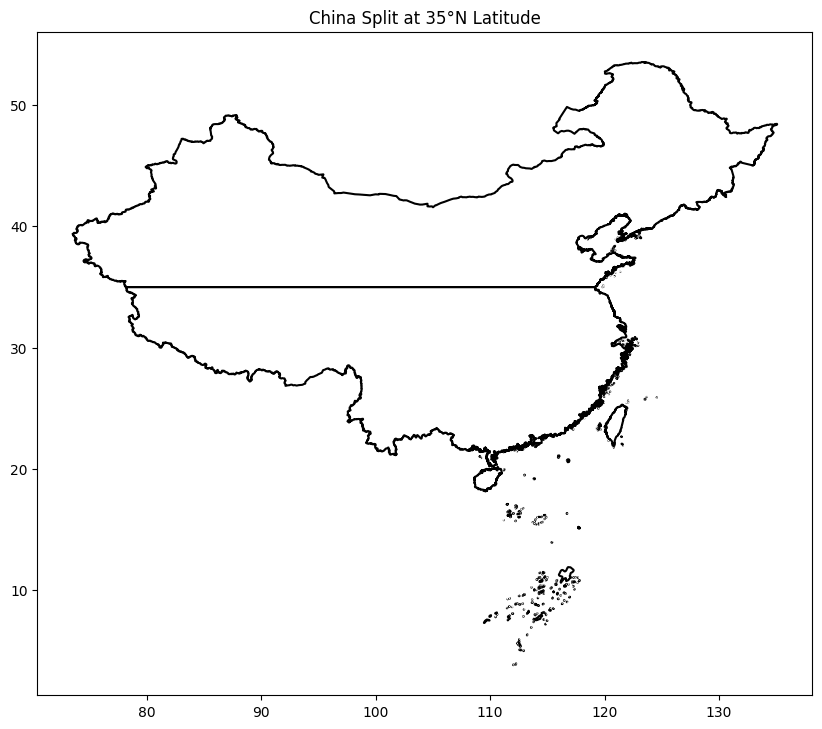

In [3]:
import geopandas as gpd
from shapely.geometry import LineString, box
import matplotlib.pyplot as plt

# 1. 加载中国的边界 shapefile
shapefile_path = r'F:\世界区划\世界国家\世界国家.shp'
gdf = gpd.read_file(shapefile_path)

# 确保 GeoDataFrame 具有 CRS
if gdf.crs is None:
    gdf.set_crs(epsg=4326, inplace=True)  # 假设 shapefile 使用 WGS 84 坐标系

# 选择名称为 CHINA 的区域
china_gdf = gdf[gdf['NAME'] == 'CHINA']

# 2. 创建一个纬度为35°的线
line_35 = LineString([(-180, 35), (180, 35)])

# 3. 将中国边界与35°线进行分割
china_north = gpd.overlay(china_gdf, gpd.GeoDataFrame(geometry=[box(-180, 35, 180, 90)], crs=china_gdf.crs), how='intersection')
china_south = gpd.overlay(china_gdf, gpd.GeoDataFrame(geometry=[box(-180, -90, 180, 35)], crs=china_gdf.crs), how='intersection')

# 4. 绘制分割后的中国南北两部分，仅显示边界
fig, ax = plt.subplots(figsize=(10, 10))
china_north.boundary.plot(ax=ax, edgecolor='black')  # 仅绘制边界
china_south.boundary.plot(ax=ax, edgecolor='black')  # 仅绘制边界

# 绘制35°纬线
# ax.plot([-180, 180], [35, 35], color='red', linestyle='--', label='35°N Latitude')

# 设置图例和标题
# ax.legend()
ax.set_title('China Split at 35°N Latitude')

# 显示图像
plt.show()


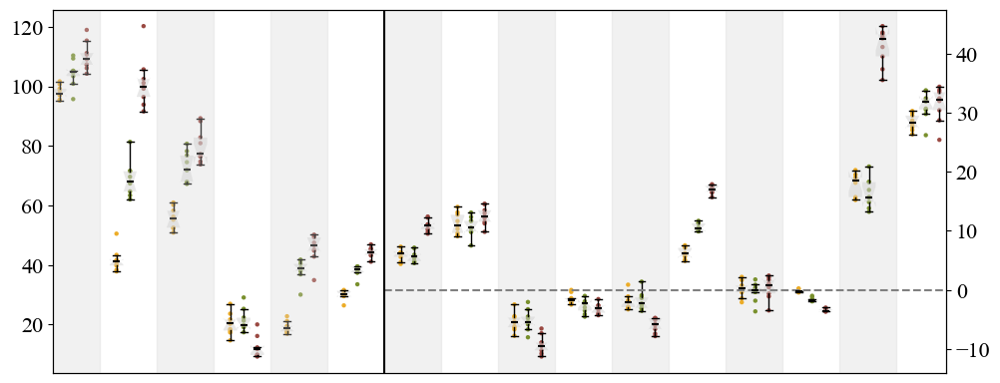

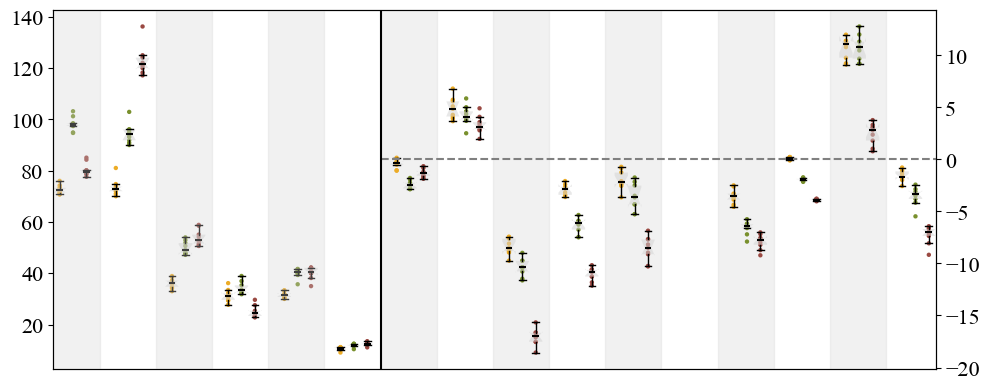

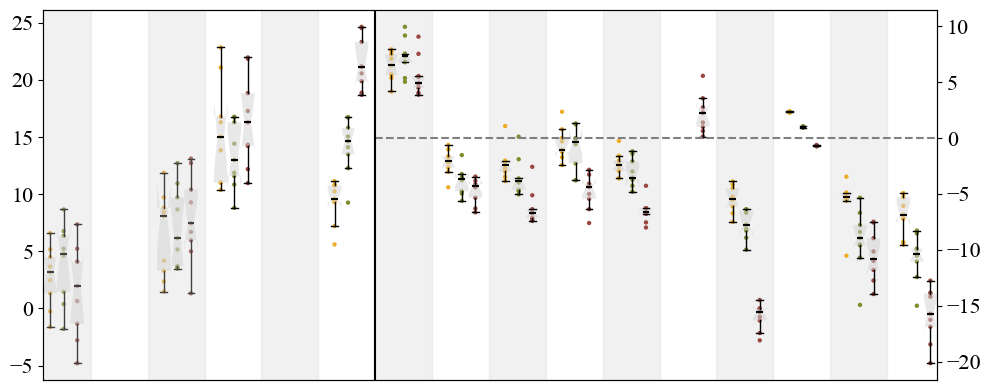

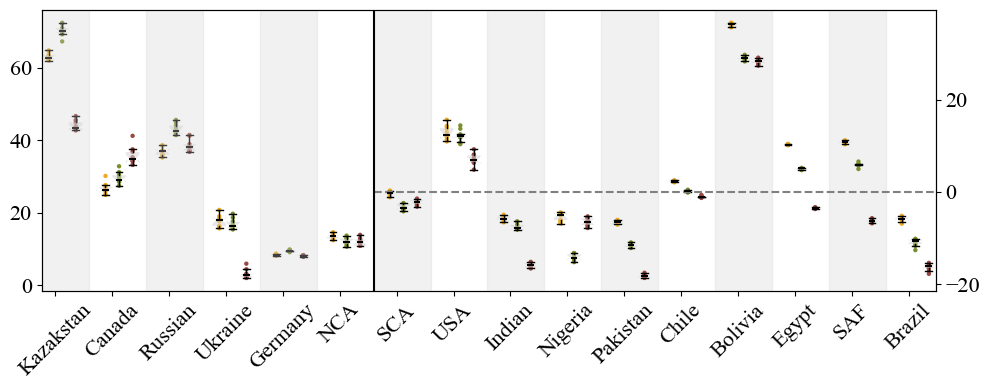

In [31]:
import geopandas as gpd
import xarray as xr
import rioxarray
import matplotlib.pyplot as plt
import os
import numpy as np
from rioxarray.exceptions import NoDataInBounds
import matplotlib as mpl
mpl.rcParams['font.family'] = 'Times New Roman'

def ensure_directory_exists(dir_path):
    if not os.path.exists(dir_path):
        os.makedirs(dir_path)

# 设置 SSP 情景颜色
ssp_colors = {
    'ssp126': '#ECAC27',
    'ssp370': '#79902D',
    'ssp585': '#9A4942'
}

shapefile_path = r'F:\世界区划\世界国家\世界国家.shp'
gdf = gpd.read_file(shapefile_path)
country_name = ['KAZAKHSTAN', 'CANADA','RUSSIAN FEDERATION','UKRAINE',  'GERMANY', 'CHINA','UNITED STATES','INDIA', 'NIGERIA',  'PAKISTAN', 'CHILE', 'BOLIVIA', 'EGYPT',  'SOUTH AFRICA', 'BRAZIL']
country_name1 = ['Kazakstan', 'Canada','Russian',  'Ukraine', 'Germany','NCA','SCA', 'USA','Indian', 'Nigeria', 'Pakistan', 'Chile', 'Bolivia', 'Egypt',  'SAF', 'Brazil']
ssp = ['ssp126', 'ssp370', 'ssp585']

# 确保 GeoDataFrame 具有 CRS
if gdf.crs is None:
    gdf.set_crs(epsg=4326, inplace=True)

# 读取和处理数据
for crop in data_dict.keys():
    # 初始化数据收集列表
    all_data = []

    for country in country_name:
        country_gdf = gdf[gdf['NAME'] == country]
 
        if country_gdf.empty:
            print(f"未找到 {country} 的数据，跳过...")
            continue
        if country=='CHINA':
            
            # 创建一个纬度为35°的线，分割南北中国
            line_35 = LineString([(-180, 40), (180, 40)])
            china_north = gpd.overlay(country_gdf, gpd.GeoDataFrame(geometry=[box(-180, 40, 180, 90)], crs=country_gdf.crs), how='intersection')
            china_south = gpd.overlay(country_gdf, gpd.GeoDataFrame(geometry=[box(-180, -90, 180, 40)], crs=country_gdf.crs), how='intersection')
            country_parts = {'North China': china_north, 'South China': china_south}
            for region_name, region_gdf in country_parts.items():
                data_to_plot=[]
                for ss in ssp:
                    if ss not in data_dict[crop]:
                        print(f"{ss} 情景无结果数据，跳过...")
                        continue
                    
                    csr = data_dict[crop][ss]
                    data = csr.rio.set_spatial_dims(x_dim='lon', y_dim='lat', inplace=True)
                    data = data.rio.write_crs("EPSG:4326")
                
                    try:
                        yr_nonirr = data.rio.clip([region_gdf.iloc[0]['geometry']], gdf.crs, drop=True)
                        yr_nonirr_mean = yr_nonirr.mean(dim=['lat', 'lon'])
                        data_to_plot.append(yr_nonirr_mean.values)
                    except NoDataInBounds:
                        print(f"{country} 区域内无数据，跳过 {ss}...")
                        continue
                
                if data_to_plot:
                    all_data.append(data_to_plot)

        
        else:
            basin_geom = country_gdf.iloc[0]['geometry']
            
            # 存储各个国家的数据
            data_to_plot = []
            for ss in ssp:
                if ss not in data_dict[crop]:
                    print(f"{ss} 情景无结果数据，跳过...")
                    continue
                
                csr = data_dict[crop][ss]
                data = csr.rio.set_spatial_dims(x_dim='lon', y_dim='lat', inplace=True)
                data = data.rio.write_crs("EPSG:4326")
            
                try:
                    yr_nonirr = data.rio.clip([basin_geom], gdf.crs, drop=True)
                    yr_nonirr_mean = yr_nonirr.mean(dim=['lat', 'lon'])
                    data_to_plot.append(yr_nonirr_mean.values)
                except NoDataInBounds:
                    print(f"{country} 区域内无数据，跳过 {ss}...")
                    continue
            
            if data_to_plot:
                all_data.append(data_to_plot)

    country_labels=country_name1
    # 将前两个国家和其他国家分开
    first_two_countries = country_labels[:6]
    remaining_countries = country_labels[6:]
    first_two_data = all_data[:6]
    remaining_data = all_data[6:]
    
    # 整理数据为箱线图输入格式
    width = 0.7
    gap = 1.2  # 每组之间的间隔
    first_two_positions = []
    remaining_positions = []
    
    for i, country in enumerate(first_two_countries):
        start = i * (len(ssp) + gap)
        first_two_positions.extend([start + j for j in range(len(ssp))])
    
    for i, country in enumerate(remaining_countries):
        start = (i+6) * (len(ssp) + gap)
        remaining_positions.extend([start + j for j in range(len(ssp))])
    
    # 创建一个总绘图窗口
    fig, ax1 = plt.subplots(figsize=(10, 4))
    
    # 绘制前两个国家的箱线图和散点图（使用第一个 y 轴）
    box1 = ax1.boxplot([data for sublist in first_two_data for data in sublist], patch_artist=True, vert=True, widths=1, notch=True, showfliers=False,
                       boxprops=dict(facecolor='lightgrey', edgecolor='none', linewidth=1),
                       whiskerprops=dict(linewidth=1),
                       capprops=dict(linewidth=1), positions=first_two_positions,
                       medianprops=dict(color='black', linewidth=1.5))
    for patch in box1['boxes']:
        patch.set_facecolor('lightgrey')
        patch.set_alpha(0.5)  # 设置透明度
        patch.set_edgecolor('none')
    for i, data in enumerate([data for sublist in first_two_data for data in sublist]):
        ax1.scatter([first_two_positions[i]] * len(data), data, color=ssp_colors[ssp[i % 3]], alpha=1, s=10, edgecolor='none')
    
    # 设置 x 轴刻度标签为国家名称
    ax1.set_xticks([(i * (len(ssp) + gap-1) + (len(ssp) / 2)) for i in range(len(first_two_countries))])
    ax1.set_xticklabels(first_two_countries, fontsize=14, rotation=45, ha='center')
    ax1.tick_params(axis='both', labelsize=16)
    # 设置第一个 y 轴标签
    # ax1.set_ylabel('Yield change (%)')
    
    # 创建第二个 y 轴
    ax2 = ax1.twinx()
    
    # 绘制其余国家的箱线图和散点图（使用第二个 y 轴）
    box2 = ax2.boxplot([data for sublist in remaining_data for data in sublist], patch_artist=True, vert=True, widths=1, notch=True, showfliers=False,
                       boxprops=dict(facecolor='lightgrey', edgecolor='none', linewidth=1),
                       whiskerprops=dict(linewidth=1),
                       capprops=dict(linewidth=1), positions=remaining_positions,
                       medianprops=dict(color='black', linewidth=1.5))
    for patch in box2['boxes']:
        patch.set_facecolor('lightgrey')
        patch.set_alpha(0.5)  # 设置透明度
        patch.set_edgecolor('none')
    for i, data in enumerate([data for sublist in remaining_data for data in sublist]):
        ax2.scatter([remaining_positions[i]] * len(data), data, color=ssp_colors[ssp[i % 3]], alpha=1, s=10, edgecolor='none')

    # 设置剩余国家的 x 轴刻度标签
    # ax2.set_xticks([((i+2) * (len(ssp) + gap) + (len(ssp) / 2)) for i in range(len(remaining_countries))])
    # ax2.set_xticklabels(remaining_countries, fontsize=16, rotation=45, ha='center')
    # ax2.axhline(y=0, color='red', linestyle='--')
    ax2.plot([24, ax2.get_xlim()[1]], [0, 0], color='gray', linestyle='--')
    ax2.axvline(x=24, color='black', linestyle='-')
    ax2.set_xticks([(i * (len(ssp) + gap) + (len(ssp) / 2)-1) for i in range(len(country_labels))])
    ax2.set_xticklabels(country_name1, fontsize=16, rotation=45, ha='center')
    ax2.tick_params(axis='both', labelsize=16)
    if crop !='wheat':
        ax2.set_xticks([])
        ax2.set_xticklabels([])
    
    # 设置第二个 y 轴标签
    # ax2.set_ylabel('Yield change (%) - Remaining Countries')
    for i in range(len(country_labels)):
        start = i * (len(ssp) + gap)
        if i%2==0:
            ax2.add_patch(plt.Rectangle((start-1.2, -100), len(ssp) + 1.2,500, color='lightgrey', alpha=0.3, zorder=0))
    # 确保输出文件夹存在
    output_path = rf'F:\paper3_fig_v2\reginal\fig\{crop}_country.png'
    ensure_directory_exists(os.path.dirname(output_path))

    # 保存和显示图片
    plt.tight_layout()
    # plt.savefig(output_path, dpi=300)
    plt.show()


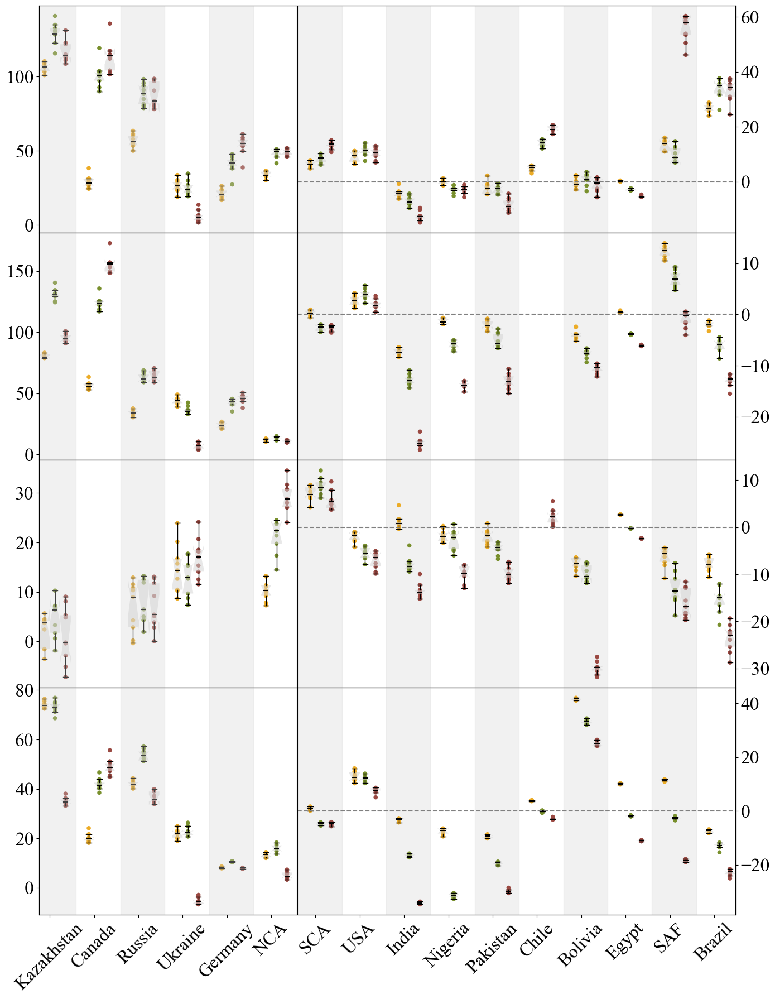

In [4]:
import geopandas as gpd
import xarray as xr
import rioxarray
import matplotlib.pyplot as plt
import os
import numpy as np
from rioxarray.exceptions import NoDataInBounds
import matplotlib as mpl
import matplotlib.gridspec as gridspec
from shapely.geometry import LineString, box
mpl.rcParams['font.family'] = 'Times New Roman'

def ensure_directory_exists(dir_path):
    if not os.path.exists(dir_path):
        os.makedirs(dir_path)

# 设置 SSP 情景颜色
ssp_colors = {
    'ssp126': '#ECAC27',
    'ssp370': '#79902D',
    'ssp585': '#9A4942'
}

shapefile_path = r'F:\世界区划\世界国家\世界国家.shp'
gdf = gpd.read_file(shapefile_path)
country_name = ['KAZAKHSTAN', 'CANADA','RUSSIAN FEDERATION','UKRAINE',  'GERMANY', 'CHINA','UNITED STATES','INDIA', 'NIGERIA',  'PAKISTAN', 'CHILE', 'BOLIVIA', 'EGYPT',  'SOUTH AFRICA', 'BRAZIL']
country_name1 = ['Kazakhstan', 'Canada','Russia',  'Ukraine', 'Germany','NCA','SCA', 'USA','India', 'Nigeria', 'Pakistan', 'Chile', 'Bolivia', 'Egypt',  'SAF', 'Brazil']
ssp = ['ssp126', 'ssp370', 'ssp585']

# 确保 GeoDataFrame 具有 CRS
if gdf.crs is None:
    gdf.set_crs(epsg=4326, inplace=True)
fig = plt.figure(figsize=(14, 18))
gs = gridspec.GridSpec(4, 1, hspace=0)  # hspace=0 表示没有行间距
# ace=0
# 读取和处理数据
for ace,crop in enumerate(data_dict.keys()):
    # 初始化数据收集列表
    all_data = []

    for country in country_name:
        country_gdf = gdf[gdf['NAME'] == country]
 
        if country_gdf.empty:
            print(f"未找到 {country} 的数据，跳过...")
            continue
        if country=='CHINA':
            
            # 创建一个纬度为35°的线，分割南北中国
            line_35 = LineString([(-180, 40), (180, 40)])
            china_north = gpd.overlay(country_gdf, gpd.GeoDataFrame(geometry=[box(-180, 40, 180, 90)], crs=country_gdf.crs), how='intersection')
            china_south = gpd.overlay(country_gdf, gpd.GeoDataFrame(geometry=[box(-180, -90, 180, 40)], crs=country_gdf.crs), how='intersection')
            country_parts = {'North China': china_north, 'South China': china_south}
            for region_name, region_gdf in country_parts.items():
                data_to_plot=[]
                for ss in ssp:
                    if ss not in data_dict[crop]:
                        print(f"{ss} 情景无结果数据，跳过...")
                        continue
                    
                    csr = data_dict[crop][ss]
                    data = csr.rio.set_spatial_dims(x_dim='lon', y_dim='lat', inplace=True)
                    data = data.rio.write_crs("EPSG:4326")
                
                    try:
                        yr_nonirr = data.rio.clip([region_gdf.iloc[0]['geometry']], gdf.crs, drop=True)
                        yr_nonirr_mean = yr_nonirr.mean(dim=['lat', 'lon'])
                        data_to_plot.append(yr_nonirr_mean.values)
                    except NoDataInBounds:
                        print(f"{country} 区域内无数据，跳过 {ss}...")
                        continue
                
                if data_to_plot:
                    all_data.append(data_to_plot)

        
        else:
            basin_geom = country_gdf.iloc[0]['geometry']
            
            # 存储各个国家的数据
            data_to_plot = []
            for ss in ssp:
                if ss not in data_dict[crop]:
                    print(f"{ss} 情景无结果数据，跳过...")
                    continue
                
                csr = data_dict[crop][ss]
                data = csr.rio.set_spatial_dims(x_dim='lon', y_dim='lat', inplace=True)
                data = data.rio.write_crs("EPSG:4326")
            
                try:
                    yr_nonirr = data.rio.clip([basin_geom], gdf.crs, drop=True)
                    yr_nonirr_mean = yr_nonirr.mean(dim=['lat', 'lon'])
                    data_to_plot.append(yr_nonirr_mean.values)
                except NoDataInBounds:
                    print(f"{country} 区域内无数据，跳过 {ss}...")
                    continue
            
            if data_to_plot:
                all_data.append(data_to_plot)

    country_labels=country_name1
    # 将前两个国家和其他国家分开
    first_two_countries = country_labels[:6]
    remaining_countries = country_labels[6:]
    first_two_data = all_data[:6]
    remaining_data = all_data[6:]
    
    # 整理数据为箱线图输入格式
    width = 0.7
    gap = 1.2  # 每组之间的间隔
    first_two_positions = []
    remaining_positions = []
    
    for i, country in enumerate(first_two_countries):
        start = i * (len(ssp) + gap)
        first_two_positions.extend([start + j for j in range(len(ssp))])
    
    for i, country in enumerate(remaining_countries):
        start = (i+6) * (len(ssp) + gap)
        remaining_positions.extend([start + j for j in range(len(ssp))])
    
    # 创建一个总绘图窗口
    ax1 = plt.subplot(gs[ace])
    
    # 绘制前两个国家的箱线图和散点图（使用第一个 y 轴）
    box1 = ax1.boxplot([data for sublist in first_two_data for data in sublist], patch_artist=True, vert=True, widths=1, notch=True, showfliers=False,
                       boxprops=dict(facecolor='lightgrey', edgecolor='none', linewidth=1),
                       whiskerprops=dict(linewidth=1),
                       capprops=dict(linewidth=1), positions=first_two_positions,
                       medianprops=dict(color='black', linewidth=1.5))
    for patch in box1['boxes']:
        patch.set_facecolor('lightgrey')
        patch.set_alpha(0.5)  # 设置透明度
        patch.set_edgecolor('none')
    for i, data in enumerate([data for sublist in first_two_data for data in sublist]):
        ax1.scatter([first_two_positions[i]] * len(data), data, color=ssp_colors[ssp[i % 3]], alpha=1, s=30, edgecolor='none')
    
    # 设置 x 轴刻度标签为国家名称
    ax1.set_xticks([(i * (len(ssp) + gap-1) + (len(ssp) / 2)) for i in range(len(first_two_countries))])
    ax1.set_xticklabels(first_two_countries, fontsize=18, rotation=45, ha='center')
    ax1.tick_params(axis='both', labelsize=24)
    # 设置第一个 y 轴标签
    # ax1.set_ylabel('Yield change (%)')
    
    # 创建第二个 y 轴
    ax2 = ax1.twinx()
    
    # 绘制其余国家的箱线图和散点图（使用第二个 y 轴）
    box2 = ax2.boxplot([data for sublist in remaining_data for data in sublist], patch_artist=True, vert=True, widths=1, notch=True, showfliers=False,
                       boxprops=dict(facecolor='lightgrey', edgecolor='none', linewidth=1),
                       whiskerprops=dict(linewidth=1),
                       capprops=dict(linewidth=1), positions=remaining_positions,
                       medianprops=dict(color='black', linewidth=1.5))
    for patch in box2['boxes']:
        patch.set_facecolor('lightgrey')
        patch.set_alpha(0.5)  # 设置透明度
        patch.set_edgecolor('none')
    for i, data in enumerate([data for sublist in remaining_data for data in sublist]):
        ax2.scatter([remaining_positions[i]] * len(data), data, color=ssp_colors[ssp[i % 3]], alpha=1, s=30, edgecolor='none')

    # 设置剩余国家的 x 轴刻度标签
    # ax2.set_xticks([((i+2) * (len(ssp) + gap) + (len(ssp) / 2)) for i in range(len(remaining_countries))])
    # ax2.set_xticklabels(remaining_countries, fontsize=16, rotation=45, ha='center')
    # ax2.axhline(y=0, color='red', linestyle='--')
    ax2.plot([24, ax2.get_xlim()[1]], [0, 0], color='gray', linestyle='--')
    ax2.axvline(x=24, color='black', linestyle='-')
    ax2.set_xticks([(i * (len(ssp) + gap) + (len(ssp) / 2)-1) for i in range(len(country_labels))])
    ax2.set_xticklabels(country_name1, fontsize=18, rotation=45, ha='center')
    ax2.tick_params(axis='both', labelsize=24)
    if crop !='wheat':
        ax2.set_xticks([])
        ax2.set_xticklabels([])
    
    # 设置第二个 y 轴标签
    # ax2.set_ylabel('Yield change (%) - Remaining Countries')
    for i in range(len(country_labels)):
        start = i * (len(ssp) + gap)
        if i%2==0:
            ax2.add_patch(plt.Rectangle((start-1.2, -100), len(ssp) + 1.2,500, color='lightgrey', alpha=0.3, zorder=0))
    # 确保输出文件夹存在
output_path = rf'F:\paper3_fig_v2\reginal\fig\crop_country_v2.png'
ensure_directory_exists(os.path.dirname(output_path))

# 保存和显示图片
plt.tight_layout()
plt.savefig(output_path, dpi=300)
plt.show()


In [13]:
import os
import xarray as xr
import pandas as pd
import numpy as np
from os.path import join
from xarray.coding.times import decode_cf_datetime
periods_indices = {
            'Near-term': (0, 20),   # 前20年
            'Mid-term': (20, 50),   # 中间30年
            'Long-term': (50, 80)   # 最后30年
        }
        
# 场景列表
crops = ['maiz', 'soyb', 'rice', 'wheat']
ss = ['ssp126', 'ssp370', 'ssp585']
fp =  r'F:\CWatM\cwatm_output\global_future'
frac_name=['MAIZ','SOYB','RICE','WHEA']
# 初始化结果字典
data_dict = {}
yield_name=['maiz','soyb','ricw','whea']
rcp=[26,60,85]
for i,crop in enumerate(crops):
    ori = xr.open_dataset(join(r'F:\paper3_fig_v2\yield\yield\gswp3_w5e5', F'{crop}_relitive_yield.nc'), decode_times=False).__xarray_dataarray_variable__
    ori=ori.where(ori > 0, np.nan)
    # 初始化用于存储结果的字典
    results = {}
    institution_means_list = []
    for j,ssp in enumerate(ss):
        institution_means_list=[]
        for inst in os.listdir(fp):
            if inst == 'GWSP3_W5E5' or inst == 'MRI-ESM2-0':
                continue
        
            csr = xr.open_dataset(join(r'F:\paper3_fig_v2\yield\yield',f'{inst}', F'{crop}_{ssp}_relitive_yield.nc'), decode_times=False).__xarray_dataarray_variable__[-30:]
            # units = csr.time.attrs['units']
            # calendar = csr.time.attrs.get('calendar', 'standard')
            # dates = decode_cf_datetime(csr.time.values, units, calendar)
            # csr = csr.assign_coords(time=("time", dates))
            csr=csr.interp(lat=ori.lat,lon=ori.lon)
            csr=csr.where(ori>0,0)
            institution_means_list.append((csr.mean(dim='time')-ori)/ori*100)
        
        combined_means = xr.concat(institution_means_list, dim='institution')
        # overall_mean = combined_means.mean(dim='institution', skipna=True)
        
        results[ssp] = combined_means
        
        # 计算差异并存储到字典
    data_dict[crop] = results

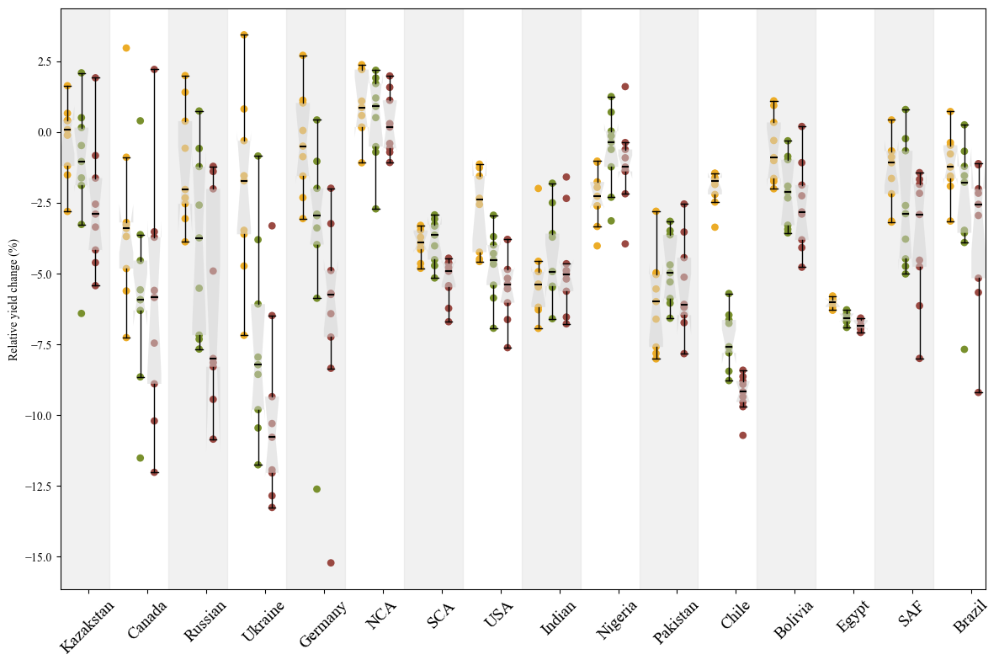

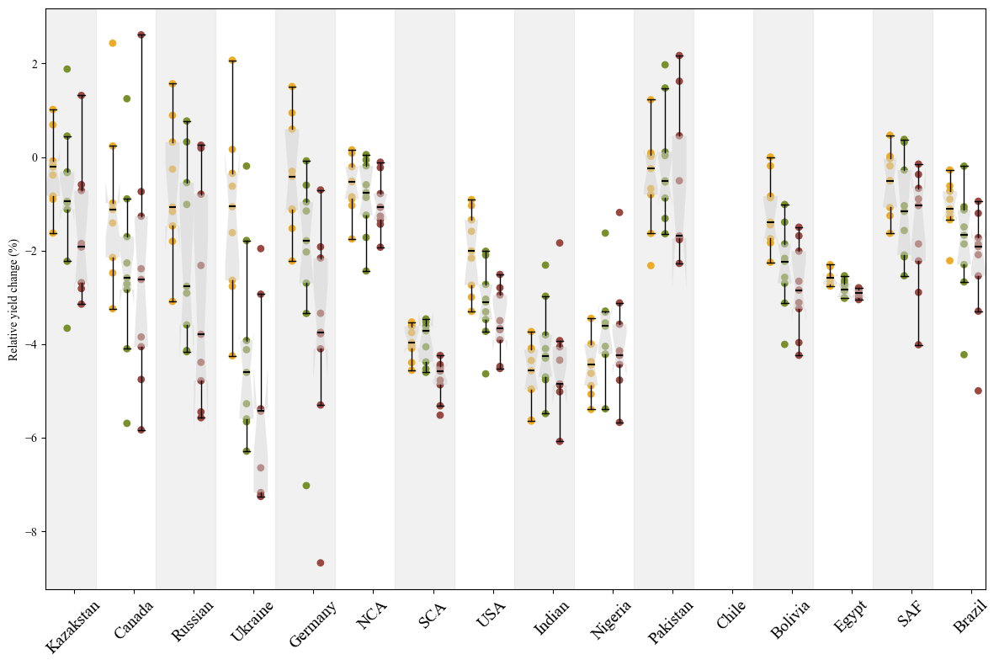

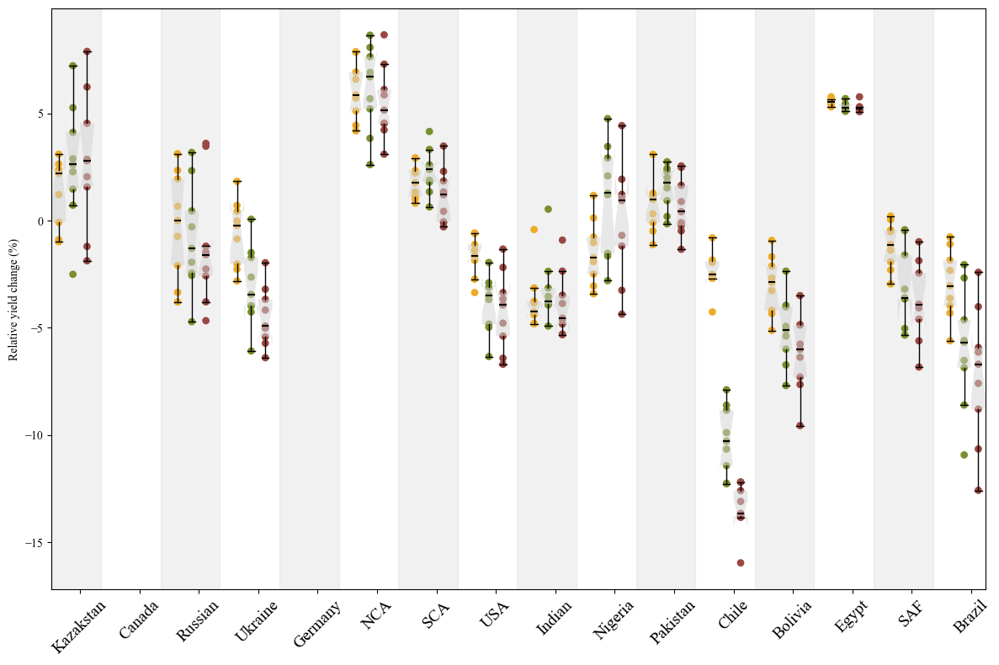

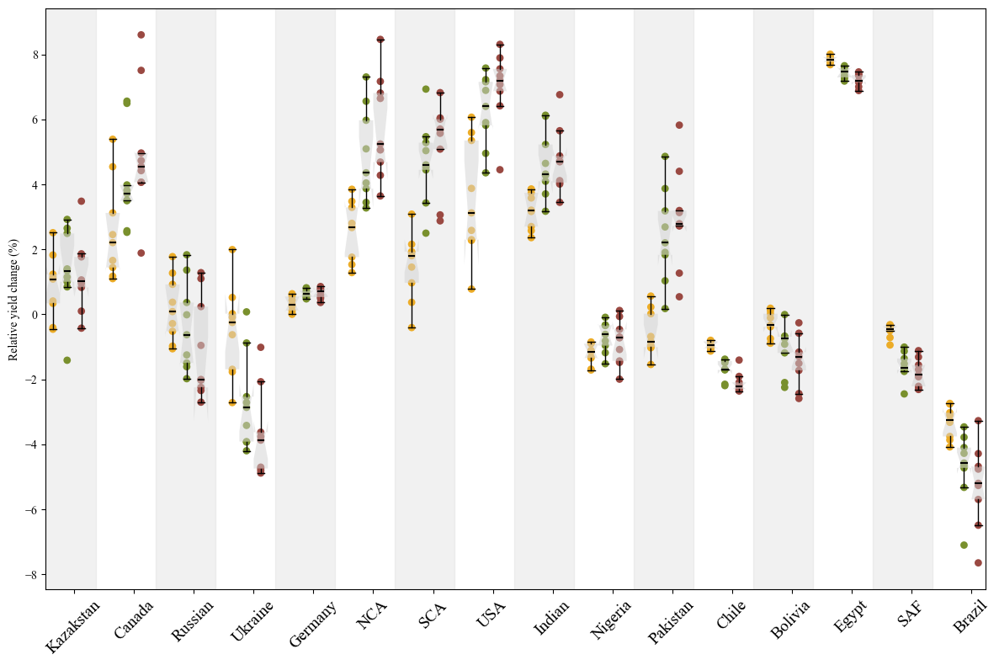

In [16]:
import geopandas as gpd
import xarray as xr
import rioxarray
import matplotlib.pyplot as plt
import os
import numpy as np
from rioxarray.exceptions import NoDataInBounds

def ensure_directory_exists(dir_path):
    if not os.path.exists(dir_path):
        os.makedirs(dir_path)

# 设置 SSP 情景颜色
ssp_colors = {
    'ssp126': '#ECAC27',
    'ssp370': '#79902D',
    'ssp585': '#9A4942'
}

shapefile_path = r'F:\世界区划\世界国家\世界国家.shp'
gdf = gpd.read_file(shapefile_path)
country_name = ['KAZAKHSTAN', 'CANADA','RUSSIAN FEDERATION','UKRAINE',  'GERMANY', 'CHINA','UNITED STATES','INDIA', 'NIGERIA',  'PAKISTAN', 'CHILE', 'BOLIVIA', 'EGYPT',  'SOUTH AFRICA', 'BRAZIL']
country_name1 = ['Kazakstan', 'Canada','Russian',  'Ukraine', 'Germany','NCA','SCA', 'USA','Indian', 'Nigeria', 'Pakistan', 'Chile', 'Bolivia', 'Egypt',  'SAF', 'Brazil']
ssp = ['ssp126', 'ssp370', 'ssp585']

# 确保 GeoDataFrame 具有 CRS
if gdf.crs is None:
    gdf.set_crs(epsg=4326, inplace=True)

# 读取和处理数据
for crop in data_dict.keys():
    # 初始化数据收集列表
    all_data = []

    for country in country_name:
        country_gdf = gdf[gdf['NAME'] == country]
 
        if country_gdf.empty:
            print(f"未找到 {country} 的数据，跳过...")
            continue
        if country=='CHINA':
            
            # 创建一个纬度为35°的线，分割南北中国
            line_35 = LineString([(-180, 40), (180, 40)])
            china_north = gpd.overlay(country_gdf, gpd.GeoDataFrame(geometry=[box(-180, 40, 180, 90)], crs=country_gdf.crs), how='intersection')
            china_south = gpd.overlay(country_gdf, gpd.GeoDataFrame(geometry=[box(-180, -90, 180, 40)], crs=country_gdf.crs), how='intersection')
            country_parts = {'North China': china_north, 'South China': china_south}
            for region_name, region_gdf in country_parts.items():
                data_to_plot=[]
                for ss in ssp:
                    if ss not in data_dict[crop]:
                        print(f"{ss} 情景无结果数据，跳过...")
                        continue
                    
                    csr = data_dict[crop][ss]
                    data = csr.rio.set_spatial_dims(x_dim='lon', y_dim='lat', inplace=True)
                    data = data.rio.write_crs("EPSG:4326")
                
                    try:
                        yr_nonirr = data.rio.clip([region_gdf.iloc[0]['geometry']], gdf.crs, drop=True)
                        yr_nonirr_mean = yr_nonirr.mean(dim=['lat', 'lon'])
                        data_to_plot.append(yr_nonirr_mean.values)
                    except NoDataInBounds:
                        print(f"{country} 区域内无数据，跳过 {ss}...")
                        continue
                
                if data_to_plot:
                    all_data.append(data_to_plot)

        
        else:
            basin_geom = country_gdf.iloc[0]['geometry']
            
            # 存储各个国家的数据
            data_to_plot = []
            for ss in ssp:
                if ss not in data_dict[crop]:
                    print(f"{ss} 情景无结果数据，跳过...")
                    continue
                
                csr = data_dict[crop][ss]
                data = csr.rio.set_spatial_dims(x_dim='lon', y_dim='lat', inplace=True)
                data = data.rio.write_crs("EPSG:4326")
            
                try:
                    yr_nonirr = data.rio.clip([basin_geom], gdf.crs, drop=True)
                    yr_nonirr_mean = yr_nonirr.mean(dim=['lat', 'lon'])
                    data_to_plot.append(yr_nonirr_mean.values)
                except NoDataInBounds:
                    print(f"{country} 区域内无数据，跳过 {ss}...")
                    continue
            
            if data_to_plot:
                all_data.append(data_to_plot)

    country_labels=country_name1
    # 将前两个国家和其他国家分开
    first_two_countries = country_labels[:]
    remaining_countries = country_labels[6:]
    first_two_data = all_data[:]
    remaining_data = all_data[6:]
    
    # 整理数据为箱线图输入格式
    width = 0.7
    gap = 1.2  # 每组之间的间隔
    first_two_positions = []
    remaining_positions = []
    
    for i, country in enumerate(first_two_countries):
        start = i * (len(ssp) + gap)
        first_two_positions.extend([start + j for j in range(len(ssp))])
    
    for i, country in enumerate(remaining_countries):
        start = (i+6) * (len(ssp) + gap)
        remaining_positions.extend([start + j for j in range(len(ssp))])
    
    # 创建一个总绘图窗口
    fig, ax1 = plt.subplots(figsize=(12, 8))
    
    # 绘制前两个国家的箱线图和散点图（使用第一个 y 轴）
    box1 = ax1.boxplot([data for sublist in first_two_data for data in sublist], patch_artist=True, vert=True, widths=1, notch=True, showfliers=False,
                       boxprops=dict(facecolor='lightgrey', edgecolor='none', linewidth=1),
                       whiskerprops=dict(linewidth=1),
                       capprops=dict(linewidth=1), positions=first_two_positions,
                       medianprops=dict(color='black', linewidth=1.5))
    for patch in box1['boxes']:
        patch.set_facecolor('lightgrey')
        patch.set_alpha(0.5)  # 设置透明度
        patch.set_edgecolor('none')
    for i, data in enumerate([data for sublist in first_two_data for data in sublist]):
        ax1.scatter([first_two_positions[i]] * len(data), data, color=ssp_colors[ssp[i % 3]], alpha=1, s=40, edgecolor='none')
    
    # 设置 x 轴刻度标签为国家名称
    ax1.set_xticks([(i * (len(ssp) + gap) + (len(ssp) / 2)) for i in range(len(first_two_countries))])
    ax1.set_xticklabels(first_two_countries, fontsize=14, rotation=45, ha='center')

    # 设置第一个 y 轴标签
    ax1.set_ylabel('Relative yield change (%)')
    
    # 创建第二个 y 轴
    # ax2 = ax1.twinx()
    
    # # 绘制其余国家的箱线图和散点图（使用第二个 y 轴）
    # box2 = ax2.boxplot([data for sublist in remaining_data for data in sublist], patch_artist=True, vert=True, widths=1, notch=True, showfliers=False,
    #                    boxprops=dict(facecolor='lightgrey', edgecolor='none', linewidth=1),
    #                    whiskerprops=dict(linewidth=1),
    #                    capprops=dict(linewidth=1), positions=remaining_positions,
    #                    medianprops=dict(color='black', linewidth=1.5))
    # for patch in box2['boxes']:
    #     patch.set_facecolor('lightgrey')
    #     patch.set_alpha(0.5)  # 设置透明度
    #     patch.set_edgecolor('none')
    # for i, data in enumerate([data for sublist in remaining_data for data in sublist]):
    #     ax2.scatter([remaining_positions[i]] * len(data), data, color=ssp_colors[ssp[i % 3]], alpha=1, s=40, edgecolor='none')

    # # 设置剩余国家的 x 轴刻度标签
    # # ax2.set_xticks([((i+2) * (len(ssp) + gap) + (len(ssp) / 2)) for i in range(len(remaining_countries))])
    # # ax2.set_xticklabels(remaining_countries, fontsize=16, rotation=45, ha='center')
    # # ax2.axhline(y=0, color='red', linestyle='--')
    # ax2.plot([24, ax2.get_xlim()[1]], [0, 0], color='red', linestyle='--')
    # ax2.axvline(x=24, color='black', linestyle='-')
    # ax2.set_xticks([(i * (len(ssp) + gap) + (len(ssp) / 2)) for i in range(len(country_labels))])
    # ax2.set_xticklabels(country_name1, fontsize=16, rotation=45, ha='center')
    # # 设置第二个 y 轴标签
    # # ax2.set_ylabel('Yield change (%) - Remaining Countries')
    for i in range(len(country_labels)):
        start = i * (len(ssp) + gap)
        if i%2==0:
            ax1.add_patch(plt.Rectangle((start-1.2, -100), len(ssp) + 1.2,500, color='lightgrey', alpha=0.3, zorder=0))
    # 确保输出文件夹存在
    # output_path = rf'F:\paper3_fig\combined\fig5\{crop}_yr_two_axes.png'
    # ensure_directory_exists(os.path.dirname(output_path))

    # 保存和显示图片
    plt.tight_layout()
    # plt.savefig(output_path, dpi=300)
    plt.show()


In [ ]:
ax1 = plt.subplot(gs[ace])

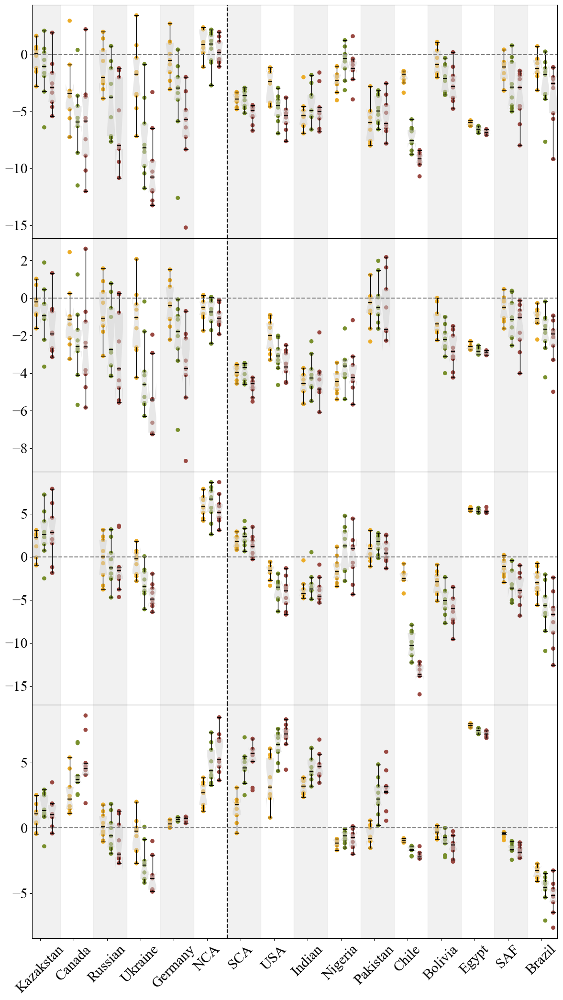

In [25]:
import geopandas as gpd
import xarray as xr
import rioxarray
import matplotlib.pyplot as plt
import os
import numpy as np
from rioxarray.exceptions import NoDataInBounds
import matplotlib as mpl
import matplotlib.gridspec as gridspec
mpl.rcParams['font.family'] = 'Times New Roman'

def ensure_directory_exists(dir_path):
    if not os.path.exists(dir_path):
        os.makedirs(dir_path)

# 设置 SSP 情景颜色
ssp_colors = {
    'ssp126': '#ECAC27',
    'ssp370': '#79902D',
    'ssp585': '#9A4942'
}

shapefile_path = r'F:\世界区划\世界国家\世界国家.shp'
gdf = gpd.read_file(shapefile_path)
country_name = ['KAZAKHSTAN', 'CANADA','RUSSIAN FEDERATION','UKRAINE',  'GERMANY', 'CHINA','UNITED STATES','INDIA', 'NIGERIA',  'PAKISTAN', 'CHILE', 'BOLIVIA', 'EGYPT',  'SOUTH AFRICA', 'BRAZIL']
country_name1 = ['Kazakstan', 'Canada','Russian',  'Ukraine', 'Germany','NCA','SCA', 'USA','Indian', 'Nigeria', 'Pakistan', 'Chile', 'Bolivia', 'Egypt',  'SAF', 'Brazil']
ssp = ['ssp126', 'ssp370', 'ssp585']

# 确保 GeoDataFrame 具有 CRS
if gdf.crs is None:
    gdf.set_crs(epsg=4326, inplace=True)
fig = plt.figure(figsize=(12, 21))
gs = gridspec.GridSpec(4, 1, hspace=0)  # hspace=0 表示没有行间距
# ace=0
# 读取和处理数据
for ace,crop in enumerate(data_dict.keys()):
    # 初始化数据收集列表
    all_data = []

    for country in country_name:
        country_gdf = gdf[gdf['NAME'] == country]
 
        if country_gdf.empty:
            print(f"未找到 {country} 的数据，跳过...")
            continue
        if country=='CHINA':
            
            # 创建一个纬度为35°的线，分割南北中国
            line_35 = LineString([(-180, 40), (180, 40)])
            china_north = gpd.overlay(country_gdf, gpd.GeoDataFrame(geometry=[box(-180, 40, 180, 90)], crs=country_gdf.crs), how='intersection')
            china_south = gpd.overlay(country_gdf, gpd.GeoDataFrame(geometry=[box(-180, -90, 180, 40)], crs=country_gdf.crs), how='intersection')
            country_parts = {'North China': china_north, 'South China': china_south}
            for region_name, region_gdf in country_parts.items():
                data_to_plot=[]
                for ss in ssp:
                    if ss not in data_dict[crop]:
                        print(f"{ss} 情景无结果数据，跳过...")
                        continue  
                    csr = data_dict[crop][ss]
                    data = csr.rio.set_spatial_dims(x_dim='lon', y_dim='lat', inplace=True)
                    data = data.rio.write_crs("EPSG:4326")  
                    try:
                        yr_nonirr = data.rio.clip([region_gdf.iloc[0]['geometry']], gdf.crs, drop=True)
                        yr_nonirr_mean = yr_nonirr.mean(dim=['lat', 'lon'])
                        data_to_plot.append(yr_nonirr_mean.values)
                    except NoDataInBounds:
                        print(f"{country} 区域内无数据，跳过 {ss}...")
                        continue
                
                if data_to_plot:
                    all_data.append(data_to_plot)
        else:
            basin_geom = country_gdf.iloc[0]['geometry']    
            # 存储各个国家的数据
            data_to_plot = []
            for ss in ssp:
                if ss not in data_dict[crop]:
                    print(f"{ss} 情景无结果数据，跳过...")
                    continue
                
                csr = data_dict[crop][ss]
                data = csr.rio.set_spatial_dims(x_dim='lon', y_dim='lat', inplace=True)
                data = data.rio.write_crs("EPSG:4326")
            
                try:
                    yr_nonirr = data.rio.clip([basin_geom], gdf.crs, drop=True)
                    yr_nonirr_mean = yr_nonirr.mean(dim=['lat', 'lon'])
                    data_to_plot.append(yr_nonirr_mean.values)
                except NoDataInBounds:
                    print(f"{country} 区域内无数据，跳过 {ss}...")
                    continue
            
            if data_to_plot:
                all_data.append(data_to_plot)

    country_labels=country_name1
    # 将前两个国家和其他国家分开
    first_two_countries = country_labels[:]
    remaining_countries = country_labels[6:]
    first_two_data = all_data[:]
    remaining_data = all_data[6:]
    
    # 整理数据为箱线图输入格式
    width = 0.7
    gap = 1.2  # 每组之间的间隔
    first_two_positions = []
    remaining_positions = []
    
    for i, country in enumerate(first_two_countries):
        start = i * (len(ssp) + gap)
        first_two_positions.extend([start + j for j in range(len(ssp))])
    
    for i, country in enumerate(remaining_countries):
        start = (i+6) * (len(ssp) + gap)
        remaining_positions.extend([start + j for j in range(len(ssp))])
    
    # 创建一个总绘图窗口
    ax1 = plt.subplot(gs[ace])
    
    # 绘制前两个国家的箱线图和散点图（使用第一个 y 轴）
    box1 = ax1.boxplot([data for sublist in first_two_data for data in sublist], patch_artist=True, vert=True, widths=1, notch=True, showfliers=False,
                       boxprops=dict(facecolor='lightgrey', edgecolor='none', linewidth=1),
                       whiskerprops=dict(linewidth=1),
                       capprops=dict(linewidth=1), positions=first_two_positions,
                       medianprops=dict(color='black', linewidth=1.5))
    for patch in box1['boxes']:
        patch.set_facecolor('lightgrey')
        patch.set_alpha(0.5)  # 设置透明度
        patch.set_edgecolor('none')
    for i, data in enumerate([data for sublist in first_two_data for data in sublist]):
        ax1.scatter([first_two_positions[i]] * len(data), data, color=ssp_colors[ssp[i % 3]], alpha=1, s=40, edgecolor='none')
    
    # 设置 x 轴刻度标签为国家名称
    ax1.set_xticks([(i * (len(ssp) + gap) + (len(ssp) / 2)-1) for i in range(len(first_two_countries))])
    ax1.set_xticklabels(first_two_countries, fontsize=14, rotation=45, ha='center')

    # 设置第一个 y 轴标签
    # ax1.set_ylabel('Relative yield change (%)')
    ax1.tick_params(axis='both', labelsize=22)
    # 创建第二个 y 轴
    # ax2 = ax1.twinx()
    
    # # 绘制其余国家的箱线图和散点图（使用第二个 y 轴）
    # box2 = ax2.boxplot([data for sublist in remaining_data for data in sublist], patch_artist=True, vert=True, widths=1, notch=True, showfliers=False,
    #                    boxprops=dict(facecolor='lightgrey', edgecolor='none', linewidth=1),
    #                    whiskerprops=dict(linewidth=1),
    #                    capprops=dict(linewidth=1), positions=remaining_positions,
    #                    medianprops=dict(color='black', linewidth=1.5))
    # for patch in box2['boxes']:
    #     patch.set_facecolor('lightgrey')
    #     patch.set_alpha(0.5)  # 设置透明度
    #     patch.set_edgecolor('none')
    # for i, data in enumerate([data for sublist in remaining_data for data in sublist]):
    #     ax2.scatter([remaining_positions[i]] * len(data), data, color=ssp_colors[ssp[i % 3]], alpha=1, s=40, edgecolor='none')

    # # 设置剩余国家的 x 轴刻度标签
    # # ax2.set_xticks([((i+2) * (len(ssp) + gap) + (len(ssp) / 2)) for i in range(len(remaining_countries))])
    # # ax2.set_xticklabels(remaining_countries, fontsize=16, rotation=45, ha='center')
    ax1.axhline(y=0, color='gray', linestyle='--')
    ax1.axvline(x=24, color='black', linestyle='--')
    
    # ax2.plot([24, ax2.get_xlim()[1]], [0, 0], color='red', linestyle='--')
    # ax2.axvline(x=24, color='black', linestyle='-')
    # ax2.set_xticks([(i * (len(ssp) + gap) + (len(ssp) / 2)) for i in range(len(country_labels))])
    # ax2.set_xticklabels(country_name1, fontsize=16, rotation=45, ha='center')
    # # 设置第二个 y 轴标签
    # # ax2.set_ylabel('Yield change (%) - Remaining Countries')
    # ax1.plot([24, ax1.get_xlim()[1]], [0, 0], color='gray', linestyle='--')
    for i in range(len(country_labels)):
        start = i * (len(ssp) + gap)
        if i%2==0:
            ax1.add_patch(plt.Rectangle((start-1.2, -100), len(ssp) + 1.2,500, color='lightgrey', alpha=0.3, zorder=0))
    if crop !='wheat':
        ax1.set_xticks([])
        ax1.set_xticklabels([])
    
    # 设置第二个 y 轴标签
    # ax2.set_ylabel('Yield change (%) - Remaining Countries')
    # for i in range(len(country_labels)):
    #     start = i * (len(ssp) + gap)
    #     if i%2==0:
    #         ax2.add_patch(plt.Rectangle((start-1.2, -100), len(ssp) + 1.2,500, color='lightgrey', alpha=0.3, zorder=0))
    # 确保输出文件夹存在
output_path = rf'F:\paper3_fig_v2\reginal\fig\crop_country_relitive_yield.png'
ensure_directory_exists(os.path.dirname(output_path))

# 保存和显示图片
plt.tight_layout()
plt.savefig(output_path, dpi=300)
plt.show()


## potential yield change

In [268]:
import os
import xarray as xr
import pandas as pd
import numpy as np
from xarray.coding.times import decode_cf_datetime
# 场景列表
crops = ['maiz', 'soyb', 'ricw', 'whea']
ss = ['SSP585']
fp = r'F:\CWatM\cwatm_output\global_future'
day=[153,153,122,122]
# 初始化结果字典
data_dict = {}
ooo={}
# 遍历每个作物
for i,crop in enumerate(crops):
    fpy = xr.open_dataset(join(r'F:\global_cropmap\potential_yield\nc',f'{crop}_30min', F'CRUTS32_his_8110_{crop}200b_yld.nc'), decode_times=False).data+\
    xr.open_dataset(join(r'F:\global_cropmap\potential_yield\nc',f'{crop}_30min', F'CRUTS32_his_8110_{crop}200a_yld.nc'), decode_times=False).data
    fpy=fpy.where(fpy>0)
    ooo[crop]=fpy
    # 初始化用于存储结果的字典
    # results = {}
    data_dict[crop] = {}
    # 遍历每个情景
    for ssp in ss:
        institution_means_list = []

        for inst in os.listdir(fp):
            if inst == 'GWSP3_W5E5' or inst == 'MRI-ESM2-0':
                continue


        csr = xr.open_dataset(join(r'F:\global_cropmap\potential_yield\nc',f'{crop}_30min', F'GFDL-ESM2M_rcp60_71100_{crop}200b_yld.nc'), decode_times=False).data+\
    xr.open_dataset(join(r'F:\global_cropmap\potential_yield\nc',f'{crop}_30min', F'GFDL-ESM2M_rcp60_71100_{crop}200a_yld.nc'), decode_times=False).data
        # units = csr.time.attrs['units']
        # calendar = csr.time.attrs.get('calendar', 'standard')
        # dates = decode_cf_datetime(csr.time.values, units, calendar)
        # csr = csr.assign_coords(time=("time", dates))
        csr = csr.where(csr != 0, np.nan)
        
        data_dict[crop][ssp] = csr


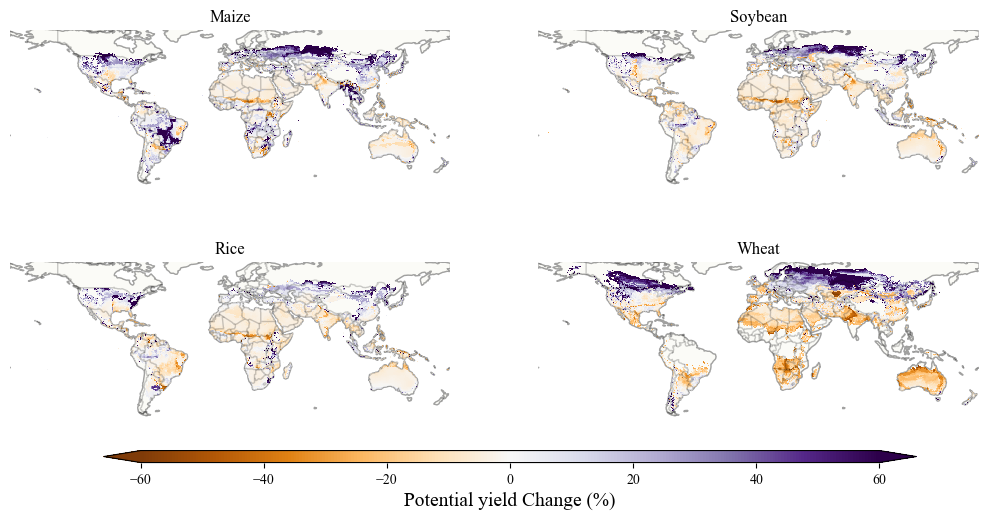

In [269]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.gridspec import GridSpec
import matplotlib as mpl

mpl.rcParams['font.family'] = 'Times New Roman'

# 场景列表
ss = ['SSP585']
crop_name = ['Maize', 'Soybean', 'Rice', 'Wheat']
# 创建一个图形和网格规格
fig = plt.figure(figsize=(12.5, 6))
gs = GridSpec(2, 2, figure=fig,hspace=0.01)  # 4行1列布局

# 遍历每个作物
for idx, crop in enumerate(crops):
    for ssp in ss:
        # 获取当前作物和情景的差异数据
        difference = (data_dict[crop][ssp]-ooo[crop])/ooo[crop]*100
        
        # 在4行1列的第 idx 个位置创建子图
        ax = fig.add_subplot(gs[idx], projection=ccrs.PlateCarree())
        
        # 设置显示范围为南纬60°到北纬60°
        ax.set_extent([-180, 180, -60, 70], crs=ccrs.PlateCarree())
        
        # 添加地图特征
        ax.add_feature(cfeature.COASTLINE, alpha=0.2)
        ax.add_feature(cfeature.LAND, edgecolor='black', alpha=0.2)
        ax.add_feature(cfeature.BORDERS,  alpha=0.2)
        # 绘制数据并设置颜色带
        im = difference.plot(ax=ax, transform=ccrs.PlateCarree(), cmap='PuOr', 
                             vmin=-60, vmax=60, add_colorbar=False)
        
        # 移除网格线
        gl = ax.gridlines(draw_labels=False)
        gl.xlines = False
        gl.ylines = False
        ax.set_title(crop_name[idx])
        # 去除四周边框
        ax.spines['geo'].set_visible(False)
        # ax.text(-0.05, 0.5, crop, transform=ax.transAxes, fontsize=14, 
        #         verticalalignment='center', horizontalalignment='center', rotation=90)

# 添加一个全局的颜色带
cbar_ax = fig.add_axes([0.2, 0.1, 0.65, 0.02])  # 颜色带的位置: [左, 下, 宽, 高]
cbar = fig.colorbar(im, cax=cbar_ax, orientation='horizontal', pad=0.03, shrink=1, aspect=10, extend='both')
cbar.set_label('Potential yield Change (%)', fontsize=14)
fig.subplots_adjust(hspace=0.05)
# 保存图像
plt.savefig(r'F:\paper3_fig_v2\yield\yield\a_fig\potenitial_yield_rcp60_change.png', dpi=300)
plt.show()


### extreme threshold

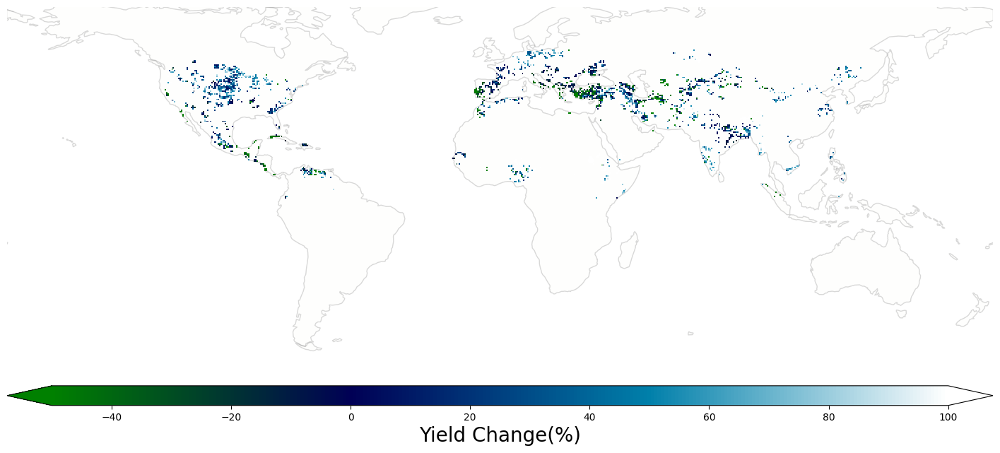

In [19]:
import os
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from os.path import join
import matplotlib as mpl
import cartopy.crs as ccrs
import cartopy.feature as cfeature
frac=xr.open_dataset(join(r'F:\global_cropmap\harvest_area\mainly_crop_frac_30min','maiz_nor_irr.nc'))['__xarray_dataarray_variable__']
his=xr.open_dataset(join(r'F:\paper3_fig_v2\extreme\future_freq','maiz_nor_irr_threshold_climate_yield_accrue_hist.nc'))['flood_yr'].where(frac>0)
future=xr.open_dataset(join(r'F:\paper3_fig_v2\extreme\future_freq','maiz_nor_irr_threshold_climate_yield_accrue_future.nc'))['flood_yr'].where(frac>0)
a=((future/31)/(his/40))*100-100
a = a.where(np.isfinite(a), np.nan)  # 将无穷值替换为NaN
fig, ax = plt.subplots( figsize=(18, 14),
                        subplot_kw={'projection': ccrs.PlateCarree()})
ax.set_extent([-180, 180, -60, 70], crs=ccrs.PlateCarree())

# 添加地图特征
ax.add_feature(cfeature.COASTLINE, alpha=0.1)
ax.add_feature(cfeature.LAND, edgecolor='black', alpha=0.05)

# 绘制数据并设置颜色带
im = a.plot(ax=ax, transform=ccrs.PlateCarree(), cmap='ocean', 
                    vmin=-50, vmax=100, add_colorbar=False)

# 设置标题为“倍数: 数字除以10” 

# 移除网格线
gl = ax.gridlines(draw_labels=False)
gl.xlines = False
gl.ylines = False

# 去除四周边框
ax.spines['geo'].set_visible(False)
cbar = plt.colorbar(im, ax=ax, orientation='horizontal', pad=0.03, shrink=1, aspect=50, extend='both')
cbar.set_label('Yield Change(%)', fontsize=20)
plt.show()

In [18]:
a.mean()

<xarray.DataArray 'flood_yr' ()> Size: 8B
array(inf)

In [79]:
np.nanmean(a)

105.40357978608708

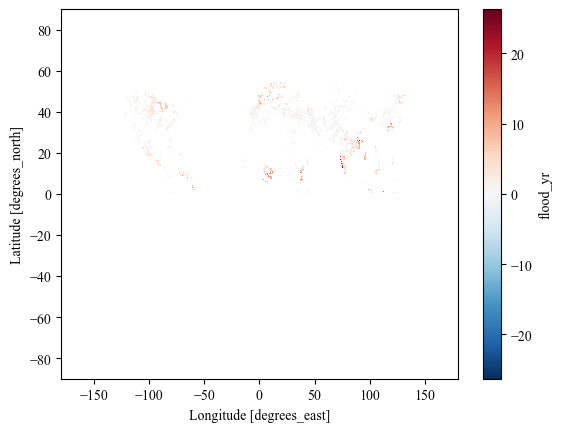

In [65]:
future.plot()

In [40]:
 a.where(abs(a)<100).min()

<xarray.DataArray 'flood_yr' ()> Size: 8B
array(-90.42278037)

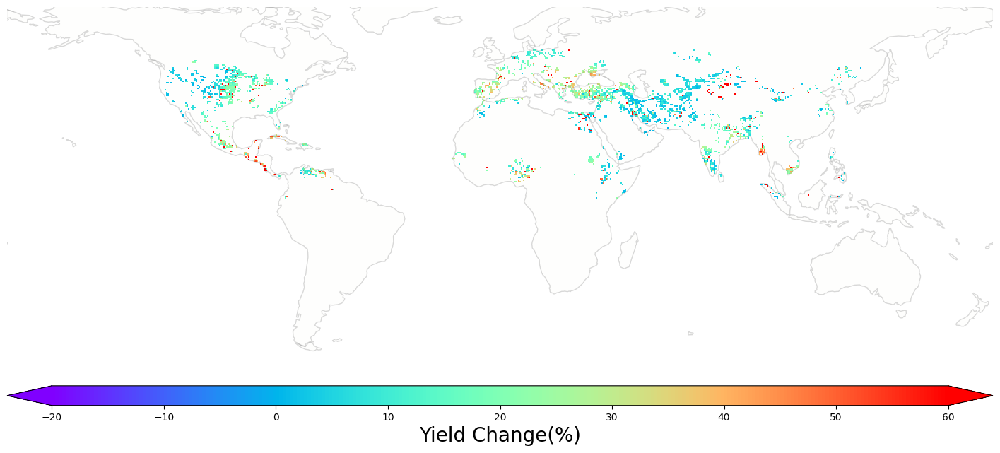

In [28]:
import os
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from os.path import join
import matplotlib as mpl
import cartopy.crs as ccrs
import cartopy.feature as cfeature

his=xr.open_dataset(join(r'F:\paper3_fig_v2\extreme\future_freq','maiz_nor_irr_threshold_climate_yield_accrue_hist.nc'))['drought_yr'].where(frac>0)
future=xr.open_dataset(join(r'F:\paper3_fig_v2\extreme\future_freq','maiz_nor_irr_threshold_climate_yield_accrue_future.nc'))['drought_yr'].where(frac>0)
a=((future/31)/(his/40))*100-100
a = a.where(np.isfinite(a), np.nan)  # 将无穷值替换为NaN
fig, ax = plt.subplots( figsize=(18, 14),
                        subplot_kw={'projection': ccrs.PlateCarree()})
ax.set_extent([-180, 180, -60, 70], crs=ccrs.PlateCarree())

# 添加地图特征
ax.add_feature(cfeature.COASTLINE, alpha=0.1)
ax.add_feature(cfeature.LAND, edgecolor='black', alpha=0.05)

# 绘制数据并设置颜色带
im = abs(a).plot(ax=ax, transform=ccrs.PlateCarree(), cmap='rainbow', 
                      vmin=-20, vmax=60,add_colorbar=False)

# 设置标题为“倍数: 数字除以10”

# 移除网格线
gl = ax.gridlines(draw_labels=False)
gl.xlines = False
gl.ylines = False

# 去除四周边框
ax.spines['geo'].set_visible(False)
cbar = plt.colorbar(im, ax=ax, orientation='horizontal', pad=0.03, shrink=1, aspect=50, extend='both')
cbar.set_label('Yield Change(%)', fontsize=20)
plt.show()

(array([4.300e+01, 0.000e+00, 0.000e+00, 0.000e+00, 4.000e+00, 4.300e+01,
        8.730e+02, 1.159e+03, 4.770e+02, 1.280e+02, 3.400e+01, 2.300e+01,
        1.700e+01, 7.000e+00, 9.000e+00, 6.000e+00, 4.000e+00, 5.000e+00,
        3.000e+00, 3.000e+00, 0.000e+00, 1.000e+00, 1.000e+00, 0.000e+00,
        1.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00]),
 array([-100.        ,  -84.73695491,  -69.47390982,  -54.21086473,
         -38.94781964,  -23.68477455,   -8.42172946,    6.84131563,
          22.10436072,   37.36740581,   52.6304509 ,   67.89349599,
          83.15654108,   98.41958617,  113.68263126,  128.94567635,
         144.20872144,  159.47176653,  174.73481162,  189.99785671,
         205.2609018 ,  220.52394689,  235.78699198,  251.05003706,
         266.31308215,  281.57612724,  296.83917233,  312.10221742,
         327.36526251,  342.6283076 ,  357.89135269]),
 <BarContainer object of 30 artists>)

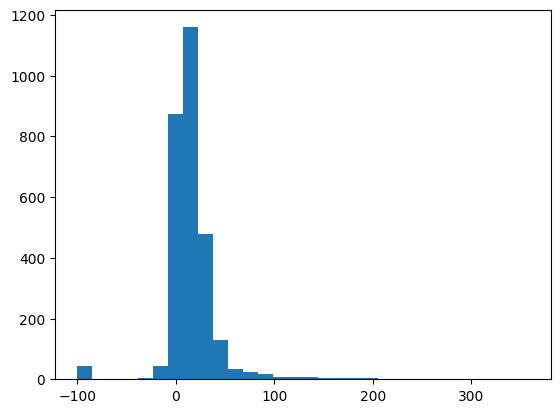

In [26]:
plt.hist(a.values.flatten(), bins=30)  # 设置 30 个分箱

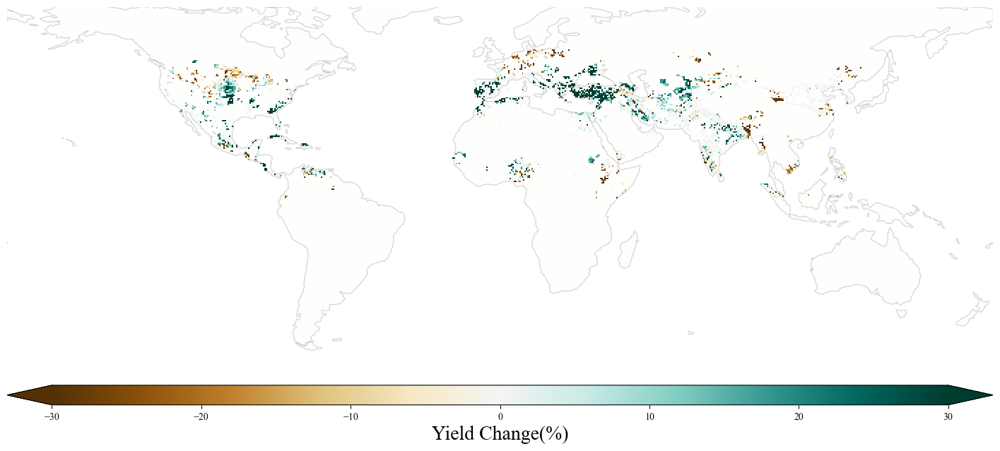

In [93]:
fig, ax = plt.subplots( figsize=(18, 14),
                        subplot_kw={'projection': ccrs.PlateCarree()})
ax.set_extent([-180, 180, -60, 70], crs=ccrs.PlateCarree())

# 添加地图特征
ax.add_feature(cfeature.COASTLINE, alpha=0.1)
ax.add_feature(cfeature.LAND, edgecolor='black', alpha=0.05)

# 绘制数据并设置颜色带
im = future.plot(ax=ax, transform=ccrs.PlateCarree(), cmap='BrBG', 
                      vmin=-30, vmax=30,add_colorbar=False)

# 设置标题为“倍数: 数字除以10”

# 移除网格线
gl = ax.gridlines(draw_labels=False)
gl.xlines = False
gl.ylines = False

# 去除四周边框
ax.spines['geo'].set_visible(False)
cbar = plt.colorbar(im, ax=ax, orientation='horizontal', pad=0.03, shrink=1, aspect=50, extend='both')
cbar.set_label('Yield Change(%)', fontsize=20)
plt.show()